## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.


## First, I'll Compute the Camera calibration using the chessboard images.

['camera_cal/calibration7.jpg', 'camera_cal/calibration9.jpg', 'camera_cal/calibration2.jpg', 'camera_cal/calibration20.jpg', 'camera_cal/calibration5.jpg', 'camera_cal/calibration19.jpg', 'camera_cal/calibration18.jpg', 'camera_cal/calibration4.jpg', 'camera_cal/calibration1.jpg', 'camera_cal/calibration16.jpg', 'camera_cal/calibration13.jpg', 'camera_cal/calibration12.jpg', 'camera_cal/calibration6.jpg', 'camera_cal/calibration3.jpg', 'camera_cal/calibration17.jpg', 'camera_cal/calibration14.jpg', 'camera_cal/calibration10.jpg', 'camera_cal/calibration11.jpg', 'camera_cal/calibration15.jpg', 'camera_cal/calibration8.jpg']


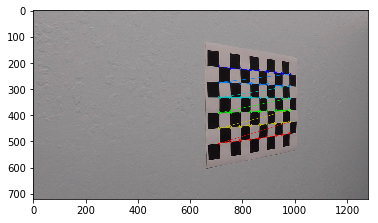

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

%matplotlib inline

nx = 9
ny = 6

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((ny*nx,3), np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.


# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')

print(images)

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    

    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

    # If found, add object points, image points
    if ret == True:
        
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)
        plt.imshow(img)
        #cv2.waitKey(500)

cv2.destroyAllWindows()


## The actual Calibration

wooooo


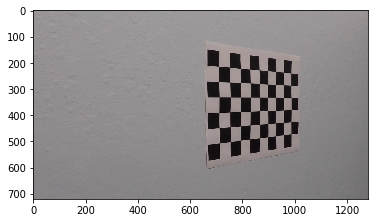

In [2]:

img = cv2.imread(images[-1])
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

# Calibrate
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)


undst = cv2.undistort(img, mtx, dist, None, mtx)
plt.imshow(undst)

#3) Find the chessboard corners
# Find the chessboard corners
ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
# 4) If corners found: 
warped = []
if ret == True:
    print('wooooo')
else:
    print('boo')


## Perspective Transform

wooooo


True

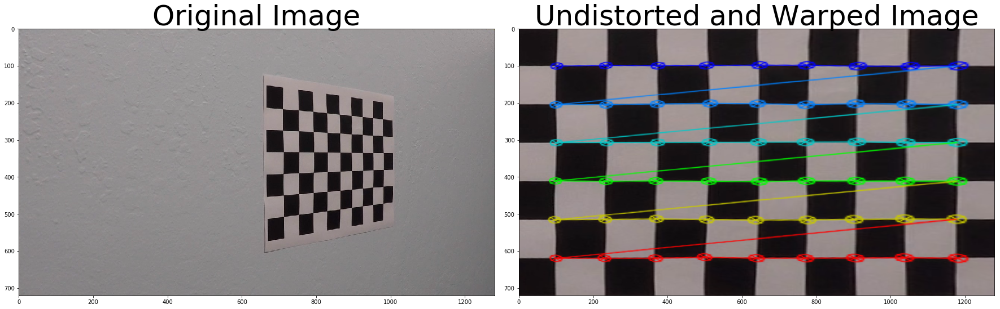

In [3]:

img = cv2.imread(images[-1])
gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

def corners_unwarp(img, nx, ny, mtx, dist):
    # Pass in your image into this function
    # Write code to do the following steps
    # 1) Undistort using mtx and dist
    undst = cv2.undistort(img, mtx, dist, None, mtx)
     #2) Convert to grayscale
    gray = cv2.cvtColor(undst,cv2.COLOR_BGR2GRAY)
    

    #3) Find the chessboard corners
        # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)
    # 4) If corners found: 
    warped = []
    if ret == True:
            print('wooooo')
            # a) draw corners
            # Draw and display the corners
            cv2.drawChessboardCorners(undst, (nx,ny), corners, ret)
            
            # b) define 4 source points src = np.float32([[,],[,],[,],[,]])
            #rect = order_points(corners)
            src = np.float32([corners[0], corners[nx-1], corners[-1], corners[-nx]])
                 #Note: you could pick any four of the detected corners 
                 # as long as those four corners define a rectangle
                 #One especially smart way to do this would be to use four well-chosen
                 # corners that were automatically detected during the undistortion steps
                 #We recommend using the automatic detection of corners in your code
            # c) define 4 destination points dst = np.float32([[,],[,],[,],[,]])
            
            offset = 100
            img_size = (gray.shape[1], gray.shape[0])

            dst = np.float32([[offset, offset], [img_size[0]-offset, offset], 
                                     [img_size[0]-offset, img_size[1]-offset], 
                                     [offset, img_size[1]-offset]])
            # d) use cv2.getPerspectiveTransform() to get M, the transform matrix
            m = cv2.getPerspectiveTransform(src, dst)

            # e) use cv2.warpPerspective() to warp your image to a top-down view

            warped = cv2.warpPerspective(undst, m, img_size, flags=cv2.INTER_LINEAR)
    else:
        raise NameError('Didn\'t find any chessboard corners')

    return warped, m
top_down, perspective_M = corners_unwarp(img, nx, ny, mtx, dist)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(top_down)
ax2.set_title('Undistorted and Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

r,g,b =  cv2.split(img)
img = cv2.merge((b,g,r))
cv2.imwrite("output_images/output_original_chess.jpg", img)
r,g,b =  cv2.split(undst)
undst = cv2.merge((b,g,r))
cv2.imwrite("output_images/output_undistorted_chess.jpg", undst)
r,g,b =  cv2.split(top_down)
undst = cv2.merge((b,g,r))
cv2.imwrite("output_images/output_warp_perspective_chess.jpg", undst)


# Get the test road files

In [4]:

files = os.listdir("test_images/")
files

['output_test5.jpg',
 'output_perspective_test2.jpg',
 'straight_lines2.jpg',
 'output_test2.jpg',
 'output_perspective_signs_vehicles_xygrad.png',
 'output_perspective_chesstest6.jpg',
 'test3.jpg',
 'output_perspective_straight_lines1.jpg',
 'test1.jpg',
 'signs_vehicles_xygrad.png',
 'output_signs_vehicles_xygrad.png',
 'output_original_chess_test6.jpg',
 'output_straight_lines1.jpg',
 'output_perspective_straight_lines2.jpg',
 'output_test6.jpg',
 'test6.jpg',
 'straight_lines1.jpg',
 'output_perspective_test6.jpg',
 'output_perspective_test3.jpg',
 'output_perspective_test1.jpg',
 'test5.jpg',
 'test2.jpg',
 'output_undistorted_chess_test6.jpg',
 'output_perspective_test4.jpg',
 'output_test3.jpg',
 'output_perspective_test5.jpg',
 'output_test4.jpg',
 'output_straight_lines2.jpg',
 'test4.jpg',
 'output_test1.jpg']

# Un-distort the Image

True

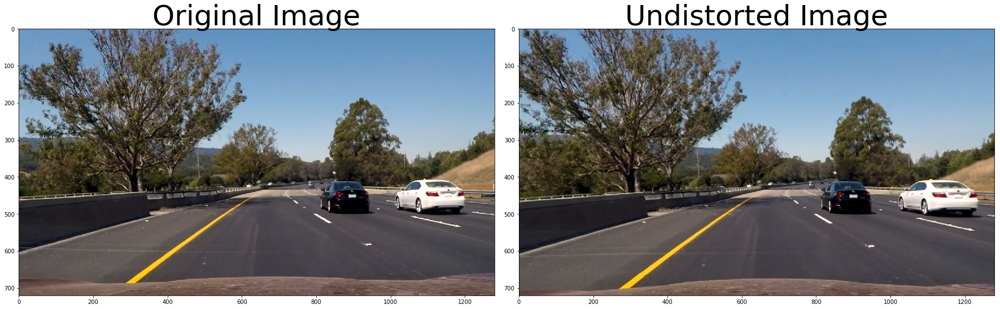

In [5]:
file = 'test6.jpg'
image = mpimg.imread('test_images/'+file)
# Undistort the camera image using the mtx calculated from the chess board.
undist = cv2.undistort(image, mtx, dist, None, mtx)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist, cmap='gray')
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)    

r,g,b =  cv2.split(undist)
result = cv2.merge((b,g,r))
cv2.imwrite('output_images/output_undistorted_'+file, result)



# Fix Perspective

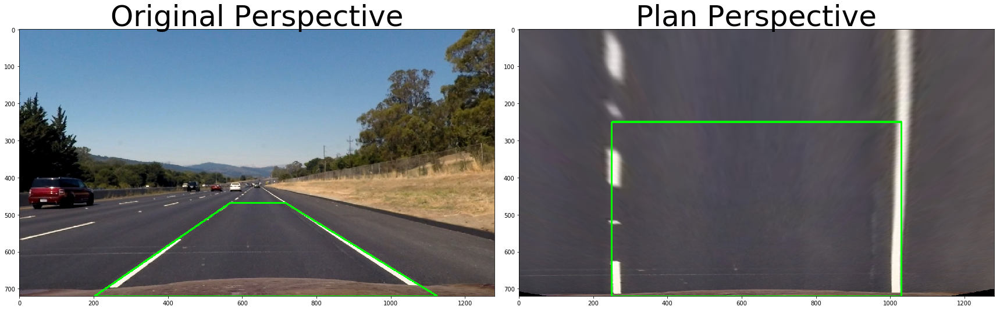

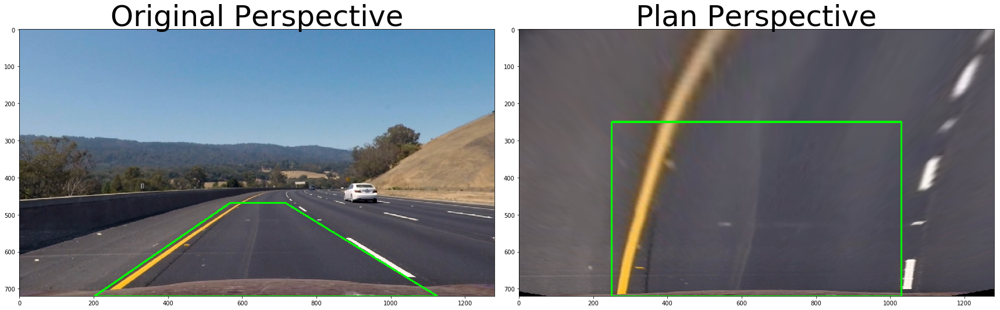

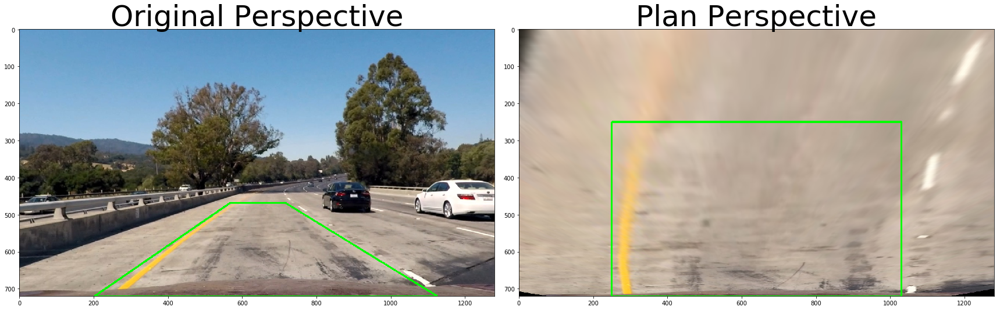

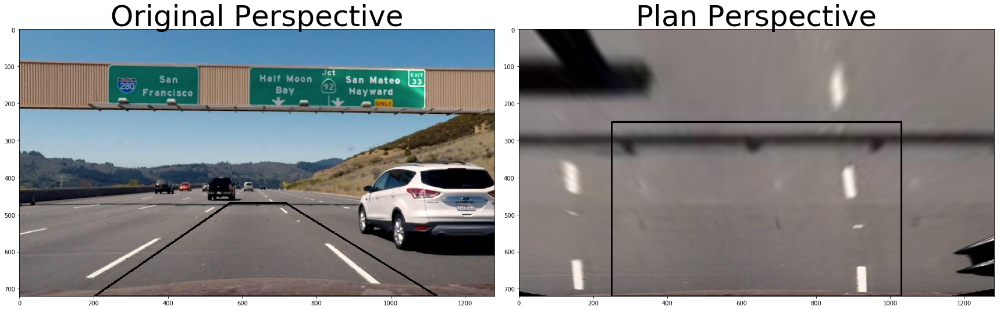

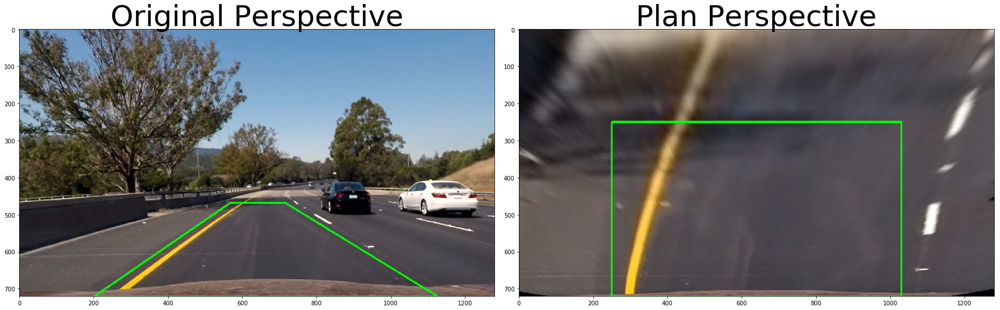

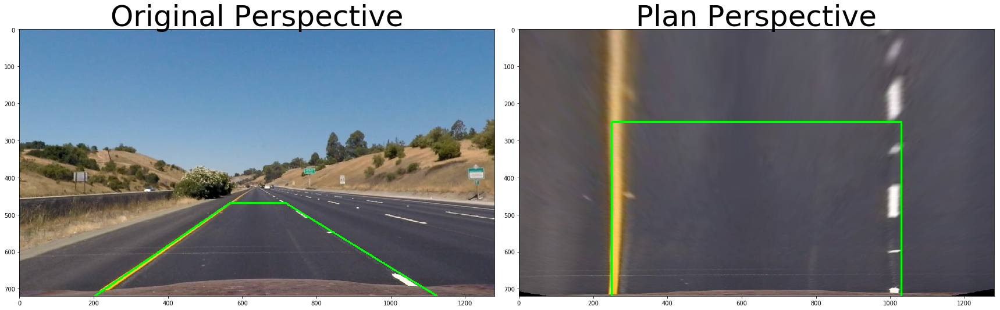

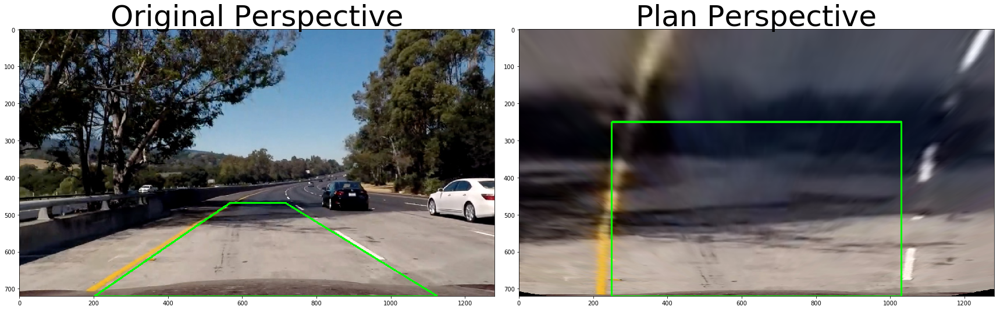

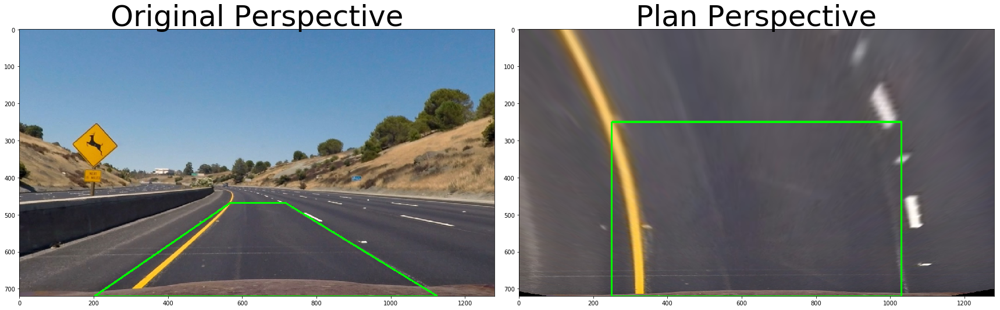

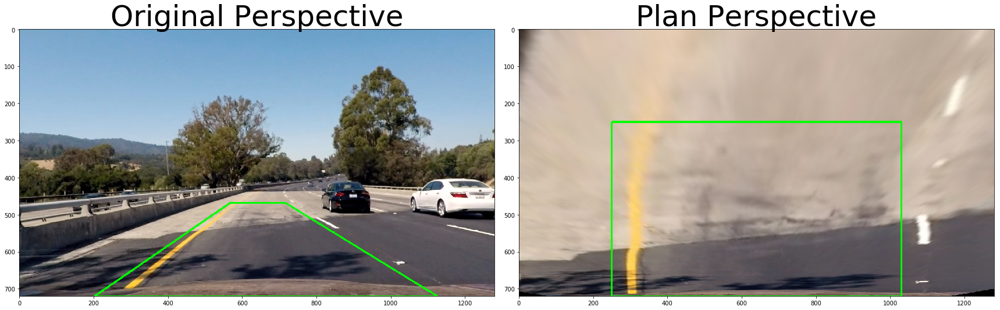

In [6]:
image = mpimg.imread('test_images/test6.jpg')
# Undistort the camera image using the mtx calculated from the chess board.
undist = cv2.undistort(image, mtx, dist, None, mtx)

def show_lines(img, lines):
    for i in range(len(lines)):
        end = (i+1) % len(lines)
        cv2.line(img, (lines[i][0], lines[i][1]), (lines[end][0], lines[end][1]), color=[0,255,0], thickness=3)

def unwarp(img, src, dst, debug=False):
    # Switch so first is x and second is y.
    img_size = (img.shape[1], img.shape[0])

    # Compute the perspective transform M
    m = cv2.getPerspectiveTransform(src, dst)
    # inverse by swapping
    m_inverse = cv2.getPerspectiveTransform(dst, src)

    
    # Warp the images
    warped = cv2.warpPerspective(img, m, img_size, flags=cv2.INTER_LINEAR)
    if(debug == True):
        show_lines(img, src)
        show_lines(warped, dst)
 
    return warped, m, m_inverse
   
SRC_TOP_Y = .65
SRC_TOP_X_LEFT = 0.444
SRC_TOP_X_RIGHT = 0.56
SRC_BOTTOM_X_LEFT = 0.281
SRC_BOTTOM_X_RIGHT = 0.880



def transform_lane_perspective(img, debug=False):
  

    img_size = (img.shape[1], img.shape[0])

    offset = 250
    
    # Select the required area using a quadrilateral.

    # Source src co-ords
    src = np.float32([(img_size[1]*SRC_BOTTOM_X_LEFT, img_size[1]), # bottom left
              (img_size[0]*SRC_TOP_X_LEFT,img_size[1]*SRC_TOP_Y), # top left
              (img_size[0]*SRC_TOP_X_RIGHT, img_size[1]*SRC_TOP_Y), # top right
             (img_size[0]*SRC_BOTTOM_X_RIGHT, img_size[1])]) # bottom right


    # Destination map coordinates
    dst = np.float32([
    [offset, img_size[1]], # bottom left
    [offset, offset], # top left
    [img_size[0]-offset, offset], # Top right
    [img_size[0]-offset, img_size[1]] ]) # Bottom Right


    unwarped, m, m_inverse = unwarp(img, src, dst, debug=debug) 
    return unwarped, m, m_inverse
    

#for file in ['straight_lines1.jpg', 'straight_lines2.jpg']:
for file in files:

    if file[0:6] != "output":
        img = mpimg.imread("test_images/" + file)
        # Undistort the camera image using the mtx calculated from the chess board.
        undist = cv2.undistort(img, mtx, dist, None, mtx)
        
        # Change to plan view.
        unwarped_lane, m, m_inverse = transform_lane_perspective(undist, debug= True)


        result = unwarped_lane

        
        # Plot the result
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(undist)
        ax1.set_title('Original Perspective', fontsize=50)
        ax2.imshow(unwarped_lane, cmap='gray')
        ax2.set_title('Plan Perspective', fontsize=50)
        #plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        r,g,b =  cv2.split(undist)
        result = cv2.merge((b,g,r))
        cv2.imwrite("output_images/output_unwarped_lane_rect_"+file, result)
        r,g,b =  cv2.split(unwarped_lane)
        result = cv2.merge((b,g,r))
        cv2.imwrite("output_images/output_warp_perspective_"+file, result)


# Gradients and color spaces.

## Sobel

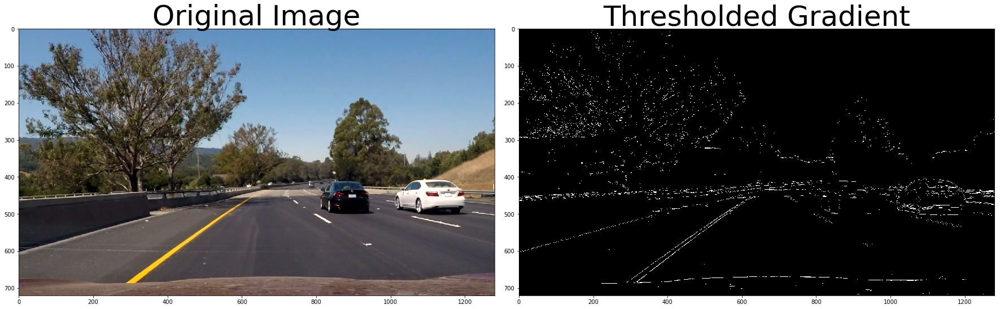

In [7]:
# Read in an image 
image = mpimg.imread('test_images/straight_lines1.jpg')
image = mpimg.imread('test_images/test6.jpg')



# Define a function that applies Sobel x or y, 
# then takes an absolute value and applies a threshold.
# Note: calling your function with orient='x', thresh_min=20, thresh_max=100
# should produce output like the example image shown above this quiz.
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the derivative in x or y given orient = 'x' or 'y'
    if(orient == 'x'):
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    elif orient == 'y':
        sobelx = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    else:
        raise NameError('Invalid orient: try x or y instead.')

        
    # 3) Take the absolute value of the derivative or gradient
    abs_sobelx = np.absolute(sobelx)
    # 4) Scale to 8-bit (0 - 255) then convert to type = np.uint8
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    # 5) Create a mask of 1's where the scaled gradient magnitude 
            # is > thresh_min and < thresh_max
    sx_binary = np.zeros_like(scaled_sobel)
    sx_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    binary_output = sx_binary
    return binary_output
    
# Run the function
grad_binary = abs_sobel_thresh(image, orient='y', thresh = (70, 100))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(grad_binary, cmap='gray')
ax2.set_title('Thresholded Gradient', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Sobel Mag

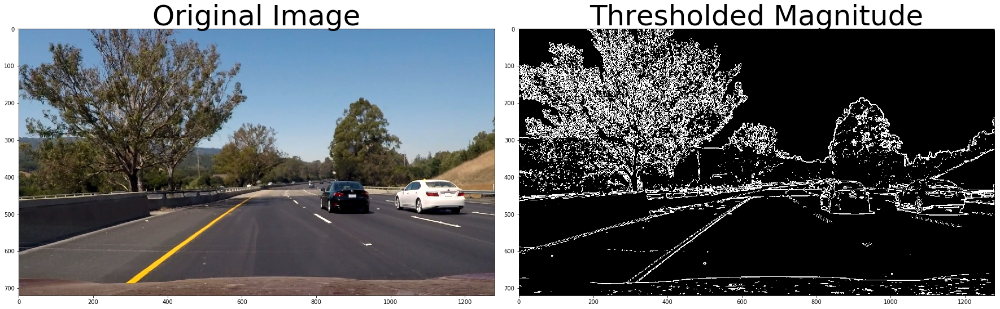

In [8]:
def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Calculate the magnitude 
    mag_sobel = np.sqrt(sobelx**2 + sobely**2)
    # 4) Scale to 8-bit (0 - 255) and convert to type = np.uint8
    scaled_sobel = np.uint8(255*mag_sobel/np.max(mag_sobel))
    # 5) Create a binary mask where mag thresholds are met
    s_binary = np.zeros_like(scaled_sobel)
    s_binary[(scaled_sobel >=  mag_thresh[0]) & (scaled_sobel <= mag_thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    binary_output = s_binary
    return binary_output
    
# Run the function
mag_binary = mag_thresh(image, sobel_kernel=3, mag_thresh=(30, 100))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(mag_binary, cmap='gray')
ax2.set_title('Thresholded Magnitude', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    

## Sobel Direction

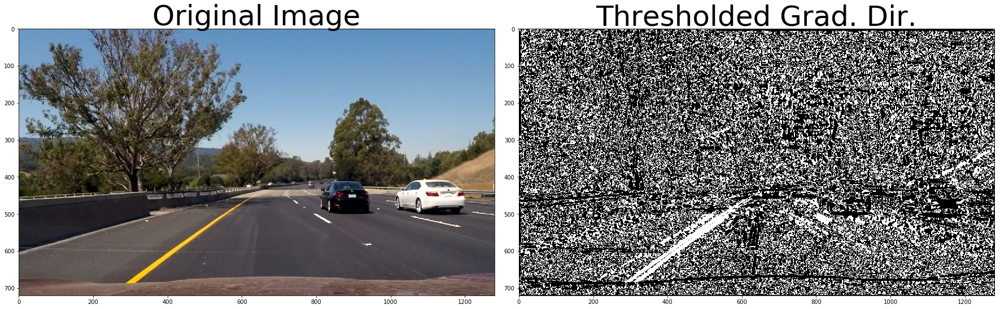

In [9]:
# Define a function that applies Sobel x and y, 
# then computes the direction of the gradient
# and applies a threshold.
def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    
    # Apply the following steps to img
    # 1) Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # 2) Take the gradient in x and y separately
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # 3) Take the absolute value of the x and y gradients
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    # 4) Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    direction = np.arctan2(abs_sobely, abs_sobelx)
    # 5) Create a binary mask where direction thresholds are met
    s_binary = np.zeros_like(direction)
    s_binary[(direction >=  thresh[0]) & (direction <= thresh[1])] = 1
    # 6) Return this mask as your binary_output image
    binary_output = s_binary
    return binary_output
 
    
# Run the function
dir_binary = dir_threshold(image, sobel_kernel=15, thresh=(0.7, 1.3))
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(dir_binary, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Combined Thresholds

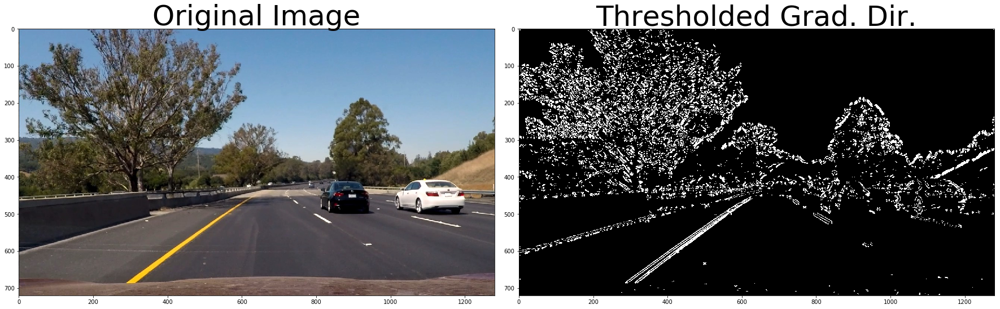

In [10]:
# Apply each of the thresholding functions
ksize = 15

gradx        = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 100))
#gradx = grad_binary
grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(20, 100))
mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(30, 100))
dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0.7, 1.3))

combined = np.zeros_like(dir_binary)
combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(combined, cmap='gray')
ax2.set_title('Thresholded Grad. Dir.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Color spaces


Easy Frame:


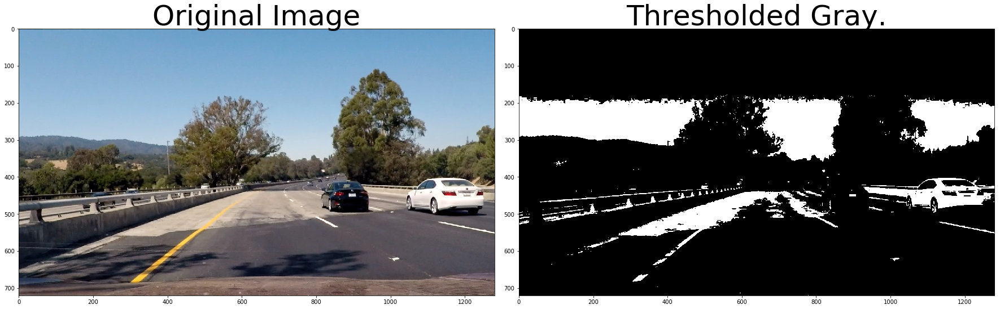

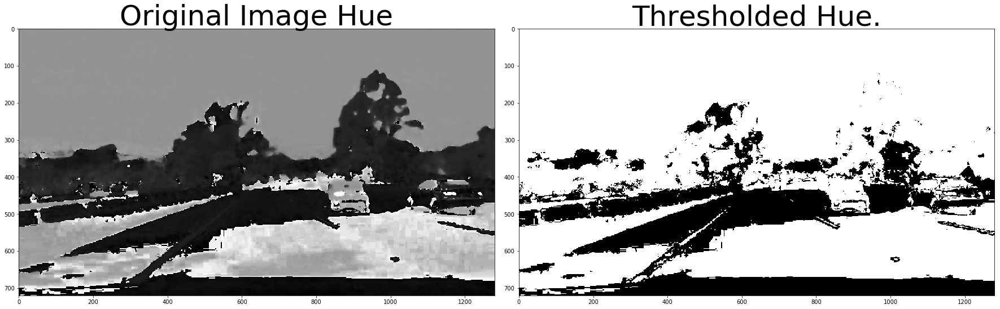

In [11]:
print('Easy Frame:')
image = mpimg.imread('test_images/test4.jpg')

thresh = (180, 255)
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
binary = np.zeros_like(gray)
binary[(gray > thresh[0]) & (gray <= thresh[1])] = 1
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('Thresholded Gray.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# VS HLS

hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]


# Hue 

thresh = (20, 200)
binary = np.zeros_like(H)
binary[(H > thresh[0]) & (H <= thresh[1])] = 1

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(H, cmap='gray')
ax1.set_title('Original Image Hue', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('Thresholded Hue.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)



# Color Spaces: Tricky Frame

Tricky Frame:


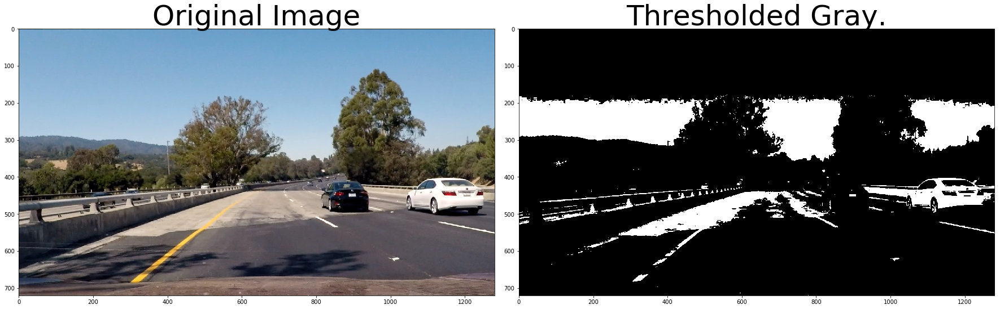

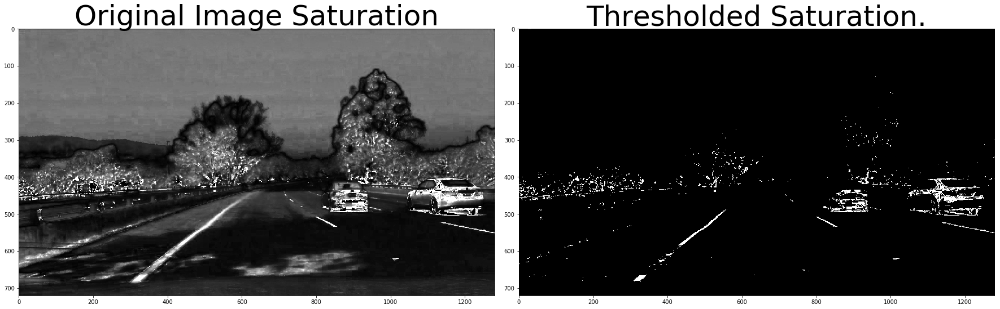

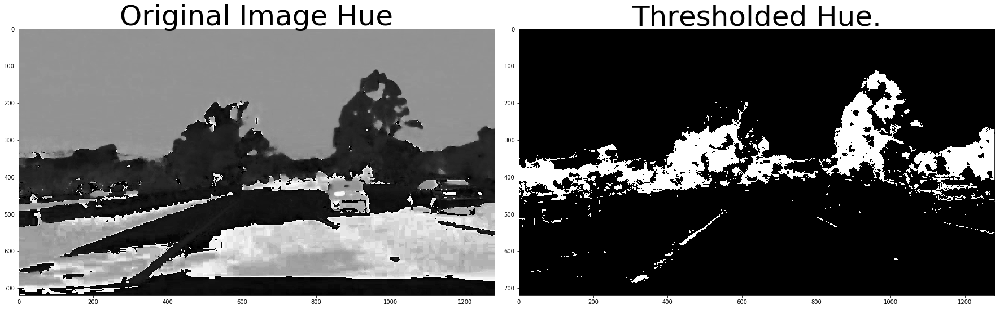

In [12]:
print('Tricky Frame:')
image = mpimg.imread('test_images/test4.jpg')

thresh = (180, 255)
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
binary = np.zeros_like(gray)
binary[(gray > thresh[0]) & (gray <= thresh[1])] = 1
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('Thresholded Gray.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# VS HLS

hls = cv2.cvtColor(image, cv2.COLOR_RGB2HLS)
H = hls[:,:,0]
L = hls[:,:,1]
S = hls[:,:,2]

# Saturation
thresh = (230, 255)

binary = np.zeros_like(S)
# X sobel
s_sob = np.absolute(cv2.Sobel(S, cv2.CV_64F, 1, 0))
s_sob = S
binary[(s_sob > thresh[0]) & (s_sob <= thresh[1])] = 1

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(S, cmap='gray')
ax1.set_title('Original Image Saturation', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('Thresholded Saturation.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# Hue 
thresh = (20, 30)
binary = np.zeros_like(H)
binary[(H > thresh[0]) & (H <= thresh[1])] = 1

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(H, cmap='gray')
ax1.set_title('Original Image Hue', fontsize=50)
ax2.imshow(binary, cmap='gray')
ax2.set_title('Thresholded Hue.', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

# TODO combine red and saturation

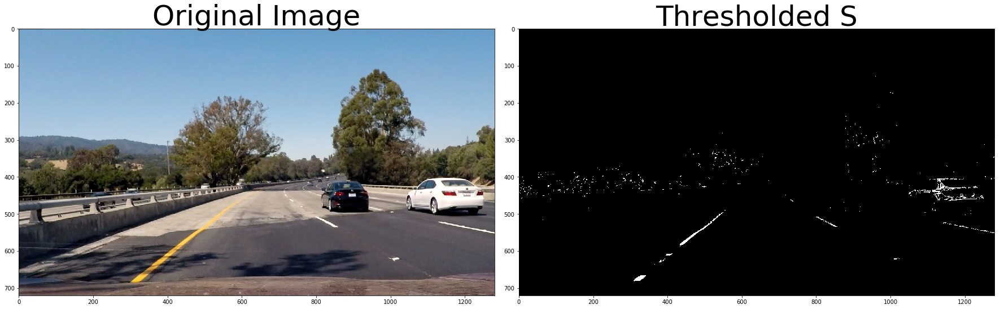

In [13]:
image = mpimg.imread('test_images/test4.jpg')

def HLS_RGB(img):
    return cv2.cvtColor(img, cv2.COLOR_HLS2RGB)
def RGB_HLS(img):
    return cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

# Thresholds the S-channel of HLS
# Use exclusive lower bound (>) and inclusive upper (<=)
def hls_select(img, s_thresh=(230, 255), h_thresh=(20 , 30)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    H = hls[:,:,0]
    L = hls[:,:,1]
    S = hls[:,:,2]

    # 2) Apply a threshold to the S channel
    s_binary = np.zeros_like(S)
    s_binary[(S > s_thresh[0]) & (S <= s_thresh[1])] = 1
    h_binary = np.zeros_like(H)
    h_binary[(H > h_thresh[0]) & (H <= h_thresh[1]) & (s_binary==1)] = 1
    
    
    return h_binary
    
# Optional TODO - tune the threshold to try to match the above image!    
hls_binary = hls_select(image, s_thresh=(230, 255))

# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(hls_binary, cmap='gray')
ax2.set_title('Thresholded S', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

## Combine Color and Sobel

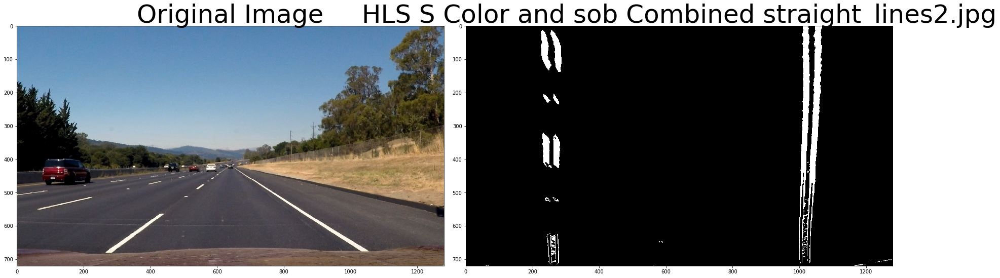

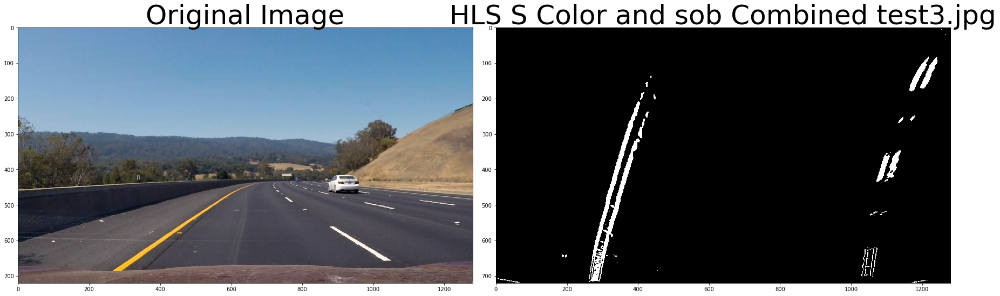

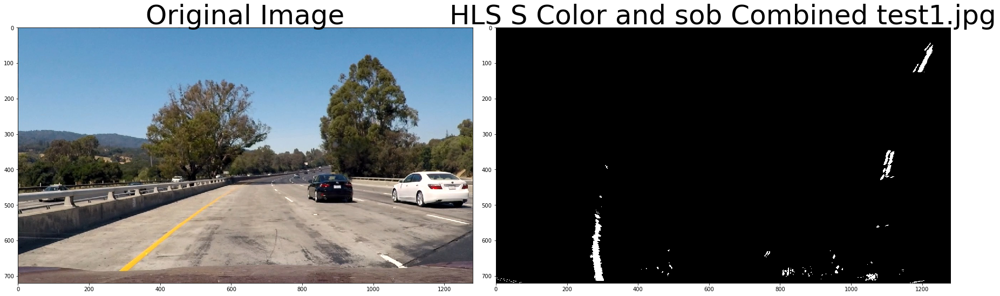

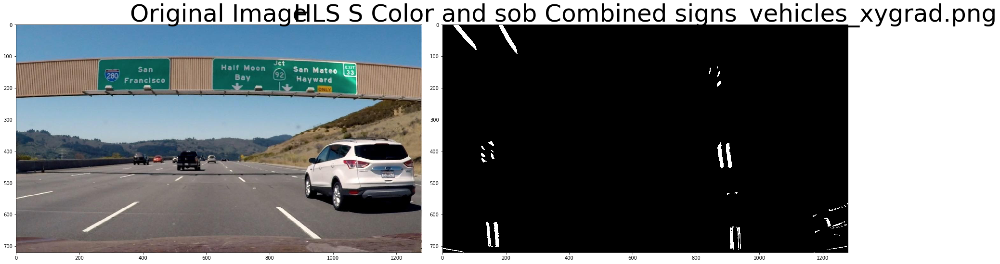

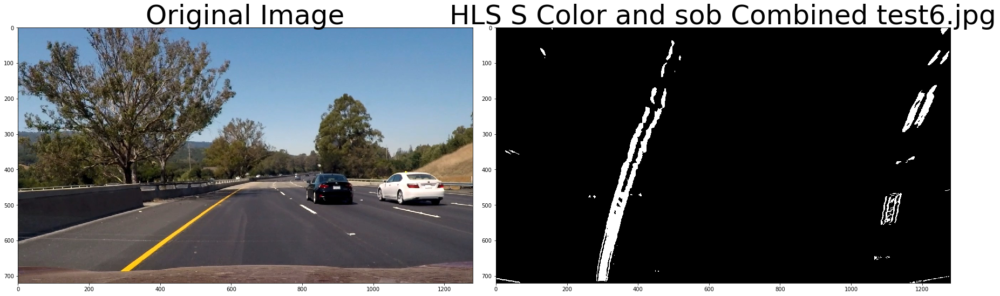

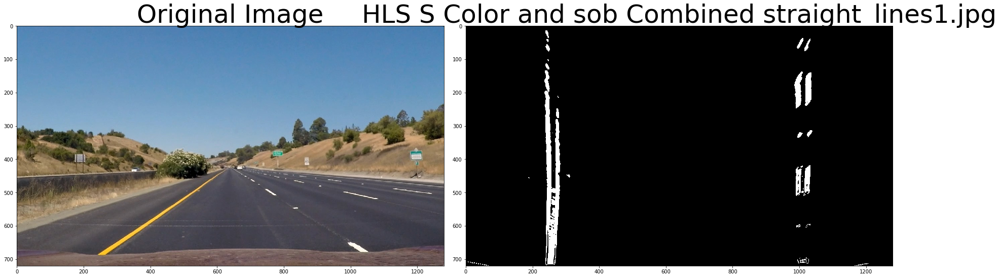

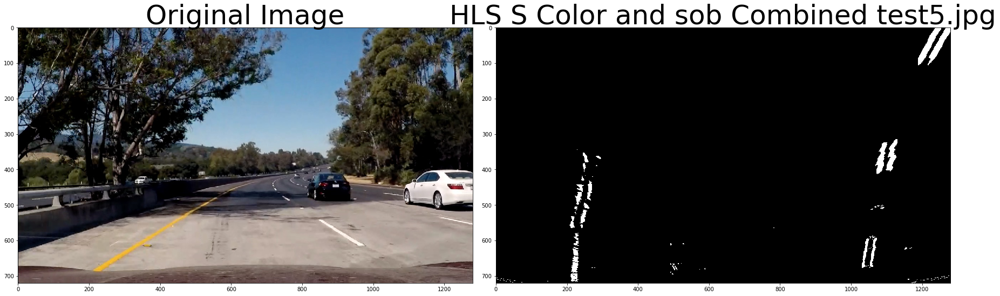

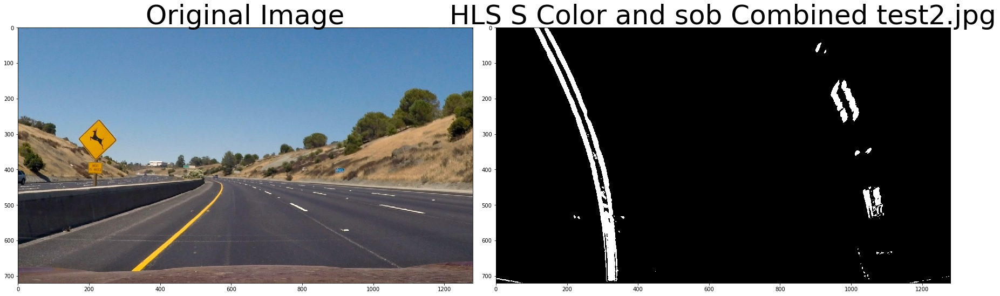

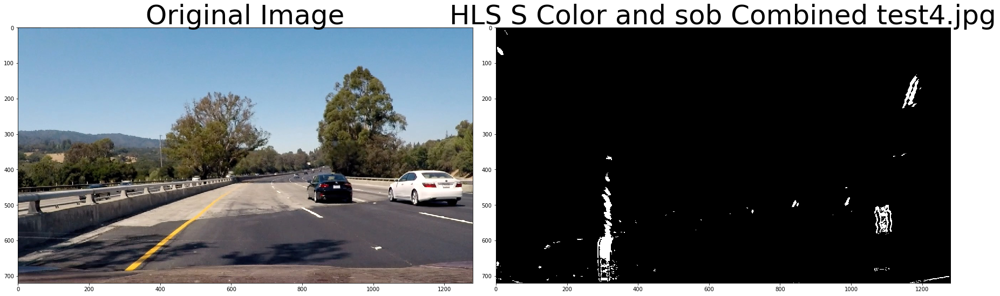

In [14]:
def color_sob_pipeline(image,  s_thresh=(180, 255), sx_thresh=(20, 100)):
    s_binary = hls_select(image, s_thresh=(s_thresh[0], s_thresh[1]))
    
    # Apply each of the thresholding functions
    ksize = 15

    gradx        = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize, thresh=(20, 90))
    #gradx = grad_binary
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=ksize, thresh=(100, 150))
    mag_binary = mag_thresh(image, sobel_kernel=ksize, mag_thresh=(30, 100))
    dir_binary = dir_threshold(image, sobel_kernel=ksize, thresh=(0, np.pi/4))

    combined = np.zeros_like(dir_binary)
    mag_dir_binary = np.zeros_like(dir_binary)
    mag_dir_binary[((mag_binary == 1) & (dir_binary == 1))] = 1
    grad_xy_binary = np.zeros_like(gradx)
    grad_xy_binary[((gradx == 1) & (grady == 1))] = 1
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    # Combine the two approaches
    sxbinary = gradx
    s_binary = s_binary
    # Scaled so both 'blue' and 'green' are given equal value for if we due grayscale 
    
    color_binary = np.dstack((np.uint8(sxbinary), np.uint8( s_binary), np.zeros_like(sxbinary))) * 255
    both_combined = combined
    both_combined[((combined == 1) | (s_binary == 1))] = 1
    # TODO Use combined and use the params + provide full params.
    return combined

for file in files:
    if file[0:6] != "output":
        image = mpimg.imread('test_images/' + file)

        undist = cv2.undistort(image, mtx, dist, None, mtx)
        # Transform image into a top down view.
        top_down, m, m_inverse = transform_lane_perspective(undist)
        color_sob = color_sob_pipeline(top_down)
        binary = (color_sob)
        # Plot the result
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(image)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(binary, cmap='gray')
        ax2.set_title('HLS S Color and sob Combined {}'.format(file), fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.) 
        #r,g,b =  cv2.split(binary)
        #result = cv2.merge((binary,binary,binary))
        #

        plt.imsave('output_images/output_binary_filter_'+file, binary, cmap='gray')




# Un-distort the camera image

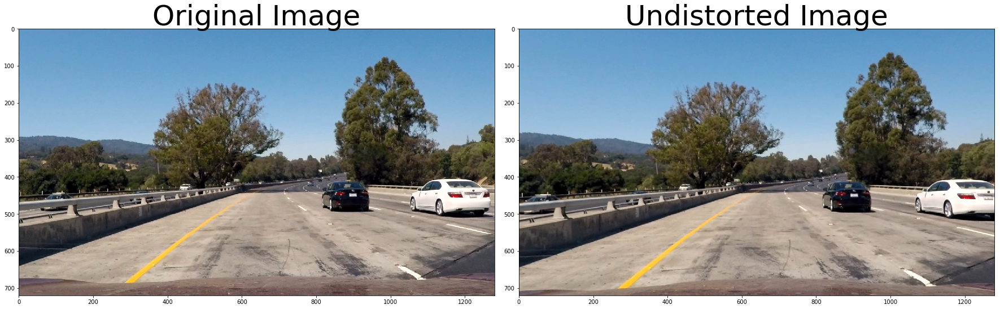

In [15]:
image = mpimg.imread('test_images/test1.jpg')

# Undistort the camera image using the mtx calculated from the chess board.
undist = cv2.undistort(image, mtx, dist, None, mtx)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(undist, cmap='gray')
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)    
    

## Perspective transform

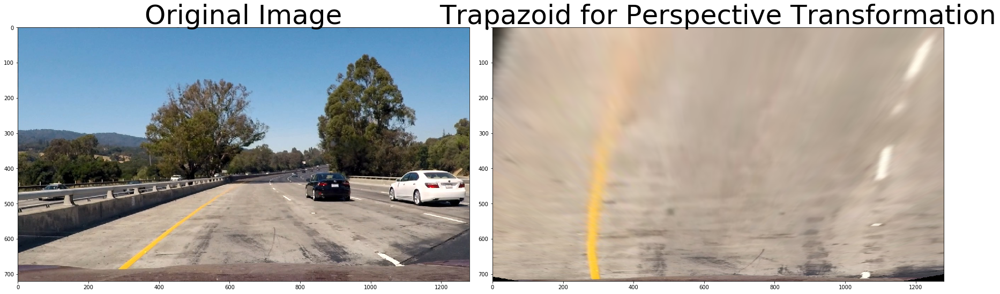

In [16]:
warped, m, m_inverse = transform_lane_perspective(undist)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(warped, cmap='gray')
ax2.set_title('Trapazoid for Perspective Transformation', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)    
    


# Histogram

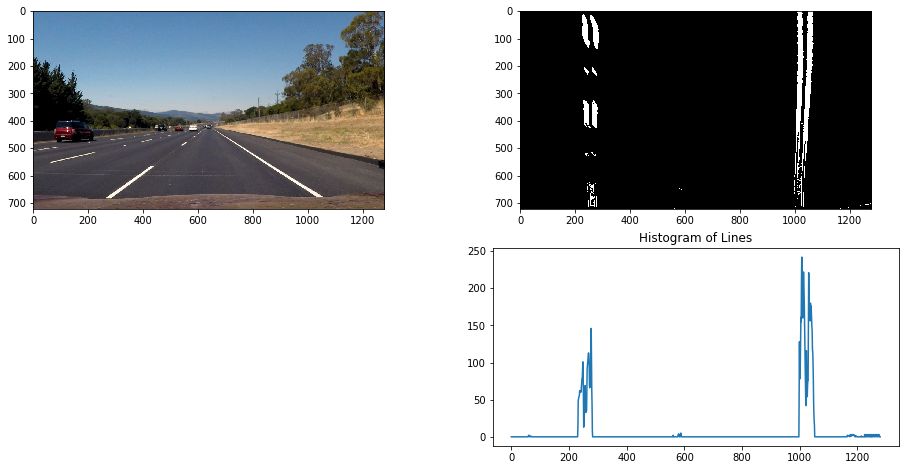

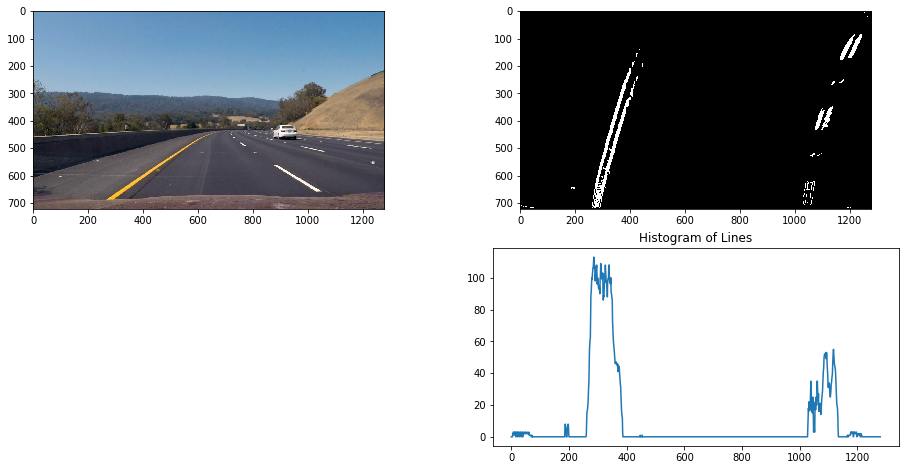

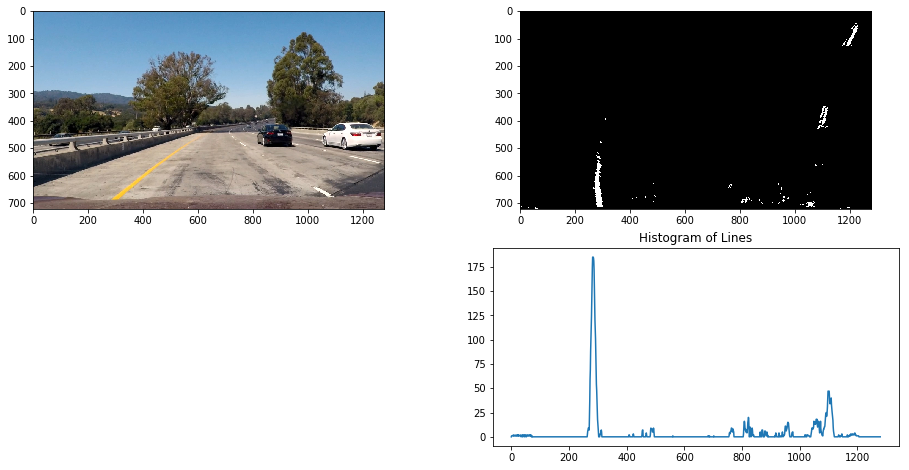

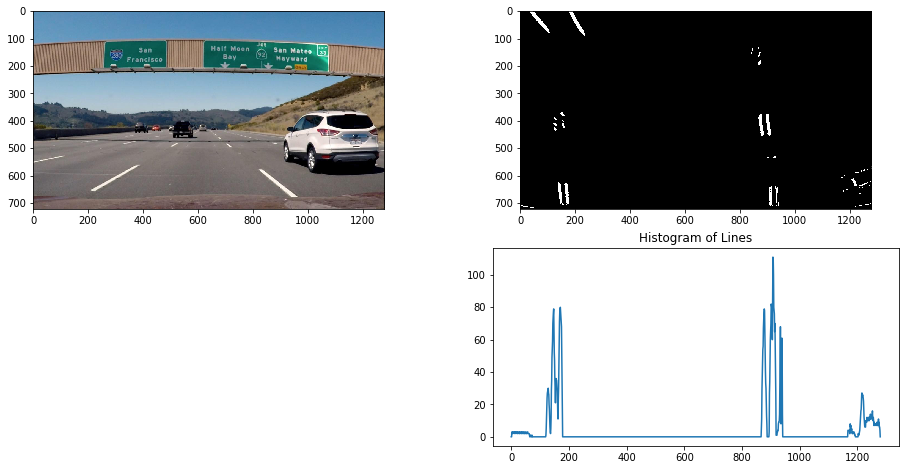

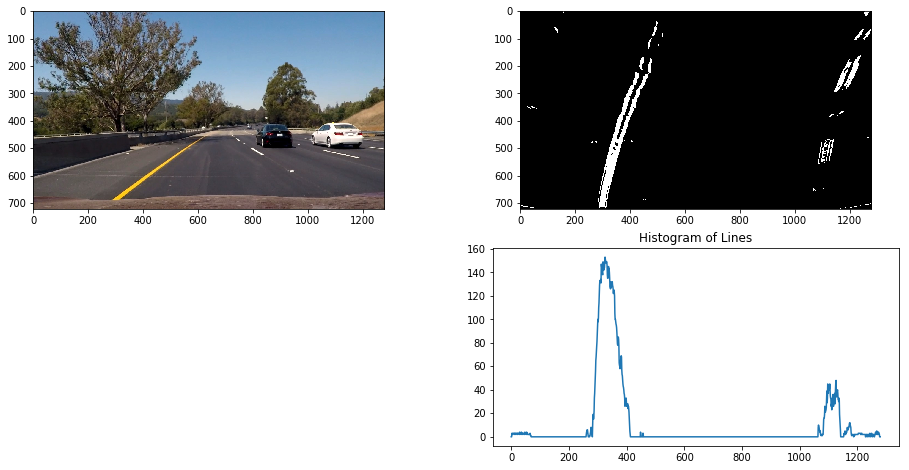

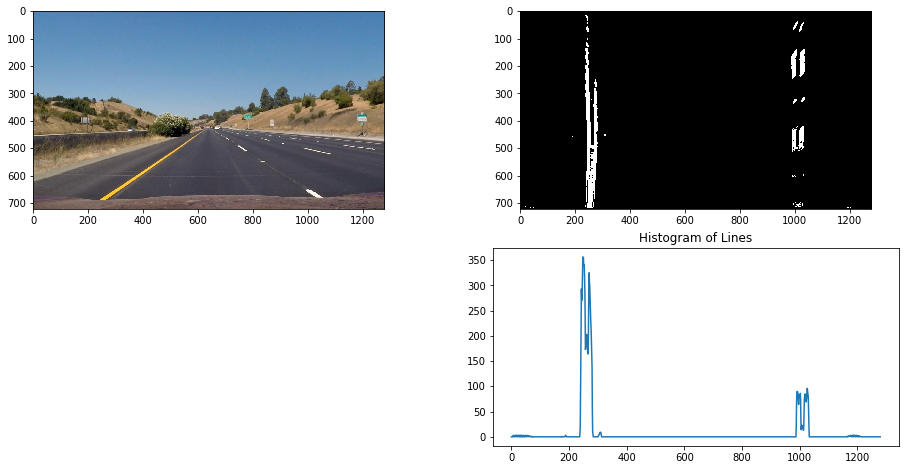

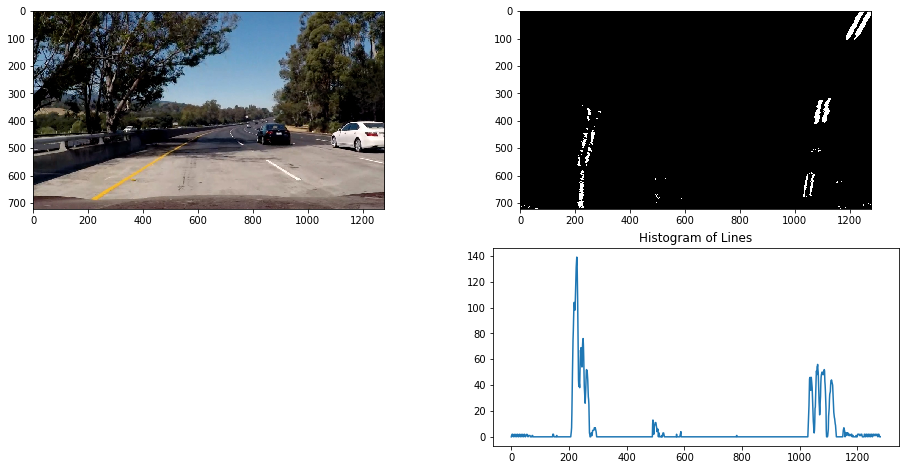

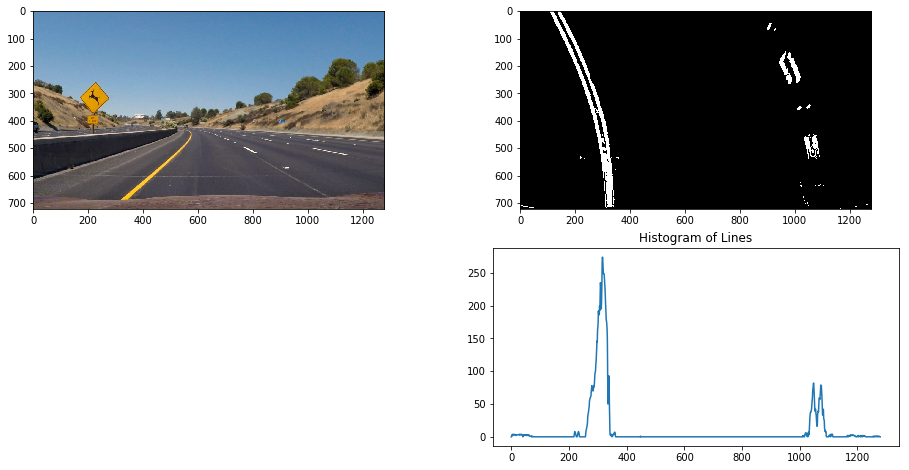

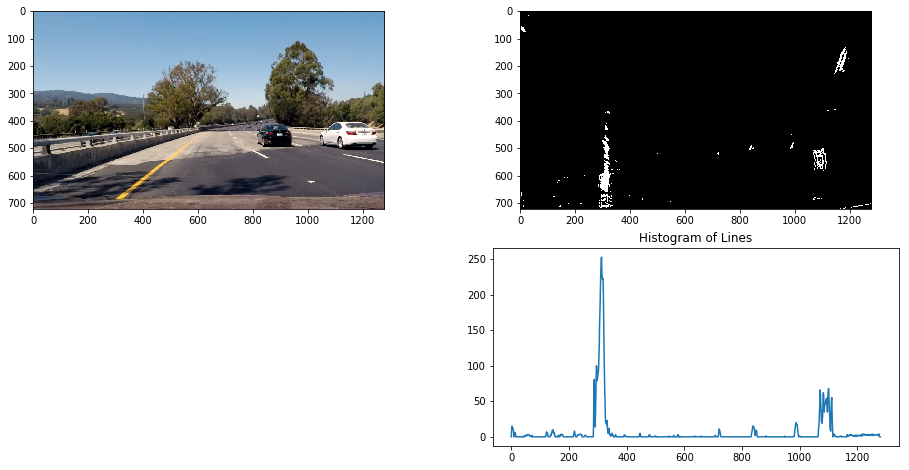

In [17]:
def hist(img):
    # Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car
        # The proportions of image width and height used for the selected regions.

    # Sum across image pixels vertically - make sure to set `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0, dtype=np.float32)
  
    return histogram

def sliding_window(img):
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
    
    
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(img.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero (i.e. activated) pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

files = os.listdir("test_images/")
# Test on the test images.
for file in files:
    if file[0:6] != "output":
        img = mpimg.imread("test_images/" + file)
        
        # Undistort the camera image using the mtx calculated from the chess board.
        undist = cv2.undistort(img, mtx, dist, None, mtx)
        # Transform image into a top down view.
        top_down, m, m_inverse = transform_lane_perspective(undist)
        # Use sob with saturation.
        color_sob = color_sob_pipeline(top_down)
        result = color_sob
        histogram = hist(result)
        fig=plt.figure(figsize=(16, 8))
        rows = 2
        cols = 2
        fig.add_subplot(rows, cols, 1)
        plt.imshow(img) 
        fig.add_subplot(rows, cols, 2)
        plt.imshow(result, cmap='gray')
        fig.add_subplot(rows, cols, 4)
        plt.title("Histogram of Lines")
        plt.plot(histogram)
        #r,g,b =  cv2.split(hist)
        #histogram = cv2.merge((binary,binary,binary))
        #plt.imwrite("output_images/output_hist_"+file, hist)
        #plt.savefig("abc.png")
        plt.savefig('output_images/output_hist_'+file)



## Line Class

In [18]:

# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_left_fit = []
        #polynomial coefficients for the most recent fit
        self.current_right_fit = []
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None  
        self.plot_left = []
        self.plot_right = []
        self.ploty = []

line = Line()


# Measuring Curvature

In [35]:
import numpy as np


# Should see values of 533.75 and 648.16 here, if using
# the default `generate_data` function with given seed number

def measure_curvature(ploty, left_fit, right_fit):
    '''
    Calculates the curvature of polynomial functions in meters.
    '''
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = (30/720)  *10# meters per pixel in y dimension
    xm_per_pix = 3.7/750 # meters per pixel in x dimension
    
    # Define y-value where we want radius of curvature
    # We'll choose the maximum y-value, corresponding to the bottom of the image
    ploty = np.linspace(0, (img.shape[0]-1), img.shape[0])
    y_eval = np.max(ploty)

    

    # Get points for warp space fits 
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    left_fitx = left_fitx[::-1]
    right_fitx = right_fitx[::-1]
    

    # fit new polynomials in world space.
    left_fit_meters = np.polyfit(ploty * ym_per_pix, left_fitx * xm_per_pix, 2)
    right_fit_meters = np.polyfit(ploty * ym_per_pix, right_fitx * xm_per_pix, 2)
    
    ## Implement the calculation of the left line here at the point y_eval
    left_curverad = ((1 + (2*left_fit_meters[0]*y_eval*ym_per_pix  + left_fit_meters[1])**2)**(3.0/2)) / np.absolute(2*left_fit_meters[0])
    
    right_curverad = ((1 + (2*right_fit_meters[0]*y_eval*ym_per_pix  + right_fit_meters[1])**2)**(3.0/2)) / np.absolute(2*right_fit_meters[0])
    

    return (left_curverad + right_curverad)/2

# Calculate
def calculate_center_diff(img):
    xm_per_pix = 3.7/750 # meters per pixel in x dimension
    if(len(line.plot_left) == 0 or len(line.plot_left) == 0):
        return -1;
    else:
        avg_chunk = 5
        if(len(line.plot_left) < 5):
            avg_chunk = len(line.plot_left)
            
        first_leftx = line.plot_left[-avg_chunk:].mean()
        first_rightx = line.plot_right[-avg_chunk:].mean()
        left_lane = first_leftx
        right_lane = first_rightx
        
        diff_left_right = (right_lane-left_lane) # diff
        center_lane = (right_lane-left_lane)//2 + left_lane # should be center lane pos
        center_car = img.shape[1]/2 # Half way across the screen pos
        diff_left_center_car = center_car - left_lane
        diff_left_center_lane = center_lane - left_lane # should be 3.7/2
        diff = center_lane - center_car
        simple_in_meters = (diff_left_center_car-diff_left_center_lane)*xm_per_pix
        # Scale to meters
#         print('dif: {} '.format(diff))
        
#         print('center lane: {}'.format(center_lane))
#         print('left lane: {}'.format(left_lane))
#         print('right lane: {}'.format(right_lane))
#         print('diff left center car: {}'.format(diff_left_center_car))
#         print('diff left center lane: {}'.format(diff_left_center_lane))
#         print('diff left right: {}'.format(diff_left_right))
#         print('center_lane_percent: {}'.format(((100.0*diff_left_center_car)/diff_left_center_lane)))
#         print('Simple Meters: {}m'.format(simple_in_meters))
#         draw_points_center_lane = (np.asarray([line.plot_left + center_lane - left_lane, line.ploty]).T).astype(np.int32) 
#         draw_points_center_car = (np.asarray([line.plot_left + center_car - left_lane, line.ploty]).T).astype(np.int32) 

#         center_poly_color = (250,70,0) 
#         #cv2.circle(img,(img.shape[1]-50, center_car), 50, (0,255,0), -1)
#         cv2.polylines(img, [draw_points_center_lane], False, color=(center_poly_color), thickness=3)
#         cv2.polylines(img, [draw_points_center_car], False, color=(0,255,0), thickness=3)
    
        return diff * xm_per_pix
        
    
def display_hud_text(img, center, curvature):
    font                   = cv2.FONT_HERSHEY_SIMPLEX
    bottomLeftCornerOfText = (75,50)
    fontScale              = 1
    fontColor              = (255,255,255)
    lineType               = 2

    cv2.putText(img, curvature, 
        bottomLeftCornerOfText, 
        font, 
        fontScale,
        fontColor,
        lineType)
    
    bottomLeftCornerOfText = (75,100)
    
    cv2.putText(img, center, 
        bottomLeftCornerOfText, 
        font, 
        fontScale,
        fontColor,
        lineType)

def create_curvature_text(curvature):
    return  'Curvature: {:.2f}m'.format(curvature)
def create_center_text(center):
    direction = "left"
    if(center > 0):
        direction = 'right'
    
    return 'Center: {:.2f}m to the {}'.format(np.abs(center), direction)

def display_hud(img, ploty, left_fit, right_fit):
    if(left_fit != None and right_fit != None):
        center = calculate_center_diff(img)
        curvature = measure_curvature(ploty, left_fit, right_fit)
        print('Center: {:.2f}m \n Curvature: {}'.format(center, curvature))
        center_text = create_center_text(center)
        curvature_text = create_curvature_text(curvature)
        display_hud_text(img, center_text, curvature_text)


# Sliding Window

(9282,)
Center: -0.02m 
 Curvature: 9793.516799960893


/root/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:118: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


(12755,)
Center: 0.14m 
 Curvature: 1410.9816919760594
(3238,)
Center: 0.21m 
 Curvature: 327.6188676908297
(3462,)
Center: -0.47m 
 Curvature: 14294.329342467823
(17456,)
Center: 0.31m 
 Curvature: 712.0271989475611
(14605,)
Center: -0.05m 
 Curvature: 22242.891972023186
(4168,)
Center: -0.04m 
 Curvature: 853.9152527384675
(21317,)
Center: 0.25m 
 Curvature: 388.5889427407934
(5556,)
Center: 0.38m 
 Curvature: 881.4926585254752


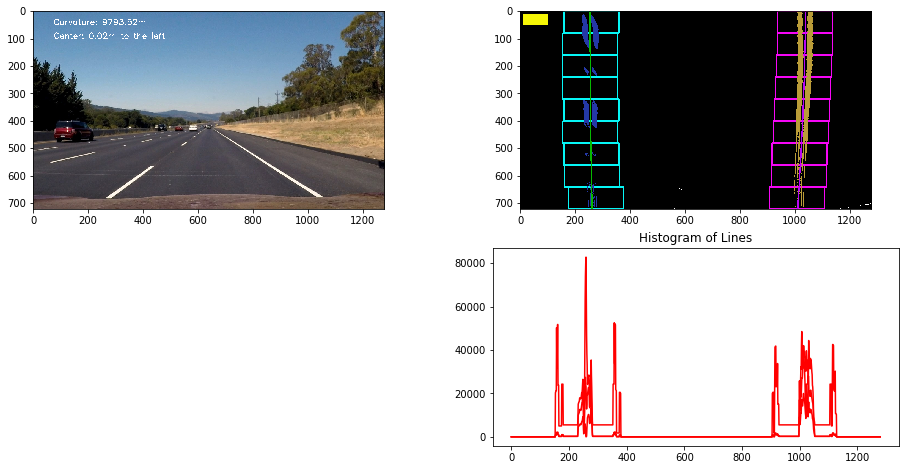

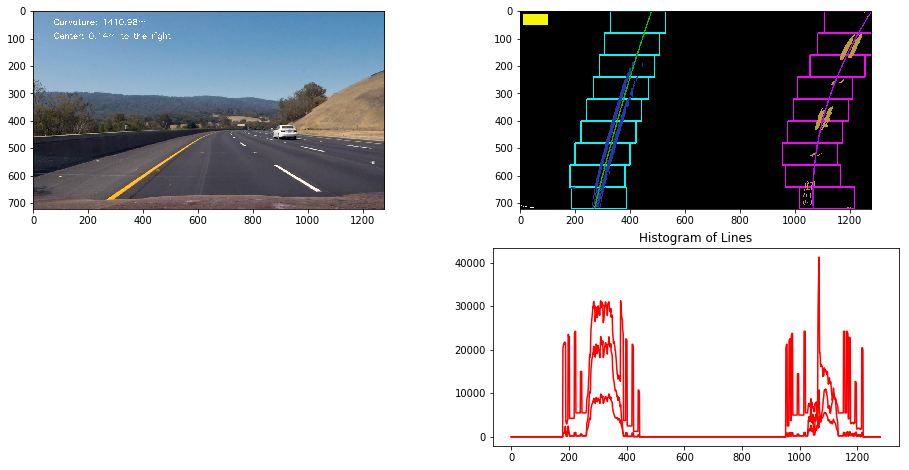

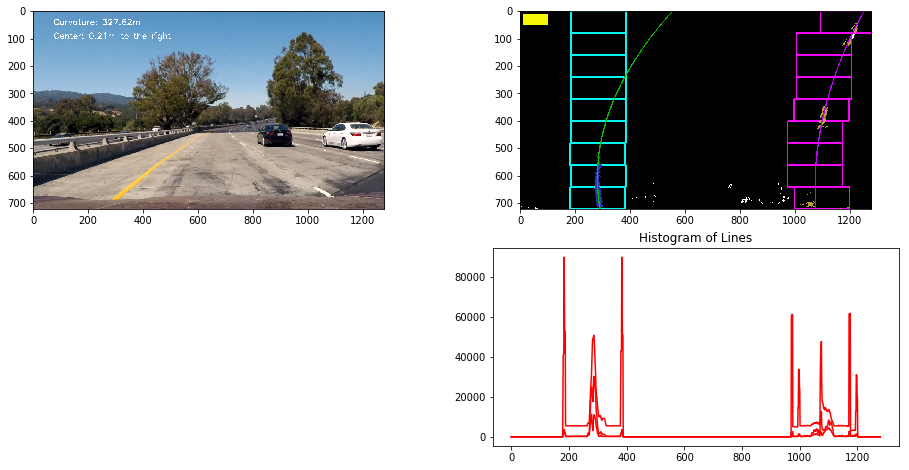

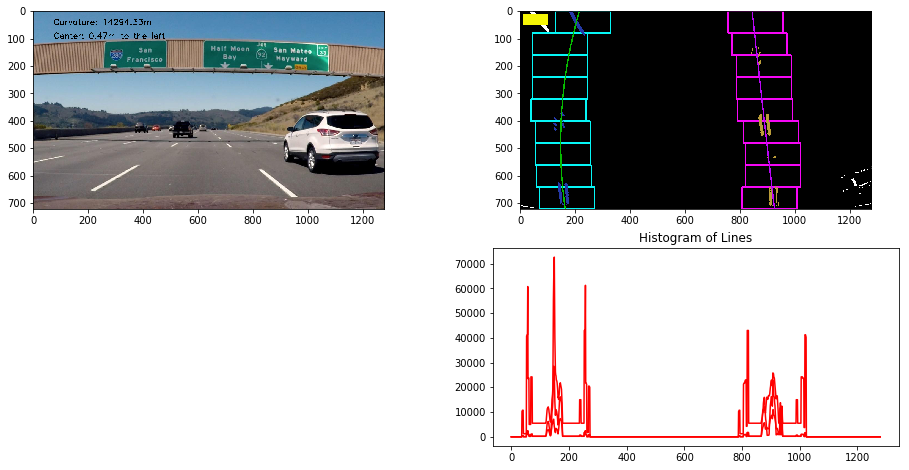

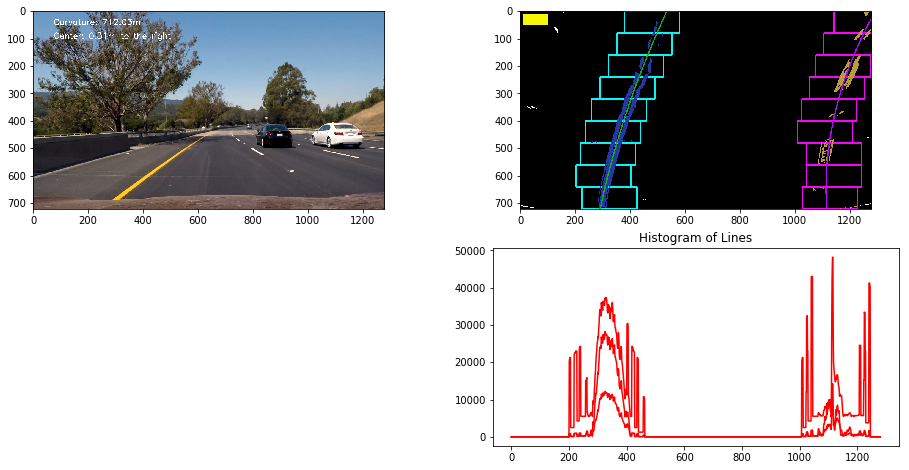

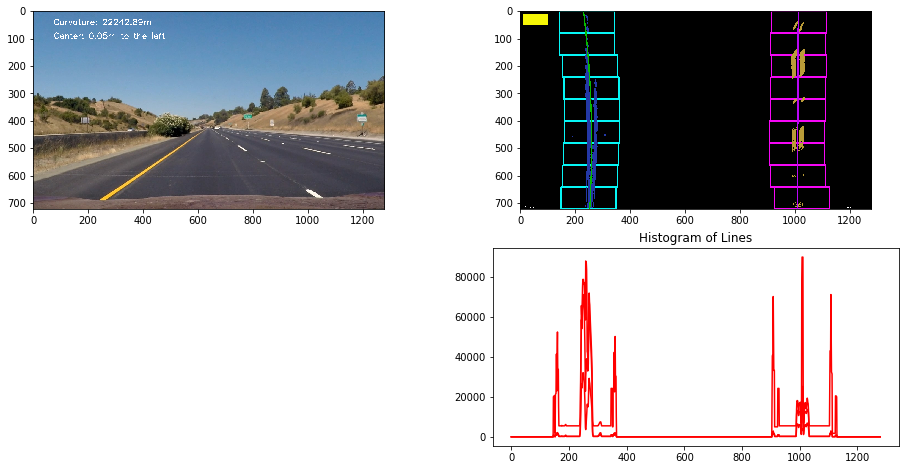

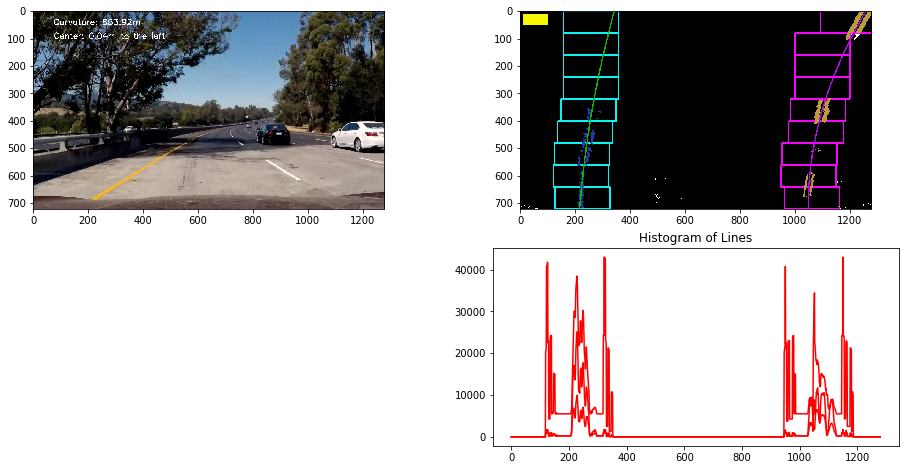

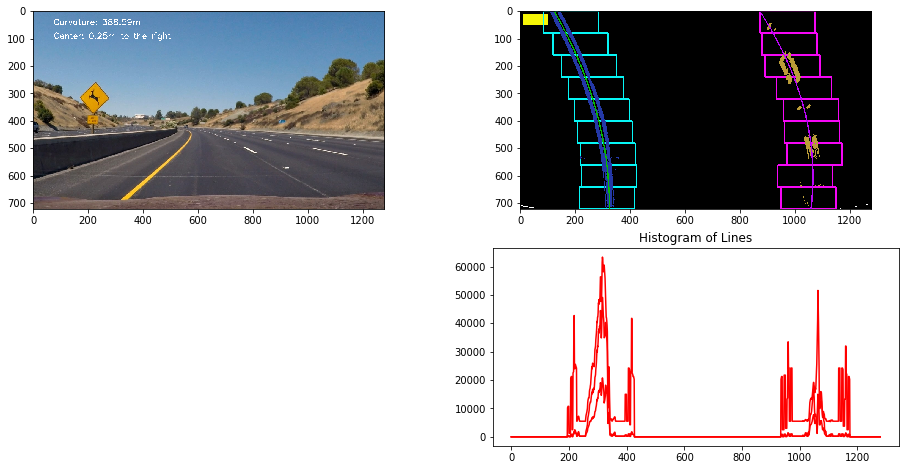

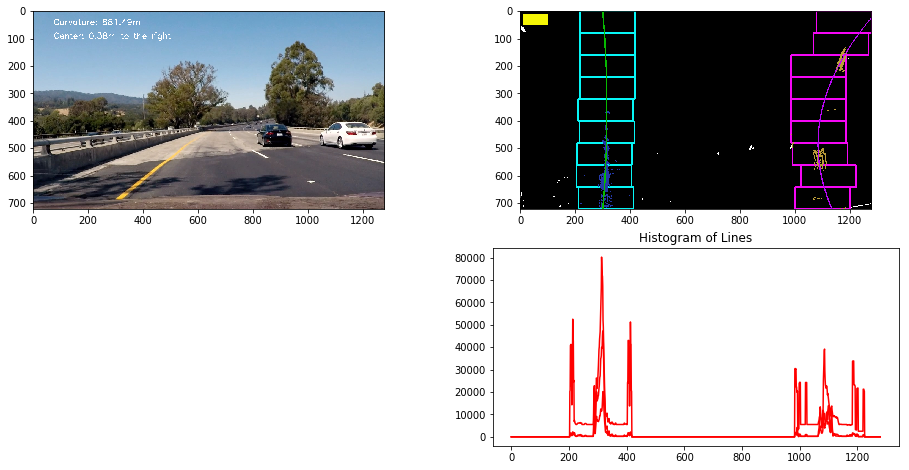

In [20]:
import numpy as np
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2


line = Line()


# Load our image
left_fit = None
right_fit = None


def find_lane_pixels(binary_warped, debug = False):
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(binary_warped.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        ### TO-DO: Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin  
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        if(debug):
            red = (250,10,10) 
            green = (10,250,10) 
            blue = (10,10,250) 
            cv2.rectangle(out_img, (10, 10), (100, 50), (blue), -1)
            # Draw the windows on the visualization image
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),
            (win_xleft_high,win_y_high),red, 3) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),
            (win_xright_high,win_y_high), green, 3) 

        


        # Identify the nonzero pixels in x and y within the window #
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]

        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window ###
        ### (`right` or `leftx_current`) on their mean position ###
        if(len(good_left_inds) > minpix):
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if(len(good_right_inds) > minpix):
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))


    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]


    return leftx, lefty, rightx, righty, out_img


def fit_polynomial(binary_warped, debug = False):
    
    # Find our lane pixels first
    leftx, lefty, rightx, righty, out_img = find_lane_pixels(binary_warped, debug = debug)
    
    #Fit a second order polynomial to each using `np.polyfit` ###
    print(np.shape(leftx))
    if(np.shape(leftx)[0] == 0 or np.shape(rightx)[0] == 0):
        print('Oh no didnt find any lane pixels')
        return None, None, None, np.dstack((binary_warped, binary_warped, binary_warped))
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = 1*ploty**2 + 1*ploty
        right_fitx = 1*ploty**2 + 1*ploty

    ## Visualization ##
    # Colors in the left and right lane regions
    blue = (10,10,250) 
    left_poly_color = (250,70,0)
    right_poly_color = (70,250,10)
    left_pixels_color = (220,200,90)
    right_pixels_color = (70,100,200)

    out_img[lefty, leftx] = left_pixels_color
    out_img[righty, rightx] = right_pixels_color
    
    draw_points_left = (np.asarray([left_fitx, ploty]).T).astype(np.int32) 
    draw_points_right = (np.asarray([right_fitx, ploty]).T).astype(np.int32) 

                
    cv2.polylines(out_img, [draw_points_left], False, color=(left_poly_color), thickness=3)
    
    cv2.polylines(out_img, [draw_points_right], False, color=(right_poly_color), thickness=3)
    
    # Plots the left and right polynomials on the lane lines
    #plt.plot(left_fitx, ploty, color='yellow')
    #plt.plot(right_fitx, ploty, color='cyan')
    #plt.imshow(out_img)
    line.plot_left = left_fitx
    line.plot_right = right_fitx
    line.ploty = ploty

    return ploty, left_fit, right_fit, out_img


# Test on the test images.
for file in files:
    if file[0:6] != "output":
        img = mpimg.imread("test_images/" + file)
        
        # Undistort the camera image using the mtx calculated from the chess board.
        undist = cv2.undistort(img, mtx, dist, None, mtx)
        # Transform image into a top down view.
        top_down, m, m_inverse = transform_lane_perspective(undist)
        # Use sob with saturation.
        color_sob = color_sob_pipeline(top_down)
        result = color_sob
        ploty, left_fit, right_fit, result = fit_polynomial(color_sob, debug = True)
        
        # Add Hud Text
        display_hud(img, ploty, left_fit, right_fit)   
            
                               
        histogram = hist(result)
        fig=plt.figure(figsize=(16, 8))
        rows = 2
        cols = 2
        fig.add_subplot(rows, cols, 1)
        plt.imshow(img) 
        fig.add_subplot(rows, cols, 2)
        plt.imshow(result)
        fig.add_subplot(rows, cols, 4)
        plt.title("Histogram of Lines")
        plt.plot(histogram, color = 'red')
        r,g,b =  cv2.split(result)
        result = cv2.merge((b,g,r))
        cv2.imwrite("output_images/output_curve_window_"+file, result)



# Searching for Line based on last curve position

[]
fresh
(3238,)
Center: 0.21m 
 Curvature: 327.6188676908297
Curvature: 327.6188676908297 


/root/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:118: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


True

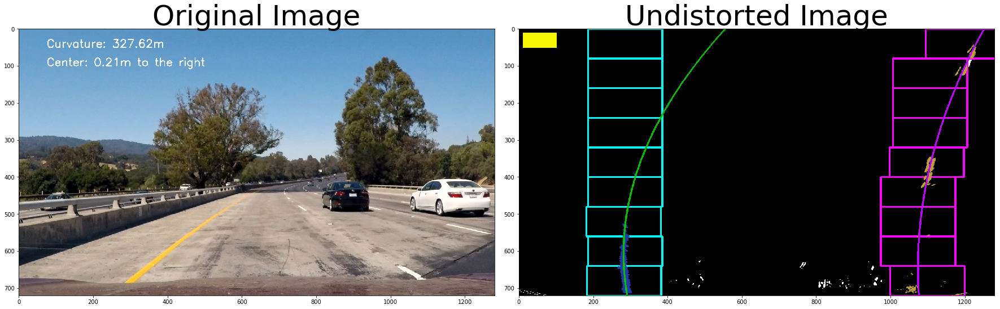

In [21]:

def fit_poly(img_shape, leftx, lefty, rightx, righty):
    # Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, img_shape[0]-1, img_shape[0])
    # Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    line.plot_left = left_fitx
    line.plot_right = right_fitx
    line.ploty = ploty
    line.current_left_fit = left_fit
    line.current_right_fit = right_fit
    return left_fitx, right_fitx, ploty

def search_around_poly(binary_warped, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    # The quiz grader expects 100 here, but feel free to tune on your own!
    margin = 100

    # Grab activated pixels
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### TO-DO: Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### Hint: consider the window areas for the similarly named variables ###
    ### in the previous quiz, but change the windows to our new search area ###
    left_xs = left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2]
    right_xs = right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2]
    left_lane_inds = ((nonzerox > (left_xs - margin)) & (nonzerox < (left_xs + margin)))
    right_lane_inds = ((nonzerox > (right_xs - margin)) & (nonzerox < (right_xs + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    left_fitx, right_fitx, ploty = fit_poly(binary_warped.shape, leftx, lefty, rightx, righty)
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    # Plot the polynomial lines onto the image
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    ## End visualization steps ##

    return ploty, left_fitx, right_fitx, out_img

def fast_fit_poly(img, debug = False):
    print(line.current_left_fit)
    if(len(line.current_left_fit) == 0 or len(line.current_right_fit) == 0):
        # Calculate fresh.
        print('fresh')
        ploty, left_fit, right_fit, out_img = fit_polynomial(img, debug)
        line.current_left_fit = left_fit
        line.current_right_fit = right_fit
        return ploty, left_fit, right_fit, out_img
        
    else:
        # Search around the last frame. 
        print('fast')
        ploty, left_fit, right_fit, out_img =  search_around_poly(img,
                                                                  line.current_left_fit, 
                                                                  line.current_right_fit)

        return ploty, left_fit, right_fit, out_img
        
# Run image through the pipeline
# Note that in your project, you'll also want to feed in the previous fits
line = Line()
image = mpimg.imread('test_images/test1.jpg')

# Undistort the camera image using the mtx calculated from the chess board.
# Undistort the camera image using the mtx calculated from the chess board.
undist = cv2.undistort(image, mtx, dist, None, mtx)
# Transform image into a top down view.
top_down, m, m_inverse = transform_lane_perspective(undist)
# Use sob with saturation.
color_sob = color_sob_pipeline(top_down)
result = color_sob

ploty, left_fit, right_fit, result = fast_fit_poly(color_sob, debug = True)
curvature_text = 'Curvature: {} '.format(measure_curvature(ploty, left_fit, right_fit))
display_hud(image, ploty, left_fit, right_fit) 
print(curvature_text)
# Plot the result
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(image)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(result)
ax2.set_title('Undistorted Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)    
  

# View your output
plt.imshow(result)

r,g,b =  cv2.split(result)
result = cv2.merge((b,g,r))
cv2.imwrite("output_images/output_curve_window_"+file, result)

# Project back 

(720,)
(720,)
(720,)


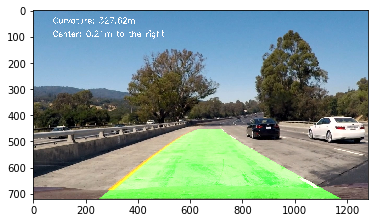

In [22]:
def project_back(img, lane, inverse_matrix, debug = False):
    r,g,b =  cv2.split(lane)
    lane = cv2.merge((b,g,r))
    lane_size = (lane.shape[1], lane.shape[0])
    background = np.asarray(img, np.float64())
    if(debug):
        # Warp the images back
        lane_image_space = cv2.warpPerspective(lane, inverse_matrix, lane_size, flags=cv2.INTER_LINEAR)

        lane_image_space = np.asarray(lane_image_space, np.float64())
        overlay = cv2.addWeighted(background,1,lane_image_space,0.7,0,  dtype=cv2.CV_8UC1)

    else:
        mask = np.zeros_like(lane)
        print(np.shape(line.plot_left))
        print(np.shape(line.plot_right))
        print(np.shape(line.ploty))
        left_points = np.array([np.transpose(np.vstack([line.plot_left, line.ploty]))])
        right_points = np.array([np.flipud(np.transpose(np.vstack([line.plot_right, line.ploty])))])
        points = np.hstack((left_points, right_points))
        cv2.fillPoly(mask, np.int_([points]), (0, 255, 0))
        mask_image_space = cv2.warpPerspective(mask, inverse_matrix, lane_size, flags=cv2.INTER_LINEAR)
        overlay = cv2.addWeighted(background,1,mask_image_space,0.7,0,  dtype=cv2.CV_8UC1)


    return overlay

overlay = project_back(image, result, m_inverse)
plt.imshow(overlay)

# The Pipeline

In [23]:
def process_pipeline(image):
    # Undistort the camera image using the mtx calculated from the chess board.
    undist = cv2.undistort(image, mtx, dist, None, mtx)
    # Transform image into a top down view.
    top_down, m, m_inverse = transform_lane_perspective(undist)
    # Use sob with saturation.
    binary = color_sob_pipeline(top_down)
    #curves = fit_polynomial(binary)
    ploty, left_fit, right_fit, curves = fast_fit_poly(binary, debug = True)
    overlay = project_back(image, curves, m_inverse)
    curvature_text = 'Curvature: {} '.format(measure_curvature(ploty, left_fit, right_fit))
    display_hud(overlay, ploty, left_fit, right_fit) 
    print(curvature_text)
    result = overlay
    return result

# Run the pipeline

[]
fresh
(9282,)
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 9793.516799960893
Curvature: 9793.516799960893 


/root/miniconda3/envs/carnd-term1/lib/python3.5/site-packages/ipykernel_launcher.py:118: FutureWarning: comparison to `None` will result in an elementwise object comparison in the future.


[]
fresh
(12755,)
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 1410.9816919760594
Curvature: 1410.9816919760594 
[]
fresh
(3238,)
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 327.6188676908297
Curvature: 327.6188676908297 
[]
fresh
(3462,)
(720,)
(720,)
(720,)
Center: -0.47m 
 Curvature: 14294.329342467823
Curvature: 14294.329342467823 
[]
fresh
(17456,)
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 712.0271989475611
Curvature: 712.0271989475611 
[]
fresh
(14605,)
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 22242.891972023186
Curvature: 22242.891972023186 
[]
fresh
(4168,)
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 853.9152527384675
Curvature: 853.9152527384675 
[]
fresh
(21317,)
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 388.5889427407934
Curvature: 388.5889427407934 
[]
fresh
(5556,)
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 881.4926585254752
Curvature: 881.4926585254752 


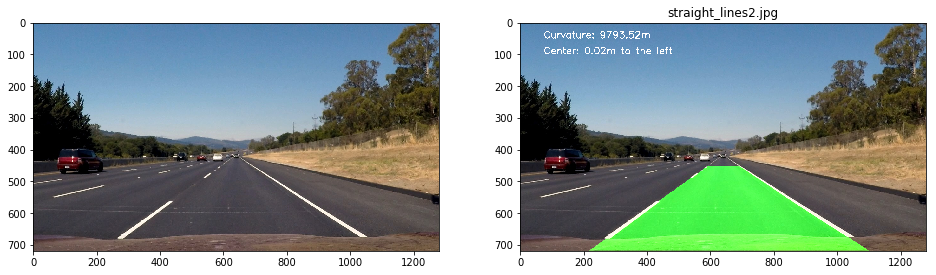

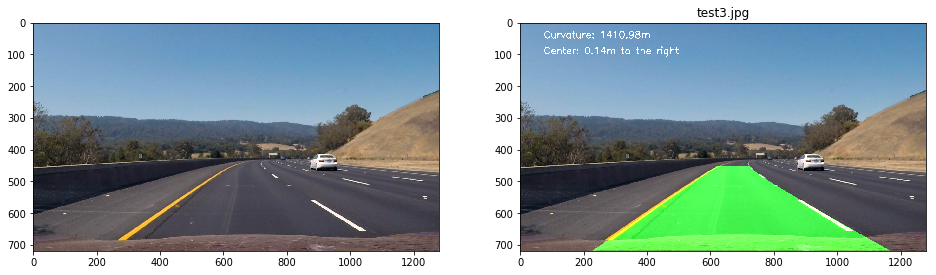

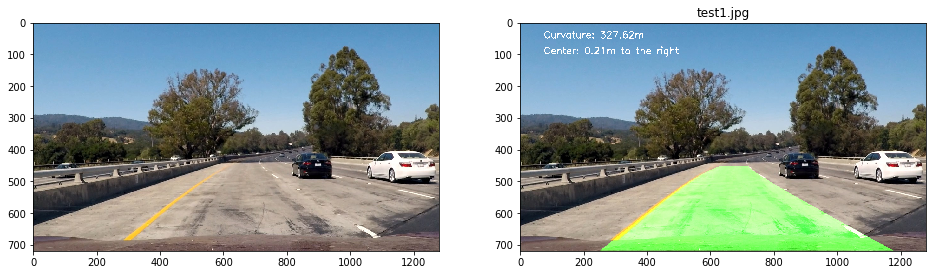

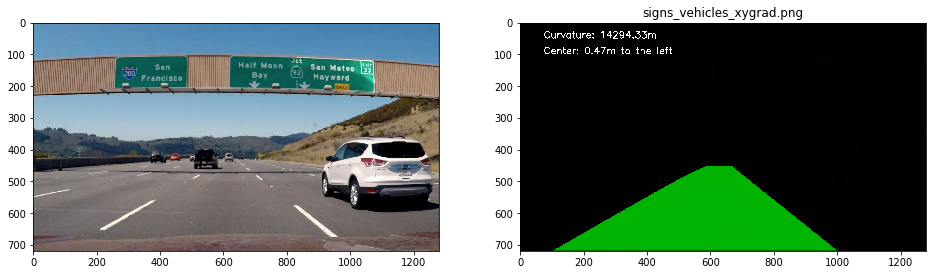

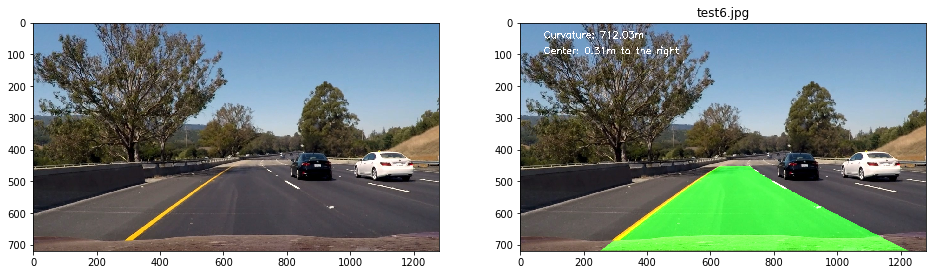

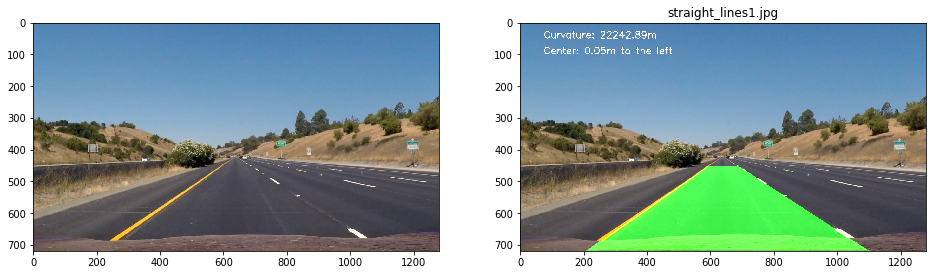

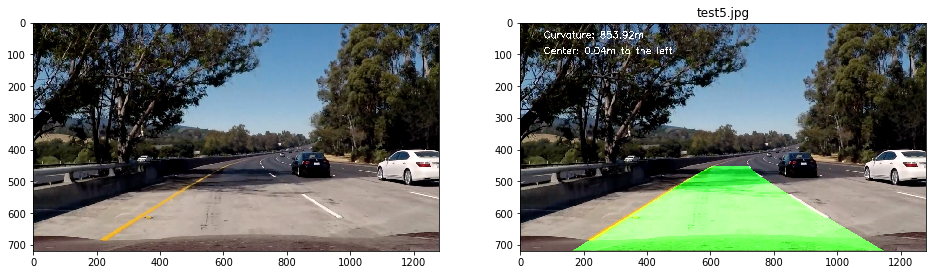

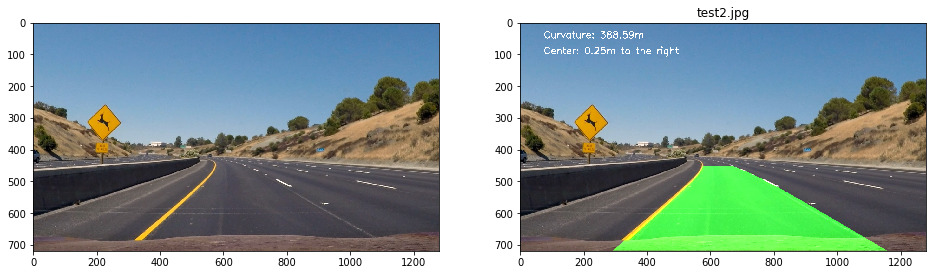

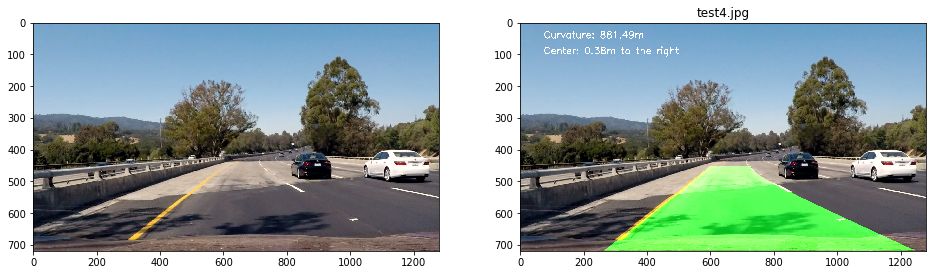

In [24]:

# Test on the test images.
for file in files:
    if file[0:6] != "output":
        img = mpimg.imread("test_images/" + file)
        line = Line()
        result = process_pipeline(img)
        fig=plt.figure(figsize=(16, 8))
        rows = 1
        cols = 2
        fig.add_subplot(rows, cols, 1)
        plt.imshow(img) 
        fig.add_subplot(rows, cols, 2)
        plt.title(file)
        plt.imshow(result)
        
        r,g,b =  cv2.split(result)
        result = cv2.merge((b,g,r))
        cv2.imwrite("output_images/output_pipeline_"+file, result)

# Test on Video

In [25]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML


Imageio: 'ffmpeg.linux64' was not found on your computer; downloading it now.
Try 1. Download from https://github.com/imageio/imageio-binaries/raw/master/ffmpeg/ffmpeg.linux64 (27.2 MB)
Downloading: 8192/28549024 bytes (0.0122880/28549024 bytes (0.4253952/28549024 bytes (0.9417792/28549024 bytes (1.5548864/28549024 bytes (1.9630784/28549024 bytes (2.2679936/28549024 bytes (2.4745472/28549024 bytes (2.6811008/28549024 bytes (2.8876544/28549024 bytes (3.1925696/28549024 bytes (3.2991232/28549024 bytes (3.51056768/28549024 bytes (3.7%1122304/28549024 bytes (3.9%1187840/28549024 bytes (4.2%1269760/28549024 bytes (4.4%1351680/28549024 bytes (4.7%1433600/28549024 bytes (5.0%1531904/28549024 bytes (5.4%1613824/28549024 bytes (5.7%1646592/28549024 bytes (5.8%1777664/28549024 bytes (6.2%1875968/28549024 bytes (6.6%1941504/28549024 bytes (6.8%2023424/28549024 bytes (7.1%2056192/28549024 bytes (7.2%2154496/28549024 bytes (7.5%2269184/28549024 bytes (7.9%2424832/28549024 bytes (8.5%2580480/2854902

In [26]:


def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    result  = process_pipeline(image)
    return result



## First Video

[]
fresh
(5976,)
(540,)
(540,)
(540,)
Center: -0.01m 
 Curvature: 969.6141630695898
Curvature: 969.6141630695898 
[MoviePy] >>>> Building video test_videos_output/solidWhiteRight.mp4
[MoviePy] Writing video test_videos_output/solidWhiteRight.mp4


  0%|          | 1/222 [00:00<01:21,  2.70it/s]

[ -2.45264668e-04   3.08753678e-01   1.26156988e+02]
fast
(540,)
(540,)
(540,)
Center: 0.00m 
 Curvature: 105.0966784807158
Curvature: 105.0966784807158 


  1%|          | 2/222 [00:00<01:14,  2.94it/s]

[ -1.46792891e-04   2.68220824e-01   1.28835765e+02]
fast
(540,)
(540,)
(540,)
Center: 0.00m 
 Curvature: 104.39084214976332
Curvature: 104.39084214976332 


  1%|▏         | 3/222 [00:00<01:09,  3.14it/s]

[ -1.61821895e-04   2.75751327e-01   1.30791539e+02]
fast
(540,)
(540,)
(540,)
Center: 0.00m 
 Curvature: 104.18973921253946
Curvature: 104.18973921253946 


  2%|▏         | 4/222 [00:01<01:05,  3.30it/s]

[ -2.01889255e-04   3.04526474e-01   1.26836712e+02]
fast
(540,)
(540,)
(540,)
Center: -0.01m 
 Curvature: 104.20637251764187
Curvature: 104.20637251764187 


  2%|▏         | 5/222 [00:01<01:02,  3.46it/s]

[ -2.64845110e-04   3.38049376e-01   1.23047065e+02]
fast
(540,)
(540,)
(540,)
Center: -0.06m 
 Curvature: 104.05106330931129
Curvature: 104.05106330931129 


  3%|▎         | 6/222 [00:01<01:00,  3.56it/s]

[ -6.32853284e-04   5.46465184e-01   9.66887507e+01]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 104.8870343271224
Curvature: 104.8870343271224 


  3%|▎         | 7/222 [00:01<00:58,  3.68it/s]

[ -8.83850881e-04   7.10739179e-01   6.93897809e+01]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 104.8404976629951
Curvature: 104.8404976629951 


  4%|▎         | 8/222 [00:02<00:57,  3.74it/s]

[ -9.51962562e-04   7.68337125e-01   5.72077655e+01]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 106.72591735346012
Curvature: 106.72591735346012 


  4%|▍         | 9/222 [00:02<00:56,  3.75it/s]

[ -2.56962845e-04   3.08616868e-01   1.23630850e+02]
fast
(540,)
(540,)
(540,)
Center: -0.03m 
 Curvature: 106.13450737421624
Curvature: 106.13450737421624 


  5%|▍         | 10/222 [00:02<00:56,  3.77it/s]

[ -1.40129247e-04   2.33632982e-01   1.37024982e+02]
fast
(540,)
(540,)
(540,)
Center: -0.03m 
 Curvature: 100.59425925050263
Curvature: 100.59425925050263 


  5%|▍         | 11/222 [00:02<00:55,  3.83it/s]

[ -1.55629504e-04   2.10180289e-01   1.55974414e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 95.06798315512609
Curvature: 95.06798315512609 


  5%|▌         | 12/222 [00:03<00:54,  3.85it/s]

[ -1.83455668e-04   1.99730813e-01   1.73056198e+02]
fast
(540,)
(540,)
(540,)
Center: -0.03m 
 Curvature: 93.286965543339
Curvature: 93.286965543339 


  6%|▌         | 13/222 [00:03<00:54,  3.86it/s]

[ -1.23534767e-04   1.67622135e-01   1.78957528e+02]
fast
(540,)
(540,)
(540,)
Center: -0.02m 
 Curvature: 93.8494352513877
Curvature: 93.8494352513877 


  6%|▋         | 14/222 [00:03<00:54,  3.80it/s]

[ -5.05877198e-05   1.53212803e-01   1.69760079e+02]
fast
(540,)
(540,)
(540,)
Center: -0.03m 
 Curvature: 97.52421464514966
Curvature: 97.52421464514966 


  7%|▋         | 15/222 [00:04<00:53,  3.85it/s]

[ -8.16931540e-05   2.06856346e-01   1.46956072e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 100.94853388061419
Curvature: 100.94853388061419 


  7%|▋         | 16/222 [00:04<00:53,  3.83it/s]

[ -1.74116185e-04   2.88977163e-01   1.22108307e+02]
fast
(540,)
(540,)
(540,)
Center: -0.07m 
 Curvature: 105.68176695604497
Curvature: 105.68176695604497 


  8%|▊         | 17/222 [00:04<00:59,  3.43it/s]

[ -2.84799966e-04   3.63873696e-01   1.02070285e+02]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 106.09332084542399
Curvature: 106.09332084542399 


  8%|▊         | 18/222 [00:04<00:57,  3.55it/s]

[ -5.00902096e-04   4.86276684e-01   8.46957793e+01]
fast
(540,)
(540,)
(540,)
Center: -0.13m 
 Curvature: 103.61414958021831
Curvature: 103.61414958021831 


  9%|▊         | 19/222 [00:05<00:55,  3.68it/s]

[ -8.12596487e-04   6.66156743e-01   6.65366774e+01]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 99.70387042658768
Curvature: 99.70387042658768 


  9%|▉         | 20/222 [00:05<00:53,  3.78it/s]

[ -8.54137102e-04   6.89291477e-01   7.04652682e+01]
fast
(540,)
(540,)
(540,)
Center: -0.07m 
 Curvature: 98.75786425157312
Curvature: 98.75786425157312 


  9%|▉         | 21/222 [00:05<00:53,  3.74it/s]

[ -2.34363998e-04   2.46260612e-01   1.48955553e+02]
fast
(540,)
(540,)
(540,)
Center: -0.06m 
 Curvature: 97.29420985452651
Curvature: 97.29420985452651 


 10%|▉         | 22/222 [00:05<00:52,  3.80it/s]

[ -2.07341839e-04   2.20096795e-01   1.62073395e+02]
fast
(540,)
(540,)
(540,)
Center: -0.05m 
 Curvature: 97.23842245458448
Curvature: 97.23842245458448 


 10%|█         | 23/222 [00:06<00:51,  3.83it/s]

[ -2.28848641e-04   2.36142163e-01   1.61316659e+02]
fast
(540,)
(540,)
(540,)
Center: -0.05m 
 Curvature: 98.03600639479139
Curvature: 98.03600639479139 


 11%|█         | 24/222 [00:06<00:51,  3.84it/s]

[ -2.42777392e-04   2.52332321e-01   1.56936657e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 99.64349344164489
Curvature: 99.64349344164489 


 11%|█▏        | 25/222 [00:06<00:51,  3.84it/s]

[ -2.37601102e-04   2.66671579e-01   1.48986193e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 100.4211277918576
Curvature: 100.4211277918576 


 12%|█▏        | 26/222 [00:06<00:51,  3.83it/s]

[ -2.42149929e-04   2.84424427e-01   1.42110928e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 101.14425606949708
Curvature: 101.14425606949708 


 12%|█▏        | 27/222 [00:07<00:50,  3.89it/s]

[ -2.86196340e-04   3.14150079e-01   1.37991237e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 100.50366757798795
Curvature: 100.50366757798795 


 13%|█▎        | 28/222 [00:07<00:49,  3.89it/s]

[ -3.72982146e-04   3.68125993e-01   1.32180954e+02]
fast
(540,)
(540,)
(540,)
Center: -0.06m 
 Curvature: 100.47586606183619
Curvature: 100.47586606183619 


 13%|█▎        | 29/222 [00:07<00:51,  3.77it/s]

[ -5.31217180e-04   4.66341543e-01   1.18110262e+02]
fast
(540,)
(540,)
(540,)
Center: -0.11m 
 Curvature: 99.29038174100015
Curvature: 99.29038174100015 


 14%|█▎        | 30/222 [00:08<00:50,  3.79it/s]

[ -9.85340311e-04   7.39411461e-01   8.18388192e+01]
fast
(540,)
(540,)
(540,)
Center: -0.13m 
 Curvature: 100.34268210546058
Curvature: 100.34268210546058 


 14%|█▍        | 31/222 [00:08<00:49,  3.87it/s]

[ -1.21744189e-03   9.11310648e-01   4.95787470e+01]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 102.3565013365206
Curvature: 102.3565013365206 


 14%|█▍        | 32/222 [00:08<00:48,  3.90it/s]

[ -7.89801799e-04   6.48212829e-01   8.11569754e+01]
fast
(540,)
(540,)
(540,)
Center: -0.05m 
 Curvature: 103.74757731324763
Curvature: 103.74757731324763 


 15%|█▍        | 33/222 [00:08<00:48,  3.93it/s]

[ -2.65456370e-04   3.26283348e-01   1.22978263e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 104.76663240809906
Curvature: 104.76663240809906 


 15%|█▌        | 34/222 [00:09<00:47,  3.95it/s]

[ -1.86877861e-04   2.91533074e-01   1.24698706e+02]
fast
(540,)
(540,)
(540,)
Center: -0.03m 
 Curvature: 104.09086727084906
Curvature: 104.09086727084906 


 16%|█▌        | 35/222 [00:09<00:47,  3.96it/s]

[ -1.87666648e-04   2.92252207e-01   1.26894735e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 101.73307130376583
Curvature: 101.73307130376583 


 16%|█▌        | 36/222 [00:09<00:46,  3.99it/s]

[ -1.85565850e-04   2.79305574e-01   1.35395729e+02]
fast
(540,)
(540,)
(540,)
Center: -0.03m 
 Curvature: 100.60285275003741
Curvature: 100.60285275003741 


 17%|█▋        | 37/222 [00:09<00:46,  3.99it/s]

[ -2.23876624e-04   3.01683271e-01   1.36433767e+02]
fast
(540,)
(540,)
(540,)
Center: -0.02m 
 Curvature: 100.56973413409497
Curvature: 100.56973413409497 


 17%|█▋        | 38/222 [00:10<00:46,  3.97it/s]

[ -2.09952743e-04   3.02376275e-01   1.35742087e+02]
fast
(540,)
(540,)
(540,)
Center: -0.02m 
 Curvature: 101.23346889755823
Curvature: 101.23346889755823 


 18%|█▊        | 39/222 [00:10<00:45,  3.99it/s]

[ -2.32528251e-04   3.24552806e-01   1.30408486e+02]
fast
(540,)
(540,)
(540,)
Center: -0.02m 
 Curvature: 103.03207374303726
Curvature: 103.03207374303726 


 18%|█▊        | 40/222 [00:10<00:45,  3.97it/s]

[ -2.55191834e-04   3.53378686e-01   1.20175809e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 104.69088890571831
Curvature: 104.69088890571831 


 18%|█▊        | 41/222 [00:10<00:45,  3.98it/s]

[ -3.36370522e-04   4.13584133e-01   1.06488001e+02]
fast
(540,)
(540,)
(540,)
Center: -0.07m 
 Curvature: 105.47997516757607
Curvature: 105.47997516757607 


 19%|█▉        | 42/222 [00:11<00:45,  3.96it/s]

[ -5.78675916e-04   5.54306194e-01   8.42589358e+01]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 105.51035481592345
Curvature: 105.51035481592345 


 19%|█▉        | 43/222 [00:11<00:45,  3.93it/s]

[ -6.16271721e-04   5.84370112e-01   7.56660434e+01]
fast
(540,)
(540,)
(540,)
Center: -0.07m 
 Curvature: 105.8039956586895
Curvature: 105.8039956586895 


 20%|█▉        | 44/222 [00:11<00:44,  3.97it/s]

[ -5.08274093e-04   5.35243012e-01   7.64208595e+01]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 105.41194881569409
Curvature: 105.41194881569409 


 20%|██        | 45/222 [00:11<00:44,  3.95it/s]

[ -6.60973661e-04   6.55707534e-01   5.19815220e+01]
fast
(540,)
(540,)
(540,)
Center: -0.08m 
 Curvature: 104.2140914130913
Curvature: 104.2140914130913 


 21%|██        | 46/222 [00:12<00:44,  3.99it/s]

[ -6.02088833e-04   6.22197199e-01   5.49965086e+01]
fast
(540,)
(540,)
(540,)
Center: -0.06m 
 Curvature: 105.13252685662066
Curvature: 105.13252685662066 


 21%|██        | 47/222 [00:12<00:44,  3.97it/s]

[ -1.83205098e-04   3.38614715e-01   9.67884742e+01]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 105.80873584258117
Curvature: 105.80873584258117 


 22%|██▏       | 48/222 [00:12<00:44,  3.93it/s]

[ -8.56728721e-05   2.89914964e-01   9.96879240e+01]
fast
(540,)
(540,)
(540,)
Center: -0.03m 
 Curvature: 104.68320841392554
Curvature: 104.68320841392554 


 22%|██▏       | 49/222 [00:12<00:44,  3.91it/s]

[  2.78075846e-06   2.38337715e-01   1.07917734e+02]
fast
(540,)
(540,)
(540,)
Center: -0.02m 
 Curvature: 103.46443920355507
Curvature: 103.46443920355507 


 23%|██▎       | 50/222 [00:13<00:44,  3.90it/s]

[  6.06488213e-05   1.98430483e-01   1.15642890e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 103.52491905754462
Curvature: 103.52491905754462 


 23%|██▎       | 51/222 [00:13<00:44,  3.87it/s]

[ -9.04011268e-06   2.33026379e-01   1.12361717e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 102.37017012777565
Curvature: 102.37017012777565 


 23%|██▎       | 52/222 [00:13<00:43,  3.87it/s]

[ -5.43896493e-05   2.53915851e-01   1.10355733e+02]
fast
(540,)
(540,)
(540,)
Center: -0.06m 
 Curvature: 102.50935946959397
Curvature: 102.50935946959397 


 24%|██▍       | 53/222 [00:13<00:43,  3.86it/s]

[ -1.54248886e-04   3.08819620e-01   1.01190928e+02]
fast
(540,)
(540,)
(540,)
Center: -0.11m 
 Curvature: 101.58523135509847
Curvature: 101.58523135509847 


 24%|██▍       | 54/222 [00:14<00:43,  3.87it/s]

[ -4.96266563e-04   4.89950675e-01   8.08092043e+01]
fast
(540,)
(540,)
(540,)
Center: -0.14m 
 Curvature: 99.95756963262265
Curvature: 99.95756963262265 


 25%|██▍       | 55/222 [00:14<00:43,  3.88it/s]

[ -7.42463282e-04   6.41494102e-01   5.97963193e+01]
fast
(540,)
(540,)
(540,)
Center: -0.13m 
 Curvature: 98.9519069828234
Curvature: 98.9519069828234 


 25%|██▌       | 56/222 [00:14<00:42,  3.88it/s]

[ -7.93775468e-04   6.87186600e-01   5.05733646e+01]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 97.84407840450844
Curvature: 97.84407840450844 


 26%|██▌       | 57/222 [00:14<00:41,  3.93it/s]

[ -2.01321768e-04   2.79165403e-01   1.16318242e+02]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 95.80185577978304
Curvature: 95.80185577978304 


 26%|██▌       | 58/222 [00:15<00:41,  3.93it/s]

[ -1.81016133e-04   2.54176832e-01   1.27168570e+02]
fast
(540,)
(540,)
(540,)
Center: -0.08m 
 Curvature: 93.85876589659459
Curvature: 93.85876589659459 


 27%|██▋       | 59/222 [00:15<00:41,  3.97it/s]

[ -1.50305976e-04   2.24518496e-01   1.36574660e+02]
fast
(540,)
(540,)
(540,)
Center: -0.08m 
 Curvature: 93.90238819777429
Curvature: 93.90238819777429 


 27%|██▋       | 60/222 [00:15<00:41,  3.94it/s]

[ -1.61833973e-04   2.39785525e-01   1.31696284e+02]
fast
(540,)
(540,)
(540,)
Center: -0.08m 
 Curvature: 94.32174512237616
Curvature: 94.32174512237616 


 27%|██▋       | 61/222 [00:15<00:40,  3.95it/s]

[ -1.55265743e-04   2.43367181e-01   1.28527819e+02]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 92.68856256176431
Curvature: 92.68856256176431 


 28%|██▊       | 62/222 [00:16<00:40,  3.96it/s]

[ -2.30866383e-04   2.87403607e-01   1.24917040e+02]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 92.61383089389624
Curvature: 92.61383089389624 


 28%|██▊       | 63/222 [00:16<00:40,  3.95it/s]

[ -2.62771796e-04   3.11968786e-01   1.20869870e+02]
fast
(540,)
(540,)
(540,)
Center: -0.11m 
 Curvature: 91.48353687541187
Curvature: 91.48353687541187 


 29%|██▉       | 64/222 [00:16<00:40,  3.93it/s]

[ -4.19633513e-04   4.01944474e-01   1.10133134e+02]
fast
(540,)
(540,)
(540,)
Center: -0.13m 
 Curvature: 91.35315952248155
Curvature: 91.35315952248155 


 29%|██▉       | 65/222 [00:16<00:39,  3.97it/s]

[ -6.34152322e-04   5.31610987e-01   9.26646746e+01]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 91.02322619899844
Curvature: 91.02322619899844 


 30%|██▉       | 66/222 [00:17<00:39,  3.97it/s]

[ -2.51330901e-04   2.98851669e-01   1.22690168e+02]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 91.46294954892807
Curvature: 91.46294954892807 


 30%|███       | 67/222 [00:17<00:38,  4.00it/s]

[ -2.09792675e-04   2.85253443e-01   1.18923916e+02]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 93.8592290035904
Curvature: 93.8592290035904 


 31%|███       | 68/222 [00:17<00:38,  3.99it/s]

[ -4.81399140e-04   4.89531606e-01   7.73683173e+01]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 94.55136343246551
Curvature: 94.55136343246551 


 31%|███       | 69/222 [00:17<00:38,  3.96it/s]

[ -2.30336385e-04   3.28750493e-01   9.82403826e+01]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 93.25072050747366
Curvature: 93.25072050747366 


 32%|███▏      | 70/222 [00:18<00:38,  3.94it/s]

[ -2.15376174e-04   3.13857072e-01   1.03431114e+02]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 92.71666893276755
Curvature: 92.71666893276755 


 32%|███▏      | 71/222 [00:18<00:38,  3.93it/s]

[ -1.69510300e-04   2.74612392e-01   1.12222811e+02]
fast
(540,)
(540,)
(540,)
Center: -0.11m 
 Curvature: 93.62627684771442
Curvature: 93.62627684771442 


 32%|███▏      | 72/222 [00:18<00:37,  3.97it/s]

[ -1.91353809e-04   2.88037686e-01   1.08165611e+02]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 94.06726586507914
Curvature: 94.06726586507914 


 33%|███▎      | 73/222 [00:18<00:37,  3.96it/s]

[ -2.16788418e-04   3.06438666e-01   1.03124493e+02]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 92.88163649128383
Curvature: 92.88163649128383 


 33%|███▎      | 74/222 [00:19<00:37,  3.99it/s]

[ -2.63973267e-04   3.29047255e-01   1.03101720e+02]
fast
(540,)
(540,)
(540,)
Center: -0.11m 
 Curvature: 92.03463029223863
Curvature: 92.03463029223863 


 34%|███▍      | 75/222 [00:19<00:36,  3.99it/s]

[ -2.98566171e-04   3.53061398e-01   1.02489191e+02]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 92.01986972975601
Curvature: 92.01986972975601 


 34%|███▍      | 76/222 [00:19<00:36,  3.96it/s]

[ -3.74775232e-04   4.02599466e-01   9.38315649e+01]
fast
(540,)
(540,)
(540,)
Center: -0.16m 
 Curvature: 93.09344591135871
Curvature: 93.09344591135871 


 35%|███▍      | 77/222 [00:19<00:36,  4.00it/s]

[ -5.82973723e-04   5.31221323e-01   7.11306084e+01]
fast
(540,)
(540,)
(540,)
Center: -0.22m 
 Curvature: 92.79817770182333
Curvature: 92.79817770182333 


 35%|███▌      | 78/222 [00:20<00:42,  3.41it/s]

[ -9.75797843e-04   7.61559453e-01   3.83347669e+01]
fast
(540,)
(540,)
(540,)
Center: -0.18m 
 Curvature: 92.40355689875467
Curvature: 92.40355689875467 


 36%|███▌      | 79/222 [00:20<00:41,  3.41it/s]

[ -7.90173665e-04   6.78312882e-01   4.25944347e+01]
fast
(540,)
(540,)
(540,)
Center: -0.15m 
 Curvature: 92.1863016876151
Curvature: 92.1863016876151 


 36%|███▌      | 80/222 [00:20<00:39,  3.55it/s]

[ -3.77662828e-04   4.19893912e-01   7.90557751e+01]
fast
(540,)
(540,)
(540,)
Center: -0.13m 
 Curvature: 92.44732568379585
Curvature: 92.44732568379585 


 36%|███▋      | 81/222 [00:21<00:41,  3.37it/s]

[ -2.17102518e-04   3.25558996e-01   9.06135553e+01]
fast
(540,)
(540,)
(540,)
Center: -0.13m 
 Curvature: 92.92960580267727
Curvature: 92.92960580267727 


 37%|███▋      | 82/222 [00:21<00:43,  3.23it/s]

[ -2.19656771e-04   3.36011010e-01   8.65831358e+01]
fast
(540,)
(540,)
(540,)
Center: -0.14m 
 Curvature: 93.12402254201658
Curvature: 93.12402254201658 


 37%|███▋      | 83/222 [00:21<00:41,  3.36it/s]

[ -1.93107117e-04   3.07011998e-01   9.28662047e+01]
fast
(540,)
(540,)
(540,)
Center: -0.14m 
 Curvature: 93.1497590857191
Curvature: 93.1497590857191 


 38%|███▊      | 84/222 [00:22<00:45,  3.04it/s]

[ -1.44381492e-04   2.76353189e-01   9.73637008e+01]
fast
(540,)
(540,)
(540,)
Center: -0.16m 
 Curvature: 93.95766541595486
Curvature: 93.95766541595486 


 38%|███▊      | 85/222 [00:22<00:44,  3.08it/s]

[ -1.78869766e-04   2.81775964e-01   9.87640636e+01]
fast
(540,)
(540,)
(540,)
Center: -0.16m 
 Curvature: 93.56398672061015
Curvature: 93.56398672061015 


 39%|███▊      | 86/222 [00:22<00:47,  2.87it/s]

[ -2.31815401e-04   3.03222859e-01   1.00692379e+02]
fast
(540,)
(540,)
(540,)
Center: -0.16m 
 Curvature: 94.07034220784033
Curvature: 94.07034220784033 


 39%|███▉      | 87/222 [00:23<00:49,  2.74it/s]

[ -2.39391788e-04   3.15061979e-01   1.01211142e+02]
fast
(540,)
(540,)
(540,)
Center: -0.17m 
 Curvature: 94.55993848925073
Curvature: 94.55993848925073 


 40%|███▉      | 88/222 [00:23<00:49,  2.73it/s]

[ -3.17184734e-04   3.55138737e-01   9.86095055e+01]
fast
(540,)
(540,)
(540,)
Center: -0.19m 
 Curvature: 94.01958877286177
Curvature: 94.01958877286177 


 40%|████      | 89/222 [00:24<00:49,  2.66it/s]

[ -5.18159700e-04   4.63626699e-01   9.06298229e+01]
fast
(540,)
(540,)
(540,)
Center: -0.23m 
 Curvature: 94.14434779145267
Curvature: 94.14434779145267 


 41%|████      | 90/222 [00:24<00:49,  2.68it/s]

[ -9.07926376e-04   6.89877571e-01   6.35727987e+01]
fast
(540,)
(540,)
(540,)
Center: -0.21m 
 Curvature: 95.57302770547263
Curvature: 95.57302770547263 


 41%|████      | 91/222 [00:24<00:50,  2.61it/s]

[ -7.34076293e-04   5.87637362e-01   7.55771379e+01]
fast
(540,)
(540,)
(540,)
Center: -0.17m 
 Curvature: 96.31003979477182
Curvature: 96.31003979477182 


 41%|████▏     | 92/222 [00:25<00:49,  2.64it/s]

[ -3.66219425e-04   3.51890474e-01   1.15327437e+02]
fast
(540,)
(540,)
(540,)
Center: -0.15m 
 Curvature: 97.61934201728322
Curvature: 97.61934201728322 


 42%|████▏     | 93/222 [00:25<00:48,  2.68it/s]

[ -2.54344020e-04   2.87715854e-01   1.24930570e+02]
fast
(540,)
(540,)
(540,)
Center: -0.15m 
 Curvature: 98.62715697766694
Curvature: 98.62715697766694 


 42%|████▏     | 94/222 [00:25<00:48,  2.67it/s]

[ -2.45559970e-04   2.84420996e-01   1.24931565e+02]
fast
(540,)
(540,)
(540,)
Center: -0.15m 
 Curvature: 100.35017389727535
Curvature: 100.35017389727535 


 43%|████▎     | 95/222 [00:26<00:44,  2.84it/s]

[ -2.69309812e-04   2.93881026e-01   1.25195939e+02]
fast
(540,)
(540,)
(540,)
Center: -0.15m 
 Curvature: 102.78942237130435
Curvature: 102.78942237130435 


 43%|████▎     | 96/222 [00:26<00:41,  3.07it/s]

[ -2.75473403e-04   3.12129536e-01   1.16726089e+02]
fast
(540,)
(540,)
(540,)
Center: -0.16m 
 Curvature: 104.92830878231206
Curvature: 104.92830878231206 


 44%|████▎     | 97/222 [00:26<00:38,  3.28it/s]

[ -3.31390105e-04   3.39101974e-01   1.12531064e+02]
fast
(540,)
(540,)
(540,)
Center: -0.17m 
 Curvature: 106.37799974545374
Curvature: 106.37799974545374 


 44%|████▍     | 98/222 [00:27<00:39,  3.16it/s]

[ -3.60875399e-04   3.62296480e-01   1.08004289e+02]
fast
(540,)
(540,)
(540,)
Center: -0.15m 
 Curvature: 107.36704137381982
Curvature: 107.36704137381982 


 45%|████▍     | 99/222 [00:27<00:40,  3.07it/s]

[ -3.36752511e-04   3.61348301e-01   1.06388657e+02]
fast
(540,)
(540,)
(540,)
Center: -0.16m 
 Curvature: 108.9464363312763
Curvature: 108.9464363312763 


 45%|████▌     | 100/222 [00:27<00:39,  3.06it/s]

[ -3.85420964e-04   3.98943674e-01   9.79733498e+01]
fast
(540,)
(540,)
(540,)
Center: -0.18m 
 Curvature: 110.10698101356192
Curvature: 110.10698101356192 


 45%|████▌     | 101/222 [00:28<00:39,  3.08it/s]

[ -5.15168235e-04   4.68917109e-01   8.83491624e+01]
fast
(540,)
(540,)
(540,)
Center: -0.22m 
 Curvature: 108.28539189758152
Curvature: 108.28539189758152 


 46%|████▌     | 102/222 [00:28<00:36,  3.26it/s]

[ -8.33141477e-04   6.42206342e-01   7.22363521e+01]
fast
(540,)
(540,)
(540,)
Center: -0.22m 
 Curvature: 104.8982273277702
Curvature: 104.8982273277702 


 46%|████▋     | 103/222 [00:28<00:40,  2.96it/s]

[ -1.07428975e-03   8.09050511e-01   5.20615925e+01]
fast
(540,)
(540,)
(540,)
Center: -0.19m 
 Curvature: 103.3900316796629
Curvature: 103.3900316796629 


 47%|████▋     | 104/222 [00:29<00:37,  3.15it/s]

[ -9.40077694e-04   7.40060109e-01   6.22533673e+01]
fast
(540,)
(540,)
(540,)
Center: -0.14m 
 Curvature: 103.87759608400523
Curvature: 103.87759608400523 


 47%|████▋     | 105/222 [00:29<00:34,  3.36it/s]

[ -2.04174579e-04   2.38724661e-01   1.42102528e+02]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 105.19534736454821
Curvature: 105.19534736454821 


 48%|████▊     | 106/222 [00:29<00:32,  3.55it/s]

[ -1.30851339e-04   2.18314004e-01   1.39126562e+02]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 107.35988583261025
Curvature: 107.35988583261025 


 48%|████▊     | 107/222 [00:29<00:31,  3.64it/s]

[ -1.25181259e-04   2.26386537e-01   1.32582698e+02]
fast
(540,)
(540,)
(540,)
Center: -0.11m 
 Curvature: 107.96063307898832
Curvature: 107.96063307898832 


 49%|████▊     | 108/222 [00:30<00:33,  3.37it/s]

[ -6.26630133e-05   1.97555407e-01   1.32337037e+02]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 108.67524962295705
Curvature: 108.67524962295705 


 49%|████▉     | 109/222 [00:30<00:32,  3.49it/s]

[ -1.43710696e-05   1.63436224e-01   1.38171826e+02]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 107.81820400619098
Curvature: 107.81820400619098 


 50%|████▉     | 110/222 [00:30<00:31,  3.61it/s]

[ -3.52744520e-06   1.51948861e-01   1.42226112e+02]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 106.63647128915716
Curvature: 106.63647128915716 


 50%|█████     | 111/222 [00:30<00:29,  3.72it/s]

[ -4.66830107e-05   1.69589818e-01   1.44661203e+02]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 104.73738812304065
Curvature: 104.73738812304065 


 50%|█████     | 112/222 [00:31<00:29,  3.78it/s]

[ -1.19668490e-04   1.99008103e-01   1.45838247e+02]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 104.25758232156234
Curvature: 104.25758232156234 


 51%|█████     | 113/222 [00:31<00:28,  3.86it/s]

[ -2.30648920e-04   2.57005954e-01   1.39817770e+02]
fast
(540,)
(540,)
(540,)
Center: -0.14m 
 Curvature: 103.81956213359047
Curvature: 103.81956213359047 


 51%|█████▏    | 114/222 [00:31<00:27,  3.87it/s]

[ -5.06560950e-04   4.16063359e-01   1.19701853e+02]
fast
(540,)
(540,)
(540,)
Center: -0.18m 
 Curvature: 102.8710472801724
Curvature: 102.8710472801724 


 52%|█████▏    | 115/222 [00:31<00:29,  3.64it/s]

[ -8.79415658e-04   6.47967154e-01   8.79997329e+01]
fast
(540,)
(540,)
(540,)
Center: -0.19m 
 Curvature: 104.34592848051682
Curvature: 104.34592848051682 


 52%|█████▏    | 116/222 [00:32<00:29,  3.59it/s]

[ -1.07926522e-03   7.89786162e-01   6.11304245e+01]
fast
(540,)
(540,)
(540,)
Center: -0.14m 
 Curvature: 106.13020703387346
Curvature: 106.13020703387346 


 53%|█████▎    | 117/222 [00:32<00:29,  3.59it/s]

[ -3.94445626e-04   3.44635911e-01   1.23843662e+02]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 106.03112169879877
Curvature: 106.03112169879877 


 53%|█████▎    | 118/222 [00:32<00:28,  3.70it/s]

[ -1.94324809e-04   2.22266458e-01   1.42695736e+02]
fast
(540,)
(540,)
(540,)
Center: -0.11m 
 Curvature: 106.01281953527686
Curvature: 106.01281953527686 


 54%|█████▎    | 119/222 [00:33<00:27,  3.69it/s]

[ -2.14528202e-04   2.26805114e-01   1.45080147e+02]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 105.95369930315431
Curvature: 105.95369930315431 


 54%|█████▍    | 120/222 [00:33<00:30,  3.37it/s]

[ -2.03986126e-04   2.16785741e-01   1.47799266e+02]
fast
(540,)
(540,)
(540,)
Center: -0.11m 
 Curvature: 104.19277389393191
Curvature: 104.19277389393191 


 55%|█████▍    | 121/222 [00:33<00:31,  3.16it/s]

[ -3.04197377e-04   2.54419157e-01   1.52475410e+02]
fast
(540,)
(540,)
(540,)
Center: -0.11m 
 Curvature: 103.38566863553662
Curvature: 103.38566863553662 


 55%|█████▍    | 122/222 [00:34<00:31,  3.21it/s]

[ -3.92370050e-04   2.98055725e-01   1.53734208e+02]
fast
(540,)
(540,)
(540,)
Center: -0.08m 
 Curvature: 102.0310242441529
Curvature: 102.0310242441529 


 55%|█████▌    | 123/222 [00:34<00:30,  3.20it/s]

[ -3.37995412e-04   2.83577043e-01   1.55931023e+02]
fast
(540,)
(540,)
(540,)
Center: -0.08m 
 Curvature: 102.56991494816329
Curvature: 102.56991494816329 


 56%|█████▌    | 124/222 [00:34<00:28,  3.40it/s]

[ -3.76374157e-04   3.15720636e-01   1.50261668e+02]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 102.23301799341013
Curvature: 102.23301799341013 


 56%|█████▋    | 125/222 [00:34<00:27,  3.49it/s]

[ -5.37364698e-04   4.19187079e-01   1.35503306e+02]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 103.75966167152835
Curvature: 103.75966167152835 


 57%|█████▋    | 126/222 [00:35<00:26,  3.59it/s]

[ -8.01539041e-04   5.81369539e-01   1.11213642e+02]
fast
(540,)
(540,)
(540,)
Center: -0.09m 
 Curvature: 105.16105436220712
Curvature: 105.16105436220712 


 57%|█████▋    | 127/222 [00:35<00:26,  3.65it/s]

[ -3.85179129e-04   3.17630549e-01   1.47869718e+02]
fast
(540,)
(540,)
(540,)
Center: -0.06m 
 Curvature: 107.08589676746651
Curvature: 107.08589676746651 


 58%|█████▊    | 128/222 [00:35<00:25,  3.73it/s]

[ -1.68099948e-04   1.88270588e-01   1.66087159e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 107.3015927058738
Curvature: 107.3015927058738 


 58%|█████▊    | 129/222 [00:36<00:28,  3.32it/s]

[ -1.06043663e-04   1.48765031e-01   1.74568608e+02]
fast
(540,)
(540,)
(540,)
Center: -0.03m 
 Curvature: 107.47416866956883
Curvature: 107.47416866956883 


 59%|█████▊    | 130/222 [00:36<00:30,  3.04it/s]

[ -9.18070274e-05   1.45932771e-01   1.76342421e+02]
fast
(540,)
(540,)
(540,)
Center: -0.02m 
 Curvature: 107.0982148075143
Curvature: 107.0982148075143 


 59%|█████▉    | 131/222 [00:36<00:30,  2.99it/s]

[ -1.03306771e-04   1.46796594e-01   1.81163025e+02]
fast
(540,)
(540,)
(540,)
Center: -0.01m 
 Curvature: 106.48366869467291
Curvature: 106.48366869467291 


 59%|█████▉    | 132/222 [00:37<00:28,  3.20it/s]

[ -9.98312107e-05   1.46096821e-01   1.83454501e+02]
fast
(540,)
(540,)
(540,)
Center: -0.00m 
 Curvature: 106.66370790714849
Curvature: 106.66370790714849 


 60%|█████▉    | 133/222 [00:37<00:26,  3.36it/s]

[ -7.48908397e-05   1.35816863e-01   1.86713777e+02]
fast
(540,)
(540,)
(540,)
Center: 0.00m 
 Curvature: 107.23001056721313
Curvature: 107.23001056721313 


 60%|██████    | 134/222 [00:37<00:28,  3.12it/s]

[ -7.27084771e-05   1.47691319e-01   1.81769780e+02]
fast
(540,)
(540,)
(540,)
Center: -0.01m 
 Curvature: 109.25331772684201
Curvature: 109.25331772684201 


 61%|██████    | 135/222 [00:38<00:26,  3.22it/s]

[ -1.10434346e-04   1.89616858e-01   1.67795587e+02]
fast
(540,)
(540,)
(540,)
Center: -0.01m 
 Curvature: 112.36044466185857
Curvature: 112.36044466185857 


 61%|██████▏   | 136/222 [00:38<00:25,  3.41it/s]

[ -1.46719192e-04   2.31166215e-01   1.51549107e+02]
fast
(540,)
(540,)
(540,)
Center: -0.02m 
 Curvature: 114.58402414512958
Curvature: 114.58402414512958 


 62%|██████▏   | 137/222 [00:38<00:23,  3.55it/s]

[ -1.69103300e-04   2.57831134e-01   1.39810383e+02]
fast
(540,)
(540,)
(540,)
Center: -0.04m 
 Curvature: 115.1998659268451
Curvature: 115.1998659268451 


 62%|██████▏   | 138/222 [00:38<00:24,  3.41it/s]

[ -3.42573504e-04   3.55846798e-01   1.27396021e+02]
fast
(540,)
(540,)
(540,)
Center: -0.10m 
 Curvature: 113.93305255334195
Curvature: 113.93305255334195 


 63%|██████▎   | 139/222 [00:39<00:24,  3.35it/s]

[ -7.37456785e-04   5.77060663e-01   1.01022347e+02]
fast
(540,)
(540,)
(540,)
Center: -0.12m 
 Curvature: 110.11973635786129
Curvature: 110.11973635786129 


 63%|██████▎   | 140/222 [00:39<00:23,  3.50it/s]

[ -1.10470324e-03   8.14935334e-01   7.12636074e+01]
fast
(540,)
(540,)
(540,)
Center: -0.05m 
 Curvature: 110.55623562351788
Curvature: 110.55623562351788 


 64%|██████▎   | 141/222 [00:39<00:22,  3.59it/s]

[ -2.57505804e-04   2.44893021e-01   1.61472478e+02]
fast
(540,)
(540,)
(540,)
Center: -0.03m 
 Curvature: 109.30560428118888
Curvature: 109.30560428118888 


 64%|██████▍   | 142/222 [00:39<00:21,  3.66it/s]

[ -1.03441646e-04   1.41357816e-01   1.83086666e+02]
fast
(540,)
(540,)
(540,)
Center: -0.02m 
 Curvature: 108.66977517792513
Curvature: 108.66977517792513 


 64%|██████▍   | 143/222 [00:40<00:21,  3.73it/s]

[ -7.52020806e-05   1.28297971e-01   1.88486307e+02]
fast
(540,)
(540,)
(540,)
Center: 0.00m 
 Curvature: 108.58749931205203
Curvature: 108.58749931205203 


 65%|██████▍   | 144/222 [00:40<00:20,  3.76it/s]

[ -1.46799160e-05   1.01888380e-01   1.93343362e+02]
fast
(540,)
(540,)
(540,)
Center: 0.01m 
 Curvature: 109.71545569919256
Curvature: 109.71545569919256 


 65%|██████▌   | 145/222 [00:40<00:20,  3.78it/s]

[  1.41587831e-05   9.25801322e-02   1.93057655e+02]
fast
(540,)
(540,)
(540,)
Center: 0.01m 
 Curvature: 109.66564881964646
Curvature: 109.66564881964646 


 66%|██████▌   | 146/222 [00:40<00:20,  3.75it/s]

[  1.72884434e-06   9.60936853e-02   1.94603498e+02]
fast
(540,)
(540,)
(540,)
Center: 0.01m 
 Curvature: 111.66693329534867
Curvature: 111.66693329534867 


 66%|██████▌   | 147/222 [00:41<00:19,  3.80it/s]

[ -3.07264279e-05   1.32023220e-01   1.83229912e+02]
fast
(540,)
(540,)
(540,)
Center: 0.01m 
 Curvature: 114.30233666107536
Curvature: 114.30233666107536 


 67%|██████▋   | 148/222 [00:41<00:19,  3.82it/s]

[ -5.59022429e-05   1.56692623e-01   1.75171743e+02]
fast
(540,)
(540,)
(540,)
Center: 0.01m 
 Curvature: 115.14515575997557
Curvature: 115.14515575997557 


 67%|██████▋   | 149/222 [00:41<00:19,  3.83it/s]

[ -7.41253991e-05   1.70706907e-01   1.71838963e+02]
fast
(540,)
(540,)
(540,)
Center: 0.01m 
 Curvature: 115.84903293523347
Curvature: 115.84903293523347 


 68%|██████▊   | 150/222 [00:42<00:18,  3.87it/s]

[ -1.37763816e-04   2.06060881e-01   1.68253869e+02]
fast
(540,)
(540,)
(540,)
Center: -0.00m 
 Curvature: 114.42871520073655
Curvature: 114.42871520073655 


 68%|██████▊   | 151/222 [00:42<00:18,  3.83it/s]

[ -2.56703630e-04   2.73412161e-01   1.62208029e+02]
fast
(540,)
(540,)
(540,)
Center: 0.00m 
 Curvature: 112.63113879360719
Curvature: 112.63113879360719 


 68%|██████▊   | 152/222 [00:42<00:18,  3.87it/s]

[ -1.77557555e-04   2.14248825e-01   1.74436474e+02]
fast
(540,)
(540,)
(540,)
Center: 0.02m 
 Curvature: 111.40980603983907
Curvature: 111.40980603983907 


 69%|██████▉   | 153/222 [00:42<00:20,  3.38it/s]

[ -3.44939155e-05   1.16130100e-01   1.94062345e+02]
fast
(540,)
(540,)
(540,)
Center: 0.03m 
 Curvature: 112.01099615596272
Curvature: 112.01099615596272 


 69%|██████▉   | 154/222 [00:43<00:20,  3.33it/s]

[ -7.83365766e-06   1.11542267e-01   1.90769626e+02]
fast
(540,)
(540,)
(540,)
Center: 0.04m 
 Curvature: 114.10567874470905
Curvature: 114.10567874470905 


 70%|██████▉   | 155/222 [00:43<00:19,  3.42it/s]

[  7.37445269e-06   1.18189253e-01   1.83312765e+02]
fast
(540,)
(540,)
(540,)
Center: 0.04m 
 Curvature: 113.66579834607599
Curvature: 113.66579834607599 


 70%|███████   | 156/222 [00:43<00:18,  3.48it/s]

[  6.33062341e-06   1.20531801e-01   1.82428881e+02]
fast
(540,)
(540,)
(540,)
Center: 0.05m 
 Curvature: 115.4954274509367
Curvature: 115.4954274509367 


 71%|███████   | 157/222 [00:44<00:18,  3.51it/s]

[ -1.05960916e-05   1.39076562e-01   1.75929831e+02]
fast
(540,)
(540,)
(540,)
Center: 0.04m 
 Curvature: 114.1532500704531
Curvature: 114.1532500704531 


 71%|███████   | 158/222 [00:44<00:18,  3.49it/s]

[ -4.26124816e-05   1.53440442e-01   1.76077807e+02]
fast
(540,)
(540,)
(540,)
Center: 0.05m 
 Curvature: 114.16936884620739
Curvature: 114.16936884620739 


 72%|███████▏  | 159/222 [00:44<00:18,  3.43it/s]

[ -7.57817857e-05   1.68259084e-01   1.77691405e+02]
fast
(540,)
(540,)
(540,)
Center: 0.05m 
 Curvature: 115.37663854322358
Curvature: 115.37663854322358 


 72%|███████▏  | 160/222 [00:44<00:17,  3.54it/s]

[ -9.57977269e-05   1.81123906e-01   1.75968018e+02]
fast
(540,)
(540,)
(540,)
Center: 0.07m 
 Curvature: 115.13537384202931
Curvature: 115.13537384202931 


 73%|███████▎  | 161/222 [00:45<00:16,  3.64it/s]

[ -1.15175659e-04   1.87653344e-01   1.79867187e+02]
fast
(540,)
(540,)
(540,)
Center: 0.07m 
 Curvature: 114.79244052392838
Curvature: 114.79244052392838 


 73%|███████▎  | 162/222 [00:45<00:16,  3.68it/s]

[ -1.62608167e-04   2.07980864e-01   1.82834456e+02]
fast
(540,)
(540,)
(540,)
Center: 0.06m 
 Curvature: 113.22504732008619
Curvature: 113.22504732008619 


 73%|███████▎  | 163/222 [00:45<00:15,  3.79it/s]

[ -3.32648080e-04   3.07172880e-01   1.74886738e+02]
fast
(540,)
(540,)
(540,)
Center: 0.09m 
 Curvature: 115.06329147670722
Curvature: 115.06329147670722 


 74%|███████▍  | 164/222 [00:45<00:15,  3.83it/s]

[ -1.44041881e-04   1.92419525e-01   1.89809518e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 114.92360069078637
Curvature: 114.92360069078637 


 74%|███████▍  | 165/222 [00:46<00:14,  3.90it/s]

[ -2.56486982e-05   1.17556583e-01   2.02948433e+02]
fast
(540,)
(540,)
(540,)
Center: 0.11m 
 Curvature: 113.99246048509842
Curvature: 113.99246048509842 


 75%|███████▍  | 166/222 [00:46<00:14,  3.87it/s]

[ -4.86512178e-05   1.30844427e-01   2.02489035e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 112.61633566312092
Curvature: 112.61633566312092 


 75%|███████▌  | 167/222 [00:46<00:14,  3.88it/s]

[ -8.75412526e-05   1.46589345e-01   2.03897361e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 111.16946994312376
Curvature: 111.16946994312376 


 76%|███████▌  | 168/222 [00:46<00:13,  3.90it/s]

[ -8.13175914e-05   1.39241680e-01   2.07657903e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 110.95549925884372
Curvature: 110.95549925884372 


 76%|███████▌  | 169/222 [00:47<00:13,  3.92it/s]

[ -1.01716184e-04   1.61293829e-01   2.01661795e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 111.08854643044414
Curvature: 111.08854643044414 


 77%|███████▋  | 170/222 [00:47<00:13,  3.90it/s]

[ -8.65358599e-05   1.54918240e-01   2.00992912e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 111.01815490371442
Curvature: 111.01815490371442 


 77%|███████▋  | 171/222 [00:47<00:12,  3.94it/s]

[ -1.17308187e-04   1.86159102e-01   1.92628517e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 111.90254100144472
Curvature: 111.90254100144472 


 77%|███████▋  | 172/222 [00:47<00:12,  3.93it/s]

[ -1.44820631e-04   2.04134044e-01   1.91001035e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 112.58008616291224
Curvature: 112.58008616291224 


 78%|███████▊  | 173/222 [00:48<00:12,  3.94it/s]

[ -1.69488036e-04   2.22762391e-01   1.88229336e+02]
fast
(540,)
(540,)
(540,)
Center: 0.09m 
 Curvature: 113.86294493726624
Curvature: 113.86294493726624 


 78%|███████▊  | 174/222 [00:48<00:12,  3.90it/s]

[ -2.21112174e-04   2.65187326e-01   1.78374569e+02]
fast
(540,)
(540,)
(540,)
Center: 0.07m 
 Curvature: 113.04904553479193
Curvature: 113.04904553479193 


 79%|███████▉  | 175/222 [00:48<00:12,  3.90it/s]

[ -3.42956437e-04   3.46916594e-01   1.65148134e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 114.29496643737008
Curvature: 114.29496643737008 


 79%|███████▉  | 176/222 [00:48<00:11,  3.91it/s]

[ -6.90891888e-06   1.37939860e-01   1.94725803e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 114.19206367681242
Curvature: 114.19206367681242 


 80%|███████▉  | 177/222 [00:49<00:11,  3.93it/s]

[  4.40993861e-05   9.27768033e-02   2.05435553e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 113.40910906842105
Curvature: 113.40910906842105 


 80%|████████  | 178/222 [00:49<00:11,  3.92it/s]

[  2.52143468e-05   9.66198725e-02   2.08284432e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 115.53504724519706
Curvature: 115.53504724519706 


 81%|████████  | 179/222 [00:49<00:11,  3.89it/s]

[  2.98844388e-05   9.83824422e-02   2.06613852e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 116.8848002769321
Curvature: 116.8848002769321 


 81%|████████  | 180/222 [00:50<00:10,  3.90it/s]

[  1.96812292e-05   1.07343110e-01   2.03844943e+02]
fast
(540,)
(540,)
(540,)
Center: 0.11m 
 Curvature: 119.76426073749947
Curvature: 119.76426073749947 


 82%|████████▏ | 181/222 [00:50<00:10,  3.86it/s]

[  1.92126539e-05   1.26850854e-01   1.93835530e+02]
fast
(540,)
(540,)
(540,)
Center: 0.11m 
 Curvature: 120.3979350166943
Curvature: 120.3979350166943 


 82%|████████▏ | 182/222 [00:50<00:10,  3.89it/s]

[ -3.16566066e-07   1.30145480e-01   1.96438443e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 119.69504635362485
Curvature: 119.69504635362485 


 82%|████████▏ | 183/222 [00:50<00:09,  3.91it/s]

[ -3.14199895e-05   1.49731393e-01   1.93338001e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 121.35442980302753
Curvature: 121.35442980302753 


 83%|████████▎ | 184/222 [00:51<00:09,  3.92it/s]

[ -2.64077514e-05   1.50965530e-01   1.90741452e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 119.71839630848348
Curvature: 119.71839630848348 


 83%|████████▎ | 185/222 [00:51<00:09,  3.91it/s]

[ -3.82187209e-05   1.57608539e-01   1.90078221e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 120.56143356830319
Curvature: 120.56143356830319 


 84%|████████▍ | 186/222 [00:51<00:09,  3.90it/s]

[ -9.18008911e-05   1.96646936e-01   1.81021694e+02]
fast
(540,)
(540,)
(540,)
Center: 0.08m 
 Curvature: 118.4118969433956
Curvature: 118.4118969433956 


 84%|████████▍ | 187/222 [00:51<00:09,  3.88it/s]

[ -2.01692101e-04   2.62514211e-01   1.71812827e+02]
fast
(540,)
(540,)
(540,)
Center: 0.08m 
 Curvature: 115.92395769672507
Curvature: 115.92395769672507 


 85%|████████▍ | 188/222 [00:52<00:08,  3.86it/s]

[ -2.09057795e-04   2.77349305e-01   1.68374574e+02]
fast
(540,)
(540,)
(540,)
Center: 0.09m 
 Curvature: 117.54687018730681
Curvature: 117.54687018730681 


 85%|████████▌ | 189/222 [00:52<00:08,  3.91it/s]

[ -2.44132829e-04   3.18342424e-01   1.55061857e+02]
fast
(540,)
(540,)
(540,)
Center: 0.10m 
 Curvature: 121.25239133449175
Curvature: 121.25239133449175 


 86%|████████▌ | 190/222 [00:52<00:08,  3.91it/s]

[ -2.96240897e-04   3.84132743e-01   1.33737721e+02]
fast
(540,)
(540,)
(540,)
Center: 0.12m 
 Curvature: 129.7647938423279
Curvature: 129.7647938423279 


 86%|████████▌ | 191/222 [00:52<00:07,  3.96it/s]

[ -9.67779754e-05   2.85454875e-01   1.32205427e+02]
fast
(540,)
(540,)
(540,)
Center: 0.13m 
 Curvature: 125.64163322254369
Curvature: 125.64163322254369 


 86%|████████▋ | 192/222 [00:53<00:07,  3.96it/s]

[ -7.22496594e-05   2.46242000e-01   1.49115545e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 122.24294250132043
Curvature: 122.24294250132043 


 87%|████████▋ | 193/222 [00:53<00:07,  3.98it/s]

[ -3.15780460e-05   1.88541026e-01   1.70965762e+02]
fast
(540,)
(540,)
(540,)
Center: 0.15m 
 Curvature: 116.86783316289227
Curvature: 116.86783316289227 


 87%|████████▋ | 194/222 [00:53<00:07,  3.96it/s]

[ -8.56256618e-05   1.75356932e-01   1.94312235e+02]
fast
(540,)
(540,)
(540,)
Center: 0.13m 
 Curvature: 112.85039018996918
Curvature: 112.85039018996918 


 88%|████████▊ | 195/222 [00:53<00:06,  3.99it/s]

[ -1.05902183e-04   1.77456090e-01   1.98608922e+02]
fast
(540,)
(540,)
(540,)
Center: 0.13m 
 Curvature: 112.11180067361778
Curvature: 112.11180067361778 


 88%|████████▊ | 196/222 [00:54<00:06,  3.98it/s]

[ -1.56441002e-04   2.15479848e-01   1.90930745e+02]
fast
(540,)
(540,)
(540,)
Center: 0.13m 
 Curvature: 107.02664494752395
Curvature: 107.02664494752395 


 89%|████████▊ | 197/222 [00:54<00:06,  3.95it/s]

[ -1.22476818e-04   1.94818934e-01   1.95287528e+02]
fast
(540,)
(540,)
(540,)
Center: 0.11m 
 Curvature: 108.54677902294908
Curvature: 108.54677902294908 


 89%|████████▉ | 198/222 [00:54<00:06,  3.93it/s]

[ -2.16071487e-04   2.78908011e-01   1.72425159e+02]
fast
(540,)
(540,)
(540,)
Center: 0.09m 
 Curvature: 106.84217193369403
Curvature: 106.84217193369403 


 90%|████████▉ | 199/222 [00:54<00:05,  3.93it/s]

[ -3.17519686e-04   3.56367927e-01   1.55494843e+02]
fast
(540,)
(540,)
(540,)
Center: 0.12m 
 Curvature: 108.31585519234311
Curvature: 108.31585519234311 


 90%|█████████ | 200/222 [00:55<00:05,  3.92it/s]

[ -3.64047010e-05   2.01038416e-01   1.70817825e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 107.28336596082775
Curvature: 107.28336596082775 


 91%|█████████ | 201/222 [00:55<00:05,  3.92it/s]

[  9.58731636e-05   1.03546607e-01   1.90378607e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 109.2427917088927
Curvature: 109.2427917088927 


 91%|█████████ | 202/222 [00:55<00:05,  3.96it/s]

[  9.28480213e-05   1.17768150e-01   1.81764838e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 111.52736531803403
Curvature: 111.52736531803403 


 91%|█████████▏| 203/222 [00:55<00:04,  3.97it/s]

[  8.89174070e-05   1.32512568e-01   1.74824256e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 111.03991605717047
Curvature: 111.03991605717047 


 92%|█████████▏| 204/222 [00:56<00:04,  3.99it/s]

[  8.06243246e-05   1.22214010e-01   1.80809942e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 114.04982569170484
Curvature: 114.04982569170484 


 92%|█████████▏| 205/222 [00:56<00:04,  3.97it/s]

[  7.54096931e-05   1.36884923e-01   1.74024986e+02]
fast
(540,)
(540,)
(540,)
Center: 0.15m 
 Curvature: 116.211863799151
Curvature: 116.211863799151 


 93%|█████████▎| 206/222 [00:56<00:04,  3.94it/s]

[  5.07640513e-05   1.54476898e-01   1.69015905e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 115.88683054220864
Curvature: 115.88683054220864 


 93%|█████████▎| 207/222 [00:56<00:03,  3.92it/s]

[  1.46862424e-05   1.67068398e-01   1.69524506e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 118.12334618620336
Curvature: 118.12334618620336 


 94%|█████████▎| 208/222 [00:57<00:03,  3.97it/s]

[  1.12453952e-05   1.80385984e-01   1.62505344e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 118.28509377687242
Curvature: 118.28509377687242 


 94%|█████████▍| 209/222 [00:57<00:03,  3.94it/s]

[ -4.63399926e-07   1.89250994e-01   1.60258766e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 116.72003436394282
Curvature: 116.72003436394282 


 95%|█████████▍| 210/222 [00:57<00:03,  3.97it/s]

[ -4.29017126e-05   2.05066410e-01   1.62198166e+02]
fast
(540,)
(540,)
(540,)
Center: 0.11m 
 Curvature: 115.2549759729896
Curvature: 115.2549759729896 


 95%|█████████▌| 211/222 [00:57<00:02,  3.96it/s]

[ -1.62076898e-04   2.61049839e-01   1.60668460e+02]
fast
(540,)
(540,)
(540,)
Center: 0.11m 
 Curvature: 112.97667055179542
Curvature: 112.97667055179542 


 95%|█████████▌| 212/222 [00:58<00:02,  3.97it/s]

[ -2.94218690e-04   3.46880007e-01   1.50871033e+02]
fast
(540,)
(540,)
(540,)
Center: 0.15m 
 Curvature: 113.70079351610097
Curvature: 113.70079351610097 


 96%|█████████▌| 213/222 [00:58<00:02,  3.97it/s]

[  1.67002156e-04   3.91619396e-02   2.00198031e+02]
fast
(540,)
(540,)
(540,)
Center: 0.15m 
 Curvature: 111.72137643779305
Curvature: 111.72137643779305 


 96%|█████████▋| 214/222 [00:58<00:02,  3.95it/s]

[  1.41101181e-04   3.89499135e-02   2.05482221e+02]
fast
(540,)
(540,)
(540,)
Center: 0.14m 
 Curvature: 110.28856495653092
Curvature: 110.28856495653092 


 97%|█████████▋| 215/222 [00:58<00:01,  3.97it/s]

[  1.25851053e-04   2.88735390e-02   2.13417243e+02]
fast
(540,)
(540,)
(540,)
Center: 0.13m 
 Curvature: 109.84225851106868
Curvature: 109.84225851106868 


 97%|█████████▋| 216/222 [00:59<00:01,  3.95it/s]

[  7.79211546e-05   5.22509347e-02   2.12669334e+02]
fast
(540,)
(540,)
(540,)
Center: 0.13m 
 Curvature: 107.57498159054337
Curvature: 107.57498159054337 


 98%|█████████▊| 217/222 [00:59<00:01,  3.98it/s]

[  9.37318409e-05   2.87349407e-02   2.21820943e+02]
fast
(540,)
(540,)
(540,)
Center: 0.13m 
 Curvature: 108.0621149418519
Curvature: 108.0621149418519 


 98%|█████████▊| 218/222 [00:59<00:01,  3.95it/s]

[  9.24243988e-05   3.14797927e-02   2.19932567e+02]
fast
(540,)
(540,)
(540,)
Center: 0.13m 
 Curvature: 108.33532592008314
Curvature: 108.33532592008314 


 99%|█████████▊| 219/222 [00:59<00:00,  3.94it/s]

[  7.71392964e-05   4.01504780e-02   2.18653489e+02]
fast
(540,)
(540,)
(540,)
Center: 0.12m 
 Curvature: 110.00900476529321
Curvature: 110.00900476529321 


 99%|█████████▉| 220/222 [01:00<00:00,  3.96it/s]

[  6.30281529e-05   5.98142701e-02   2.10829110e+02]
fast
(540,)
(540,)
(540,)
Center: 0.11m 
 Curvature: 110.24247613484862
Curvature: 110.24247613484862 


100%|█████████▉| 221/222 [01:00<00:00,  3.95it/s]

[  1.69319194e-05   9.45087266e-02   2.02966549e+02]
fast
(540,)
(540,)
(540,)
Center: 0.12m 
 Curvature: 110.49466490710631
Curvature: 110.49466490710631 


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/solidWhiteRight.mp4 

CPU times: user 1min 23s, sys: 1.24 s, total: 1min 24s
Wall time: 1min


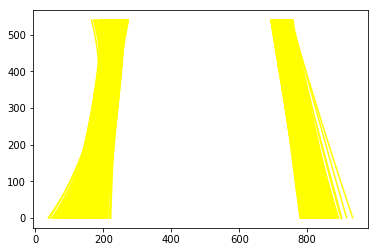

In [27]:
line = Line()
project_output = 'test_videos_output/solidWhiteRight.mp4'
left_fit = None
right_fit = None

## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("solidWhiteRight.mp4")
project_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time project_clip.write_videofile(project_output, audio=False)

[]
fresh
(22071,)
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 473.9150322961419
Curvature: 473.9150322961419 
[MoviePy] >>>> Building video test_videos_output/ouput_project_video.mp4
[MoviePy] Writing video test_videos_output/ouput_project_video.mp4


  0%|          | 1/1261 [00:00<12:20,  1.70it/s]

[ -4.09577710e-04   5.60398124e-01   1.25231920e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 119.22066951830142
Curvature: 119.22066951830142 


  0%|          | 2/1261 [00:01<11:33,  1.82it/s]

[ -4.07802096e-04   5.59547946e-01   1.25294910e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 116.81155102446287
Curvature: 116.81155102446287 


  0%|          | 3/1261 [00:01<10:53,  1.92it/s]

[ -4.22361879e-04   5.72610931e-01   1.23863307e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 114.88435598316784
Curvature: 114.88435598316784 


  0%|          | 4/1261 [00:01<10:21,  2.02it/s]

[ -4.32968614e-04   5.83798702e-01   1.21832851e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 112.18437473392184
Curvature: 112.18437473392184 


  0%|          | 5/1261 [00:02<09:57,  2.10it/s]

[ -4.49278823e-04   6.01324517e-01   1.17975998e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 112.32340811404515
Curvature: 112.32340811404515 


  0%|          | 6/1261 [00:02<09:43,  2.15it/s]

[ -4.10883583e-04   5.80234029e-01   1.19001899e+02]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 110.3790815987431
Curvature: 110.3790815987431 


  1%|          | 7/1261 [00:03<09:28,  2.20it/s]

[ -4.02289482e-04   5.78173890e-01   1.18375553e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 112.81815432102204
Curvature: 112.81815432102204 


  1%|          | 8/1261 [00:03<09:19,  2.24it/s]

[ -3.77281713e-04   5.63873563e-01   1.17893151e+02]
fast
(720,)
(720,)
(720,)
Center: 0.53m 
 Curvature: 121.65322829296876
Curvature: 121.65322829296876 


  1%|          | 9/1261 [00:04<09:14,  2.26it/s]

[ -3.71096876e-04   5.64904699e-01   1.16784380e+02]
fast
(720,)
(720,)
(720,)
Center: 0.48m 
 Curvature: 118.29668770587132
Curvature: 118.29668770587132 


  1%|          | 10/1261 [00:04<09:08,  2.28it/s]

[ -3.55607542e-04   5.57712271e-01   1.13685562e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 114.15172555708435
Curvature: 114.15172555708435 


  1%|          | 11/1261 [00:04<09:03,  2.30it/s]

[ -3.48638091e-04   5.57515179e-01   1.09902729e+02]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 110.6910402007053
Curvature: 110.6910402007053 


  1%|          | 12/1261 [00:05<08:58,  2.32it/s]

[ -3.43163179e-04   5.54918238e-01   1.08961663e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 117.37642943726283
Curvature: 117.37642943726283 


  1%|          | 13/1261 [00:05<08:56,  2.33it/s]

[ -3.23582163e-04   5.49034140e-01   1.01038667e+02]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 111.8141365435909
Curvature: 111.8141365435909 


  1%|          | 14/1261 [00:06<08:53,  2.34it/s]

[ -2.99419691e-04   5.29296328e-01   1.04101030e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 110.42382352001871
Curvature: 110.42382352001871 


  1%|          | 15/1261 [00:06<08:52,  2.34it/s]

[ -2.92149127e-04   5.24661436e-01   1.03787051e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 105.29261951024681
Curvature: 105.29261951024681 


  1%|▏         | 16/1261 [00:07<08:51,  2.34it/s]

[ -3.14675975e-04   5.38105689e-01   1.04545000e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 100.77195663602565
Curvature: 100.77195663602565 


  1%|▏         | 17/1261 [00:07<08:51,  2.34it/s]

[ -3.30931579e-04   5.48694440e-01   1.04659577e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 100.45896739469845
Curvature: 100.45896739469845 


  1%|▏         | 18/1261 [00:07<08:52,  2.34it/s]

[ -3.25657375e-04   5.46084885e-01   1.03866130e+02]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 98.94863806918434
Curvature: 98.94863806918434 


  2%|▏         | 19/1261 [00:08<08:54,  2.32it/s]

[ -3.19429921e-04   5.41253243e-01   1.04504167e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 103.10861377180096
Curvature: 103.10861377180096 


  2%|▏         | 20/1261 [00:08<08:51,  2.33it/s]

[ -3.09117641e-04   5.35206493e-01   1.01803816e+02]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 107.84714979542478
Curvature: 107.84714979542478 


  2%|▏         | 21/1261 [00:09<08:51,  2.33it/s]

[ -3.01600025e-04   5.30322857e-01   9.95837546e+01]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 119.25268373738393
Curvature: 119.25268373738393 


  2%|▏         | 22/1261 [00:09<08:49,  2.34it/s]

[ -2.84741311e-04   5.17282432e-01   9.86806555e+01]
fast
(720,)
(720,)
(720,)
Center: 0.48m 
 Curvature: 125.81668184561491
Curvature: 125.81668184561491 


  2%|▏         | 23/1261 [00:10<08:46,  2.35it/s]

[ -2.73728434e-04   5.09963241e-01   9.55906374e+01]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 129.4087105369873
Curvature: 129.4087105369873 


  2%|▏         | 24/1261 [00:10<08:46,  2.35it/s]

[ -2.68201710e-04   5.03883315e-01   9.38561878e+01]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 113.34570628744834
Curvature: 113.34570628744834 


  2%|▏         | 25/1261 [00:10<08:47,  2.34it/s]

[ -2.98814135e-04   5.20713044e-01   9.43222729e+01]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 110.08782861650126
Curvature: 110.08782861650126 


  2%|▏         | 26/1261 [00:11<08:47,  2.34it/s]

[ -3.35002712e-04   5.45787429e-01   9.19220991e+01]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 114.80989699694602
Curvature: 114.80989699694602 


  2%|▏         | 27/1261 [00:11<08:46,  2.34it/s]

[ -3.25878626e-04   5.34557642e-01   9.19973591e+01]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 110.50282963116125
Curvature: 110.50282963116125 


  2%|▏         | 28/1261 [00:12<08:44,  2.35it/s]

[ -3.43581175e-04   5.44552430e-01   9.12724855e+01]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 115.31577360735352
Curvature: 115.31577360735352 


  2%|▏         | 29/1261 [00:12<08:46,  2.34it/s]

[ -3.42036665e-04   5.42370628e-01   8.88494888e+01]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 113.2295729914014
Curvature: 113.2295729914014 


  2%|▏         | 30/1261 [00:13<08:46,  2.34it/s]

[ -3.63536580e-04   5.56019212e-01   8.97065207e+01]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 110.37144228679291
Curvature: 110.37144228679291 


  2%|▏         | 31/1261 [00:13<08:46,  2.34it/s]

[ -3.90812405e-04   5.74942048e-01   9.08649980e+01]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 106.80834971677744
Curvature: 106.80834971677744 


  3%|▎         | 32/1261 [00:13<08:46,  2.33it/s]

[ -4.25193959e-04   6.00857988e-01   9.01353373e+01]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 102.71436256702698
Curvature: 102.71436256702698 


  3%|▎         | 33/1261 [00:14<08:44,  2.34it/s]

[ -4.62247088e-04   6.28264681e-01   8.99662737e+01]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 111.37714834897768
Curvature: 111.37714834897768 


  3%|▎         | 34/1261 [00:14<08:44,  2.34it/s]

[ -4.50142923e-04   6.19824210e-01   8.94222750e+01]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 109.29149073026443
Curvature: 109.29149073026443 


  3%|▎         | 35/1261 [00:15<08:42,  2.35it/s]

[ -4.79680277e-04   6.45436931e-01   8.65254305e+01]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 101.34432243145864
Curvature: 101.34432243145864 


  3%|▎         | 36/1261 [00:15<08:41,  2.35it/s]

[ -4.89573825e-04   6.56390559e-01   8.49759394e+01]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 94.13829137113103
Curvature: 94.13829137113103 


  3%|▎         | 37/1261 [00:16<08:41,  2.34it/s]

[ -5.08032870e-04   6.75119647e-01   8.28960871e+01]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 93.52181932358303
Curvature: 93.52181932358303 


  3%|▎         | 38/1261 [00:16<08:42,  2.34it/s]

[ -5.24171450e-04   6.93315413e-01   7.91418545e+01]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 92.04516068907958
Curvature: 92.04516068907958 


  3%|▎         | 39/1261 [00:16<08:43,  2.34it/s]

[ -5.43455024e-04   7.14687839e-01   7.53050745e+01]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 88.94005909053948
Curvature: 88.94005909053948 


  3%|▎         | 40/1261 [00:17<08:44,  2.33it/s]

[ -5.56770242e-04   7.28903331e-01   7.30114159e+01]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 90.85155133101577
Curvature: 90.85155133101577 


  3%|▎         | 41/1261 [00:17<08:44,  2.32it/s]

[ -5.51806974e-04   7.30885896e-01   6.97018982e+01]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 89.42923847022467
Curvature: 89.42923847022467 


  3%|▎         | 42/1261 [00:18<08:45,  2.32it/s]

[ -5.55003490e-04   7.38265762e-01   6.67237041e+01]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 90.31876783498168
Curvature: 90.31876783498168 


  3%|▎         | 43/1261 [00:18<08:50,  2.30it/s]

[ -5.47429751e-04   7.37423273e-01   6.49981541e+01]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 93.39232863249164
Curvature: 93.39232863249164 


  3%|▎         | 44/1261 [00:19<08:46,  2.31it/s]

[ -5.04692645e-04   7.13526811e-01   6.53215942e+01]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 97.1670816275602
Curvature: 97.1670816275602 


  4%|▎         | 45/1261 [00:19<08:42,  2.33it/s]

[ -4.81775841e-04   6.98226633e-01   6.48732782e+01]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 99.75319951514281
Curvature: 99.75319951514281 


  4%|▎         | 46/1261 [00:19<08:43,  2.32it/s]

[ -4.55485916e-04   6.82463903e-01   6.43081916e+01]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 107.40020536911018
Curvature: 107.40020536911018 


  4%|▎         | 47/1261 [00:20<08:45,  2.31it/s]

[ -4.29698228e-04   6.63489626e-01   6.60017859e+01]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 111.19627099062821
Curvature: 111.19627099062821 


  4%|▍         | 48/1261 [00:20<08:43,  2.32it/s]

[ -4.08049608e-04   6.48357393e-01   6.54283071e+01]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 95.72013977754933
Curvature: 95.72013977754933 


  4%|▍         | 49/1261 [00:21<08:45,  2.31it/s]

[ -4.03153780e-04   6.47283767e-01   6.46210418e+01]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 99.06290208062462
Curvature: 99.06290208062462 


  4%|▍         | 50/1261 [00:21<08:42,  2.32it/s]

[ -3.71213047e-04   6.25632288e-01   6.40839132e+01]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 96.79813988876134
Curvature: 96.79813988876134 


  4%|▍         | 51/1261 [00:22<08:41,  2.32it/s]

[ -3.55464221e-04   6.14160939e-01   6.49156795e+01]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 96.24401687160078
Curvature: 96.24401687160078 


  4%|▍         | 52/1261 [00:22<08:41,  2.32it/s]

[ -3.44904224e-04   6.07368427e-01   6.43405212e+01]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 94.713965016991
Curvature: 94.713965016991 


  4%|▍         | 53/1261 [00:22<08:39,  2.33it/s]

[ -3.31132100e-04   5.91271793e-01   6.95313433e+01]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 93.51666692167832
Curvature: 93.51666692167832 


  4%|▍         | 54/1261 [00:23<08:37,  2.33it/s]

[ -3.31270346e-04   5.89591048e-01   7.01360692e+01]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 91.79028072565956
Curvature: 91.79028072565956 


  4%|▍         | 55/1261 [00:23<08:35,  2.34it/s]

[ -3.20839252e-04   5.79453184e-01   7.19024572e+01]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 93.37038805653238
Curvature: 93.37038805653238 


  4%|▍         | 56/1261 [00:24<08:41,  2.31it/s]

[ -2.98807351e-04   5.62766290e-01   7.31792407e+01]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 95.39962716950552
Curvature: 95.39962716950552 


  5%|▍         | 57/1261 [00:24<08:42,  2.30it/s]

[ -2.90445016e-04   5.52681667e-01   7.43107072e+01]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 96.41830816476462
Curvature: 96.41830816476462 


  5%|▍         | 58/1261 [00:25<08:39,  2.31it/s]

[ -2.90643472e-04   5.49555603e-01   7.55276966e+01]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 103.13175406478727
Curvature: 103.13175406478727 


  5%|▍         | 59/1261 [00:25<08:44,  2.29it/s]

[ -2.95478919e-04   5.50210059e-01   7.52847046e+01]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 93.76049247935288
Curvature: 93.76049247935288 


  5%|▍         | 60/1261 [00:25<08:41,  2.30it/s]

[ -3.24453494e-04   5.64103312e-01   7.88386190e+01]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 87.89253996584475
Curvature: 87.89253996584475 


  5%|▍         | 61/1261 [00:26<08:42,  2.30it/s]

[ -3.43898179e-04   5.69955982e-01   8.24451781e+01]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 87.65483917826597
Curvature: 87.65483917826597 


  5%|▍         | 62/1261 [00:26<08:40,  2.30it/s]

[ -3.48085847e-04   5.65736298e-01   8.57922951e+01]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 85.77899316586338
Curvature: 85.77899316586338 


  5%|▍         | 63/1261 [00:27<08:41,  2.30it/s]

[ -3.55935379e-04   5.64831591e-01   8.94438903e+01]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 88.73034519659585
Curvature: 88.73034519659585 


  5%|▌         | 64/1261 [00:27<08:38,  2.31it/s]

[ -3.64336233e-04   5.68982295e-01   8.77950019e+01]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 87.73989312233427
Curvature: 87.73989312233427 


  5%|▌         | 65/1261 [00:28<08:36,  2.31it/s]

[ -3.74761430e-04   5.69950663e-01   9.09981105e+01]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 91.47381428405338
Curvature: 91.47381428405338 


  5%|▌         | 66/1261 [00:28<08:38,  2.30it/s]

[ -3.86357299e-04   5.75193609e-01   8.95915258e+01]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 90.71520076804563
Curvature: 90.71520076804563 


  5%|▌         | 67/1261 [00:29<08:39,  2.30it/s]

[ -4.04113114e-04   5.85723856e-01   9.01820733e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 92.32669720211395
Curvature: 92.32669720211395 


  5%|▌         | 68/1261 [00:29<08:38,  2.30it/s]

[ -3.91188080e-04   5.70608149e-01   9.34358584e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 94.33046960949444
Curvature: 94.33046960949444 


  5%|▌         | 69/1261 [00:29<08:38,  2.30it/s]

[ -3.74269944e-04   5.59234861e-01   9.30463584e+01]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 89.03412025973122
Curvature: 89.03412025973122 


  6%|▌         | 70/1261 [00:30<08:36,  2.31it/s]

[ -3.67373802e-04   5.48283439e-01   9.80505443e+01]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 92.68362050226867
Curvature: 92.68362050226867 


  6%|▌         | 71/1261 [00:30<08:36,  2.30it/s]

[ -3.64451259e-04   5.51074360e-01   9.29246908e+01]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 87.23955795559284
Curvature: 87.23955795559284 


  6%|▌         | 72/1261 [00:31<08:32,  2.32it/s]

[ -3.06619125e-04   4.97833358e-01   1.04410628e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 88.78646265897675
Curvature: 88.78646265897675 


  6%|▌         | 73/1261 [00:31<08:31,  2.32it/s]

[ -2.83307153e-04   4.80039024e-01   1.04829845e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 90.52189106903487
Curvature: 90.52189106903487 


  6%|▌         | 74/1261 [00:32<08:31,  2.32it/s]

[ -2.78696506e-04   4.79274752e-01   1.02056355e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 91.66786127489328
Curvature: 91.66786127489328 


  6%|▌         | 75/1261 [00:32<08:29,  2.33it/s]

[ -2.59182821e-04   4.60731880e-01   1.05285562e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 94.44779722929644
Curvature: 94.44779722929644 


  6%|▌         | 76/1261 [00:32<08:28,  2.33it/s]

[ -2.41312405e-04   4.50840736e-01   1.02209860e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 92.56021673081175
Curvature: 92.56021673081175 


  6%|▌         | 77/1261 [00:33<08:28,  2.33it/s]

[ -2.40039248e-04   4.46702575e-01   1.04151131e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 98.88786727465221
Curvature: 98.88786727465221 


  6%|▌         | 78/1261 [00:33<08:26,  2.34it/s]

[ -2.26862897e-04   4.44234829e-01   9.62665222e+01]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 100.66916736331054
Curvature: 100.66916736331054 


  6%|▋         | 79/1261 [00:34<08:26,  2.33it/s]

[ -2.14861550e-04   4.35503431e-01   9.51734264e+01]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 103.33262606548338
Curvature: 103.33262606548338 


  6%|▋         | 80/1261 [00:34<08:26,  2.33it/s]

[ -2.01379691e-04   4.21202395e-01   9.57840302e+01]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 104.56892389143911
Curvature: 104.56892389143911 


  6%|▋         | 81/1261 [00:35<08:28,  2.32it/s]

[ -2.08928151e-04   4.14834375e-01   1.00597739e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 102.04603047134887
Curvature: 102.04603047134887 


  7%|▋         | 82/1261 [00:35<08:27,  2.32it/s]

[ -1.92741063e-04   3.99324838e-01   1.04429342e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 102.92673870280476
Curvature: 102.92673870280476 


  7%|▋         | 83/1261 [00:35<08:27,  2.32it/s]

[ -2.09296636e-04   4.10268730e-01   1.01191929e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 103.9198215330777
Curvature: 103.9198215330777 


  7%|▋         | 84/1261 [00:36<08:26,  2.32it/s]

[ -2.27258678e-04   4.20220983e-01   9.98238759e+01]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 112.22183561309849
Curvature: 112.22183561309849 


  7%|▋         | 85/1261 [00:36<08:26,  2.32it/s]

[ -2.17736343e-04   4.11942937e-01   9.68018335e+01]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 112.90319590704783
Curvature: 112.90319590704783 


  7%|▋         | 86/1261 [00:37<08:23,  2.33it/s]

[ -2.35170010e-04   4.18804936e-01   9.80904159e+01]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 108.88032098254847
Curvature: 108.88032098254847 


  7%|▋         | 87/1261 [00:37<08:23,  2.33it/s]

[ -2.62575951e-04   4.34149108e-01   9.86097983e+01]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 100.89564722406935
Curvature: 100.89564722406935 


  7%|▋         | 88/1261 [00:38<08:48,  2.22it/s]

[ -3.12299851e-04   4.58491681e-01   1.06367863e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 98.7653235138533
Curvature: 98.7653235138533 


  7%|▋         | 89/1261 [00:38<08:41,  2.25it/s]

[ -3.48922740e-04   4.78712599e-01   1.10321087e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 96.83845349943749
Curvature: 96.83845349943749 


  7%|▋         | 90/1261 [00:38<08:36,  2.27it/s]

[ -3.70019161e-04   4.90789018e-01   1.12713170e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 92.23523002861127
Curvature: 92.23523002861127 


  7%|▋         | 91/1261 [00:39<08:32,  2.28it/s]

[ -4.03192031e-04   5.13136794e-01   1.16272213e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 95.10883241192121
Curvature: 95.10883241192121 


  7%|▋         | 92/1261 [00:39<08:30,  2.29it/s]

[ -4.00068078e-04   5.12836075e-01   1.14291420e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 96.82570034198578
Curvature: 96.82570034198578 


  7%|▋         | 93/1261 [00:40<08:27,  2.30it/s]

[ -3.92828632e-04   5.09437014e-01   1.14151734e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 95.4918464173112
Curvature: 95.4918464173112 


  7%|▋         | 94/1261 [00:40<08:25,  2.31it/s]

[ -4.00149061e-04   5.14704042e-01   1.17322244e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 93.47861484266666
Curvature: 93.47861484266666 


  8%|▊         | 95/1261 [00:41<08:23,  2.31it/s]

[ -4.10597197e-04   5.25560494e-01   1.16640432e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 96.49652023345485
Curvature: 96.49652023345485 


  8%|▊         | 96/1261 [00:41<08:22,  2.32it/s]

[ -4.04241811e-04   5.24050457e-01   1.14429972e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 94.61448660133436
Curvature: 94.61448660133436 


  8%|▊         | 97/1261 [00:42<08:23,  2.31it/s]

[ -3.92229022e-04   5.18118576e-01   1.14836377e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 94.49714704896743
Curvature: 94.49714704896743 


  8%|▊         | 98/1261 [00:42<08:20,  2.33it/s]

[ -3.89523648e-04   5.19206106e-01   1.14404235e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 97.16737598595405
Curvature: 97.16737598595405 


  8%|▊         | 99/1261 [00:42<08:17,  2.33it/s]

[ -3.81578697e-04   5.16594834e-01   1.11850274e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 96.24735278266957
Curvature: 96.24735278266957 


  8%|▊         | 100/1261 [00:43<08:17,  2.33it/s]

[ -3.83637723e-04   5.19540623e-01   1.13025220e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 98.79390056567938
Curvature: 98.79390056567938 


  8%|▊         | 101/1261 [00:43<08:17,  2.33it/s]

[ -3.81494887e-04   5.18546863e-01   1.12140702e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 98.55532352629764
Curvature: 98.55532352629764 


  8%|▊         | 102/1261 [00:44<08:18,  2.32it/s]

[ -3.93232905e-04   5.28854654e-01   1.11239620e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 97.45791512505362
Curvature: 97.45791512505362 


  8%|▊         | 103/1261 [00:44<08:19,  2.32it/s]

[ -4.04510772e-04   5.36126634e-01   1.12071800e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 98.95419567813077
Curvature: 98.95419567813077 


  8%|▊         | 104/1261 [00:45<08:18,  2.32it/s]

[ -4.04766398e-04   5.37440438e-01   1.11919326e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 99.06439572887209
Curvature: 99.06439572887209 


  8%|▊         | 105/1261 [00:45<08:19,  2.32it/s]

[ -4.09128186e-04   5.40648605e-01   1.12694063e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 104.68796700621742
Curvature: 104.68796700621742 


  8%|▊         | 106/1261 [00:45<08:17,  2.32it/s]

[ -3.97867590e-04   5.34488088e-01   1.10552585e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 107.68758362061473
Curvature: 107.68758362061473 


  8%|▊         | 107/1261 [00:46<08:14,  2.33it/s]

[ -3.75283604e-04   5.22738541e-01   1.10287776e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 110.68556505684927
Curvature: 110.68556505684927 


  9%|▊         | 108/1261 [00:46<08:13,  2.34it/s]

[ -3.66322056e-04   5.17716754e-01   1.09659923e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 108.16146050072909
Curvature: 108.16146050072909 


  9%|▊         | 109/1261 [00:47<08:14,  2.33it/s]

[ -3.91497285e-04   5.37006261e-01   1.10776009e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 108.15034811007646
Curvature: 108.15034811007646 


  9%|▊         | 110/1261 [00:47<08:13,  2.33it/s]

[ -4.00802493e-04   5.43857678e-01   1.10872570e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 104.63640982665487
Curvature: 104.63640982665487 


  9%|▉         | 111/1261 [00:48<08:11,  2.34it/s]

[ -4.05575399e-04   5.48713325e-01   1.10223245e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 104.25992978793529
Curvature: 104.25992978793529 


  9%|▉         | 112/1261 [00:48<08:10,  2.34it/s]

[ -4.12656931e-04   5.54661500e-01   1.10368692e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 109.51938651647414
Curvature: 109.51938651647414 


  9%|▉         | 113/1261 [00:48<08:12,  2.33it/s]

[ -3.93148147e-04   5.42806312e-01   1.08503140e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 104.28448398101476
Curvature: 104.28448398101476 


  9%|▉         | 114/1261 [00:49<08:12,  2.33it/s]

[ -4.24307154e-04   5.64998321e-01   1.08823775e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 104.21091408997887
Curvature: 104.21091408997887 


  9%|▉         | 115/1261 [00:49<08:10,  2.34it/s]

[ -4.35101468e-04   5.72863778e-01   1.09254270e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 99.84552792550353
Curvature: 99.84552792550353 


  9%|▉         | 116/1261 [00:50<08:09,  2.34it/s]

[ -4.67034139e-04   6.00688232e-01   1.06869568e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 98.2398154532908
Curvature: 98.2398154532908 


  9%|▉         | 117/1261 [00:50<08:11,  2.33it/s]

[ -4.73501279e-04   6.07466235e-01   1.06653245e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 99.00743456270563
Curvature: 99.00743456270563 


  9%|▉         | 118/1261 [00:51<08:10,  2.33it/s]

[ -4.79529546e-04   6.15702896e-01   1.03848723e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 98.24020219171193
Curvature: 98.24020219171193 


  9%|▉         | 119/1261 [00:51<08:08,  2.34it/s]

[ -4.59315545e-04   6.05252453e-01   1.04916834e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 98.17157722649999
Curvature: 98.17157722649999 


 10%|▉         | 120/1261 [00:51<08:07,  2.34it/s]

[ -4.61185628e-04   6.10801068e-01   1.03171632e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 92.19257548091994
Curvature: 92.19257548091994 


 10%|▉         | 121/1261 [00:52<08:09,  2.33it/s]

[ -4.83805475e-04   6.31264858e-01   1.01748473e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 93.47595614368761
Curvature: 93.47595614368761 


 10%|▉         | 122/1261 [00:52<08:08,  2.33it/s]

[ -4.67765724e-04   6.22500848e-01   1.01822574e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 90.70660720506012
Curvature: 90.70660720506012 


 10%|▉         | 123/1261 [00:53<08:05,  2.34it/s]

[ -4.66107972e-04   6.22677552e-01   1.02245832e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 88.31299352809027
Curvature: 88.31299352809027 


 10%|▉         | 124/1261 [00:53<08:06,  2.34it/s]

[ -4.76944226e-04   6.33312304e-01   1.02029703e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 88.67904820738211
Curvature: 88.67904820738211 


 10%|▉         | 125/1261 [00:54<08:05,  2.34it/s]

[ -4.65631398e-04   6.24937811e-01   1.03704480e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 87.3847753083071
Curvature: 87.3847753083071 


 10%|▉         | 126/1261 [00:54<08:05,  2.34it/s]

[ -4.64843495e-04   6.26417440e-01   1.03506739e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 92.7393918973697
Curvature: 92.7393918973697 


 10%|█         | 127/1261 [00:54<08:04,  2.34it/s]

[ -4.28758773e-04   6.03752581e-01   1.02762404e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 91.43201070252177
Curvature: 91.43201070252177 


 10%|█         | 128/1261 [00:55<08:02,  2.35it/s]

[ -4.35395400e-04   6.09534577e-01   1.02421077e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 94.02436250775443
Curvature: 94.02436250775443 


 10%|█         | 129/1261 [00:55<08:03,  2.34it/s]

[ -4.23452892e-04   6.03265413e-01   1.01612461e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 88.66344515014285
Curvature: 88.66344515014285 


 10%|█         | 130/1261 [00:56<08:03,  2.34it/s]

[ -4.48514920e-04   6.23686409e-01   1.01115218e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 89.70302425617317
Curvature: 89.70302425617317 


 10%|█         | 131/1261 [00:56<08:03,  2.34it/s]

[ -4.29339894e-04   6.09560016e-01   1.01795786e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 90.00828514479898
Curvature: 90.00828514479898 


 10%|█         | 132/1261 [00:57<08:03,  2.34it/s]

[ -4.14517796e-04   6.01101743e-01   1.03295672e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 89.27486308440422
Curvature: 89.27486308440422 


 11%|█         | 133/1261 [00:57<08:05,  2.32it/s]

[ -4.19271843e-04   6.04887502e-01   1.04467538e+02]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 91.00033048673735
Curvature: 91.00033048673735 


 11%|█         | 134/1261 [00:57<08:03,  2.33it/s]

[ -4.05095815e-04   5.93182603e-01   1.06361291e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 90.9392170945992
Curvature: 90.9392170945992 


 11%|█         | 135/1261 [00:58<08:01,  2.34it/s]

[ -3.93117565e-04   5.83877770e-01   1.09341216e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 93.50475510812362
Curvature: 93.50475510812362 


 11%|█         | 136/1261 [00:58<08:01,  2.34it/s]

[ -3.70187179e-04   5.64376506e-01   1.13193195e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 96.61432640177912
Curvature: 96.61432640177912 


 11%|█         | 137/1261 [00:59<08:06,  2.31it/s]

[ -3.58836993e-04   5.55303022e-01   1.14080526e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 100.87072345253166
Curvature: 100.87072345253166 


 11%|█         | 138/1261 [00:59<08:03,  2.32it/s]

[ -3.49019157e-04   5.46807571e-01   1.14734529e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 104.77692945786245
Curvature: 104.77692945786245 


 11%|█         | 139/1261 [01:00<08:03,  2.32it/s]

[ -3.31112623e-04   5.30483831e-01   1.15633292e+02]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 105.75603438100413
Curvature: 105.75603438100413 


 11%|█         | 140/1261 [01:00<08:03,  2.32it/s]

[ -3.23628810e-04   5.20726907e-01   1.17208645e+02]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 110.35317806060809
Curvature: 110.35317806060809 


 11%|█         | 141/1261 [01:00<08:03,  2.32it/s]

[ -3.08630366e-04   5.08539232e-01   1.16148879e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 110.20644688522513
Curvature: 110.20644688522513 


 11%|█▏        | 142/1261 [01:01<08:02,  2.32it/s]

[ -3.06870490e-04   5.02715071e-01   1.18550776e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 110.29895349538621
Curvature: 110.29895349538621 


 11%|█▏        | 143/1261 [01:01<08:08,  2.29it/s]

[ -3.05595891e-04   4.96896188e-01   1.20567337e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 106.71108382002487
Curvature: 106.71108382002487 


 11%|█▏        | 144/1261 [01:02<08:07,  2.29it/s]

[ -3.04327467e-04   4.93124382e-01   1.24853393e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 107.02791694743914
Curvature: 107.02791694743914 


 11%|█▏        | 145/1261 [01:02<08:07,  2.29it/s]

[ -3.10185097e-04   4.94642021e-01   1.25324113e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 109.33714373430469
Curvature: 109.33714373430469 


 12%|█▏        | 146/1261 [01:03<08:04,  2.30it/s]

[ -3.14352272e-04   4.95599270e-01   1.25374255e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 103.40432328236827
Curvature: 103.40432328236827 


 12%|█▏        | 147/1261 [01:03<08:00,  2.32it/s]

[ -3.26912770e-04   5.01140601e-01   1.27502871e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 104.206074884437
Curvature: 104.206074884437 


 12%|█▏        | 148/1261 [01:03<08:03,  2.30it/s]

[ -3.16646435e-04   4.91716577e-01   1.29206511e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 96.26455233869932
Curvature: 96.26455233869932 


 12%|█▏        | 149/1261 [01:04<08:10,  2.27it/s]

[ -3.49729195e-04   5.11149815e-01   1.33665372e+02]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 98.10634006782736
Curvature: 98.10634006782736 


 12%|█▏        | 150/1261 [01:04<08:06,  2.29it/s]

[ -3.53564314e-04   5.11157945e-01   1.35071802e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 101.1703633939438
Curvature: 101.1703633939438 


 12%|█▏        | 151/1261 [01:05<08:02,  2.30it/s]

[ -3.42888414e-04   5.03851520e-01   1.33755944e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 103.55911283787142
Curvature: 103.55911283787142 


 12%|█▏        | 152/1261 [01:05<08:01,  2.30it/s]

[ -3.40431012e-04   5.01970000e-01   1.32322092e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 103.42900363705601
Curvature: 103.42900363705601 


 12%|█▏        | 153/1261 [01:06<08:26,  2.19it/s]

[ -3.37492368e-04   5.01826623e-01   1.29153282e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 100.04056283574221
Curvature: 100.04056283574221 


 12%|█▏        | 154/1261 [01:06<08:18,  2.22it/s]

[ -3.63272553e-04   5.21754353e-01   1.27324926e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 103.80400853517385
Curvature: 103.80400853517385 


 12%|█▏        | 155/1261 [01:07<08:11,  2.25it/s]

[ -3.56796825e-04   5.21753324e-01   1.22073047e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 106.07125936854791
Curvature: 106.07125936854791 


 12%|█▏        | 156/1261 [01:07<08:05,  2.28it/s]

[ -3.31909371e-04   5.08082297e-01   1.19842650e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 107.09113726293803
Curvature: 107.09113726293803 


 12%|█▏        | 157/1261 [01:07<08:02,  2.29it/s]

[ -3.39398803e-04   5.14306983e-01   1.17550950e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 106.84474036272056
Curvature: 106.84474036272056 


 13%|█▎        | 158/1261 [01:08<07:58,  2.31it/s]

[ -3.43596292e-04   5.20167445e-01   1.14235333e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 101.9551471443707
Curvature: 101.9551471443707 


 13%|█▎        | 159/1261 [01:08<07:57,  2.31it/s]

[ -3.67945079e-04   5.37068109e-01   1.13669803e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 103.01037843822766
Curvature: 103.01037843822766 


 13%|█▎        | 160/1261 [01:09<07:55,  2.31it/s]

[ -3.66553428e-04   5.38349933e-01   1.09851535e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 96.67469608352293
Curvature: 96.67469608352293 


 13%|█▎        | 161/1261 [01:09<07:55,  2.31it/s]

[ -3.81239524e-04   5.52380813e-01   1.06137710e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 100.61622554584618
Curvature: 100.61622554584618 


 13%|█▎        | 162/1261 [01:10<07:53,  2.32it/s]

[ -3.64004964e-04   5.45429530e-01   1.01709445e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 100.13849358718491
Curvature: 100.13849358718491 


 13%|█▎        | 163/1261 [01:10<07:53,  2.32it/s]

[ -3.62375314e-04   5.47382333e-01   9.81406785e+01]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 101.87612481233802
Curvature: 101.87612481233802 


 13%|█▎        | 164/1261 [01:10<07:50,  2.33it/s]

[ -3.57901626e-04   5.48799104e-01   9.34323201e+01]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 98.8913814660404
Curvature: 98.8913814660404 


 13%|█▎        | 165/1261 [01:11<07:51,  2.32it/s]

[ -3.66060731e-04   5.55050734e-01   9.33253601e+01]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 93.46862440736729
Curvature: 93.46862440736729 


 13%|█▎        | 166/1261 [01:11<07:52,  2.32it/s]

[ -3.85449625e-04   5.67513599e-01   9.41703852e+01]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 95.35348212718762
Curvature: 95.35348212718762 


 13%|█▎        | 167/1261 [01:12<07:52,  2.32it/s]

[ -3.82811867e-04   5.69833683e-01   9.03323044e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 91.29607171917047
Curvature: 91.29607171917047 


 13%|█▎        | 168/1261 [01:12<07:51,  2.32it/s]

[ -4.08062929e-04   5.89621011e-01   8.85607315e+01]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 97.6377869586986
Curvature: 97.6377869586986 


 13%|█▎        | 169/1261 [01:13<07:51,  2.32it/s]

[ -3.56567524e-04   5.57469049e-01   8.72666666e+01]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 99.47315401182627
Curvature: 99.47315401182627 


 13%|█▎        | 170/1261 [01:13<07:51,  2.32it/s]

[ -3.46126671e-04   5.54980457e-01   8.30037635e+01]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 103.56031027590917
Curvature: 103.56031027590917 


 14%|█▎        | 171/1261 [01:13<07:52,  2.31it/s]

[ -3.25257818e-04   5.41689670e-01   8.00080034e+01]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 95.60060855556085
Curvature: 95.60060855556085 


 14%|█▎        | 172/1261 [01:14<07:50,  2.32it/s]

[ -3.23571732e-04   5.41652805e-01   7.80493720e+01]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 92.97941489421984
Curvature: 92.97941489421984 


 14%|█▎        | 173/1261 [01:14<07:50,  2.31it/s]

[ -3.34134029e-04   5.50558035e-01   7.53238485e+01]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 84.95226551709305
Curvature: 84.95226551709305 


 14%|█▍        | 174/1261 [01:15<07:48,  2.32it/s]

[ -3.52392067e-04   5.61664822e-01   7.45529683e+01]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 79.71385368464901
Curvature: 79.71385368464901 


 14%|█▍        | 175/1261 [01:15<07:47,  2.32it/s]

[ -3.84703586e-04   5.85085121e-01   7.33955422e+01]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 77.00566469741479
Curvature: 77.00566469741479 


 14%|█▍        | 176/1261 [01:16<07:45,  2.33it/s]

[ -4.12943755e-04   6.07418200e-01   7.03791969e+01]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 74.43413560804441
Curvature: 74.43413560804441 


 14%|█▍        | 177/1261 [01:16<07:46,  2.32it/s]

[ -4.32110843e-04   6.20766750e-01   6.81806751e+01]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 80.33392774777184
Curvature: 80.33392774777184 


 14%|█▍        | 178/1261 [01:16<07:46,  2.32it/s]

[ -3.94445248e-04   5.92362540e-01   6.79894011e+01]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 81.6302403077128
Curvature: 81.6302403077128 


 14%|█▍        | 179/1261 [01:17<07:45,  2.32it/s]

[ -4.08838255e-04   6.03044353e-01   6.56959823e+01]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 82.13450104968689
Curvature: 82.13450104968689 


 14%|█▍        | 180/1261 [01:17<07:45,  2.32it/s]

[ -4.23362865e-04   6.13049071e-01   6.44101586e+01]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 85.51749703102035
Curvature: 85.51749703102035 


 14%|█▍        | 181/1261 [01:18<07:45,  2.32it/s]

[ -4.08636752e-04   6.00588798e-01   6.64201697e+01]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 81.72450825618851
Curvature: 81.72450825618851 


 14%|█▍        | 182/1261 [01:18<07:45,  2.32it/s]

[ -4.46698169e-04   6.26519337e-01   6.65796621e+01]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 86.39072416178621
Curvature: 86.39072416178621 


 15%|█▍        | 183/1261 [01:19<07:44,  2.32it/s]

[ -4.40454859e-04   6.17434214e-01   6.78443621e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 84.05486535324353
Curvature: 84.05486535324353 


 15%|█▍        | 184/1261 [01:19<07:41,  2.33it/s]

[ -4.80413155e-04   6.43081823e-01   6.85981839e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 78.5351067702413
Curvature: 78.5351067702413 


 15%|█▍        | 185/1261 [01:19<07:42,  2.33it/s]

[ -5.14298787e-04   6.66559145e-01   6.86165244e+01]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 76.74492290325722
Curvature: 76.74492290325722 


 15%|█▍        | 186/1261 [01:20<07:39,  2.34it/s]

[ -5.39317451e-04   6.83522434e-01   6.90096017e+01]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 70.80434310561391
Curvature: 70.80434310561391 


 15%|█▍        | 187/1261 [01:20<07:40,  2.33it/s]

[ -5.98227346e-04   7.29707419e-01   6.80748707e+01]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 72.36249492924692
Curvature: 72.36249492924692 


 15%|█▍        | 188/1261 [01:21<07:41,  2.33it/s]

[ -5.95134493e-04   7.29202165e-01   6.83535652e+01]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 70.2811881424415
Curvature: 70.2811881424415 


 15%|█▍        | 189/1261 [01:21<07:41,  2.32it/s]

[ -6.09289083e-04   7.44551899e-01   6.72909004e+01]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 71.90173702282902
Curvature: 71.90173702282902 


 15%|█▌        | 190/1261 [01:22<07:41,  2.32it/s]

[ -5.95050497e-04   7.35043512e-01   6.93790863e+01]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 69.98495208701318
Curvature: 69.98495208701318 


 15%|█▌        | 191/1261 [01:22<07:39,  2.33it/s]

[ -5.92801367e-04   7.38771829e-01   6.86774693e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 65.0484635416786
Curvature: 65.0484635416786 


 15%|█▌        | 192/1261 [01:22<07:39,  2.33it/s]

[ -6.01908465e-04   7.49664653e-01   6.84679834e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 68.9071066688139
Curvature: 68.9071066688139 


 15%|█▌        | 193/1261 [01:23<07:39,  2.32it/s]

[ -5.49386396e-04   7.16076801e-01   7.14274775e+01]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 66.09870274943154
Curvature: 66.09870274943154 


 15%|█▌        | 194/1261 [01:23<07:39,  2.32it/s]

[ -5.56032571e-04   7.26385608e-01   7.07276498e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 68.52550796518946
Curvature: 68.52550796518946 


 15%|█▌        | 195/1261 [01:24<07:39,  2.32it/s]

[ -5.33631637e-04   7.10834517e-01   7.29750933e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 69.52796672262903
Curvature: 69.52796672262903 


 16%|█▌        | 196/1261 [01:24<07:37,  2.33it/s]

[ -5.25884781e-04   7.05347128e-01   7.34224435e+01]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 81.03563396944904
Curvature: 81.03563396944904 


 16%|█▌        | 197/1261 [01:25<07:38,  2.32it/s]

[ -4.46766370e-04   6.44447355e-01   7.56458050e+01]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 92.79872109937118
Curvature: 92.79872109937118 


 16%|█▌        | 198/1261 [01:25<07:37,  2.32it/s]

[ -3.90195102e-04   6.02249426e-01   7.47230562e+01]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 102.20700067167284
Curvature: 102.20700067167284 


 16%|█▌        | 199/1261 [01:25<07:37,  2.32it/s]

[ -3.48918848e-04   5.75226183e-01   6.99553592e+01]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 114.32739854275799
Curvature: 114.32739854275799 


 16%|█▌        | 200/1261 [01:26<07:36,  2.32it/s]

[ -3.14480355e-04   5.54405201e-01   6.47233148e+01]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 107.42346011611241
Curvature: 107.42346011611241 


 16%|█▌        | 201/1261 [01:26<07:35,  2.33it/s]

[ -3.31046096e-04   5.66203348e-01   6.27851345e+01]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 109.64701330676196
Curvature: 109.64701330676196 


 16%|█▌        | 202/1261 [01:27<07:36,  2.32it/s]

[ -3.26431841e-04   5.61221401e-01   6.09299168e+01]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 100.87040670821847
Curvature: 100.87040670821847 


 16%|█▌        | 203/1261 [01:27<07:35,  2.32it/s]

[ -3.62432693e-04   5.83201882e-01   6.09310872e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 97.30141278162101
Curvature: 97.30141278162101 


 16%|█▌        | 204/1261 [01:28<07:34,  2.32it/s]

[ -3.80279541e-04   5.91396090e-01   6.25749372e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 96.89464813098382
Curvature: 96.89464813098382 


 16%|█▋        | 205/1261 [01:28<07:34,  2.32it/s]

[ -3.81128988e-04   5.93699266e-01   6.09704695e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 92.88758117586727
Curvature: 92.88758117586727 


 16%|█▋        | 206/1261 [01:28<07:34,  2.32it/s]

[ -3.89029952e-04   5.96748982e-01   6.45132334e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 91.24683920250602
Curvature: 91.24683920250602 


 16%|█▋        | 207/1261 [01:29<07:35,  2.32it/s]

[ -3.97467075e-04   6.03703430e-01   6.45632344e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 84.30299766640454
Curvature: 84.30299766640454 


 16%|█▋        | 208/1261 [01:29<07:37,  2.30it/s]

[ -4.49794111e-04   6.41777305e-01   6.50195996e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 79.09979840046226
Curvature: 79.09979840046226 


 17%|█▋        | 209/1261 [01:30<07:36,  2.31it/s]

[ -4.69159143e-04   6.54951207e-01   6.59536058e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 83.38260055476078
Curvature: 83.38260055476078 


 17%|█▋        | 210/1261 [01:30<07:35,  2.31it/s]

[ -4.56970905e-04   6.49524520e-01   6.35363602e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 86.5871113307747
Curvature: 86.5871113307747 


 17%|█▋        | 211/1261 [01:31<07:35,  2.31it/s]

[ -4.47785731e-04   6.43361698e-01   6.21851879e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 93.92274289501674
Curvature: 93.92274289501674 


 17%|█▋        | 212/1261 [01:31<07:39,  2.28it/s]

[ -4.18561450e-04   6.24520184e-01   6.00351602e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 91.6700970235249
Curvature: 91.6700970235249 


 17%|█▋        | 213/1261 [01:32<07:43,  2.26it/s]

[ -4.36077273e-04   6.40033743e-01   5.78341163e+01]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 94.03623934013108
Curvature: 94.03623934013108 


 17%|█▋        | 214/1261 [01:32<07:41,  2.27it/s]

[ -4.35937453e-04   6.39877361e-01   5.70264768e+01]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 91.90140040844952
Curvature: 91.90140040844952 


 17%|█▋        | 215/1261 [01:32<07:40,  2.27it/s]

[ -4.53339244e-04   6.55844725e-01   5.39063676e+01]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 89.68575684612321
Curvature: 89.68575684612321 


 17%|█▋        | 216/1261 [01:33<08:41,  2.00it/s]

[ -4.61666854e-04   6.62758198e-01   5.19498709e+01]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 89.80018118767327
Curvature: 89.80018118767327 


 17%|█▋        | 217/1261 [01:34<08:36,  2.02it/s]

[ -4.52090826e-04   6.57108201e-01   5.09251208e+01]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 88.66487777786824
Curvature: 88.66487777786824 


 17%|█▋        | 218/1261 [01:34<08:18,  2.09it/s]

[ -4.30102048e-04   6.45481336e-01   5.10166149e+01]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 92.5894634414916
Curvature: 92.5894634414916 


 17%|█▋        | 219/1261 [01:34<08:02,  2.16it/s]

[ -4.11929216e-04   6.36832653e-01   4.69151821e+01]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 87.2176146962804
Curvature: 87.2176146962804 


 17%|█▋        | 220/1261 [01:35<07:52,  2.20it/s]

[ -4.25063505e-04   6.47468713e-01   4.68545356e+01]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 92.83758870160518
Curvature: 92.83758870160518 


 18%|█▊        | 221/1261 [01:35<07:44,  2.24it/s]

[ -3.94322425e-04   6.28781725e-01   4.39994436e+01]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 90.43469941578306
Curvature: 90.43469941578306 


 18%|█▊        | 222/1261 [01:36<07:40,  2.26it/s]

[ -3.78062880e-04   6.19905610e-01   4.32371913e+01]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 90.5182777401209
Curvature: 90.5182777401209 


 18%|█▊        | 223/1261 [01:36<07:36,  2.27it/s]

[ -3.65682942e-04   6.10211186e-01   4.41779453e+01]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 90.31220720224921
Curvature: 90.31220720224921 


 18%|█▊        | 224/1261 [01:37<07:31,  2.30it/s]

[ -3.49784916e-04   5.98950264e-01   4.44879627e+01]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 86.14922147432827
Curvature: 86.14922147432827 


 18%|█▊        | 225/1261 [01:37<07:28,  2.31it/s]

[ -3.56449377e-04   5.98454762e-01   4.94215919e+01]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 88.22874141367487
Curvature: 88.22874141367487 


 18%|█▊        | 226/1261 [01:37<07:27,  2.31it/s]

[ -3.43179756e-04   5.88124837e-01   4.90391050e+01]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 85.05831197761466
Curvature: 85.05831197761466 


 18%|█▊        | 227/1261 [01:38<07:24,  2.33it/s]

[ -3.53369873e-04   5.88968011e-01   5.26431293e+01]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 87.09414229403347
Curvature: 87.09414229403347 


 18%|█▊        | 228/1261 [01:38<07:24,  2.32it/s]

[ -3.44904957e-04   5.82023939e-01   5.16803921e+01]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 88.80805836204247
Curvature: 88.80805836204247 


 18%|█▊        | 229/1261 [01:39<07:24,  2.32it/s]

[ -3.34223975e-04   5.73141044e-01   5.03517005e+01]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 90.10325319121515
Curvature: 90.10325319121515 


 18%|█▊        | 230/1261 [01:39<07:23,  2.33it/s]

[ -3.19229027e-04   5.62926868e-01   5.04587736e+01]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 93.14601750675241
Curvature: 93.14601750675241 


 18%|█▊        | 231/1261 [01:40<07:21,  2.33it/s]

[ -3.05221475e-04   5.55241288e-01   4.62389645e+01]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 90.5630238015561
Curvature: 90.5630238015561 


 18%|█▊        | 232/1261 [01:40<07:21,  2.33it/s]

[ -3.18571418e-04   5.63059423e-01   4.57214580e+01]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 93.82128267448455
Curvature: 93.82128267448455 


 18%|█▊        | 233/1261 [01:40<07:22,  2.32it/s]

[ -2.97526439e-04   5.48955899e-01   4.27645675e+01]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 87.02708493333809
Curvature: 87.02708493333809 


 19%|█▊        | 234/1261 [01:41<07:21,  2.32it/s]

[ -2.94685429e-04   5.44913950e-01   4.25220309e+01]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 85.71062680953655
Curvature: 85.71062680953655 


 19%|█▊        | 235/1261 [01:41<07:20,  2.33it/s]

[ -3.01211897e-04   5.47209645e-01   4.15137581e+01]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 83.05555903692648
Curvature: 83.05555903692648 


 19%|█▊        | 236/1261 [01:42<07:22,  2.31it/s]

[ -2.98354235e-04   5.42717917e-01   4.12998894e+01]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 78.0696113019693
Curvature: 78.0696113019693 


 19%|█▉        | 237/1261 [01:42<07:20,  2.32it/s]

[ -3.38549091e-04   5.66908036e-01   4.27137465e+01]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 77.2516036836273
Curvature: 77.2516036836273 


 19%|█▉        | 238/1261 [01:43<07:18,  2.33it/s]

[ -3.37704050e-04   5.65401138e-01   4.15529079e+01]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 75.45199079345645
Curvature: 75.45199079345645 


 19%|█▉        | 239/1261 [01:43<07:17,  2.34it/s]

[ -3.64754494e-04   5.82963351e-01   4.00186240e+01]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 73.76220345553028
Curvature: 73.76220345553028 


 19%|█▉        | 240/1261 [01:43<07:15,  2.34it/s]

[ -3.83185145e-04   5.92038745e-01   4.09644579e+01]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 74.19197624679938
Curvature: 74.19197624679938 


 19%|█▉        | 241/1261 [01:44<07:18,  2.33it/s]

[ -3.92552201e-04   5.98357086e-01   3.89727145e+01]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 75.2572541365637
Curvature: 75.2572541365637 


 19%|█▉        | 242/1261 [01:44<07:18,  2.32it/s]

[ -3.74763813e-04   5.85863926e-01   4.06973773e+01]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 80.39470126295438
Curvature: 80.39470126295438 


 19%|█▉        | 243/1261 [01:45<07:16,  2.33it/s]

[ -3.53397042e-04   5.68313477e-01   3.95600855e+01]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 76.8355651905938
Curvature: 76.8355651905938 


 19%|█▉        | 244/1261 [01:45<07:16,  2.33it/s]

[ -3.78037946e-04   5.80821449e-01   4.29031496e+01]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 79.05753724601607
Curvature: 79.05753724601607 


 19%|█▉        | 245/1261 [01:46<07:18,  2.32it/s]

[ -3.69967012e-04   5.74193233e-01   4.24711294e+01]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 71.80895939032006
Curvature: 71.80895939032006 


 20%|█▉        | 246/1261 [01:46<07:15,  2.33it/s]

[ -3.87676661e-04   5.77706038e-01   4.71642836e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 72.17249065893454
Curvature: 72.17249065893454 


 20%|█▉        | 247/1261 [01:46<07:15,  2.33it/s]

[ -3.95434102e-04   5.80949832e-01   4.82239927e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 74.11932816144271
Curvature: 74.11932816144271 


 20%|█▉        | 248/1261 [01:47<07:16,  2.32it/s]

[ -3.88502372e-04   5.75428599e-01   4.75328114e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 70.29232069263904
Curvature: 70.29232069263904 


 20%|█▉        | 249/1261 [01:47<07:15,  2.32it/s]

[ -4.12134496e-04   5.89533156e-01   5.01969513e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 73.71862544793616
Curvature: 73.71862544793616 


 20%|█▉        | 250/1261 [01:48<07:15,  2.32it/s]

[ -3.88115498e-04   5.74210743e-01   4.89392492e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 73.39165088924874
Curvature: 73.39165088924874 


 20%|█▉        | 251/1261 [01:48<07:14,  2.32it/s]

[ -3.92815255e-04   5.75057397e-01   5.03983815e+01]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 76.97060083865833
Curvature: 76.97060083865833 


 20%|█▉        | 252/1261 [01:49<07:15,  2.32it/s]

[ -3.79973495e-04   5.64958410e-01   5.04015779e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 79.18916962369251
Curvature: 79.18916962369251 


 20%|██        | 253/1261 [01:49<07:14,  2.32it/s]

[ -3.70299931e-04   5.54637894e-01   5.22465046e+01]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 79.80693573240893
Curvature: 79.80693573240893 


 20%|██        | 254/1261 [01:49<07:13,  2.32it/s]

[ -3.60040221e-04   5.46701275e-01   5.44133596e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 84.40012297945094
Curvature: 84.40012297945094 


 20%|██        | 255/1261 [01:50<07:12,  2.32it/s]

[ -3.36751877e-04   5.24872274e-01   5.78406580e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 80.19188402726431
Curvature: 80.19188402726431 


 20%|██        | 256/1261 [01:50<07:12,  2.33it/s]

[ -3.57807453e-04   5.34680839e-01   6.23423662e+01]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 81.34195503863565
Curvature: 81.34195503863565 


 20%|██        | 257/1261 [01:51<07:12,  2.32it/s]

[ -3.70077055e-04   5.41618433e-01   6.22520296e+01]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 78.40155877078985
Curvature: 78.40155877078985 


 20%|██        | 258/1261 [01:51<07:12,  2.32it/s]

[ -3.59040319e-04   5.22291663e-01   7.16680428e+01]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 79.06243124529611
Curvature: 79.06243124529611 


 21%|██        | 259/1261 [01:52<07:10,  2.33it/s]

[ -3.58258598e-04   5.12676558e-01   7.85030148e+01]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 81.87338143275929
Curvature: 81.87338143275929 


 21%|██        | 260/1261 [01:52<07:12,  2.32it/s]

[ -3.54291046e-04   5.07170750e-01   8.02612626e+01]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 80.97418144202884
Curvature: 80.97418144202884 


 21%|██        | 261/1261 [01:53<07:12,  2.31it/s]

[ -3.57825646e-04   5.02819487e-01   8.70529036e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 88.3615203941375
Curvature: 88.3615203941375 


 21%|██        | 262/1261 [01:53<07:12,  2.31it/s]

[ -3.51743642e-04   5.02279111e-01   8.34627254e+01]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 87.86919355849481
Curvature: 87.86919355849481 


 21%|██        | 263/1261 [01:53<07:10,  2.32it/s]

[ -3.51488491e-04   4.92327716e-01   9.05968903e+01]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 90.15546794420912
Curvature: 90.15546794420912 


 21%|██        | 264/1261 [01:54<07:10,  2.32it/s]

[ -3.44551030e-04   4.83495115e-01   9.38677656e+01]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 92.60557871496022
Curvature: 92.60557871496022 


 21%|██        | 265/1261 [01:54<07:12,  2.31it/s]

[ -3.55428797e-04   4.90936751e-01   9.28930600e+01]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 94.60545984744732
Curvature: 94.60545984744732 


 21%|██        | 266/1261 [01:55<07:09,  2.32it/s]

[ -3.41292093e-04   4.82253680e-01   9.40136407e+01]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 99.92780420384445
Curvature: 99.92780420384445 


 21%|██        | 267/1261 [01:55<07:08,  2.32it/s]

[ -3.21596442e-04   4.66119363e-01   9.39441573e+01]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 98.21610076444232
Curvature: 98.21610076444232 


 21%|██▏       | 268/1261 [01:56<07:07,  2.32it/s]

[ -3.28308685e-04   4.64117307e-01   9.97887737e+01]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 100.14844446314648
Curvature: 100.14844446314648 


 21%|██▏       | 269/1261 [01:56<07:06,  2.33it/s]

[ -3.46263860e-04   4.79311665e-01   9.65182298e+01]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 103.1108736684179
Curvature: 103.1108736684179 


 21%|██▏       | 270/1261 [01:56<07:05,  2.33it/s]

[ -3.41174798e-04   4.81338978e-01   9.14670470e+01]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 101.4990412015384
Curvature: 101.4990412015384 


 21%|██▏       | 271/1261 [01:57<07:04,  2.33it/s]

[ -3.21928159e-04   4.51411096e-01   1.02853236e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 100.4375953411343
Curvature: 100.4375953411343 


 22%|██▏       | 272/1261 [01:57<07:02,  2.34it/s]

[ -3.26229712e-04   4.47410321e-01   1.08603520e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 96.72187737881512
Curvature: 96.72187737881512 


 22%|██▏       | 273/1261 [01:58<07:01,  2.34it/s]

[ -3.41640351e-04   4.50095500e-01   1.17044922e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 97.12615848079861
Curvature: 97.12615848079861 


 22%|██▏       | 274/1261 [01:58<07:00,  2.35it/s]

[ -3.53032597e-04   4.59585092e-01   1.16633393e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 93.35905214488619
Curvature: 93.35905214488619 


 22%|██▏       | 275/1261 [01:59<06:59,  2.35it/s]

[ -3.80642514e-04   4.77696487e-01   1.19474606e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 96.9399950123058
Curvature: 96.9399950123058 


 22%|██▏       | 276/1261 [01:59<06:58,  2.35it/s]

[ -3.71350286e-04   4.70414056e-01   1.20534193e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 100.37294841871102
Curvature: 100.37294841871102 


 22%|██▏       | 277/1261 [01:59<06:59,  2.34it/s]

[ -3.76515746e-04   4.80868291e-01   1.15518831e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 102.95816140074393
Curvature: 102.95816140074393 


 22%|██▏       | 278/1261 [02:00<06:58,  2.35it/s]

[ -3.48261283e-04   4.61707977e-01   1.18090488e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 106.4347028561446
Curvature: 106.4347028561446 


 22%|██▏       | 279/1261 [02:00<06:59,  2.34it/s]

[ -3.39292175e-04   4.54786872e-01   1.18436301e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 105.29865782416113
Curvature: 105.29865782416113 


 22%|██▏       | 280/1261 [02:01<06:57,  2.35it/s]

[ -3.39663177e-04   4.49120761e-01   1.25336697e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 105.70701028630421
Curvature: 105.70701028630421 


 22%|██▏       | 281/1261 [02:01<06:58,  2.34it/s]

[ -3.38799818e-04   4.46589420e-01   1.27586299e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 104.7256121726184
Curvature: 104.7256121726184 


 22%|██▏       | 282/1261 [02:01<06:57,  2.35it/s]

[ -2.64432652e-04   3.71886323e-01   1.46643628e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 104.8056519609658
Curvature: 104.8056519609658 


 22%|██▏       | 283/1261 [02:02<06:57,  2.34it/s]

[ -2.67022796e-04   3.67697135e-01   1.52503647e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 109.36007315872197
Curvature: 109.36007315872197 


 23%|██▎       | 284/1261 [02:02<06:57,  2.34it/s]

[ -2.45593725e-04   3.48209316e-01   1.56214178e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 111.31209637367485
Curvature: 111.31209637367485 


 23%|██▎       | 285/1261 [02:03<06:57,  2.34it/s]

[ -2.26829629e-04   3.24505232e-01   1.66061758e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 115.8594000111983
Curvature: 115.8594000111983 


 23%|██▎       | 286/1261 [02:03<06:57,  2.33it/s]

[ -2.09659726e-04   3.11732423e-01   1.67654593e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 119.09442008134197
Curvature: 119.09442008134197 


 23%|██▎       | 287/1261 [02:04<06:57,  2.33it/s]

[ -2.21166928e-04   3.24674268e-01   1.63032882e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 120.15372012660517
Curvature: 120.15372012660517 


 23%|██▎       | 288/1261 [02:04<06:57,  2.33it/s]

[ -1.97687576e-04   2.94680909e-01   1.73453469e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 124.62497052368691
Curvature: 124.62497052368691 


 23%|██▎       | 289/1261 [02:04<06:55,  2.34it/s]

[ -2.29261421e-04   3.25862290e-01   1.65958094e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 121.9091672864375
Curvature: 121.9091672864375 


 23%|██▎       | 290/1261 [02:05<06:54,  2.34it/s]

[ -2.20385345e-04   3.11147481e-01   1.77065052e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 125.93313567087581
Curvature: 125.93313567087581 


 23%|██▎       | 291/1261 [02:05<06:53,  2.35it/s]

[ -1.89332160e-04   2.76164319e-01   1.86800432e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 120.22874471282184
Curvature: 120.22874471282184 


 23%|██▎       | 292/1261 [02:06<06:54,  2.34it/s]

[ -2.14053134e-04   2.88306475e-01   1.92117125e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 119.91034989055919
Curvature: 119.91034989055919 


 23%|██▎       | 293/1261 [02:06<06:55,  2.33it/s]

[ -2.25335696e-04   2.90421860e-01   1.96815848e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 121.10517937319868
Curvature: 121.10517937319868 


 23%|██▎       | 294/1261 [02:07<06:56,  2.32it/s]

[ -1.91523034e-04   2.55601018e-01   2.05230785e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 120.92619611834232
Curvature: 120.92619611834232 


 23%|██▎       | 295/1261 [02:07<06:53,  2.33it/s]

[ -1.97122361e-04   2.58091486e-01   2.07745924e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 123.26538131353864
Curvature: 123.26538131353864 


 23%|██▎       | 296/1261 [02:07<06:53,  2.33it/s]

[ -1.76711934e-04   2.43782424e-01   2.08715455e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 122.61820285040979
Curvature: 122.61820285040979 


 24%|██▎       | 297/1261 [02:08<06:53,  2.33it/s]

[ -1.86951249e-04   2.45823544e-01   2.12329036e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 125.22332625443516
Curvature: 125.22332625443516 


 24%|██▎       | 298/1261 [02:08<06:55,  2.32it/s]

[ -1.74174261e-04   2.38686741e-01   2.10690632e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 125.15118389980341
Curvature: 125.15118389980341 


 24%|██▎       | 299/1261 [02:09<06:54,  2.32it/s]

[ -1.83566324e-04   2.50979831e-01   2.05588205e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 125.2676797156635
Curvature: 125.2676797156635 


 24%|██▍       | 300/1261 [02:09<06:54,  2.32it/s]

[ -1.91948634e-04   2.62680053e-01   2.01060100e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 127.57657754868242
Curvature: 127.57657754868242 


 24%|██▍       | 301/1261 [02:10<06:53,  2.32it/s]

[ -2.13222282e-04   2.91186244e-01   1.89774833e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 127.22967178728992
Curvature: 127.22967178728992 


 24%|██▍       | 302/1261 [02:10<06:53,  2.32it/s]

[ -1.70146444e-04   2.51304181e-01   1.99061588e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 132.14815682853464
Curvature: 132.14815682853464 


 24%|██▍       | 303/1261 [02:11<06:51,  2.33it/s]

[ -1.64290476e-04   2.54270425e-01   1.92199669e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 130.52411207154455
Curvature: 130.52411207154455 


 24%|██▍       | 304/1261 [02:11<06:52,  2.32it/s]

[ -1.84341385e-04   2.71371936e-01   1.88949791e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 130.96128330023754
Curvature: 130.96128330023754 


 24%|██▍       | 305/1261 [02:11<06:53,  2.31it/s]

[ -1.80095672e-04   2.64592299e-01   1.91385717e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 135.52172300514957
Curvature: 135.52172300514957 


 24%|██▍       | 306/1261 [02:12<06:52,  2.31it/s]

[ -1.31190464e-04   2.22935622e-01   1.97425608e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 132.28937170045475
Curvature: 132.28937170045475 


 24%|██▍       | 307/1261 [02:12<06:51,  2.32it/s]

[ -1.48138000e-04   2.19295634e-01   2.08660319e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 137.05669239293718
Curvature: 137.05669239293718 


 24%|██▍       | 308/1261 [02:13<06:50,  2.32it/s]

[ -1.54418553e-04   2.36170708e-01   1.99675464e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 134.79226034174982
Curvature: 134.79226034174982 


 25%|██▍       | 309/1261 [02:13<06:49,  2.32it/s]

[ -1.59855926e-04   2.16062750e-01   2.18938178e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 137.71272456122398
Curvature: 137.71272456122398 


 25%|██▍       | 310/1261 [02:14<06:48,  2.33it/s]

[ -1.58230984e-04   2.13148001e-01   2.20450414e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 139.21405260968373
Curvature: 139.21405260968373 


 25%|██▍       | 311/1261 [02:14<06:47,  2.33it/s]

[ -1.59151113e-04   2.08435877e-01   2.25487553e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 138.19871874790485
Curvature: 138.19871874790485 


 25%|██▍       | 312/1261 [02:14<06:47,  2.33it/s]

[ -1.71771893e-04   2.09113847e-01   2.32813862e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 138.73353018048198
Curvature: 138.73353018048198 


 25%|██▍       | 313/1261 [02:15<06:44,  2.34it/s]

[ -1.64512595e-04   1.98569910e-01   2.36715520e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 131.88335562279394
Curvature: 131.88335562279394 


 25%|██▍       | 314/1261 [02:15<06:45,  2.33it/s]

[ -1.75076231e-04   1.91565638e-01   2.50118008e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 135.40963678663107
Curvature: 135.40963678663107 


 25%|██▍       | 315/1261 [02:16<06:45,  2.33it/s]

[ -1.36999424e-04   1.60309909e-01   2.55573206e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 136.31723759631998
Curvature: 136.31723759631998 


 25%|██▌       | 316/1261 [02:16<06:44,  2.34it/s]

[ -1.35438422e-04   1.57375691e-01   2.57247412e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 139.70307569168494
Curvature: 139.70307569168494 


 25%|██▌       | 317/1261 [02:17<06:45,  2.33it/s]

[ -1.35786565e-04   1.61561299e-01   2.54020332e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 145.6585418033561
Curvature: 145.6585418033561 


 25%|██▌       | 318/1261 [02:17<06:46,  2.32it/s]

[ -4.15692089e-05   6.76268070e-02   2.76362048e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 143.17689748849097
Curvature: 143.17689748849097 


 25%|██▌       | 319/1261 [02:17<06:44,  2.33it/s]

[ -2.36885473e-05   3.19360745e-02   2.94501606e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 146.07877827263553
Curvature: 146.07877827263553 


 25%|██▌       | 320/1261 [02:18<06:44,  2.33it/s]

[ -1.53503778e-05   2.55852605e-02   2.94609966e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 144.30025510402513
Curvature: 144.30025510402513 


 25%|██▌       | 321/1261 [02:18<06:43,  2.33it/s]

[ -1.76269233e-05   1.31170785e-02   3.04864071e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 147.51738466318557
Curvature: 147.51738466318557 


 26%|██▌       | 322/1261 [02:19<06:43,  2.33it/s]

[ -3.67805896e-05   3.51819774e-02   2.97725002e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 147.94314586173473
Curvature: 147.94314586173473 


 26%|██▌       | 323/1261 [02:19<06:44,  2.32it/s]

[ -3.91769459e-05   3.84318859e-02   2.96490001e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 148.9678400185696
Curvature: 148.9678400185696 


 26%|██▌       | 324/1261 [02:20<06:43,  2.32it/s]

[ -3.97669912e-05   3.91942955e-02   2.96705811e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 153.58213736934445
Curvature: 153.58213736934445 


 26%|██▌       | 325/1261 [02:20<06:41,  2.33it/s]

[ -5.15379017e-05   6.14548599e-02   2.84568782e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 152.71928299040263
Curvature: 152.71928299040263 


 26%|██▌       | 326/1261 [02:20<06:41,  2.33it/s]

[ -3.78564991e-05   3.99141432e-02   2.93635105e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 152.67777303038713
Curvature: 152.67777303038713 


 26%|██▌       | 327/1261 [02:21<06:41,  2.33it/s]

[ -3.09573400e-05   2.74161765e-02   2.98630118e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 155.92353654896965
Curvature: 155.92353654896965 


 26%|██▌       | 328/1261 [02:21<06:41,  2.33it/s]

[ -4.05575313e-05   4.00813143e-02   2.92150956e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 156.4980951552249
Curvature: 156.4980951552249 


 26%|██▌       | 329/1261 [02:22<06:40,  2.33it/s]

[ -4.19607439e-05   3.86735008e-02   2.92627610e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 161.53576085858873
Curvature: 161.53576085858873 


 26%|██▌       | 330/1261 [02:22<06:41,  2.32it/s]

[ -3.97634884e-05   4.27552535e-02   2.85289600e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 159.25481635006454
Curvature: 159.25481635006454 


 26%|██▌       | 331/1261 [02:23<06:40,  2.32it/s]

[ -4.88313309e-05   3.95354324e-02   2.92821098e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 159.4074401012561
Curvature: 159.4074401012561 


 26%|██▋       | 332/1261 [02:23<06:38,  2.33it/s]

[ -7.15797517e-05   5.18956556e-02   2.94634592e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 155.4132158325464
Curvature: 155.4132158325464 


 26%|██▋       | 333/1261 [02:23<06:36,  2.34it/s]

[ -6.92708869e-05   3.07377946e-02   3.10623078e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 154.26586925194255
Curvature: 154.26586925194255 


 26%|██▋       | 334/1261 [02:24<06:38,  2.33it/s]

[ -7.64578321e-05   3.01917504e-02   3.14420175e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 155.71905050787268
Curvature: 155.71905050787268 


 27%|██▋       | 335/1261 [02:24<06:37,  2.33it/s]

[ -8.61004814e-05   4.34662879e-02   3.09697615e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 155.02502833256392
Curvature: 155.02502833256392 


 27%|██▋       | 336/1261 [02:25<06:37,  2.33it/s]

[ -8.96485709e-05   4.85907788e-02   3.08540843e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 161.74074883290737
Curvature: 161.74074883290737 


 27%|██▋       | 337/1261 [02:25<06:38,  2.32it/s]

[ -1.03550459e-04   8.31625433e-02   2.89243570e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 161.9096444434009
Curvature: 161.9096444434009 


 27%|██▋       | 338/1261 [02:26<06:38,  2.31it/s]

[ -1.59403089e-04   1.38011819e-01   2.76877342e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 164.5103270912875
Curvature: 164.5103270912875 


 27%|██▋       | 339/1261 [02:26<06:37,  2.32it/s]

[ -6.66923533e-05   5.62832637e-02   2.93433854e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 163.8740889635378
Curvature: 163.8740889635378 


 27%|██▋       | 340/1261 [02:26<06:36,  2.32it/s]

[ -7.46466982e-05   6.37905392e-02   2.92434228e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 160.52881590659956
Curvature: 160.52881590659956 


 27%|██▋       | 341/1261 [02:27<06:35,  2.32it/s]

[ -5.51328131e-05   3.57694036e-02   3.04817431e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 162.97357448268986
Curvature: 162.97357448268986 


 27%|██▋       | 342/1261 [02:27<06:36,  2.32it/s]

[  7.62174761e-06  -3.21260427e-02   3.23382462e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 159.7269377442979
Curvature: 159.7269377442979 


 27%|██▋       | 343/1261 [02:28<06:34,  2.33it/s]

[ -1.88372786e-05  -2.41986748e-02   3.31708742e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 162.20780437734624
Curvature: 162.20780437734624 


 27%|██▋       | 344/1261 [02:28<06:32,  2.34it/s]

[ -1.51864824e-05  -2.02315249e-02   3.25887980e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 163.98229632023282
Curvature: 163.98229632023282 


 27%|██▋       | 345/1261 [02:29<06:32,  2.33it/s]

[ -1.36111756e-05  -1.18179787e-02   3.18578747e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 165.13016744132935
Curvature: 165.13016744132935 


 27%|██▋       | 346/1261 [02:29<06:31,  2.34it/s]

[ -1.86546067e-05   1.53592656e-03   3.11904071e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 167.72902993633969
Curvature: 167.72902993633969 


 28%|██▊       | 347/1261 [02:29<06:30,  2.34it/s]

[ -2.61794606e-05   1.86027100e-02   3.02214215e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 165.24397431100013
Curvature: 165.24397431100013 


 28%|██▊       | 348/1261 [02:30<06:29,  2.34it/s]

[ -6.49223905e-05   4.64298687e-02   3.01615713e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 168.1508124245805
Curvature: 168.1508124245805 


 28%|██▊       | 349/1261 [02:30<06:28,  2.35it/s]

[ -6.20098618e-05   5.41597973e-02   2.93925510e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 166.2812189174683
Curvature: 166.2812189174683 


 28%|██▊       | 350/1261 [02:31<06:30,  2.34it/s]

[ -9.45845329e-05   7.51406349e-02   2.94199927e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 169.72390771490493
Curvature: 169.72390771490493 


 28%|██▊       | 351/1261 [02:31<06:28,  2.34it/s]

[ -9.60693461e-05   8.39132993e-02   2.88443447e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 168.9902961178244
Curvature: 168.9902961178244 


 28%|██▊       | 352/1261 [02:32<06:28,  2.34it/s]

[ -1.06655167e-04   8.96160514e-02   2.88940773e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 166.58886501756518
Curvature: 166.58886501756518 


 28%|██▊       | 353/1261 [02:32<06:27,  2.35it/s]

[ -1.25353120e-04   1.07555104e-01   2.84456210e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 170.2832187257436
Curvature: 170.2832187257436 


 28%|██▊       | 354/1261 [02:32<06:26,  2.35it/s]

[ -1.55770562e-04   1.45504825e-01   2.70234824e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 166.891892947236
Curvature: 166.891892947236 


 28%|██▊       | 355/1261 [02:33<06:25,  2.35it/s]

[ -1.37425461e-04   1.14145459e-01   2.83223824e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 168.42551237577186
Curvature: 168.42551237577186 


 28%|██▊       | 356/1261 [02:33<06:25,  2.35it/s]

[ -1.47547374e-04   1.26522856e-01   2.78329945e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 168.72887378760785
Curvature: 168.72887378760785 


 28%|██▊       | 357/1261 [02:34<06:24,  2.35it/s]

[ -1.45995040e-04   1.22819245e-01   2.80673240e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 164.59642774919445
Curvature: 164.59642774919445 


 28%|██▊       | 358/1261 [02:34<06:24,  2.35it/s]

[ -1.97904420e-04   1.67817070e-01   2.75810103e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 165.49327668509483
Curvature: 165.49327668509483 


 28%|██▊       | 359/1261 [02:35<06:25,  2.34it/s]

[ -2.05218271e-04   1.84268145e-01   2.67990209e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 163.08116446942387
Curvature: 163.08116446942387 


 29%|██▊       | 360/1261 [02:35<06:23,  2.35it/s]

[ -1.77296332e-04   1.53236665e-01   2.79934891e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 164.60668178019193
Curvature: 164.60668178019193 


 29%|██▊       | 361/1261 [02:35<06:24,  2.34it/s]

[ -1.95071537e-04   1.80938577e-01   2.69282751e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 164.46246947224063
Curvature: 164.46246947224063 


 29%|██▊       | 362/1261 [02:36<06:25,  2.33it/s]

[ -2.23426465e-04   2.15624695e-01   2.59192587e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 164.6730836124192
Curvature: 164.6730836124192 


 29%|██▉       | 363/1261 [02:36<06:24,  2.33it/s]

[ -3.10196816e-05   2.96035133e-02   3.03809573e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 165.3923791026735
Curvature: 165.3923791026735 


 29%|██▉       | 364/1261 [02:37<06:25,  2.33it/s]

[ -5.43048550e-05   5.87361436e-02   2.95278367e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 164.01411900208393
Curvature: 164.01411900208393 


 29%|██▉       | 365/1261 [02:37<06:24,  2.33it/s]

[  6.61196904e-05  -7.01620237e-02   3.32449837e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 167.89831472621822
Curvature: 167.89831472621822 


 29%|██▉       | 366/1261 [02:38<06:22,  2.34it/s]

[  1.08312942e-04  -1.06386119e-01   3.38446120e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 169.44929087714954
Curvature: 169.44929087714954 


 29%|██▉       | 367/1261 [02:38<06:21,  2.34it/s]

[  1.19974978e-04  -1.22860460e-01   3.43636467e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 171.16520636062663
Curvature: 171.16520636062663 


 29%|██▉       | 368/1261 [02:38<06:22,  2.34it/s]

[  1.21060590e-04  -1.20878829e-01   3.39950595e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 173.2540174818195
Curvature: 173.2540174818195 


 29%|██▉       | 369/1261 [02:39<06:21,  2.34it/s]

[  1.25433669e-04  -1.21351063e-01   3.36308359e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 170.55642544374052
Curvature: 170.55642544374052 


 29%|██▉       | 370/1261 [02:39<06:20,  2.34it/s]

[  1.23615664e-04  -1.33971999e-01   3.45516334e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 172.68975671254063
Curvature: 172.68975671254063 


 29%|██▉       | 371/1261 [02:40<06:23,  2.32it/s]

[  1.19651364e-04  -1.28269064e-01   3.40251786e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 172.21080451757734
Curvature: 172.21080451757734 


 30%|██▉       | 372/1261 [02:40<06:21,  2.33it/s]

[  9.93417231e-05  -1.19598389e-01   3.40965653e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 174.4245603847232
Curvature: 174.4245603847232 


 30%|██▉       | 373/1261 [02:41<06:21,  2.33it/s]

[  8.93360843e-05  -1.06334628e-01   3.33082509e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 174.32380461182547
Curvature: 174.32380461182547 


 30%|██▉       | 374/1261 [02:41<06:21,  2.32it/s]

[  7.03148984e-05  -9.03860079e-02   3.27582449e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 172.19377605662663
Curvature: 172.19377605662663 


 30%|██▉       | 375/1261 [02:41<06:20,  2.33it/s]

[  3.80209233e-05  -7.44605384e-02   3.30750565e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 169.40782259362254
Curvature: 169.40782259362254 


 30%|██▉       | 376/1261 [02:42<06:20,  2.33it/s]

[  1.65185016e-05  -6.32457378e-02   3.31606512e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 165.95777113621122
Curvature: 165.95777113621122 


 30%|██▉       | 377/1261 [02:42<06:19,  2.33it/s]

[ -1.64954451e-05  -5.64137813e-02   3.42045780e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 167.27443134907386
Curvature: 167.27443134907386 


 30%|██▉       | 378/1261 [02:43<06:21,  2.32it/s]

[ -5.36132374e-05  -3.18713321e-02   3.39952997e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 166.3148500354825
Curvature: 166.3148500354825 


 30%|███       | 379/1261 [02:43<06:18,  2.33it/s]

[ -8.15313855e-05  -8.61584186e-03   3.36963120e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 169.66291380185606
Curvature: 169.66291380185606 


 30%|███       | 380/1261 [02:44<06:19,  2.32it/s]

[ -8.71173741e-05   8.87678904e-04   3.32083592e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 171.73980543772814
Curvature: 171.73980543772814 


 30%|███       | 381/1261 [02:44<06:17,  2.33it/s]

[ -7.14042428e-05  -4.29894660e-03   3.29055729e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 173.1395530297621
Curvature: 173.1395530297621 


 30%|███       | 382/1261 [02:44<06:17,  2.33it/s]

[ -7.54148449e-05   6.77783786e-03   3.23483692e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 173.69663104701098
Curvature: 173.69663104701098 


 30%|███       | 383/1261 [02:45<06:15,  2.34it/s]

[ -8.20641666e-05   2.08135381e-02   3.17561523e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 172.2745993028506
Curvature: 172.2745993028506 


 30%|███       | 384/1261 [02:45<06:14,  2.34it/s]

[ -8.26174304e-05   1.81675484e-02   3.21303577e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 171.4644569377843
Curvature: 171.4644569377843 


 31%|███       | 385/1261 [02:46<06:14,  2.34it/s]

[ -7.97928939e-05   1.84049153e-02   3.20842797e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 172.04506905848658
Curvature: 172.04506905848658 


 31%|███       | 386/1261 [02:46<06:14,  2.33it/s]

[ -1.06790949e-04   4.90612199e-02   3.12547822e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 172.94633871247152
Curvature: 172.94633871247152 


 31%|███       | 387/1261 [02:47<06:14,  2.34it/s]

[ -6.06621735e-05   1.95690122e-02   3.13416601e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 175.4303714749796
Curvature: 175.4303714749796 


 31%|███       | 388/1261 [02:47<06:14,  2.33it/s]

[ -6.07483157e-05   3.86991722e-02   3.00190279e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 173.27829778414142
Curvature: 173.27829778414142 


 31%|███       | 389/1261 [02:47<06:13,  2.33it/s]

[ -7.19402529e-05   4.61385712e-02   3.01019703e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 176.22431594339008
Curvature: 176.22431594339008 


 31%|███       | 390/1261 [02:48<06:13,  2.33it/s]

[ -6.88505531e-05   5.44971662e-02   2.93021449e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 178.88438854048644
Curvature: 178.88438854048644 


 31%|███       | 391/1261 [02:48<06:11,  2.34it/s]

[ -4.88592450e-05   3.94499578e-02   2.93257385e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 173.7679608957334
Curvature: 173.7679608957334 


 31%|███       | 392/1261 [02:49<06:11,  2.34it/s]

[ -6.93946997e-05   6.00200599e-02   2.87344014e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 173.41764450068104
Curvature: 173.41764450068104 


 31%|███       | 393/1261 [02:49<06:10,  2.34it/s]

[ -7.41155428e-05   7.32176073e-02   2.79499404e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 169.79773152869052
Curvature: 169.79773152869052 


 31%|███       | 394/1261 [02:50<06:10,  2.34it/s]

[ -9.93756411e-05   9.40728642e-02   2.78016989e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 170.483619651003
Curvature: 170.483619651003 


 31%|███▏      | 395/1261 [02:50<06:09,  2.34it/s]

[ -1.00158476e-04   1.03856511e-01   2.69894204e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 169.50940350682794
Curvature: 169.50940350682794 


 31%|███▏      | 396/1261 [02:50<06:09,  2.34it/s]

[ -1.15633561e-04   1.19415368e-01   2.65894153e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 169.14492152298112
Curvature: 169.14492152298112 


 31%|███▏      | 397/1261 [02:51<06:10,  2.34it/s]

[ -1.19072284e-04   1.24803738e-01   2.62728084e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 170.59140658236242
Curvature: 170.59140658236242 


 32%|███▏      | 398/1261 [02:51<06:11,  2.33it/s]

[ -1.24957070e-04   1.36221781e-01   2.55681464e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 170.68689118116887
Curvature: 170.68689118116887 


 32%|███▏      | 399/1261 [02:52<06:08,  2.34it/s]

[ -1.16527574e-04   1.35104544e-01   2.53769163e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 172.28283689226058
Curvature: 172.28283689226058 


 32%|███▏      | 400/1261 [02:52<06:07,  2.34it/s]

[ -1.21654780e-04   1.44422397e-01   2.48262690e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 171.68626902944524
Curvature: 171.68626902944524 


 32%|███▏      | 401/1261 [02:53<06:05,  2.35it/s]

[ -1.18918693e-04   1.40341326e-01   2.49886408e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 173.473022060222
Curvature: 173.473022060222 


 32%|███▏      | 402/1261 [02:53<06:06,  2.34it/s]

[ -1.36373145e-04   1.62686720e-01   2.41438592e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 172.3521382320086
Curvature: 172.3521382320086 


 32%|███▏      | 403/1261 [02:53<06:06,  2.34it/s]

[ -8.94298127e-05   1.15268479e-01   2.52128516e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 170.13076357967287
Curvature: 170.13076357967287 


 32%|███▏      | 404/1261 [02:54<06:04,  2.35it/s]

[ -8.32641209e-05   1.07875526e-01   2.55258710e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 169.12499842562926
Curvature: 169.12499842562926 


 32%|███▏      | 405/1261 [02:54<06:03,  2.35it/s]

[ -5.07205266e-05   8.39125458e-02   2.55712265e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 166.45798635787293
Curvature: 166.45798635787293 


 32%|███▏      | 406/1261 [02:55<06:04,  2.35it/s]

[ -7.06936673e-05   9.91479832e-02   2.54374440e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 168.62277343735036
Curvature: 168.62277343735036 


 32%|███▏      | 407/1261 [02:55<06:04,  2.35it/s]

[ -6.39040798e-05   1.01128110e-01   2.48224273e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 168.93666385919016
Curvature: 168.93666385919016 


 32%|███▏      | 408/1261 [02:55<06:02,  2.35it/s]

[ -6.04374413e-05   1.00509356e-01   2.45356447e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 169.11889550228324
Curvature: 169.11889550228324 


 32%|███▏      | 409/1261 [02:56<06:01,  2.36it/s]

[ -6.15484506e-05   1.01338591e-01   2.44538641e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 168.9418637592937
Curvature: 168.9418637592937 


 33%|███▎      | 410/1261 [02:56<06:03,  2.34it/s]

[ -6.86596049e-05   1.10775884e-01   2.40132349e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 167.58379031392008
Curvature: 167.58379031392008 


 33%|███▎      | 411/1261 [02:57<06:03,  2.34it/s]

[ -4.59224257e-05   8.03113084e-02   2.51027625e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 167.89258774686175
Curvature: 167.89258774686175 


 33%|███▎      | 412/1261 [02:57<06:02,  2.35it/s]

[ -5.80673763e-05   9.34737391e-02   2.45667864e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 167.21206181060208
Curvature: 167.21206181060208 


 33%|███▎      | 413/1261 [02:58<06:00,  2.35it/s]

[ -5.94205916e-05   9.38649035e-02   2.45507063e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 167.42033550382882
Curvature: 167.42033550382882 


 33%|███▎      | 414/1261 [02:58<06:01,  2.34it/s]

[ -6.61515402e-05   8.79096554e-02   2.49971358e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 169.50697387006738
Curvature: 169.50697387006738 


 33%|███▎      | 415/1261 [02:58<06:01,  2.34it/s]

[ -7.60338549e-05   9.42417923e-02   2.49428421e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 161.1675473292239
Curvature: 161.1675473292239 


 33%|███▎      | 416/1261 [02:59<05:58,  2.35it/s]

[ -1.07507029e-04   1.05841835e-01   2.55505944e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 164.4377039096716
Curvature: 164.4377039096716 


 33%|███▎      | 417/1261 [02:59<05:59,  2.35it/s]

[ -1.01729308e-04   1.11356453e-01   2.46374502e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 161.63647744027833
Curvature: 161.63647744027833 


 33%|███▎      | 418/1261 [03:00<05:59,  2.35it/s]

[ -1.27783416e-04   1.30272188e-01   2.44859920e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 163.00264847741616
Curvature: 163.00264847741616 


 33%|███▎      | 419/1261 [03:00<05:58,  2.35it/s]

[ -1.39767737e-04   1.44734398e-01   2.39102010e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 163.71841555361524
Curvature: 163.71841555361524 


 33%|███▎      | 420/1261 [03:01<05:58,  2.35it/s]

[ -1.48589474e-04   1.61047907e-01   2.31582836e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 161.54705914616883
Curvature: 161.54705914616883 


 33%|███▎      | 421/1261 [03:01<06:03,  2.31it/s]

[ -1.77374587e-04   1.82791090e-01   2.31237992e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 162.31761121023246
Curvature: 162.31761121023246 


 33%|███▎      | 422/1261 [03:02<06:06,  2.29it/s]

[ -1.61750917e-04   1.69373053e-01   2.32813931e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 158.85892537385863
Curvature: 158.85892537385863 


 34%|███▎      | 423/1261 [03:02<06:03,  2.30it/s]

[ -1.60520168e-04   1.62998953e-01   2.39686163e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 161.09350836052047
Curvature: 161.09350836052047 


 34%|███▎      | 424/1261 [03:02<06:00,  2.32it/s]

[ -1.60040574e-04   1.71678525e-01   2.31485213e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 161.41184000100884
Curvature: 161.41184000100884 


 34%|███▎      | 425/1261 [03:03<05:58,  2.34it/s]

[ -1.43443660e-04   1.62824914e-01   2.29420373e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 161.354705874829
Curvature: 161.354705874829 


 34%|███▍      | 426/1261 [03:03<05:58,  2.33it/s]

[ -1.37665722e-04   1.56929480e-01   2.30448659e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 165.86799657156752
Curvature: 165.86799657156752 


 34%|███▍      | 427/1261 [03:04<05:55,  2.34it/s]

[ -1.30357231e-04   1.66651134e-01   2.17840591e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 161.4598009892331
Curvature: 161.4598009892331 


 34%|███▍      | 428/1261 [03:04<05:55,  2.34it/s]

[ -1.24102387e-04   1.55845310e-01   2.22444018e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 159.478539221223
Curvature: 159.478539221223 


 34%|███▍      | 429/1261 [03:05<06:14,  2.22it/s]

[ -1.17792032e-04   1.49864788e-01   2.22745014e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 157.07726421391607
Curvature: 157.07726421391607 


 34%|███▍      | 430/1261 [03:05<06:08,  2.26it/s]

[ -1.23920282e-04   1.54435420e-01   2.22248696e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 157.36154827947075
Curvature: 157.36154827947075 


 34%|███▍      | 431/1261 [03:05<06:02,  2.29it/s]

[ -1.28977481e-04   1.63824996e-01   2.17218552e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 159.81151698004095
Curvature: 159.81151698004095 


 34%|███▍      | 432/1261 [03:06<06:00,  2.30it/s]

[ -1.34475025e-04   1.81070812e-01   2.05052105e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 159.07938008343817
Curvature: 159.07938008343817 


 34%|███▍      | 433/1261 [03:06<05:59,  2.30it/s]

[ -1.39175968e-04   1.85094877e-01   2.04084032e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 162.214315909826
Curvature: 162.214315909826 


 34%|███▍      | 434/1261 [03:07<06:01,  2.29it/s]

[ -1.55346346e-04   2.17551448e-01   1.86359530e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 161.03044478253605
Curvature: 161.03044478253605 


 34%|███▍      | 435/1261 [03:07<06:00,  2.29it/s]

[ -9.39791437e-05   1.49177776e-01   2.06478650e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 161.79959983670253
Curvature: 161.79959983670253 


 35%|███▍      | 436/1261 [03:08<05:57,  2.31it/s]

[ -6.44301443e-05   1.19937877e-01   2.12441113e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 160.2746550176795
Curvature: 160.2746550176795 


 35%|███▍      | 437/1261 [03:08<05:54,  2.32it/s]

[ -6.74663022e-05   1.12553147e-01   2.18367857e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 156.13952705516448
Curvature: 156.13952705516448 


 35%|███▍      | 438/1261 [03:08<05:55,  2.31it/s]

[ -1.67968661e-05   4.56417633e-02   2.43009675e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 158.24356073767277
Curvature: 158.24356073767277 


 35%|███▍      | 439/1261 [03:09<05:55,  2.31it/s]

[ -1.74533156e-05   5.65298806e-02   2.33434157e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 152.83733099437646
Curvature: 152.83733099437646 


 35%|███▍      | 440/1261 [03:09<05:55,  2.31it/s]

[ -1.05427992e-05   2.96482781e-02   2.49292257e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 151.62773024815397
Curvature: 151.62773024815397 


 35%|███▍      | 441/1261 [03:10<05:53,  2.32it/s]

[ -2.92963250e-06   3.61905789e-03   2.64468270e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 153.17376361233545
Curvature: 153.17376361233545 


 35%|███▌      | 442/1261 [03:10<05:53,  2.32it/s]

[  9.99907717e-07   6.70685086e-03   2.59088973e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 153.00676868749918
Curvature: 153.00676868749918 


 35%|███▌      | 443/1261 [03:11<05:52,  2.32it/s]

[ -9.12308989e-06   1.61595860e-02   2.55862022e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 158.6193217658671
Curvature: 158.6193217658671 


 35%|███▌      | 444/1261 [03:11<05:51,  2.32it/s]

[ -2.42801106e-05   5.62861030e-02   2.31043237e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 157.2226626700537
Curvature: 157.2226626700537 


 35%|███▌      | 445/1261 [03:11<05:51,  2.32it/s]

[ -3.41946629e-05   5.80766249e-02   2.32664335e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 158.53361206395905
Curvature: 158.53361206395905 


 35%|███▌      | 446/1261 [03:12<05:52,  2.32it/s]

[ -5.19633619e-05   8.03696586e-02   2.22479535e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 158.133312680881
Curvature: 158.133312680881 


 35%|███▌      | 447/1261 [03:12<05:51,  2.32it/s]

[  5.23617901e-06   1.55658965e-02   2.41863985e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 155.33989575918667
Curvature: 155.33989575918667 


 36%|███▌      | 448/1261 [03:13<05:50,  2.32it/s]

[  3.11747238e-05  -2.89531847e-02   2.61072376e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 156.5150335021091
Curvature: 156.5150335021091 


 36%|███▌      | 449/1261 [03:13<05:49,  2.32it/s]

[  2.66210397e-05  -2.81856878e-02   2.60627283e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 152.25685154107964
Curvature: 152.25685154107964 


 36%|███▌      | 450/1261 [03:14<05:48,  2.33it/s]

[ -2.39830388e-06  -1.94186887e-02   2.67323035e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 153.91189955790824
Curvature: 153.91189955790824 


 36%|███▌      | 451/1261 [03:14<05:48,  2.33it/s]

[  1.50651736e-05  -3.46040060e-02   2.68837817e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 153.74345514817728
Curvature: 153.74345514817728 


 36%|███▌      | 452/1261 [03:14<05:46,  2.33it/s]

[ -6.52322835e-06  -2.72197559e-02   2.71950487e+02]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 155.51827479701217
Curvature: 155.51827479701217 


 36%|███▌      | 453/1261 [03:15<05:45,  2.34it/s]

[ -2.58804613e-05  -1.55011617e-02   2.71579595e+02]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 157.55396459802404
Curvature: 157.55396459802404 


 36%|███▌      | 454/1261 [03:15<05:45,  2.33it/s]

[ -3.80319589e-05   4.92219753e-04   2.64829584e+02]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 156.04267791792822
Curvature: 156.04267791792822 


 36%|███▌      | 455/1261 [03:16<05:46,  2.33it/s]

[ -5.38758679e-05   5.00960387e-03   2.72140481e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 156.74550389331486
Curvature: 156.74550389331486 


 36%|███▌      | 456/1261 [03:16<05:46,  2.32it/s]

[ -6.73906468e-05   1.55766963e-02   2.71547278e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 158.6463607446217
Curvature: 158.6463607446217 


 36%|███▌      | 457/1261 [03:17<05:45,  2.33it/s]

[ -4.61550550e-05  -1.19698356e-02   2.80974526e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 158.5680795817462
Curvature: 158.5680795817462 


 36%|███▋      | 458/1261 [03:17<05:45,  2.32it/s]

[ -8.46967340e-05   2.61482642e-02   2.74249371e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 160.77069845183271
Curvature: 160.77069845183271 


 36%|███▋      | 459/1261 [03:17<05:44,  2.32it/s]

[ -7.51583166e-05   1.57413542e-02   2.79187045e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 158.3388093702935
Curvature: 158.3388093702935 


 36%|███▋      | 460/1261 [03:18<05:42,  2.34it/s]

[ -9.69211653e-05   2.23982412e-02   2.87099360e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 160.8168325525055
Curvature: 160.8168325525055 


 37%|███▋      | 461/1261 [03:18<06:03,  2.20it/s]

[ -9.23427034e-05   2.72064788e-02   2.81681100e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 162.41292084493
Curvature: 162.41292084493 


 37%|███▋      | 462/1261 [03:19<05:58,  2.23it/s]

[ -1.06232830e-04   3.03980798e-02   2.85539261e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 165.33362779989685
Curvature: 165.33362779989685 


 37%|███▋      | 463/1261 [03:19<05:52,  2.26it/s]

[ -1.08819669e-04   4.00689108e-02   2.78551751e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 168.5089167463252
Curvature: 168.5089167463252 


 37%|███▋      | 464/1261 [03:20<05:49,  2.28it/s]

[ -1.10715705e-04   5.36660263e-02   2.69138016e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 167.15360955606738
Curvature: 167.15360955606738 


 37%|███▋      | 465/1261 [03:20<05:46,  2.30it/s]

[ -1.32527890e-04   5.82599526e-02   2.78124024e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 168.3012487152402
Curvature: 168.3012487152402 


 37%|███▋      | 466/1261 [03:21<05:45,  2.30it/s]

[ -1.45392142e-04   7.59866355e-02   2.72192531e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 166.90071566617604
Curvature: 166.90071566617604 


 37%|███▋      | 467/1261 [03:21<05:43,  2.31it/s]

[ -1.61631595e-04   8.40077725e-02   2.75792626e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 167.44279394267977
Curvature: 167.44279394267977 


 37%|███▋      | 468/1261 [03:21<05:41,  2.32it/s]

[ -1.78278620e-04   1.09958948e-01   2.66276475e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 168.37862097123443
Curvature: 168.37862097123443 


 37%|███▋      | 469/1261 [03:22<05:42,  2.32it/s]

[ -1.78279134e-04   1.12956965e-01   2.65069227e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 167.13500899686534
Curvature: 167.13500899686534 


 37%|███▋      | 470/1261 [03:22<05:40,  2.32it/s]

[ -2.16700490e-04   1.59710336e-01   2.52411955e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 172.463133148335
Curvature: 172.463133148335 


 37%|███▋      | 471/1261 [03:23<05:39,  2.33it/s]

[ -1.57726507e-04   1.21105786e-01   2.51995583e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 171.02704382639996
Curvature: 171.02704382639996 


 37%|███▋      | 472/1261 [03:23<05:38,  2.33it/s]

[ -1.15683442e-04   7.39625129e-02   2.67406439e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 171.74816201873526
Curvature: 171.74816201873526 


 38%|███▊      | 473/1261 [03:24<05:37,  2.34it/s]

[ -1.72865564e-04   1.41516869e-01   2.47122573e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 172.68470460249344
Curvature: 172.68470460249344 


 38%|███▊      | 474/1261 [03:24<05:37,  2.33it/s]

[ -3.74325532e-05   1.31667441e-02   2.75899567e+02]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 167.25092235080152
Curvature: 167.25092235080152 


 38%|███▊      | 475/1261 [03:24<05:35,  2.34it/s]

[ -3.57193965e-05   8.54076839e-03   2.79651386e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 171.66647046158505
Curvature: 171.66647046158505 


 38%|███▊      | 476/1261 [03:25<05:35,  2.34it/s]

[ -3.73590628e-05   2.83161398e-02   2.64913513e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 171.11392052008688
Curvature: 171.11392052008688 


 38%|███▊      | 477/1261 [03:25<05:34,  2.34it/s]

[ -3.26745646e-05   2.05378193e-02   2.69125360e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 174.17412544736618
Curvature: 174.17412544736618 


 38%|███▊      | 478/1261 [03:26<05:33,  2.35it/s]

[ -3.57543839e-05   3.58237172e-02   2.58576029e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 175.09417710052207
Curvature: 175.09417710052207 


 38%|███▊      | 479/1261 [03:26<05:32,  2.35it/s]

[ -4.99280854e-05   5.72237991e-02   2.49978299e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 176.4111641995758
Curvature: 176.4111641995758 


 38%|███▊      | 480/1261 [03:27<05:31,  2.35it/s]

[ -5.58564049e-05   6.66943260e-02   2.45879851e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 179.08628243596462
Curvature: 179.08628243596462 


 38%|███▊      | 481/1261 [03:27<05:31,  2.35it/s]

[ -5.28410850e-05   7.35864605e-02   2.37986556e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 178.3231568787592
Curvature: 178.3231568787592 


 38%|███▊      | 482/1261 [03:27<05:32,  2.34it/s]

[ -4.84212687e-05   5.78659025e-02   2.47128159e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 181.5878488899848
Curvature: 181.5878488899848 


 38%|███▊      | 483/1261 [03:28<05:31,  2.35it/s]

[ -9.69090073e-07   2.24316988e-02   2.48520514e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 181.66441180895748
Curvature: 181.66441180895748 


 38%|███▊      | 484/1261 [03:28<05:30,  2.35it/s]

[ -2.07658260e-05   4.45125492e-02   2.40545474e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 180.11151898797064
Curvature: 180.11151898797064 


 38%|███▊      | 485/1261 [03:29<05:30,  2.35it/s]

[ -2.92794711e-05   4.14833319e-02   2.46953390e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 184.0821915550904
Curvature: 184.0821915550904 


 39%|███▊      | 486/1261 [03:29<05:30,  2.34it/s]

[  5.93860165e-07   3.58494723e-03   2.57717910e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 181.60092247187973
Curvature: 181.60092247187973 


 39%|███▊      | 487/1261 [03:30<05:29,  2.35it/s]

[ -2.34238392e-05   1.05196086e-02   2.65048840e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 174.43507073049517
Curvature: 174.43507073049517 


 39%|███▊      | 488/1261 [03:30<05:29,  2.35it/s]

[ -2.73811011e-05   4.95707040e-03   2.70165907e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 170.40473180016485
Curvature: 170.40473180016485 


 39%|███▉      | 489/1261 [03:30<05:28,  2.35it/s]

[ -4.74154742e-05   3.23180585e-03   2.81051878e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 168.89006631214878
Curvature: 168.89006631214878 


 39%|███▉      | 490/1261 [03:31<05:29,  2.34it/s]

[ -6.69425870e-05   1.50775626e-02   2.83314759e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 169.96154740958562
Curvature: 169.96154740958562 


 39%|███▉      | 491/1261 [03:31<05:28,  2.35it/s]

[ -5.74932970e-05   6.96910922e-03   2.84586213e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 169.0045265755529
Curvature: 169.0045265755529 


 39%|███▉      | 492/1261 [03:32<05:27,  2.35it/s]

[ -5.04848399e-05  -7.17466871e-04   2.88605598e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 170.36870671432092
Curvature: 170.36870671432092 


 39%|███▉      | 493/1261 [03:32<05:26,  2.35it/s]

[ -8.22823823e-05   4.54294621e-02   2.70717994e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 170.2883077918651
Curvature: 170.2883077918651 


 39%|███▉      | 494/1261 [03:33<05:25,  2.36it/s]

[ -5.70672662e-05   1.85196593e-02   2.77773220e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 173.02524502665793
Curvature: 173.02524502665793 


 39%|███▉      | 495/1261 [03:33<05:24,  2.36it/s]

[ -4.86916829e-05   2.99100483e-02   2.66151373e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 173.2042332397276
Curvature: 173.2042332397276 


 39%|███▉      | 496/1261 [03:33<05:23,  2.36it/s]

[ -4.48627150e-05   3.47514241e-02   2.60722276e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 171.9391146785849
Curvature: 171.9391146785849 


 39%|███▉      | 497/1261 [03:34<05:26,  2.34it/s]

[ -3.12226089e-05   1.85802277e-02   2.65823916e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 175.99150158055085
Curvature: 175.99150158055085 


 39%|███▉      | 498/1261 [03:34<05:25,  2.34it/s]

[ -1.24140367e-05  -5.40479957e-03   2.72903779e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 169.43519542019612
Curvature: 169.43519542019612 


 40%|███▉      | 499/1261 [03:35<05:24,  2.35it/s]

[ -2.45102384e-05  -2.68891472e-03   2.77100074e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 170.93355965868167
Curvature: 170.93355965868167 


 40%|███▉      | 500/1261 [03:35<05:24,  2.34it/s]

[ -3.57053333e-05   1.50004449e-02   2.67824160e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 173.4807891106427
Curvature: 173.4807891106427 


 40%|███▉      | 501/1261 [03:35<05:25,  2.34it/s]

[ -5.23931786e-05   4.40915156e-02   2.53568893e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 176.2890608106581
Curvature: 176.2890608106581 


 40%|███▉      | 502/1261 [03:36<05:24,  2.34it/s]

[ -3.38512384e-05   3.91390344e-02   2.48060807e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 180.93185772876174
Curvature: 180.93185772876174 


 40%|███▉      | 503/1261 [03:36<05:23,  2.34it/s]

[ -4.42399545e-05   6.68926539e-02   2.33135883e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 176.9406751830339
Curvature: 176.9406751830339 


 40%|███▉      | 504/1261 [03:37<05:22,  2.35it/s]

[ -8.61642167e-05   9.62067245e-02   2.34674638e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 177.40443146644597
Curvature: 177.40443146644597 


 40%|████      | 505/1261 [03:37<05:21,  2.35it/s]

[ -9.60461295e-05   1.04502634e-01   2.32942340e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 178.3229271737478
Curvature: 178.3229271737478 


 40%|████      | 506/1261 [03:38<05:22,  2.34it/s]

[ -5.32799893e-05   5.96992067e-02   2.44490091e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 178.47257001475714
Curvature: 178.47257001475714 


 40%|████      | 507/1261 [03:38<05:21,  2.35it/s]

[ -6.33067782e-05   7.09718129e-02   2.42685319e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 179.2208617606161
Curvature: 179.2208617606161 


 40%|████      | 508/1261 [03:38<05:20,  2.35it/s]

[ -7.33887731e-05   8.76613399e-02   2.34538559e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 178.11020181222483
Curvature: 178.11020181222483 


 40%|████      | 509/1261 [03:39<05:19,  2.35it/s]

[ -3.69662093e-05   5.31535995e-02   2.42573244e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 180.54991537246352
Curvature: 180.54991537246352 


 40%|████      | 510/1261 [03:39<05:19,  2.35it/s]

[ -6.08059930e-05   8.14189833e-02   2.32262055e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 176.16258042424445
Curvature: 176.16258042424445 


 41%|████      | 511/1261 [03:40<05:20,  2.34it/s]

[ -7.57751604e-05   9.45758946e-02   2.30163114e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 175.9181358511775
Curvature: 175.9181358511775 


 41%|████      | 512/1261 [03:40<05:19,  2.35it/s]

[ -5.54274788e-05   7.38332269e-02   2.34725085e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 173.6280746479118
Curvature: 173.6280746479118 


 41%|████      | 513/1261 [03:41<05:19,  2.34it/s]

[ -5.64040758e-05   7.19691747e-02   2.37042009e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 164.24940256288784
Curvature: 164.24940256288784 


 41%|████      | 514/1261 [03:41<05:20,  2.33it/s]

[ -6.69089822e-05   6.99090779e-02   2.45137109e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 165.32080813031888
Curvature: 165.32080813031888 


 41%|████      | 515/1261 [03:41<05:19,  2.33it/s]

[ -7.20392509e-05   8.70252516e-02   2.35440894e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 163.21999641710119
Curvature: 163.21999641710119 


 41%|████      | 516/1261 [03:42<05:18,  2.34it/s]

[ -7.98492695e-05   9.38508750e-02   2.35083973e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 165.3122422156867
Curvature: 165.3122422156867 


 41%|████      | 517/1261 [03:42<05:18,  2.34it/s]

[ -8.92770871e-05   1.13905644e-01   2.24392136e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 167.2528186346602
Curvature: 167.2528186346602 


 41%|████      | 518/1261 [03:43<05:18,  2.33it/s]

[ -8.83993242e-05   1.22898448e-01   2.17509740e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 168.91438380664866
Curvature: 168.91438380664866 


 41%|████      | 519/1261 [03:43<05:17,  2.33it/s]

[ -3.25500707e-05   6.48838464e-02   2.33606449e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 172.28419245227414
Curvature: 172.28419245227414 


 41%|████      | 520/1261 [03:44<05:18,  2.33it/s]

[ -2.12745826e-05   6.09956220e-02   2.30651455e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 170.45754821680802
Curvature: 170.45754821680802 


 41%|████▏     | 521/1261 [03:44<05:17,  2.33it/s]

[ -2.79821289e-05   5.23980169e-02   2.40863240e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 173.86350520039122
Curvature: 173.86350520039122 


 41%|████▏     | 522/1261 [03:44<05:16,  2.34it/s]

[ -1.42617601e-05   2.97727076e-02   2.49970404e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 171.32462113617646
Curvature: 171.32462113617646 


 41%|████▏     | 523/1261 [03:45<05:14,  2.35it/s]

[ -6.92734311e-06   2.18871051e-02   2.52486232e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 169.7277157772322
Curvature: 169.7277157772322 


 42%|████▏     | 524/1261 [03:45<05:12,  2.36it/s]

[  7.77170202e-06  -2.05524858e-03   2.62838012e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 168.11213088882707
Curvature: 168.11213088882707 


 42%|████▏     | 525/1261 [03:46<05:11,  2.36it/s]

[ -9.61658229e-06  -4.25412887e-04   2.69519494e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 166.68628114245047
Curvature: 166.68628114245047 


 42%|████▏     | 526/1261 [03:46<05:12,  2.35it/s]

[  1.44475471e-05  -3.63823257e-02   2.84015782e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 173.0886208945931
Curvature: 173.0886208945931 


 42%|████▏     | 527/1261 [03:47<05:12,  2.35it/s]

[  2.47786867e-05  -2.32467500e-02   2.68250903e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 172.78793852783537
Curvature: 172.78793852783537 


 42%|████▏     | 528/1261 [03:47<05:11,  2.36it/s]

[ -1.93914182e-05   2.49190557e-02   2.53073272e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 175.03583541460065
Curvature: 175.03583541460065 


 42%|████▏     | 529/1261 [03:47<05:09,  2.37it/s]

[ -5.69138396e-05   7.61385025e-02   2.33018293e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 172.41148834767867
Curvature: 172.41148834767867 


 42%|████▏     | 530/1261 [03:48<05:09,  2.36it/s]

[ -3.01500115e-05   4.08462398e-02   2.45795655e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 169.7419785090761
Curvature: 169.7419785090761 


 42%|████▏     | 531/1261 [03:48<05:08,  2.37it/s]

[ -2.43954186e-05   1.05796422e-02   2.68214203e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 166.82854541366777
Curvature: 166.82854541366777 


 42%|████▏     | 532/1261 [03:49<05:07,  2.37it/s]

[ -4.37406320e-05   2.19415052e-02   2.71478050e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 163.2507422962172
Curvature: 163.2507422962172 


 42%|████▏     | 533/1261 [03:49<05:07,  2.37it/s]

[ -4.28144210e-05   1.74936755e-04   2.89506515e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 164.55892413278852
Curvature: 164.55892413278852 


 42%|████▏     | 534/1261 [03:50<05:09,  2.35it/s]

[ -4.60636671e-05  -3.18054984e-04   2.92075977e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 164.93074040042856
Curvature: 164.93074040042856 


 42%|████▏     | 535/1261 [03:50<05:09,  2.35it/s]

[ -7.70953839e-05   3.79031869e-02   2.81180980e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 168.15110231277873
Curvature: 168.15110231277873 


 43%|████▎     | 536/1261 [03:50<05:09,  2.34it/s]

[ -3.43917062e-05   6.57671307e-03   2.82328621e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 172.99503397054372
Curvature: 172.99503397054372 


 43%|████▎     | 537/1261 [03:51<05:08,  2.35it/s]

[ -2.76024270e-05   1.84154676e-02   2.71452691e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 173.57093086883017
Curvature: 173.57093086883017 


 43%|████▎     | 538/1261 [03:51<05:07,  2.35it/s]

[ -2.79899590e-05   1.53462872e-02   2.74449273e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 178.61136106029056
Curvature: 178.61136106029056 


 43%|████▎     | 539/1261 [03:52<05:07,  2.35it/s]

[ -4.03994549e-05   3.51776789e-02   2.64448961e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 176.72201595969497
Curvature: 176.72201595969497 


 43%|████▎     | 540/1261 [03:52<05:07,  2.34it/s]

[ -5.09183868e-05   4.01434183e-02   2.66260169e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 175.77684417295131
Curvature: 175.77684417295131 


 43%|████▎     | 541/1261 [03:53<05:07,  2.35it/s]

[ -5.69575137e-05   4.66681818e-02   2.63983669e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 174.14074513589148
Curvature: 174.14074513589148 


 43%|████▎     | 542/1261 [03:53<05:06,  2.35it/s]

[ -1.71169307e-04   1.65288283e-01   2.35791064e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 173.47817589045349
Curvature: 173.47817589045349 


 43%|████▎     | 543/1261 [03:53<05:05,  2.35it/s]

[ -7.11375759e-05   6.35578912e-02   2.62647406e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 171.48424762093137
Curvature: 171.48424762093137 


 43%|████▎     | 544/1261 [03:54<05:05,  2.34it/s]

[ -1.52740160e-04   1.61808755e-01   2.33321128e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 165.83924768990428
Curvature: 165.83924768990428 


 43%|████▎     | 545/1261 [03:54<05:05,  2.35it/s]

[ -2.46871433e-04   2.69891266e-01   2.04760107e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 171.70347210844622
Curvature: 171.70347210844622 


 43%|████▎     | 546/1261 [03:55<05:04,  2.34it/s]

[ -5.49050745e-04   6.58460425e-01   8.19301130e+01]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 169.1090686517437
Curvature: 169.1090686517437 


 43%|████▎     | 547/1261 [03:55<05:04,  2.35it/s]

[ -3.63045467e-04   4.59428991e-01   1.32890333e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 184.07626558118693
Curvature: 184.07626558118693 


 43%|████▎     | 548/1261 [03:56<05:04,  2.34it/s]

[  6.96349653e-05  -5.64963343e-02   2.82457093e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 190.16346795862464
Curvature: 190.16346795862464 


 44%|████▎     | 549/1261 [03:56<05:02,  2.35it/s]

[  1.74433297e-04  -1.73697743e-01   3.13582660e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 192.11940171400056
Curvature: 192.11940171400056 


 44%|████▎     | 550/1261 [03:56<05:03,  2.34it/s]

[  1.80823676e-04  -1.74577600e-01   3.11646477e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 196.94605865502967
Curvature: 196.94605865502967 


 44%|████▎     | 551/1261 [03:57<05:04,  2.33it/s]

[  1.32271220e-04  -1.09421275e-01   2.85194053e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 199.3960650483866
Curvature: 199.3960650483866 


 44%|████▍     | 552/1261 [03:57<05:02,  2.34it/s]

[  8.68283618e-05  -6.62500691e-02   2.75622406e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 203.66415981048368
Curvature: 203.66415981048368 


 44%|████▍     | 553/1261 [03:58<05:02,  2.34it/s]

[  1.18113477e-04  -8.15210599e-02   2.73312908e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 198.75531052268337
Curvature: 198.75531052268337 


 44%|████▍     | 554/1261 [03:58<05:02,  2.33it/s]

[ -2.00389061e-04   2.47320228e-01   1.90631075e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 194.06676794401378
Curvature: 194.06676794401378 


 44%|████▍     | 555/1261 [03:59<05:37,  2.09it/s]

[ -5.25836386e-04   6.29471259e-01   8.14198881e+01]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 190.13598927817256
Curvature: 190.13598927817256 


 44%|████▍     | 556/1261 [03:59<05:27,  2.15it/s]

[ -7.12183554e-04   8.38895396e-01   2.29460944e+01]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 193.42183938765342
Curvature: 193.42183938765342 


 44%|████▍     | 557/1261 [04:00<05:18,  2.21it/s]

[ -1.29344416e-03   1.48847587e+00  -1.52334018e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 177.2759195336072
Curvature: 177.2759195336072 


 44%|████▍     | 558/1261 [04:00<05:13,  2.24it/s]

[ -9.25437954e-04   1.11997458e+00  -6.06130003e+01]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 155.15129943384417
Curvature: 155.15129943384417 


 44%|████▍     | 559/1261 [04:01<05:35,  2.09it/s]

[ -9.64068243e-04   1.21054600e+00  -1.01311289e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 174.27670401999848
Curvature: 174.27670401999848 


 44%|████▍     | 560/1261 [04:01<05:58,  1.96it/s]

[  5.89908436e-04  -5.53524175e-01   3.80671455e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 185.52598664328983
Curvature: 185.52598664328983 


 44%|████▍     | 561/1261 [04:02<05:39,  2.06it/s]

[  2.03431793e-04  -8.36149099e-02   2.20856623e+02]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 203.64915180080595
Curvature: 203.64915180080595 


 45%|████▍     | 562/1261 [04:02<05:28,  2.13it/s]

[  2.55721520e-04  -1.39156404e-01   2.26860330e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 244.49477947553444
Curvature: 244.49477947553444 


 45%|████▍     | 563/1261 [04:02<05:21,  2.17it/s]

[  2.93636509e-04  -1.71720896e-01   2.25609506e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 191.41652363654643
Curvature: 191.41652363654643 


 45%|████▍     | 564/1261 [04:03<05:20,  2.17it/s]

[ -2.29527820e-04   3.24508238e-01   1.27781101e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 206.4824602166813
Curvature: 206.4824602166813 


 45%|████▍     | 565/1261 [04:03<05:15,  2.20it/s]

[ -2.83494896e-04   3.49011699e-01   1.43924160e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 219.2234616873994
Curvature: 219.2234616873994 


 45%|████▍     | 566/1261 [04:04<06:06,  1.90it/s]

[ -4.67476810e-04   5.38385911e-01   1.03221751e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 234.1789030532796
Curvature: 234.1789030532796 


 45%|████▍     | 567/1261 [04:05<05:59,  1.93it/s]

[ -1.12435760e-03   1.33553352e+00  -1.29289281e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 237.6697450754704
Curvature: 237.6697450754704 


 45%|████▌     | 568/1261 [04:05<05:41,  2.03it/s]

[ -3.54841563e-04   3.96378703e-01   1.59237502e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 284.8839948070991
Curvature: 284.8839948070991 


 45%|████▌     | 569/1261 [04:05<05:27,  2.11it/s]

[ -1.39749179e-04   1.44672914e-01   2.34154241e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 256.4126837403265
Curvature: 256.4126837403265 


 45%|████▌     | 570/1261 [04:06<05:18,  2.17it/s]

[  1.81721787e-05  -2.44715800e-02   2.73700595e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 236.853805204991
Curvature: 236.853805204991 


 45%|████▌     | 571/1261 [04:06<05:11,  2.22it/s]

[  2.66223174e-04  -3.32365152e-01   3.68072090e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 231.93622200871835
Curvature: 231.93622200871835 


 45%|████▌     | 572/1261 [04:07<05:06,  2.25it/s]

[  3.95553074e-04  -4.60588982e-01   3.92205689e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 235.22332435961135
Curvature: 235.22332435961135 


 45%|████▌     | 573/1261 [04:07<05:03,  2.27it/s]

[  2.36016172e-04  -2.88905694e-01   3.49204311e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 198.54408502280256
Curvature: 198.54408502280256 


 46%|████▌     | 574/1261 [04:08<05:00,  2.29it/s]

[  2.32540130e-04  -2.93128765e-01   3.49813205e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 185.14892127028844
Curvature: 185.14892127028844 


 46%|████▌     | 575/1261 [04:08<05:00,  2.29it/s]

[  8.45613220e-05  -1.21044468e-01   3.03682096e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 170.66188862733677
Curvature: 170.66188862733677 


 46%|████▌     | 576/1261 [04:08<04:58,  2.29it/s]

[ -5.10501775e-04   6.15774517e-01   7.96541266e+01]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 167.0410460527796
Curvature: 167.0410460527796 


 46%|████▌     | 577/1261 [04:09<04:58,  2.29it/s]

[ -8.05544522e-04   9.88052412e-01  -3.47115071e+01]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 176.14720497634653
Curvature: 176.14720497634653 


 46%|████▌     | 578/1261 [04:09<05:29,  2.07it/s]

[ -1.50747337e-05   2.37335024e-02   2.59021558e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 183.87921787045576
Curvature: 183.87921787045576 


 46%|████▌     | 579/1261 [04:10<05:50,  1.95it/s]

[  1.74034687e-04  -2.35625895e-01   3.48103014e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 179.39165211659738
Curvature: 179.39165211659738 


 46%|████▌     | 580/1261 [04:11<05:52,  1.93it/s]

[  3.40398488e-05  -7.37097986e-02   3.02621991e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 179.2088823402106
Curvature: 179.2088823402106 


 46%|████▌     | 581/1261 [04:11<05:37,  2.01it/s]

[  1.77034488e-04  -2.35947274e-01   3.48597793e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 203.25900188827566
Curvature: 203.25900188827566 


 46%|████▌     | 582/1261 [04:11<05:25,  2.08it/s]

[  1.82724108e-04  -2.48756540e-01   3.54125196e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 207.5091855116006
Curvature: 207.5091855116006 


 46%|████▌     | 583/1261 [04:12<05:14,  2.16it/s]

[ -1.21663308e-04   1.36752110e-01   2.31533083e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 188.72383439444798
Curvature: 188.72383439444798 


 46%|████▋     | 584/1261 [04:12<05:36,  2.01it/s]

[  1.62513997e-04  -2.23043972e-01   3.44689210e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 170.74245153426824
Curvature: 170.74245153426824 


 46%|████▋     | 585/1261 [04:13<05:42,  1.98it/s]

[ -1.18952900e-04   1.10142101e-01   2.49414039e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 168.09325449808014
Curvature: 168.09325449808014 


 46%|████▋     | 586/1261 [04:13<05:25,  2.07it/s]

[ -1.23941930e-04   1.52293073e-01   2.19060627e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 163.88880934796254
Curvature: 163.88880934796254 


 47%|████▋     | 587/1261 [04:14<05:14,  2.14it/s]

[ -6.66690666e-04   8.65442234e-01  -1.04401577e+01]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 171.02598662487924
Curvature: 171.02598662487924 


 47%|████▋     | 588/1261 [04:14<05:14,  2.14it/s]

[ -7.98608044e-04   1.04025345e+00  -7.05411389e+01]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 181.31556023292356
Curvature: 181.31556023292356 


 47%|████▋     | 589/1261 [04:15<05:11,  2.16it/s]

[ -1.13745869e-03   1.48398910e+00  -2.13482402e+02]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 212.01430417908384
Curvature: 212.01430417908384 


 47%|████▋     | 590/1261 [04:15<05:02,  2.22it/s]

[ -1.53905874e-03   2.04977476e+00  -4.12506041e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 253.2643522492404
Curvature: 253.2643522492404 


 47%|████▋     | 591/1261 [04:16<04:59,  2.24it/s]

[ -2.04087142e-03   2.68375685e+00  -6.19699707e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 264.79172414012805
Curvature: 264.79172414012805 


 47%|████▋     | 592/1261 [04:16<04:59,  2.23it/s]

[  1.00260210e-03  -1.24861621e+00   6.43747786e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 247.00961752473947
Curvature: 247.00961752473947 


 47%|████▋     | 593/1261 [04:16<04:55,  2.26it/s]

[  6.92811643e-04  -8.96661940e-01   5.46237943e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 273.1086566688482
Curvature: 273.1086566688482 


 47%|████▋     | 594/1261 [04:17<04:56,  2.25it/s]

[  7.23579913e-04  -9.20001745e-01   5.47024085e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 259.3474978889337
Curvature: 259.3474978889337 


 47%|████▋     | 595/1261 [04:17<04:51,  2.28it/s]

[ -7.31339567e-04   9.25319822e-01  -3.80093005e+01]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 243.96671203485596
Curvature: 243.96671203485596 


 47%|████▋     | 596/1261 [04:18<04:50,  2.29it/s]

[ -5.60643509e-04   7.36386448e-01   1.35563235e+01]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 203.52344222176453
Curvature: 203.52344222176453 


 47%|████▋     | 597/1261 [04:18<04:50,  2.29it/s]

[ -6.76939712e-04   9.55324161e-01  -8.22126563e+01]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 203.08273852147303
Curvature: 203.08273852147303 


 47%|████▋     | 598/1261 [04:19<04:46,  2.32it/s]

[  3.40965293e-04  -3.62484003e-01   3.40967595e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 195.80955501091861
Curvature: 195.80955501091861 


 48%|████▊     | 599/1261 [04:19<04:48,  2.30it/s]

[  1.30824377e-04  -9.43461271e-02   2.52888202e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 198.77952641119398
Curvature: 198.77952641119398 


 48%|████▊     | 600/1261 [04:19<04:46,  2.31it/s]

[  1.13760095e-04  -7.98075455e-02   2.45105024e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 200.21006369544997
Curvature: 200.21006369544997 


 48%|████▊     | 601/1261 [04:20<04:45,  2.31it/s]

[  1.34904886e-04  -9.49535542e-02   2.45091938e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 202.63188509886146
Curvature: 202.63188509886146 


 48%|████▊     | 602/1261 [04:20<04:45,  2.31it/s]

[ -7.31763577e-05   9.66752026e-02   2.04842151e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 205.67825652854842
Curvature: 205.67825652854842 


 48%|████▊     | 603/1261 [04:21<04:43,  2.32it/s]

[ -2.60773444e-04   2.74936760e-01   1.70381537e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 207.73594264503558
Curvature: 207.73594264503558 


 48%|████▊     | 604/1261 [04:21<04:41,  2.34it/s]

[ -4.46951898e-04   4.33882583e-01   1.42128779e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 210.32446923035204
Curvature: 210.32446923035204 


 48%|████▊     | 605/1261 [04:22<04:41,  2.33it/s]

[ -2.93357868e-04   3.25012347e-01   1.51560826e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 215.08791628325284
Curvature: 215.08791628325284 


 48%|████▊     | 606/1261 [04:22<04:40,  2.33it/s]

[ -1.87100933e-04   2.02227641e-01   1.85177805e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 224.1495860087447
Curvature: 224.1495860087447 


 48%|████▊     | 607/1261 [04:22<04:40,  2.33it/s]

[  1.25071498e-04  -1.26959144e-01   2.66276314e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 221.6404937809964
Curvature: 221.6404937809964 


 48%|████▊     | 608/1261 [04:23<04:40,  2.33it/s]

[  6.84089707e-04  -7.22540686e-01   4.08920723e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 222.9541001786584
Curvature: 222.9541001786584 


 48%|████▊     | 609/1261 [04:23<04:39,  2.33it/s]

[  6.60837186e-04  -7.11428395e-01   4.01603879e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 229.08612766020147
Curvature: 229.08612766020147 


 48%|████▊     | 610/1261 [04:24<04:40,  2.32it/s]

[  8.61784569e-04  -9.01852904e-01   4.41003140e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 228.28803772189346
Curvature: 228.28803772189346 


 48%|████▊     | 611/1261 [04:24<04:39,  2.32it/s]

[  7.92972771e-04  -8.27441292e-01   4.20057886e+02]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 231.07389235252077
Curvature: 231.07389235252077 


 49%|████▊     | 612/1261 [04:25<04:40,  2.31it/s]

[  7.76878026e-04  -8.38166250e-01   4.28839062e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 237.0441723056535
Curvature: 237.0441723056535 


 49%|████▊     | 613/1261 [04:25<04:40,  2.31it/s]

[  8.73390461e-04  -9.47426029e-01   4.69148006e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 237.29585315971536
Curvature: 237.29585315971536 


 49%|████▊     | 614/1261 [04:26<04:37,  2.33it/s]

[  6.77750519e-04  -7.70956807e-01   4.34550680e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 245.38040738119813
Curvature: 245.38040738119813 


 49%|████▉     | 615/1261 [04:26<04:37,  2.33it/s]

[  7.14986115e-04  -8.41839848e-01   4.62807418e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 249.53276488103376
Curvature: 249.53276488103376 


 49%|████▉     | 616/1261 [04:26<04:37,  2.33it/s]

[  6.78056089e-04  -8.15484667e-01   4.58239883e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 240.80995594253795
Curvature: 240.80995594253795 


 49%|████▉     | 617/1261 [04:27<04:36,  2.33it/s]

[  5.47871229e-04  -7.15873024e-01   4.48075664e+02]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 231.52012146795167
Curvature: 231.52012146795167 


 49%|████▉     | 618/1261 [04:27<04:36,  2.33it/s]

[  4.08835039e-04  -5.90681466e-01   4.27686012e+02]
fast
(720,)
(720,)
(720,)
Center: -0.18m 
 Curvature: 227.35122887267968
Curvature: 227.35122887267968 


 49%|████▉     | 619/1261 [04:28<04:35,  2.33it/s]

[  2.57200243e-04  -4.39269552e-01   3.93407262e+02]
fast
(720,)
(720,)
(720,)
Center: -0.17m 
 Curvature: 233.90371305783813
Curvature: 233.90371305783813 


 49%|████▉     | 620/1261 [04:28<04:36,  2.32it/s]

[  3.67127833e-04  -6.02283526e-01   4.58236304e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 237.28794175607806
Curvature: 237.28794175607806 


 49%|████▉     | 621/1261 [04:29<04:37,  2.30it/s]

[  3.59891747e-04  -5.94675928e-01   4.57028554e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 241.27253462510532
Curvature: 241.27253462510532 


 49%|████▉     | 622/1261 [04:29<04:36,  2.31it/s]

[  4.08571751e-04  -6.64522926e-01   4.85205194e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 246.15142582440748
Curvature: 246.15142582440748 


 49%|████▉     | 623/1261 [04:29<04:35,  2.32it/s]

[  4.29164619e-04  -6.69447634e-01   4.80976392e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 238.56903626943642
Curvature: 238.56903626943642 


 49%|████▉     | 624/1261 [04:30<04:34,  2.32it/s]

[  1.56627041e-04  -3.64446418e-01   4.01592297e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 258.3693824186618
Curvature: 258.3693824186618 


 50%|████▉     | 625/1261 [04:30<04:33,  2.32it/s]

[  4.93252251e-04  -7.58391025e-01   5.17939842e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 273.4191933181403
Curvature: 273.4191933181403 


 50%|████▉     | 626/1261 [04:31<04:32,  2.33it/s]

[  6.53005678e-04  -1.00179290e+00   6.21350050e+02]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 278.67441392883813
Curvature: 278.67441392883813 


 50%|████▉     | 627/1261 [04:31<04:32,  2.33it/s]

[  6.56426048e-04  -1.00377641e+00   6.27006242e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 287.11065391508083
Curvature: 287.11065391508083 


 50%|████▉     | 628/1261 [04:32<04:35,  2.30it/s]

[  7.07523051e-04  -1.07404128e+00   6.52139967e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 288.37031186805166
Curvature: 288.37031186805166 


 50%|████▉     | 629/1261 [04:32<04:34,  2.31it/s]

[  6.35843347e-04  -1.03422284e+00   6.64716303e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 283.75140516236127
Curvature: 283.75140516236127 


 50%|████▉     | 630/1261 [04:32<04:31,  2.32it/s]

[  4.40488524e-04  -8.26554962e-01   6.10497469e+02]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 274.38136267785353
Curvature: 274.38136267785353 


 50%|█████     | 631/1261 [04:33<04:31,  2.32it/s]

[  3.58302223e-04  -6.78687496e-01   5.42103688e+02]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 280.89831927789606
Curvature: 280.89831927789606 


 50%|█████     | 632/1261 [04:33<04:29,  2.33it/s]

[  3.66005337e-04  -6.46908459e-01   5.10666578e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 275.4019107779063
Curvature: 275.4019107779063 


 50%|█████     | 633/1261 [04:34<04:52,  2.14it/s]

[  3.30477717e-04  -5.81459843e-01   4.78825640e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 273.6229957416648
Curvature: 273.6229957416648 


 50%|█████     | 634/1261 [04:34<05:22,  1.94it/s]

[  2.99017702e-04  -5.49933222e-01   4.69539822e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 268.59411843698797
Curvature: 268.59411843698797 


 50%|█████     | 635/1261 [04:35<05:32,  1.88it/s]

[  2.51123966e-04  -5.28671524e-01   4.79809024e+02]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 272.21722319670164
Curvature: 272.21722319670164 


 50%|█████     | 636/1261 [04:36<05:31,  1.88it/s]

[  2.68637136e-04  -5.93780405e-01   5.22756990e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 275.1940637434375
Curvature: 275.1940637434375 


 51%|█████     | 637/1261 [04:36<05:13,  1.99it/s]

[  3.19405591e-04  -6.94683050e-01   5.76433252e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 281.897621188054
Curvature: 281.897621188054 


 51%|█████     | 638/1261 [04:37<05:21,  1.94it/s]

[  3.35724967e-04  -7.64099122e-01   6.25622370e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 281.09353888097024
Curvature: 281.09353888097024 


 51%|█████     | 639/1261 [04:37<05:33,  1.86it/s]

[  2.61471111e-04  -6.87162629e-01   6.11245204e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 278.103556005143
Curvature: 278.103556005143 


 51%|█████     | 640/1261 [04:38<05:46,  1.79it/s]

[  2.19009819e-04  -6.12833835e-01   5.79909545e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 274.48733503648646
Curvature: 274.48733503648646 


 51%|█████     | 641/1261 [04:38<05:29,  1.88it/s]

[  1.86184297e-04  -5.27846049e-01   5.34880247e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 277.20720141501096
Curvature: 277.20720141501096 


 51%|█████     | 642/1261 [04:39<05:29,  1.88it/s]

[  1.99553004e-04  -4.82295821e-01   4.96323941e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 275.7949099079246
Curvature: 275.7949099079246 


 51%|█████     | 643/1261 [04:39<05:08,  2.00it/s]

[  1.27795035e-04  -3.96359044e-01   4.71997486e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 278.8150883806294
Curvature: 278.8150883806294 


 51%|█████     | 644/1261 [04:40<04:54,  2.10it/s]

[  1.52004763e-04  -4.29510319e-01   4.87679080e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 271.18265799553126
Curvature: 271.18265799553126 


 51%|█████     | 645/1261 [04:40<04:45,  2.15it/s]

[  1.44054764e-04  -4.41033019e-01   5.03920762e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 273.71196237734284
Curvature: 273.71196237734284 


 51%|█████     | 646/1261 [04:40<04:38,  2.21it/s]

[  1.42785316e-04  -4.46040877e-01   5.10586578e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 275.34061437295475
Curvature: 275.34061437295475 


 51%|█████▏    | 647/1261 [04:41<04:32,  2.25it/s]

[  1.41078211e-04  -4.55883806e-01   5.22647777e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 275.4206100299099
Curvature: 275.4206100299099 


 51%|█████▏    | 648/1261 [04:41<04:29,  2.27it/s]

[  1.63153463e-04  -4.67641018e-01   5.21942954e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 272.8158305886895
Curvature: 272.8158305886895 


 51%|█████▏    | 649/1261 [04:42<04:29,  2.27it/s]

[  1.31485186e-04  -4.25208109e-01   5.08672226e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 270.8118094652117
Curvature: 270.8118094652117 


 52%|█████▏    | 650/1261 [04:42<04:26,  2.29it/s]

[  9.89729229e-05  -3.84939524e-01   4.97767578e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 268.53402558956367
Curvature: 268.53402558956367 


 52%|█████▏    | 651/1261 [04:43<04:24,  2.31it/s]

[  7.56060185e-05  -3.39998614e-01   4.77351031e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 268.15060037031003
Curvature: 268.15060037031003 


 52%|█████▏    | 652/1261 [04:43<04:22,  2.32it/s]

[  1.00657721e-04  -3.66305097e-01   4.84911003e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 269.17393705076546
Curvature: 269.17393705076546 


 52%|█████▏    | 653/1261 [04:43<04:21,  2.32it/s]

[  1.11309205e-04  -3.70528199e-01   4.83830872e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 264.29326179410486
Curvature: 264.29326179410486 


 52%|█████▏    | 654/1261 [04:44<04:22,  2.31it/s]

[  1.27381717e-04  -3.85148381e-01   4.89406208e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 266.71542052404857
Curvature: 266.71542052404857 


 52%|█████▏    | 655/1261 [04:44<04:20,  2.33it/s]

[  2.45367925e-04  -4.87751734e-01   5.11430085e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 266.88212654876986
Curvature: 266.88212654876986 


 52%|█████▏    | 656/1261 [04:45<04:19,  2.33it/s]

[  2.38672859e-04  -4.80760102e-01   5.11306873e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 268.8254101836755
Curvature: 268.8254101836755 


 52%|█████▏    | 657/1261 [04:45<04:19,  2.33it/s]

[  3.03666212e-04  -5.38812508e-01   5.22801391e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 269.2079626205457
Curvature: 269.2079626205457 


 52%|█████▏    | 658/1261 [04:46<04:18,  2.33it/s]

[  3.07917195e-04  -5.41441902e-01   5.23755453e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 268.03847772635555
Curvature: 268.03847772635555 


 52%|█████▏    | 659/1261 [04:46<04:17,  2.34it/s]

[  3.19782768e-04  -5.59703944e-01   5.32481732e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 267.27948824040107
Curvature: 267.27948824040107 


 52%|█████▏    | 660/1261 [04:46<04:16,  2.34it/s]

[  2.99734133e-04  -5.25623162e-01   5.17324665e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 267.72991534074964
Curvature: 267.72991534074964 


 52%|█████▏    | 661/1261 [04:47<04:15,  2.35it/s]

[  3.33850780e-04  -5.68866916e-01   5.30826830e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 267.64521963410056
Curvature: 267.64521963410056 


 52%|█████▏    | 662/1261 [04:47<04:16,  2.34it/s]

[  3.30872773e-04  -5.53042504e-01   5.20178490e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 267.54466572969636
Curvature: 267.54466572969636 


 53%|█████▎    | 663/1261 [04:48<04:16,  2.33it/s]

[  3.55315508e-04  -5.69877658e-01   5.19284117e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 265.90884097257987
Curvature: 265.90884097257987 


 53%|█████▎    | 664/1261 [04:48<04:15,  2.34it/s]

[  3.03174525e-04  -5.24742829e-01   5.10605572e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 266.64943882421846
Curvature: 266.64943882421846 


 53%|█████▎    | 665/1261 [04:49<04:14,  2.34it/s]

[  3.08970284e-04  -5.30512868e-01   5.11253375e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 263.7655774986104
Curvature: 263.7655774986104 


 53%|█████▎    | 666/1261 [04:49<04:13,  2.34it/s]

[  2.62781580e-04  -4.91888723e-01   5.06143564e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 261.6008332250089
Curvature: 261.6008332250089 


 53%|█████▎    | 667/1261 [04:49<04:13,  2.34it/s]

[  2.67091380e-04  -5.02419896e-01   5.13244110e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 260.1683911434319
Curvature: 260.1683911434319 


 53%|█████▎    | 668/1261 [04:50<04:13,  2.33it/s]

[  2.41493497e-04  -4.87088147e-01   5.14476874e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 260.1777401081572
Curvature: 260.1777401081572 


 53%|█████▎    | 669/1261 [04:50<04:13,  2.34it/s]

[  2.18243117e-04  -4.58583997e-01   5.04437291e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 260.97534338226933
Curvature: 260.97534338226933 


 53%|█████▎    | 670/1261 [04:51<04:11,  2.35it/s]

[  2.16484614e-04  -4.51936404e-01   5.00423499e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 261.39077054282785
Curvature: 261.39077054282785 


 53%|█████▎    | 671/1261 [04:51<04:11,  2.35it/s]

[  2.05182855e-04  -4.40820523e-01   4.97187082e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 261.21169690305334
Curvature: 261.21169690305334 


 53%|█████▎    | 672/1261 [04:52<04:12,  2.33it/s]

[  1.81653034e-04  -4.12945248e-01   4.88868251e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 260.9377554710706
Curvature: 260.9377554710706 


 53%|█████▎    | 673/1261 [04:52<04:13,  2.32it/s]

[  1.95869026e-04  -4.41670433e-01   5.03049982e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 260.91813859471654
Curvature: 260.91813859471654 


 53%|█████▎    | 674/1261 [04:52<04:11,  2.33it/s]

[  1.68176210e-04  -4.12058614e-01   4.94947223e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 260.04449626566776
Curvature: 260.04449626566776 


 54%|█████▎    | 675/1261 [04:53<04:10,  2.34it/s]

[  1.59724253e-04  -4.06694898e-01   4.96007187e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 258.4711038647973
Curvature: 258.4711038647973 


 54%|█████▎    | 676/1261 [04:53<04:10,  2.34it/s]

[  1.31807789e-04  -3.77137675e-01   4.89532535e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 258.54981010827277
Curvature: 258.54981010827277 


 54%|█████▎    | 677/1261 [04:54<04:08,  2.35it/s]

[  1.38556838e-04  -3.93778236e-01   4.98649033e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 256.7110651283778
Curvature: 256.7110651283778 


 54%|█████▍    | 678/1261 [04:54<04:08,  2.35it/s]

[  9.99553565e-05  -3.55555283e-01   4.90733138e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 258.4400098891219
Curvature: 258.4400098891219 


 54%|█████▍    | 679/1261 [04:55<04:08,  2.34it/s]

[  1.30945394e-04  -3.74169778e-01   4.91409864e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 257.5699449941951
Curvature: 257.5699449941951 


 54%|█████▍    | 680/1261 [04:55<04:40,  2.07it/s]

[  1.32889554e-04  -3.78836507e-01   4.95193774e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 258.480434678982
Curvature: 258.480434678982 


 54%|█████▍    | 681/1261 [04:56<04:49,  2.00it/s]

[  1.58275257e-04  -3.99286632e-01   4.98258098e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 256.95136678101665
Curvature: 256.95136678101665 


 54%|█████▍    | 682/1261 [04:56<04:55,  1.96it/s]

[  1.55779515e-04  -3.95376715e-01   4.97431480e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 257.51459962683117
Curvature: 257.51459962683117 


 54%|█████▍    | 683/1261 [04:57<04:42,  2.05it/s]

[  1.56747740e-04  -3.91847162e-01   4.95039108e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 256.79154230764766
Curvature: 256.79154230764766 


 54%|█████▍    | 684/1261 [04:57<05:01,  1.92it/s]

[  1.51319158e-04  -3.81087608e-01   4.90477472e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 256.5074799155382
Curvature: 256.5074799155382 


 54%|█████▍    | 685/1261 [04:58<04:44,  2.02it/s]

[  1.45543123e-04  -3.62496562e-01   4.80308727e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 255.24156367903896
Curvature: 255.24156367903896 


 54%|█████▍    | 686/1261 [04:58<04:34,  2.09it/s]

[  1.28046575e-04  -3.40587927e-01   4.74175354e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 254.1174740530866
Curvature: 254.1174740530866 


 54%|█████▍    | 687/1261 [04:59<04:25,  2.16it/s]

[  1.28616686e-04  -3.45821347e-01   4.78513441e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 253.72491743919352
Curvature: 253.72491743919352 


 55%|█████▍    | 688/1261 [04:59<04:19,  2.21it/s]

[  1.62726574e-04  -3.80847967e-01   4.86606396e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 253.26889474070157
Curvature: 253.26889474070157 


 55%|█████▍    | 689/1261 [04:59<04:14,  2.24it/s]

[  1.38059576e-04  -3.50312746e-01   4.76063853e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 254.89024959089284
Curvature: 254.89024959089284 


 55%|█████▍    | 690/1261 [05:00<04:13,  2.26it/s]

[  1.39178072e-04  -3.35038142e-01   4.63403145e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 254.87198841754383
Curvature: 254.87198841754383 


 55%|█████▍    | 691/1261 [05:00<04:11,  2.26it/s]

[  1.72017651e-04  -3.68639449e-01   4.71963290e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 252.22809149840796
Curvature: 252.22809149840796 


 55%|█████▍    | 692/1261 [05:01<04:12,  2.25it/s]

[  1.52205233e-04  -3.36565181e-01   4.61633413e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 256.4130349749273
Curvature: 256.4130349749273 


 55%|█████▍    | 693/1261 [05:01<04:20,  2.18it/s]

[  2.80413459e-04  -4.72837523e-01   4.98300979e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 256.33334856444844
Curvature: 256.33334856444844 


 55%|█████▌    | 694/1261 [05:02<04:15,  2.22it/s]

[  2.96657387e-04  -4.82218904e-01   4.98288921e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 258.69136847124844
Curvature: 258.69136847124844 


 55%|█████▌    | 695/1261 [05:02<04:12,  2.24it/s]

[  3.41719485e-04  -5.28910216e-01   5.08884636e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 259.0914721892831
Curvature: 259.0914721892831 


 55%|█████▌    | 696/1261 [05:03<04:10,  2.26it/s]

[  3.65802833e-04  -5.55242846e-01   5.14915192e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 259.34412129757726
Curvature: 259.34412129757726 


 55%|█████▌    | 697/1261 [05:03<04:07,  2.28it/s]

[  3.79676625e-04  -5.72741650e-01   5.18339732e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 259.92428270499573
Curvature: 259.92428270499573 


 55%|█████▌    | 698/1261 [05:03<04:04,  2.30it/s]

[  3.88692637e-04  -5.92449904e-01   5.27369625e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 259.3357839577976
Curvature: 259.3357839577976 


 55%|█████▌    | 699/1261 [05:04<04:03,  2.30it/s]

[  3.98343166e-04  -6.11289416e-01   5.35544243e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 259.63873307486966
Curvature: 259.63873307486966 


 56%|█████▌    | 700/1261 [05:04<04:01,  2.32it/s]

[  4.00860019e-04  -6.22911180e-01   5.41983089e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 259.48710017613257
Curvature: 259.48710017613257 


 56%|█████▌    | 701/1261 [05:05<04:07,  2.27it/s]

[  3.61211785e-04  -6.00576324e-01   5.44091500e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 259.9540810986084
Curvature: 259.9540810986084 


 56%|█████▌    | 702/1261 [05:05<04:05,  2.28it/s]

[  3.35030005e-04  -5.81746098e-01   5.42893289e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 259.7448973600914
Curvature: 259.7448973600914 


 56%|█████▌    | 703/1261 [05:06<04:03,  2.30it/s]

[  3.22373408e-04  -5.63146596e-01   5.34534529e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 260.70762861303416
Curvature: 260.70762861303416 


 56%|█████▌    | 704/1261 [05:06<04:01,  2.30it/s]

[  3.21373782e-04  -5.58594215e-01   5.32955311e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 262.0386433308167
Curvature: 262.0386433308167 


 56%|█████▌    | 705/1261 [05:06<04:00,  2.31it/s]

[  3.22488728e-04  -5.69431878e-01   5.38988737e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 263.30808422855455
Curvature: 263.30808422855455 


 56%|█████▌    | 706/1261 [05:07<04:22,  2.12it/s]

[  3.30207254e-04  -5.84490759e-01   5.45283608e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 263.17346430330156
Curvature: 263.17346430330156 


 56%|█████▌    | 707/1261 [05:08<04:28,  2.06it/s]

[  3.10179004e-04  -5.63303456e-01   5.38462211e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 262.75327243538527
Curvature: 262.75327243538527 


 56%|█████▌    | 708/1261 [05:08<04:19,  2.13it/s]

[  3.06633653e-04  -5.55641217e-01   5.34016654e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 262.8239513195132
Curvature: 262.8239513195132 


 56%|█████▌    | 709/1261 [05:08<04:29,  2.05it/s]

[  2.92242856e-04  -5.43453712e-01   5.31031683e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 261.06764161824833
Curvature: 261.06764161824833 


 56%|█████▋    | 710/1261 [05:09<04:21,  2.11it/s]

[  2.67874467e-04  -5.24710178e-01   5.29014377e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 260.0432992352361
Curvature: 260.0432992352361 


 56%|█████▋    | 711/1261 [05:09<04:14,  2.16it/s]

[  2.39239003e-04  -4.98674610e-01   5.24152151e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 259.8330476181262
Curvature: 259.8330476181262 


 56%|█████▋    | 712/1261 [05:10<04:09,  2.20it/s]

[  2.26188109e-04  -4.81482802e-01   5.18828206e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 260.2394821754886
Curvature: 260.2394821754886 


 57%|█████▋    | 713/1261 [05:10<04:06,  2.22it/s]

[  2.27771942e-04  -4.80173327e-01   5.15860100e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 262.44247455390007
Curvature: 262.44247455390007 


 57%|█████▋    | 714/1261 [05:11<04:02,  2.25it/s]

[  2.26058479e-04  -4.76831927e-01   5.13469392e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 260.6797505727952
Curvature: 260.6797505727952 


 57%|█████▋    | 715/1261 [05:11<04:08,  2.20it/s]

[  2.20640565e-04  -4.79905436e-01   5.19566321e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 262.09553416325275
Curvature: 262.09553416325275 


 57%|█████▋    | 716/1261 [05:12<04:05,  2.22it/s]

[  2.44546833e-04  -5.03590506e-01   5.28357088e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 262.59819830494234
Curvature: 262.59819830494234 


 57%|█████▋    | 717/1261 [05:12<04:02,  2.25it/s]

[  2.31818220e-04  -4.91724505e-01   5.26715247e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 264.3948496026813
Curvature: 264.3948496026813 


 57%|█████▋    | 718/1261 [05:12<03:58,  2.28it/s]

[  2.39687153e-04  -4.89208890e-01   5.21128314e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 264.01240892966604
Curvature: 264.01240892966604 


 57%|█████▋    | 719/1261 [05:13<03:55,  2.30it/s]

[  2.01141715e-04  -4.44468036e-01   5.07411028e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 266.20256974729733
Curvature: 266.20256974729733 


 57%|█████▋    | 720/1261 [05:13<03:55,  2.30it/s]

[  1.94013022e-04  -4.39113338e-01   5.08148820e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 268.22953198789105
Curvature: 268.22953198789105 


 57%|█████▋    | 721/1261 [05:14<03:54,  2.30it/s]

[  1.94002181e-04  -4.36979459e-01   5.06389600e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 269.0712213619472
Curvature: 269.0712213619472 


 57%|█████▋    | 722/1261 [05:14<03:52,  2.31it/s]

[  1.77998955e-04  -4.19278337e-01   5.01830859e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 270.56092962322055
Curvature: 270.56092962322055 


 57%|█████▋    | 723/1261 [05:15<03:52,  2.32it/s]

[  1.65994534e-04  -4.05388772e-01   4.98055391e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 271.95909490016265
Curvature: 271.95909490016265 


 57%|█████▋    | 724/1261 [05:15<03:50,  2.33it/s]

[  1.81461406e-04  -4.20651781e-01   5.02286938e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 272.36478399163457
Curvature: 272.36478399163457 


 57%|█████▋    | 725/1261 [05:15<03:49,  2.34it/s]

[  1.58725521e-04  -3.97436609e-01   4.96882168e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 276.5862180910059
Curvature: 276.5862180910059 


 58%|█████▊    | 726/1261 [05:16<03:49,  2.33it/s]

[  1.77856258e-04  -4.12792847e-01   4.97824336e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 274.9671641727433
Curvature: 274.9671641727433 


 58%|█████▊    | 727/1261 [05:16<03:47,  2.34it/s]

[  1.79953409e-04  -4.16013385e-01   5.01291181e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 278.09913965492944
Curvature: 278.09913965492944 


 58%|█████▊    | 728/1261 [05:17<03:48,  2.34it/s]

[  1.76835530e-04  -4.17058783e-01   5.04643428e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 281.2297736141902
Curvature: 281.2297736141902 


 58%|█████▊    | 729/1261 [05:17<03:47,  2.34it/s]

[  3.06622805e-04  -5.53864110e-01   5.42498182e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 279.731796902965
Curvature: 279.731796902965 


 58%|█████▊    | 730/1261 [05:18<03:46,  2.34it/s]

[  3.15387943e-04  -5.67845597e-01   5.48694484e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 280.0988460302987
Curvature: 280.0988460302987 


 58%|█████▊    | 731/1261 [05:18<03:45,  2.35it/s]

[  3.12735222e-04  -5.65375746e-01   5.49573329e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 283.018248994862
Curvature: 283.018248994862 


 58%|█████▊    | 732/1261 [05:18<03:46,  2.34it/s]

[  3.31215688e-04  -5.91056234e-01   5.60592880e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 287.3766999591183
Curvature: 287.3766999591183 


 58%|█████▊    | 733/1261 [05:19<03:46,  2.34it/s]

[  3.60989760e-04  -6.33787788e-01   5.78025218e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 291.20591896141616
Curvature: 291.20591896141616 


 58%|█████▊    | 734/1261 [05:19<03:45,  2.34it/s]

[  3.80803973e-04  -6.66801076e-01   5.93081978e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 291.69473792242906
Curvature: 291.69473792242906 


 58%|█████▊    | 735/1261 [05:20<03:45,  2.34it/s]

[  3.74464577e-04  -6.63350021e-01   5.93237487e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 290.5113804012799
Curvature: 290.5113804012799 


 58%|█████▊    | 736/1261 [05:20<03:45,  2.33it/s]

[  3.41578794e-04  -6.30586883e-01   5.85855444e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 291.4477836438754
Curvature: 291.4477836438754 


 58%|█████▊    | 737/1261 [05:21<03:44,  2.33it/s]

[  3.29434209e-04  -6.21644701e-01   5.86199414e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 291.6379976879858
Curvature: 291.6379976879858 


 59%|█████▊    | 738/1261 [05:21<03:44,  2.33it/s]

[  3.00587048e-04  -5.97802231e-01   5.83235660e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 292.7067645465809
Curvature: 292.7067645465809 


 59%|█████▊    | 739/1261 [05:21<03:44,  2.33it/s]

[  3.04431918e-04  -6.06182876e-01   5.88856078e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 292.172239997263
Curvature: 292.172239997263 


 59%|█████▊    | 740/1261 [05:22<03:44,  2.32it/s]

[  2.90112440e-04  -5.83658444e-01   5.80535112e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 289.78790951438236
Curvature: 289.78790951438236 


 59%|█████▉    | 741/1261 [05:22<03:43,  2.32it/s]

[  2.97935846e-04  -5.99953521e-01   5.92001085e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 290.36780336204447
Curvature: 290.36780336204447 


 59%|█████▉    | 742/1261 [05:23<03:42,  2.33it/s]

[  3.04397421e-04  -6.09290900e-01   5.95875894e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 293.7395234062492
Curvature: 293.7395234062492 


 59%|█████▉    | 743/1261 [05:23<03:41,  2.34it/s]

[  3.01761481e-04  -6.14584160e-01   6.02354020e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 295.1931255367138
Curvature: 295.1931255367138 


 59%|█████▉    | 744/1261 [05:24<03:41,  2.33it/s]

[  2.94828831e-04  -6.00923715e-01   5.98278402e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 298.383479208655
Curvature: 298.383479208655 


 59%|█████▉    | 745/1261 [05:24<03:40,  2.34it/s]

[  2.99058791e-04  -6.09836926e-01   6.03468302e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 298.08743361998467
Curvature: 298.08743361998467 


 59%|█████▉    | 746/1261 [05:24<03:40,  2.34it/s]

[  2.67300066e-04  -5.73465547e-01   5.92948183e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 298.6241239477353
Curvature: 298.6241239477353 


 59%|█████▉    | 747/1261 [05:25<03:39,  2.34it/s]

[  2.32099318e-04  -5.34958157e-01   5.82345138e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 299.5073384741174
Curvature: 299.5073384741174 


 59%|█████▉    | 748/1261 [05:25<03:39,  2.34it/s]

[  2.16424150e-04  -5.16626773e-01   5.78259491e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 300.9567710076143
Curvature: 300.9567710076143 


 59%|█████▉    | 749/1261 [05:26<03:38,  2.34it/s]

[  2.01240492e-04  -4.97139391e-01   5.71926577e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 303.6926401448983
Curvature: 303.6926401448983 


 59%|█████▉    | 750/1261 [05:26<03:37,  2.34it/s]

[  1.91305342e-04  -4.87519852e-01   5.70618717e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 306.72794981026306
Curvature: 306.72794981026306 


 60%|█████▉    | 751/1261 [05:27<03:38,  2.34it/s]

[  1.74768857e-04  -4.74066191e-01   5.70648716e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 309.05040353007064
Curvature: 309.05040353007064 


 60%|█████▉    | 752/1261 [05:27<03:38,  2.33it/s]

[  1.62888032e-04  -4.66069551e-01   5.71551303e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 320.09618768086733
Curvature: 320.09618768086733 


 60%|█████▉    | 753/1261 [05:27<03:37,  2.34it/s]

[  1.79724610e-04  -4.73215274e-01   5.71957117e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 328.1334719275663
Curvature: 328.1334719275663 


 60%|█████▉    | 754/1261 [05:28<03:36,  2.35it/s]

[  2.14419181e-04  -5.12798885e-01   5.85508857e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 320.9026406397213
Curvature: 320.9026406397213 


 60%|█████▉    | 755/1261 [05:28<03:35,  2.35it/s]

[  2.08873410e-04  -5.19389090e-01   5.95831164e+02]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 311.7105507725802
Curvature: 311.7105507725802 


 60%|█████▉    | 756/1261 [05:29<03:34,  2.35it/s]

[  2.10856610e-04  -5.23534680e-01   6.00150928e+02]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 315.99931990757506
Curvature: 315.99931990757506 


 60%|██████    | 757/1261 [05:29<03:34,  2.35it/s]

[  2.05567705e-04  -5.08236310e-01   5.93058184e+02]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 311.74304044520227
Curvature: 311.74304044520227 


 60%|██████    | 758/1261 [05:30<03:34,  2.35it/s]

[  2.09637184e-04  -5.03402655e-01   5.89464883e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 308.0280399519103
Curvature: 308.0280399519103 


 60%|██████    | 759/1261 [05:30<03:33,  2.35it/s]

[  2.07545599e-04  -4.93364646e-01   5.84154335e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 304.8328407084588
Curvature: 304.8328407084588 


 60%|██████    | 760/1261 [05:30<03:32,  2.35it/s]

[  2.09928738e-04  -4.89104973e-01   5.81492990e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 302.98262016825356
Curvature: 302.98262016825356 


 60%|██████    | 761/1261 [05:31<03:32,  2.35it/s]

[  1.98371168e-04  -4.72481748e-01   5.76468169e+02]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 306.3779112270529
Curvature: 306.3779112270529 


 60%|██████    | 762/1261 [05:31<03:31,  2.36it/s]

[  2.11002754e-04  -4.85035563e-01   5.79578940e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 304.74867832407693
Curvature: 304.74867832407693 


 61%|██████    | 763/1261 [05:32<03:32,  2.35it/s]

[  1.90890064e-04  -4.49937573e-01   5.64884739e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 308.7101294762173
Curvature: 308.7101294762173 


 61%|██████    | 764/1261 [05:32<03:32,  2.34it/s]

[  1.86469304e-04  -4.44554539e-01   5.63119215e+02]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 325.030356185651
Curvature: 325.030356185651 


 61%|██████    | 765/1261 [05:33<03:32,  2.33it/s]

[  2.40060182e-04  -4.80925280e-01   5.66906246e+02]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 324.4800082220361
Curvature: 324.4800082220361 


 61%|██████    | 766/1261 [05:33<03:31,  2.34it/s]

[  2.55739174e-04  -4.89895564e-01   5.66488879e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 318.9447749687297
Curvature: 318.9447749687297 


 61%|██████    | 767/1261 [05:33<03:30,  2.35it/s]

[  2.57631141e-04  -4.96803723e-01   5.70627979e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 318.7638593309775
Curvature: 318.7638593309775 


 61%|██████    | 768/1261 [05:34<03:30,  2.34it/s]

[  2.82697865e-04  -5.13076114e-01   5.70483828e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 299.4615261752773
Curvature: 299.4615261752773 


 61%|██████    | 769/1261 [05:34<03:30,  2.34it/s]

[  2.94367374e-04  -5.28051866e-01   5.76130456e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 297.1493476494641
Curvature: 297.1493476494641 


 61%|██████    | 770/1261 [05:35<03:29,  2.34it/s]

[  3.36091388e-04  -5.78304679e-01   5.93064725e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 299.57791145842316
Curvature: 299.57791145842316 


 61%|██████    | 771/1261 [05:35<03:28,  2.35it/s]

[  3.56131213e-04  -6.01494729e-01   6.00277994e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 299.93138102228744
Curvature: 299.93138102228744 


 61%|██████    | 772/1261 [05:36<03:28,  2.35it/s]

[  3.43017568e-04  -5.89960126e-01   5.97557926e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 297.28492000316953
Curvature: 297.28492000316953 


 61%|██████▏   | 773/1261 [05:36<03:29,  2.33it/s]

[  3.04430389e-04  -5.39508915e-01   5.79471411e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 300.08561854650054
Curvature: 300.08561854650054 


 61%|██████▏   | 774/1261 [05:36<03:28,  2.34it/s]

[  2.74984283e-04  -5.20911061e-01   5.77077736e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 302.54857763787277
Curvature: 302.54857763787277 


 61%|██████▏   | 775/1261 [05:37<03:27,  2.34it/s]

[  2.67113257e-04  -5.14047119e-01   5.75829496e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 305.34867580676575
Curvature: 305.34867580676575 


 62%|██████▏   | 776/1261 [05:37<03:27,  2.33it/s]

[  2.66419282e-04  -5.12300931e-01   5.74461824e+02]
fast
(720,)
(720,)
(720,)
Center: 0.51m 
 Curvature: 309.1045128964271
Curvature: 309.1045128964271 


 62%|██████▏   | 777/1261 [05:38<03:27,  2.34it/s]

[  2.94908191e-04  -5.48138236e-01   5.88197158e+02]
fast
(720,)
(720,)
(720,)
Center: 0.49m 
 Curvature: 299.7750818236406
Curvature: 299.7750818236406 


 62%|██████▏   | 778/1261 [05:38<03:26,  2.34it/s]

[  2.81084176e-04  -5.42031991e-01   5.89960953e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 293.44813839374035
Curvature: 293.44813839374035 


 62%|██████▏   | 779/1261 [05:39<03:25,  2.34it/s]

[  2.76019125e-04  -5.48768877e-01   5.97178822e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 292.14534320640496
Curvature: 292.14534320640496 


 62%|██████▏   | 780/1261 [05:39<03:25,  2.34it/s]

[  2.55516688e-04  -5.29113574e-01   5.92990404e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 291.8492048796696
Curvature: 291.8492048796696 


 62%|██████▏   | 781/1261 [05:39<03:25,  2.34it/s]

[  2.47543856e-04  -5.15277266e-01   5.87069040e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 289.62345501952444
Curvature: 289.62345501952444 


 62%|██████▏   | 782/1261 [05:40<03:24,  2.34it/s]

[  2.07217947e-04  -4.64536620e-01   5.70423419e+02]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 287.1415620406331
Curvature: 287.1415620406331 


 62%|██████▏   | 783/1261 [05:40<03:24,  2.34it/s]

[  1.94331238e-04  -4.33754583e-01   5.53445046e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 287.4204555693501
Curvature: 287.4204555693501 


 62%|██████▏   | 784/1261 [05:41<03:24,  2.34it/s]

[  1.68803287e-04  -4.08095110e-01   5.47363382e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 286.48824947587707
Curvature: 286.48824947587707 


 62%|██████▏   | 785/1261 [05:41<03:23,  2.34it/s]

[  1.48238297e-04  -3.78090470e-01   5.35843114e+02]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 288.03977034831655
Curvature: 288.03977034831655 


 62%|██████▏   | 786/1261 [05:42<03:22,  2.35it/s]

[  1.65901320e-04  -3.87011370e-01   5.33266095e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 288.7784282001437
Curvature: 288.7784282001437 


 62%|██████▏   | 787/1261 [05:42<03:22,  2.34it/s]

[  1.55527531e-04  -3.78699449e-01   5.33623349e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 288.34715680360955
Curvature: 288.34715680360955 


 62%|██████▏   | 788/1261 [05:42<03:21,  2.34it/s]

[  1.45613715e-04  -3.67090735e-01   5.29583955e+02]
fast
(720,)
(720,)
(720,)
Center: 0.49m 
 Curvature: 284.3859967331267
Curvature: 284.3859967331267 


 63%|██████▎   | 789/1261 [05:43<03:21,  2.34it/s]

[  1.75654947e-04  -4.00085196e-01   5.41045358e+02]
fast
(720,)
(720,)
(720,)
Center: 0.48m 
 Curvature: 278.81508151557665
Curvature: 278.81508151557665 


 63%|██████▎   | 790/1261 [05:43<03:21,  2.33it/s]

[  1.79075642e-04  -4.09839678e-01   5.47086031e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 277.73931665392786
Curvature: 277.73931665392786 


 63%|██████▎   | 791/1261 [05:44<03:20,  2.34it/s]

[  1.65480196e-04  -3.98198062e-01   5.45749763e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 276.7387784021156
Curvature: 276.7387784021156 


 63%|██████▎   | 792/1261 [05:44<03:21,  2.33it/s]

[  1.52621419e-04  -3.76340544e-01   5.37707584e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 275.9553255227596
Curvature: 275.9553255227596 


 63%|██████▎   | 793/1261 [05:45<03:21,  2.33it/s]

[  1.44067034e-04  -3.56887535e-01   5.28086750e+02]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 275.448361776912
Curvature: 275.448361776912 


 63%|██████▎   | 794/1261 [05:45<03:21,  2.32it/s]

[  1.41769422e-04  -3.59346686e-01   5.31276889e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 272.97174219375637
Curvature: 272.97174219375637 


 63%|██████▎   | 795/1261 [05:45<03:20,  2.33it/s]

[  1.25138205e-04  -3.42592824e-01   5.26737013e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 270.41076485418466
Curvature: 270.41076485418466 


 63%|██████▎   | 796/1261 [05:46<03:19,  2.33it/s]

[  1.13990444e-04  -3.34231202e-01   5.26839549e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 265.63310743922466
Curvature: 265.63310743922466 


 63%|██████▎   | 797/1261 [05:46<03:18,  2.34it/s]

[  9.51919318e-05  -3.15596475e-01   5.23869676e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 264.318615152978
Curvature: 264.318615152978 


 63%|██████▎   | 798/1261 [05:47<03:17,  2.34it/s]

[  8.33713842e-05  -3.01655443e-01   5.18852252e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 259.8820850634893
Curvature: 259.8820850634893 


 63%|██████▎   | 799/1261 [05:47<03:17,  2.34it/s]

[  8.09973955e-05  -2.91978935e-01   5.13986944e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 261.259447741646
Curvature: 261.259447741646 


 63%|██████▎   | 800/1261 [05:48<03:16,  2.35it/s]

[  1.06569856e-04  -2.95019275e-01   5.04193927e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 260.8812647431871
Curvature: 260.8812647431871 


 64%|██████▎   | 801/1261 [05:48<03:16,  2.35it/s]

[  8.79981390e-05  -2.63345850e-01   4.90979916e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 257.6801893955368
Curvature: 257.6801893955368 


 64%|██████▎   | 802/1261 [05:48<03:16,  2.33it/s]

[  1.08296587e-04  -2.71255656e-01   4.86552597e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 255.92279167837475
Curvature: 255.92279167837475 


 64%|██████▎   | 803/1261 [05:49<03:16,  2.34it/s]

[  1.00877841e-04  -2.54673999e-01   4.77268408e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 253.86806899678203
Curvature: 253.86806899678203 


 64%|██████▍   | 804/1261 [05:49<03:15,  2.33it/s]

[  1.12887147e-04  -2.63099925e-01   4.76737918e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 248.62151820283432
Curvature: 248.62151820283432 


 64%|██████▍   | 805/1261 [05:50<03:16,  2.32it/s]

[  9.67833347e-05  -2.53452682e-01   4.78892534e+02]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 245.51400792380716
Curvature: 245.51400792380716 


 64%|██████▍   | 806/1261 [05:50<03:18,  2.30it/s]

[  1.13335829e-04  -2.76046240e-01   4.88300420e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 242.79859047485715
Curvature: 242.79859047485715 


 64%|██████▍   | 807/1261 [05:51<03:34,  2.12it/s]

[  1.06896347e-04  -2.62382004e-01   4.81617034e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 240.93637963378376
Curvature: 240.93637963378376 


 64%|██████▍   | 808/1261 [05:51<03:53,  1.94it/s]

[  1.01047420e-04  -2.44836539e-01   4.71714445e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 240.35590278835113
Curvature: 240.35590278835113 


 64%|██████▍   | 809/1261 [05:52<04:01,  1.87it/s]

[  1.73564535e-04  -3.15718195e-01   4.87920009e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 241.06592400855678
Curvature: 241.06592400855678 


 64%|██████▍   | 810/1261 [05:52<04:03,  1.85it/s]

[  1.61449065e-04  -2.86454799e-01   4.71408482e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 244.1006776183542
Curvature: 244.1006776183542 


 64%|██████▍   | 811/1261 [05:53<04:06,  1.82it/s]

[  2.16354494e-04  -3.29776031e-01   4.74056226e+02]
fast
(720,)
(720,)
(720,)
Center: 0.49m 
 Curvature: 247.74133626393677
Curvature: 247.74133626393677 


 64%|██████▍   | 812/1261 [05:54<04:10,  1.79it/s]

[  2.58235217e-04  -3.52995054e-01   4.71457346e+02]
fast
(720,)
(720,)
(720,)
Center: 0.59m 
 Curvature: 260.0974686504205
Curvature: 260.0974686504205 


 64%|██████▍   | 813/1261 [05:54<04:23,  1.70it/s]

[  2.76440609e-04  -3.57782872e-01   4.62973598e+02]
fast
(720,)
(720,)
(720,)
Center: 0.56m 
 Curvature: 256.3442694813838
Curvature: 256.3442694813838 


 65%|██████▍   | 814/1261 [05:55<04:32,  1.64it/s]

[  3.03938704e-04  -3.80394806e-01   4.63313820e+02]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 251.07270235590946
Curvature: 251.07270235590946 


 65%|██████▍   | 815/1261 [05:55<04:09,  1.79it/s]

[  3.24450860e-04  -4.00724364e-01   4.64215268e+02]
fast
(720,)
(720,)
(720,)
Center: 0.48m 
 Curvature: 250.29285242673495
Curvature: 250.29285242673495 


 65%|██████▍   | 816/1261 [05:56<04:08,  1.79it/s]

[  3.11704045e-04  -3.98725748e-01   4.64874698e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 249.1170066975535
Curvature: 249.1170066975535 


 65%|██████▍   | 817/1261 [05:56<04:04,  1.82it/s]

[  3.33728884e-04  -4.40163719e-01   4.82168605e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 249.32969411379622
Curvature: 249.32969411379622 


 65%|██████▍   | 818/1261 [05:57<04:01,  1.83it/s]

[  3.51875073e-04  -4.84347298e-01   5.02766409e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 248.76665420213897
Curvature: 248.76665420213897 


 65%|██████▍   | 819/1261 [05:57<03:46,  1.95it/s]

[  3.23212394e-04  -4.63860545e-01   4.99854105e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 248.57440053899808
Curvature: 248.57440053899808 


 65%|██████▌   | 820/1261 [05:58<03:38,  2.02it/s]

[  3.10733683e-04  -4.43135687e-01   4.89540415e+02]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 248.32726467800688
Curvature: 248.32726467800688 


 65%|██████▌   | 821/1261 [05:58<03:29,  2.10it/s]

[  2.64707488e-04  -4.03777976e-01   4.80310348e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 249.17207946939982
Curvature: 249.17207946939982 


 65%|██████▌   | 822/1261 [05:59<03:34,  2.05it/s]

[  2.36589490e-04  -3.71423665e-01   4.67990606e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 250.95198015746587
Curvature: 250.95198015746587 


 65%|██████▌   | 823/1261 [05:59<03:41,  1.97it/s]

[  1.93447496e-04  -3.18139598e-01   4.46929892e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 255.09020377051567
Curvature: 255.09020377051567 


 65%|██████▌   | 824/1261 [06:00<03:52,  1.88it/s]

[  1.95683041e-04  -3.18385332e-01   4.45423086e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 259.7073771692808
Curvature: 259.7073771692808 


 65%|██████▌   | 825/1261 [06:01<04:02,  1.80it/s]

[  1.68824744e-04  -2.97106696e-01   4.40890201e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 254.15524363002606
Curvature: 254.15524363002606 


 66%|██████▌   | 826/1261 [06:01<04:07,  1.76it/s]

[  1.62799457e-04  -2.99472788e-01   4.43359059e+02]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 250.89139651148128
Curvature: 250.89139651148128 


 66%|██████▌   | 827/1261 [06:02<03:53,  1.86it/s]

[  1.80857159e-04  -3.25407888e-01   4.52963857e+02]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 250.46406771222337
Curvature: 250.46406771222337 


 66%|██████▌   | 828/1261 [06:02<03:58,  1.82it/s]

[  1.83503438e-04  -3.30419963e-01   4.54609299e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 250.37340694048987
Curvature: 250.37340694048987 


 66%|██████▌   | 829/1261 [06:03<04:12,  1.71it/s]

[  1.59910306e-04  -3.09414154e-01   4.49507356e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 249.6549868060158
Curvature: 249.6549868060158 


 66%|██████▌   | 830/1261 [06:03<03:52,  1.85it/s]

[  1.51904159e-04  -3.00636293e-01   4.47232701e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 250.31156358158452
Curvature: 250.31156358158452 


 66%|██████▌   | 831/1261 [06:04<03:37,  1.98it/s]

[  1.58753070e-04  -3.03211583e-01   4.44261236e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 250.54934706666103
Curvature: 250.54934706666103 


 66%|██████▌   | 832/1261 [06:04<03:27,  2.07it/s]

[  1.54600520e-04  -2.91007453e-01   4.37565623e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 251.99652021074124
Curvature: 251.99652021074124 


 66%|██████▌   | 833/1261 [06:05<03:29,  2.04it/s]

[  1.82519071e-04  -3.09817275e-01   4.37825248e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 251.15883653647924
Curvature: 251.15883653647924 


 66%|██████▌   | 834/1261 [06:05<03:22,  2.11it/s]

[  1.65566801e-04  -2.90735622e-01   4.31193416e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 250.1535282794467
Curvature: 250.1535282794467 


 66%|██████▌   | 835/1261 [06:06<03:17,  2.16it/s]

[  1.52160946e-04  -2.59856134e-01   4.13638654e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 255.28216374270716
Curvature: 255.28216374270716 


 66%|██████▋   | 836/1261 [06:06<03:26,  2.06it/s]

[  2.22164386e-04  -3.19349038e-01   4.22546761e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 254.07538536587367
Curvature: 254.07538536587367 


 66%|██████▋   | 837/1261 [06:07<03:41,  1.92it/s]

[  1.98599753e-04  -2.81754531e-01   4.03939811e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 255.32596396345184
Curvature: 255.32596396345184 


 66%|██████▋   | 838/1261 [06:07<03:35,  1.97it/s]

[  2.00795374e-04  -2.72973313e-01   3.92981236e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 255.99200872778417
Curvature: 255.99200872778417 


 67%|██████▋   | 839/1261 [06:08<03:24,  2.06it/s]

[  2.36960671e-04  -3.19623286e-01   4.05674565e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 249.44357072632303
Curvature: 249.44357072632303 


 67%|██████▋   | 840/1261 [06:08<03:19,  2.11it/s]

[  2.48442404e-04  -3.31159807e-01   4.07176590e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 249.8894786513623
Curvature: 249.8894786513623 


 67%|██████▋   | 841/1261 [06:09<03:26,  2.04it/s]

[  2.68995643e-04  -3.63366796e-01   4.16330664e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 249.68520733724546
Curvature: 249.68520733724546 


 67%|██████▋   | 842/1261 [06:09<03:24,  2.05it/s]

[  2.70867627e-04  -3.59778478e-01   4.10235260e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 249.36947374720233
Curvature: 249.36947374720233 


 67%|██████▋   | 843/1261 [06:09<03:17,  2.12it/s]

[  2.48024423e-04  -3.18530075e-01   3.87917562e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 248.45635020906226
Curvature: 248.45635020906226 


 67%|██████▋   | 844/1261 [06:10<03:12,  2.16it/s]

[  2.13458855e-04  -2.80418862e-01   3.74513146e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 251.48448472018882
Curvature: 251.48448472018882 


 67%|██████▋   | 845/1261 [06:10<03:09,  2.19it/s]

[  2.88405633e-04  -3.59437410e-01   3.90433371e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 251.69389235288713
Curvature: 251.69389235288713 


 67%|██████▋   | 846/1261 [06:11<03:07,  2.21it/s]

[  2.71600396e-04  -3.52795716e-01   3.90261047e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 251.67751196507493
Curvature: 251.67751196507493 


 67%|██████▋   | 847/1261 [06:11<03:04,  2.24it/s]

[  2.66540916e-04  -3.69499631e-01   4.02998476e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 250.9507731796685
Curvature: 250.9507731796685 


 67%|██████▋   | 848/1261 [06:12<03:02,  2.26it/s]

[  2.76326249e-04  -3.90324945e-01   4.10521312e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 252.56412269393618
Curvature: 252.56412269393618 


 67%|██████▋   | 849/1261 [06:12<03:01,  2.28it/s]

[  2.47984996e-04  -3.55699733e-01   3.96483677e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 252.78545195322445
Curvature: 252.78545195322445 


 67%|██████▋   | 850/1261 [06:13<02:59,  2.29it/s]

[  2.41427640e-04  -3.57601156e-01   3.98849500e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 256.05093011469614
Curvature: 256.05093011469614 


 67%|██████▋   | 851/1261 [06:13<02:59,  2.28it/s]

[  2.02816311e-04  -3.34132876e-01   3.98730517e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 253.076108611539
Curvature: 253.076108611539 


 68%|██████▊   | 852/1261 [06:13<02:59,  2.28it/s]

[  1.88314082e-04  -3.27562546e-01   4.01385573e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 253.95033521864173
Curvature: 253.95033521864173 


 68%|██████▊   | 853/1261 [06:14<02:58,  2.29it/s]

[  1.67378529e-04  -3.08513421e-01   3.96255873e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 255.13099994053397
Curvature: 255.13099994053397 


 68%|██████▊   | 854/1261 [06:14<02:57,  2.29it/s]

[  1.50774455e-04  -3.05188864e-01   4.01964478e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 256.1642803938047
Curvature: 256.1642803938047 


 68%|██████▊   | 855/1261 [06:15<02:56,  2.30it/s]

[  1.39913032e-04  -2.87155748e-01   3.93817155e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 256.7533600079222
Curvature: 256.7533600079222 


 68%|██████▊   | 856/1261 [06:15<02:55,  2.30it/s]

[  1.03773316e-04  -2.57335557e-01   3.88166377e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 257.8965996155742
Curvature: 257.8965996155742 


 68%|██████▊   | 857/1261 [06:16<02:55,  2.30it/s]

[  7.18562830e-05  -2.28739663e-01   3.83937817e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 259.48918158543955
Curvature: 259.48918158543955 


 68%|██████▊   | 858/1261 [06:16<02:54,  2.31it/s]

[  9.04361692e-05  -2.44380117e-01   3.86724325e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 259.5532521945717
Curvature: 259.5532521945717 


 68%|██████▊   | 859/1261 [06:16<02:53,  2.31it/s]

[  1.02593398e-04  -2.56125902e-01   3.91201317e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 256.9301851505742
Curvature: 256.9301851505742 


 68%|██████▊   | 860/1261 [06:17<02:53,  2.31it/s]

[  1.16052909e-04  -2.73670357e-01   3.99287731e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 258.9542935499938
Curvature: 258.9542935499938 


 68%|██████▊   | 861/1261 [06:17<02:52,  2.31it/s]

[  1.38068944e-04  -2.98535586e-01   4.06108276e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 263.36923191467287
Curvature: 263.36923191467287 


 68%|██████▊   | 862/1261 [06:18<02:53,  2.31it/s]

[  1.44270329e-04  -3.06090860e-01   4.10548975e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 264.3838777078925
Curvature: 264.3838777078925 


 68%|██████▊   | 863/1261 [06:18<02:53,  2.30it/s]

[  1.44355827e-04  -2.93275315e-01   4.01931053e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 257.67514828872015
Curvature: 257.67514828872015 


 69%|██████▊   | 864/1261 [06:19<02:52,  2.30it/s]

[  1.62848339e-04  -3.07405447e-01   4.02881483e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 255.84428096091054
Curvature: 255.84428096091054 


 69%|██████▊   | 865/1261 [06:19<02:51,  2.31it/s]

[  1.47654357e-04  -2.69784442e-01   3.84157817e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 256.3693757450993
Curvature: 256.3693757450993 


 69%|██████▊   | 866/1261 [06:19<02:51,  2.30it/s]

[  1.62174754e-04  -2.75053718e-01   3.78633619e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 257.4464121083869
Curvature: 257.4464121083869 


 69%|██████▉   | 867/1261 [06:20<02:50,  2.31it/s]

[  1.57684352e-04  -2.79782963e-01   3.84655687e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 258.47684330963904
Curvature: 258.47684330963904 


 69%|██████▉   | 868/1261 [06:20<02:50,  2.30it/s]

[  1.63461915e-04  -2.75448574e-01   3.77592444e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 260.51717739825705
Curvature: 260.51717739825705 


 69%|██████▉   | 869/1261 [06:21<02:49,  2.31it/s]

[  1.55666747e-04  -2.74890838e-01   3.80550056e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 265.16503932335456
Curvature: 265.16503932335456 


 69%|██████▉   | 870/1261 [06:21<02:49,  2.30it/s]

[  1.96746336e-04  -3.28489026e-01   3.99334763e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 267.78026754393716
Curvature: 267.78026754393716 


 69%|██████▉   | 871/1261 [06:22<02:58,  2.19it/s]

[  2.06245013e-04  -3.33641305e-01   3.99065561e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 270.81213390320374
Curvature: 270.81213390320374 


 69%|██████▉   | 872/1261 [06:22<03:12,  2.02it/s]

[  1.90540219e-04  -3.25778071e-01   4.01772474e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 273.8246616680607
Curvature: 273.8246616680607 


 69%|██████▉   | 873/1261 [06:23<03:04,  2.10it/s]

[  1.87849800e-04  -3.09779387e-01   3.90125039e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 273.12279298911966
Curvature: 273.12279298911966 


 69%|██████▉   | 874/1261 [06:23<03:10,  2.03it/s]

[  1.74427667e-04  -2.99676548e-01   3.88869430e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 271.94269190344835
Curvature: 271.94269190344835 


 69%|██████▉   | 875/1261 [06:24<03:26,  1.87it/s]

[  1.45576653e-04  -2.57926918e-01   3.72270292e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 267.10826782930116
Curvature: 267.10826782930116 


 69%|██████▉   | 876/1261 [06:24<03:14,  1.98it/s]

[  1.29316315e-04  -2.42579537e-01   3.69367941e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 265.7398459806132
Curvature: 265.7398459806132 


 70%|██████▉   | 877/1261 [06:25<03:22,  1.89it/s]

[  1.58279690e-04  -2.85777195e-01   3.87502166e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 262.4106579983453
Curvature: 262.4106579983453 


 70%|██████▉   | 878/1261 [06:25<03:16,  1.95it/s]

[  1.88459063e-04  -3.02279160e-01   3.84784122e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 260.95722472156035
Curvature: 260.95722472156035 


 70%|██████▉   | 879/1261 [06:26<03:05,  2.06it/s]

[  2.14474897e-04  -3.27155762e-01   3.89191092e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 259.07686488725557
Curvature: 259.07686488725557 


 70%|██████▉   | 880/1261 [06:26<02:58,  2.13it/s]

[  1.85311524e-04  -3.07633237e-01   3.89705619e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 261.2003356809126
Curvature: 261.2003356809126 


 70%|██████▉   | 881/1261 [06:27<03:03,  2.07it/s]

[  1.87653776e-04  -3.10807724e-01   3.90334287e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 262.7746624768973
Curvature: 262.7746624768973 


 70%|██████▉   | 882/1261 [06:27<02:57,  2.13it/s]

[  1.85050081e-04  -3.14961822e-01   3.93955505e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 263.17402438238537
Curvature: 263.17402438238537 


 70%|███████   | 883/1261 [06:28<02:52,  2.19it/s]

[  2.07335104e-04  -3.29066051e-01   3.91555682e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 267.9978453261635
Curvature: 267.9978453261635 


 70%|███████   | 884/1261 [06:28<02:48,  2.23it/s]

[  1.97864569e-04  -3.36191725e-01   3.99490123e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 264.2316327855567
Curvature: 264.2316327855567 


 70%|███████   | 885/1261 [06:28<02:45,  2.27it/s]

[  1.85493396e-04  -3.40101293e-01   4.08049545e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 265.7235668926894
Curvature: 265.7235668926894 


 70%|███████   | 886/1261 [06:29<02:44,  2.29it/s]

[  1.60524324e-04  -3.24740494e-01   4.09103877e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 262.73733700453823
Curvature: 262.73733700453823 


 70%|███████   | 887/1261 [06:29<02:42,  2.30it/s]

[  1.54384417e-04  -3.37257321e-01   4.23356623e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 257.4804221721795
Curvature: 257.4804221721795 


 70%|███████   | 888/1261 [06:30<02:41,  2.31it/s]

[  1.44174877e-04  -3.20220789e-01   4.16492951e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 255.28426225892915
Curvature: 255.28426225892915 


 70%|███████   | 889/1261 [06:30<02:40,  2.32it/s]

[  1.22365561e-04  -3.10121829e-01   4.19890217e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 254.05442702229146
Curvature: 254.05442702229146 


 71%|███████   | 890/1261 [06:31<02:39,  2.32it/s]

[  1.02256281e-04  -2.93285653e-01   4.18911488e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 254.91997703065562
Curvature: 254.91997703065562 


 71%|███████   | 891/1261 [06:31<02:38,  2.33it/s]

[  9.02186637e-05  -2.67528365e-01   4.05753791e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 254.79685059402982
Curvature: 254.79685059402982 


 71%|███████   | 892/1261 [06:31<02:37,  2.34it/s]

[  3.94584657e-05  -2.20747205e-01   3.95847396e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 254.87164886950163
Curvature: 254.87164886950163 


 71%|███████   | 893/1261 [06:32<02:37,  2.34it/s]

[  1.22259672e-05  -1.83634454e-01   3.83268842e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 256.14608406464964
Curvature: 256.14608406464964 


 71%|███████   | 894/1261 [06:32<02:37,  2.32it/s]

[  1.47489985e-05  -1.92631027e-01   3.89453402e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 257.18837206409336
Curvature: 257.18837206409336 


 71%|███████   | 895/1261 [06:33<02:37,  2.32it/s]

[  6.14471906e-05  -2.35415680e-01   4.02107984e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 256.367775503649
Curvature: 256.367775503649 


 71%|███████   | 896/1261 [06:33<02:37,  2.32it/s]

[  6.73098814e-05  -2.48031591e-01   4.11180320e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 259.13746611898216
Curvature: 259.13746611898216 


 71%|███████   | 897/1261 [06:34<02:36,  2.33it/s]

[  5.98467057e-05  -2.41957856e-01   4.13832425e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 260.1948259849437
Curvature: 260.1948259849437 


 71%|███████   | 898/1261 [06:34<02:37,  2.30it/s]

[  6.05180682e-05  -2.29759096e-01   4.06238079e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 262.65620492843607
Curvature: 262.65620492843607 


 71%|███████▏  | 899/1261 [06:35<02:37,  2.30it/s]

[  8.07657309e-05  -2.49606838e-01   4.11795472e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 256.1394833665449
Curvature: 256.1394833665449 


 71%|███████▏  | 900/1261 [06:35<02:37,  2.30it/s]

[  7.38010155e-05  -2.33520726e-01   4.04779262e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 257.5315503480923
Curvature: 257.5315503480923 


 71%|███████▏  | 901/1261 [06:35<02:36,  2.31it/s]

[  6.55202941e-05  -2.29298599e-01   4.07558365e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 257.4304703799921
Curvature: 257.4304703799921 


 72%|███████▏  | 902/1261 [06:36<02:35,  2.31it/s]

[  5.21148942e-05  -2.20911499e-01   4.10488168e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 257.74705335419526
Curvature: 257.74705335419526 


 72%|███████▏  | 903/1261 [06:36<02:34,  2.31it/s]

[  4.66136397e-05  -2.02079282e-01   3.99494010e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 258.2282190243879
Curvature: 258.2282190243879 


 72%|███████▏  | 904/1261 [06:37<02:34,  2.31it/s]

[  3.37620619e-05  -1.80718552e-01   3.91036118e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 259.39702228856254
Curvature: 259.39702228856254 


 72%|███████▏  | 905/1261 [06:37<02:33,  2.32it/s]

[  3.39174145e-05  -1.65351603e-01   3.80207662e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 260.59374466892183
Curvature: 260.59374466892183 


 72%|███████▏  | 906/1261 [06:38<02:32,  2.32it/s]

[  3.64897734e-05  -1.56120128e-01   3.71957591e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 263.6792541067607
Curvature: 263.6792541067607 


 72%|███████▏  | 907/1261 [06:38<02:32,  2.32it/s]

[  6.35959201e-05  -1.74983722e-01   3.75171282e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 265.3582213713502
Curvature: 265.3582213713502 


 72%|███████▏  | 908/1261 [06:38<02:31,  2.33it/s]

[  5.83638518e-05  -1.58777702e-01   3.64997289e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 265.38754841255155
Curvature: 265.38754841255155 


 72%|███████▏  | 909/1261 [06:39<02:31,  2.33it/s]

[  1.68894057e-04  -2.76589892e-01   3.96915329e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 265.8524380795197
Curvature: 265.8524380795197 


 72%|███████▏  | 910/1261 [06:39<02:31,  2.32it/s]

[  1.83289088e-04  -2.90045202e-01   3.98949300e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 258.25756039561975
Curvature: 258.25756039561975 


 72%|███████▏  | 911/1261 [06:40<02:30,  2.32it/s]

[  2.18671474e-04  -3.37724002e-01   4.15170941e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 259.58408709837875
Curvature: 259.58408709837875 


 72%|███████▏  | 912/1261 [06:40<02:29,  2.33it/s]

[  2.43403915e-04  -3.59848452e-01   4.19169817e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 259.1035680564015
Curvature: 259.1035680564015 


 72%|███████▏  | 913/1261 [06:41<02:28,  2.34it/s]

[  2.32432638e-04  -3.38333104e-01   4.07078461e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 261.27381450153877
Curvature: 261.27381450153877 


 72%|███████▏  | 914/1261 [06:41<02:28,  2.33it/s]

[  2.57374608e-04  -3.78905481e-01   4.23046998e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 262.138172389023
Curvature: 262.138172389023 


 73%|███████▎  | 915/1261 [06:41<02:28,  2.33it/s]

[  2.22255983e-04  -3.45690525e-01   4.15134100e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 263.13576607019604
Curvature: 263.13576607019604 


 73%|███████▎  | 916/1261 [06:42<02:27,  2.34it/s]

[  2.15162911e-04  -3.31683856e-01   4.07045696e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 263.4112532843428
Curvature: 263.4112532843428 


 73%|███████▎  | 917/1261 [06:42<02:26,  2.34it/s]

[  2.12414876e-04  -3.32856518e-01   4.09197069e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 265.10308240260315
Curvature: 265.10308240260315 


 73%|███████▎  | 918/1261 [06:43<02:26,  2.34it/s]

[  2.37437234e-04  -3.44693220e-01   4.05310727e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 264.51769096035673
Curvature: 264.51769096035673 


 73%|███████▎  | 919/1261 [06:43<02:26,  2.34it/s]

[  2.79122192e-04  -3.98562181e-01   4.22072504e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 260.98984418745476
Curvature: 260.98984418745476 


 73%|███████▎  | 920/1261 [06:44<02:25,  2.35it/s]

[  2.60285853e-04  -3.76777044e-01   4.13621037e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 264.4770476672235
Curvature: 264.4770476672235 


 73%|███████▎  | 921/1261 [06:44<02:25,  2.34it/s]

[  2.82530556e-04  -4.20870485e-01   4.32139061e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 259.2692251302328
Curvature: 259.2692251302328 


 73%|███████▎  | 922/1261 [06:44<02:26,  2.32it/s]

[  2.59251717e-04  -4.06090875e-01   4.32558467e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 258.26787634826974
Curvature: 258.26787634826974 


 73%|███████▎  | 923/1261 [06:45<02:25,  2.32it/s]

[  2.57161936e-04  -4.06801275e-01   4.31653355e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 259.07918359870615
Curvature: 259.07918359870615 


 73%|███████▎  | 924/1261 [06:45<02:24,  2.32it/s]

[  2.61467822e-04  -4.23482671e-01   4.38342302e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 258.12751117426524
Curvature: 258.12751117426524 


 73%|███████▎  | 925/1261 [06:46<02:24,  2.33it/s]

[  2.26211452e-04  -3.87923793e-01   4.28971965e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 258.4254942139007
Curvature: 258.4254942139007 


 73%|███████▎  | 926/1261 [06:46<02:24,  2.32it/s]

[  2.29076750e-04  -4.11489650e-01   4.43912320e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 258.3372612962661
Curvature: 258.3372612962661 


 74%|███████▎  | 927/1261 [06:47<02:24,  2.32it/s]

[  2.28627965e-04  -4.22177938e-01   4.51858951e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 258.63381153976457
Curvature: 258.63381153976457 


 74%|███████▎  | 928/1261 [06:47<02:40,  2.07it/s]

[  2.11014027e-04  -4.02071623e-01   4.43633269e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 258.3121110253093
Curvature: 258.3121110253093 


 74%|███████▎  | 929/1261 [06:48<02:47,  1.98it/s]

[  1.77738696e-04  -3.76338349e-01   4.39703236e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 259.47443050686223
Curvature: 259.47443050686223 


 74%|███████▍  | 930/1261 [06:48<02:58,  1.86it/s]

[  1.89238610e-04  -3.73149346e-01   4.33443816e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 262.11252761182885
Curvature: 262.11252761182885 


 74%|███████▍  | 931/1261 [06:49<02:58,  1.85it/s]

[  1.86562402e-04  -3.81976205e-01   4.40977247e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 262.4624376699129
Curvature: 262.4624376699129 


 74%|███████▍  | 932/1261 [06:49<02:56,  1.87it/s]

[  1.48585515e-04  -3.51553974e-01   4.38120027e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 263.3281425667217
Curvature: 263.3281425667217 


 74%|███████▍  | 933/1261 [06:50<02:45,  1.98it/s]

[  1.09091186e-04  -3.14460122e-01   4.30713843e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 260.0783005979616
Curvature: 260.0783005979616 


 74%|███████▍  | 934/1261 [06:50<02:37,  2.08it/s]

[  9.80721808e-05  -3.11093542e-01   4.35726611e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 260.149708360043
Curvature: 260.149708360043 


 74%|███████▍  | 935/1261 [06:51<02:32,  2.14it/s]

[  7.65789380e-05  -2.80398007e-01   4.25418591e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 263.08976495287646
Curvature: 263.08976495287646 


 74%|███████▍  | 936/1261 [06:51<02:33,  2.11it/s]

[  9.49936350e-05  -3.06494224e-01   4.37156447e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 265.5043114689853
Curvature: 265.5043114689853 


 74%|███████▍  | 937/1261 [06:52<02:36,  2.06it/s]

[  1.11686540e-04  -3.18736326e-01   4.41175358e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 267.4185403471843
Curvature: 267.4185403471843 


 74%|███████▍  | 938/1261 [06:52<02:49,  1.90it/s]

[  1.12360234e-04  -3.12838651e-01   4.37641309e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 271.6396175102717
Curvature: 271.6396175102717 


 74%|███████▍  | 939/1261 [06:53<02:42,  1.98it/s]

[  1.39089786e-04  -3.44264881e-01   4.48573472e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 273.0197119256232
Curvature: 273.0197119256232 


 75%|███████▍  | 940/1261 [06:53<02:34,  2.08it/s]

[  1.20038114e-04  -3.18993077e-01   4.40198290e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 275.638068680681
Curvature: 275.638068680681 


 75%|███████▍  | 941/1261 [06:54<02:41,  1.98it/s]

[  1.68026595e-04  -3.68290779e-01   4.52604780e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 272.9157011068954
Curvature: 272.9157011068954 


 75%|███████▍  | 942/1261 [06:54<02:38,  2.02it/s]

[  2.34804699e-04  -4.23214112e-01   4.63590322e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 274.4787089249697
Curvature: 274.4787089249697 


 75%|███████▍  | 943/1261 [06:55<02:31,  2.10it/s]

[  2.41660757e-04  -4.21986313e-01   4.58852311e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 277.25217814476446
Curvature: 277.25217814476446 


 75%|███████▍  | 944/1261 [06:55<02:26,  2.16it/s]

[  2.55135585e-04  -4.39820043e-01   4.66053961e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 278.5701320383689
Curvature: 278.5701320383689 


 75%|███████▍  | 945/1261 [06:56<02:23,  2.21it/s]

[  2.60929896e-04  -4.30494432e-01   4.53668032e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 270.03159423206694
Curvature: 270.03159423206694 


 75%|███████▌  | 946/1261 [06:56<02:20,  2.25it/s]

[  2.68393814e-04  -4.56213331e-01   4.67593631e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 268.99814438128436
Curvature: 268.99814438128436 


 75%|███████▌  | 947/1261 [06:56<02:18,  2.27it/s]

[  2.68833569e-04  -4.54167549e-01   4.66276560e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 270.0841704900602
Curvature: 270.0841704900602 


 75%|███████▌  | 948/1261 [06:57<02:17,  2.28it/s]

[  2.67236401e-04  -4.45666958e-01   4.59210056e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 271.37394865441394
Curvature: 271.37394865441394 


 75%|███████▌  | 949/1261 [06:57<02:15,  2.30it/s]

[  2.41565998e-04  -4.36261732e-01   4.65191135e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 272.4832631054735
Curvature: 272.4832631054735 


 75%|███████▌  | 950/1261 [06:58<02:15,  2.30it/s]

[  2.44068988e-04  -4.34017779e-01   4.61001350e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 275.6430247522115
Curvature: 275.6430247522115 


 75%|███████▌  | 951/1261 [06:58<02:14,  2.30it/s]

[  2.26329864e-04  -4.30003815e-01   4.64740339e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 276.0906206515958
Curvature: 276.0906206515958 


 75%|███████▌  | 952/1261 [06:59<02:13,  2.31it/s]

[  1.94271350e-04  -3.97883100e-01   4.55819135e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 275.1838239447899
Curvature: 275.1838239447899 


 76%|███████▌  | 953/1261 [06:59<02:13,  2.31it/s]

[  1.54598730e-04  -3.45372153e-01   4.34667911e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 276.85070780009664
Curvature: 276.85070780009664 


 76%|███████▌  | 954/1261 [06:59<02:12,  2.32it/s]

[  1.91090495e-04  -3.93724058e-01   4.55285683e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 279.5719161608131
Curvature: 279.5719161608131 


 76%|███████▌  | 955/1261 [07:00<02:11,  2.32it/s]

[  1.68625253e-04  -3.56473852e-01   4.40115304e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 272.954936443508
Curvature: 272.954936443508 


 76%|███████▌  | 956/1261 [07:00<02:11,  2.32it/s]

[  1.56872683e-04  -3.56691634e-01   4.46394259e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 271.8770449206046
Curvature: 271.8770449206046 


 76%|███████▌  | 957/1261 [07:01<02:10,  2.33it/s]

[  1.71944457e-04  -3.84000363e-01   4.60938085e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 269.99819235183446
Curvature: 269.99819235183446 


 76%|███████▌  | 958/1261 [07:01<02:12,  2.28it/s]

[  1.51658803e-04  -3.59024012e-01   4.52119651e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 269.533361187355
Curvature: 269.533361187355 


 76%|███████▌  | 959/1261 [07:02<02:12,  2.28it/s]

[  1.67157145e-04  -3.89885662e-01   4.68670976e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 269.99194085274956
Curvature: 269.99194085274956 


 76%|███████▌  | 960/1261 [07:02<02:12,  2.28it/s]

[  1.66723813e-04  -3.78928008e-01   4.62248565e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 272.14631695244947
Curvature: 272.14631695244947 


 76%|███████▌  | 961/1261 [07:02<02:11,  2.29it/s]

[  1.53938520e-04  -3.85146875e-01   4.74886756e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 274.8579872062956
Curvature: 274.8579872062956 


 76%|███████▋  | 962/1261 [07:03<02:10,  2.29it/s]

[  1.72435672e-04  -4.04439511e-01   4.82417694e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 276.261450595419
Curvature: 276.261450595419 


 76%|███████▋  | 963/1261 [07:03<02:11,  2.27it/s]

[  1.60748163e-04  -3.90057535e-01   4.79076128e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 279.7618928413528
Curvature: 279.7618928413528 


 76%|███████▋  | 964/1261 [07:04<02:13,  2.22it/s]

[  1.75366545e-04  -4.17023997e-01   4.93894612e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 280.36306104832886
Curvature: 280.36306104832886 


 77%|███████▋  | 965/1261 [07:04<02:11,  2.25it/s]

[  1.16549332e-04  -3.51289157e-01   4.76559455e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 284.6998798307294
Curvature: 284.6998798307294 


 77%|███████▋  | 966/1261 [07:05<02:23,  2.06it/s]

[  2.09072817e-04  -4.54094633e-01   5.08636037e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 283.64312572803226
Curvature: 283.64312572803226 


 77%|███████▋  | 967/1261 [07:05<02:28,  1.98it/s]

[  1.76297625e-04  -4.33712369e-01   5.11741470e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 279.4570027759808
Curvature: 279.4570027759808 


 77%|███████▋  | 968/1261 [07:06<02:37,  1.86it/s]

[  1.50836680e-04  -4.05874739e-01   5.04353347e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 272.74465397410756
Curvature: 272.74465397410756 


 77%|███████▋  | 969/1261 [07:07<02:44,  1.78it/s]

[  1.41851873e-04  -4.03128734e-01   5.08799394e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 270.10372474702336
Curvature: 270.10372474702336 


 77%|███████▋  | 970/1261 [07:07<02:33,  1.90it/s]

[  1.12572402e-04  -3.57598445e-01   4.92519135e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 268.4540808585383
Curvature: 268.4540808585383 


 77%|███████▋  | 971/1261 [07:07<02:25,  2.00it/s]

[  1.06166953e-04  -3.35865017e-01   4.80008163e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 269.02287344469244
Curvature: 269.02287344469244 


 77%|███████▋  | 972/1261 [07:08<02:20,  2.06it/s]

[  9.57657792e-05  -3.23964118e-01   4.77677834e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 269.1703087828427
Curvature: 269.1703087828427 


 77%|███████▋  | 973/1261 [07:08<02:15,  2.12it/s]

[  6.18262072e-05  -2.84093106e-01   4.65850519e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 266.1373139320756
Curvature: 266.1373139320756 


 77%|███████▋  | 974/1261 [07:09<02:12,  2.17it/s]

[  6.06705288e-05  -2.87156232e-01   4.70283915e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 263.96502812830715
Curvature: 263.96502812830715 


 77%|███████▋  | 975/1261 [07:09<02:08,  2.22it/s]

[  2.53588920e-05  -2.36165671e-01   4.51812860e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 260.90146508720574
Curvature: 260.90146508720574 


 77%|███████▋  | 976/1261 [07:10<02:08,  2.21it/s]

[ -3.28265786e-07  -2.08308982e-01   4.45593053e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 262.5855108098608
Curvature: 262.5855108098608 


 77%|███████▋  | 977/1261 [07:10<02:07,  2.23it/s]

[  1.02583719e-05  -2.13981424e-01   4.47839101e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 269.54174425708146
Curvature: 269.54174425708146 


 78%|███████▊  | 978/1261 [07:11<02:05,  2.26it/s]

[  4.23581719e-05  -2.22802749e-01   4.42810986e+02]
fast
(720,)
(720,)
(720,)
Center: 0.48m 
 Curvature: 285.1132918745586
Curvature: 285.1132918745586 


 78%|███████▊  | 979/1261 [07:11<02:03,  2.29it/s]

[  2.25094053e-05  -2.03379376e-01   4.41882466e+02]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 296.17269351600925
Curvature: 296.17269351600925 


 78%|███████▊  | 980/1261 [07:11<02:01,  2.31it/s]

[  3.02127839e-05  -2.00083168e-01   4.37830405e+02]
fast
(720,)
(720,)
(720,)
Center: 0.48m 
 Curvature: 304.74414625292394
Curvature: 304.74414625292394 


 78%|███████▊  | 981/1261 [07:12<02:01,  2.31it/s]

[  7.10724486e-05  -2.30721707e-01   4.41362387e+02]
fast
(720,)
(720,)
(720,)
Center: 0.48m 
 Curvature: 325.82228081886024
Curvature: 325.82228081886024 


 78%|███████▊  | 982/1261 [07:12<02:00,  2.32it/s]

[  3.90523493e-05  -1.84220620e-01   4.25775073e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 315.71876315015436
Curvature: 315.71876315015436 


 78%|███████▊  | 983/1261 [07:13<01:59,  2.32it/s]

[  3.71439922e-05  -1.61426497e-01   4.10953818e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 320.5452183578853
Curvature: 320.5452183578853 


 78%|███████▊  | 984/1261 [07:13<01:58,  2.33it/s]

[  2.90649687e-04  -4.34213700e-01   4.81236445e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 295.40871399836914
Curvature: 295.40871399836914 


 78%|███████▊  | 985/1261 [07:14<01:58,  2.33it/s]

[  2.88045354e-04  -4.02562671e-01   4.60612217e+02]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 260.89754626164967
Curvature: 260.89754626164967 


 78%|███████▊  | 986/1261 [07:14<01:58,  2.33it/s]

[  2.90872766e-04  -4.18668725e-01   4.66530763e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 254.21629383280452
Curvature: 254.21629383280452 


 78%|███████▊  | 987/1261 [07:14<01:58,  2.32it/s]

[  2.14737383e-04  -3.35780853e-01   4.43386045e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 255.44736552658253
Curvature: 255.44736552658253 


 78%|███████▊  | 988/1261 [07:15<01:57,  2.33it/s]

[  2.12131577e-04  -3.31635434e-01   4.39687990e+02]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 261.22402849885833
Curvature: 261.22402849885833 


 78%|███████▊  | 989/1261 [07:15<01:56,  2.34it/s]

[  4.06567547e-04  -5.19784660e-01   4.85442212e+02]
fast
(720,)
(720,)
(720,)
Center: 0.53m 
 Curvature: 271.1049636885559
Curvature: 271.1049636885559 


 79%|███████▊  | 990/1261 [07:16<01:56,  2.34it/s]

[  4.21396745e-04  -5.25866667e-01   4.79473335e+02]
fast
(720,)
(720,)
(720,)
Center: 0.53m 
 Curvature: 266.279766397052
Curvature: 266.279766397052 


 79%|███████▊  | 991/1261 [07:16<01:55,  2.34it/s]

[  1.14580912e-04  -1.96195458e-01   3.88061856e+02]
fast
(720,)
(720,)
(720,)
Center: 0.54m 
 Curvature: 271.95692240650686
Curvature: 271.95692240650686 


 79%|███████▊  | 992/1261 [07:17<01:54,  2.34it/s]

[  7.36775508e-05  -1.35278451e-01   3.65176125e+02]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 278.4492076182864
Curvature: 278.4492076182864 


 79%|███████▊  | 993/1261 [07:17<01:54,  2.35it/s]

[ -2.69199153e-05  -8.50734378e-03   3.21312156e+02]
fast
(720,)
(720,)
(720,)
Center: 0.49m 
 Curvature: 292.83966519180865
Curvature: 292.83966519180865 


 79%|███████▉  | 994/1261 [07:17<01:54,  2.34it/s]

[  8.56780865e-05  -1.33816588e-01   3.56273971e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 312.00716163518774
Curvature: 312.00716163518774 


 79%|███████▉  | 995/1261 [07:18<01:53,  2.34it/s]

[ -6.49394823e-05   4.48681643e-02   3.01278661e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 339.5554532405989
Curvature: 339.5554532405989 


 79%|███████▉  | 996/1261 [07:18<01:53,  2.34it/s]

[ -9.66805758e-05   9.03625825e-02   2.85187805e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 297.98252962801394
Curvature: 297.98252962801394 


 79%|███████▉  | 997/1261 [07:19<01:52,  2.34it/s]

[ -1.91267163e-04   2.43175212e-01   2.25271637e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 387.1855536701542
Curvature: 387.1855536701542 


 79%|███████▉  | 998/1261 [07:19<01:52,  2.34it/s]

[  7.08741146e-04  -7.72195580e-01   5.02194393e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 389.28069538381885
Curvature: 389.28069538381885 


 79%|███████▉  | 999/1261 [07:20<01:52,  2.34it/s]

[  7.06492196e-04  -7.89695566e-01   5.07628725e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 366.8442522834979
Curvature: 366.8442522834979 


 79%|███████▉  | 1000/1261 [07:20<01:51,  2.34it/s]

[  6.48960140e-04  -7.46933629e-01   4.95600651e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 310.0411092356681
Curvature: 310.0411092356681 


 79%|███████▉  | 1001/1261 [07:20<01:51,  2.34it/s]

[  5.97928819e-04  -6.99012430e-01   4.82317037e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 255.39167729957387
Curvature: 255.39167729957387 


 79%|███████▉  | 1002/1261 [07:21<01:50,  2.34it/s]

[  5.35298346e-04  -6.40100727e-01   4.62991810e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 253.9604085155079
Curvature: 253.9604085155079 


 80%|███████▉  | 1003/1261 [07:21<01:50,  2.34it/s]

[  3.23923420e-04  -3.76041199e-01   3.69092663e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 255.91262559167743
Curvature: 255.91262559167743 


 80%|███████▉  | 1004/1261 [07:22<01:49,  2.34it/s]

[  2.56060637e-04  -2.83725595e-01   3.27831145e+02]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 255.2744928578186
Curvature: 255.2744928578186 


 80%|███████▉  | 1005/1261 [07:22<01:49,  2.35it/s]

[  1.88956508e-04  -1.63926994e-01   2.69673481e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 259.5895374431892
Curvature: 259.5895374431892 


 80%|███████▉  | 1006/1261 [07:23<01:48,  2.35it/s]

[  1.54272592e-04  -1.46216677e-01   2.73430019e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 254.3782751696415
Curvature: 254.3782751696415 


 80%|███████▉  | 1007/1261 [07:23<01:48,  2.34it/s]

[  1.10500150e-04  -2.04983118e-01   3.48085487e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 279.0224671573684
Curvature: 279.0224671573684 


 80%|███████▉  | 1008/1261 [07:23<01:48,  2.34it/s]

[  9.58422534e-05  -1.75060125e-01   3.34211214e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 304.7364544474071
Curvature: 304.7364544474071 


 80%|████████  | 1009/1261 [07:24<01:47,  2.34it/s]

[  3.95906310e-04  -5.93569882e-01   4.83957529e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 274.26827645999805
Curvature: 274.26827645999805 


 80%|████████  | 1010/1261 [07:24<01:47,  2.34it/s]

[  4.39399975e-04  -6.31282218e-01   4.86854598e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 263.6398098191122
Curvature: 263.6398098191122 


 80%|████████  | 1011/1261 [07:25<01:46,  2.34it/s]

[  4.36202058e-04  -6.20818005e-01   4.72951872e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 259.4951092559384
Curvature: 259.4951092559384 


 80%|████████  | 1012/1261 [07:25<01:46,  2.34it/s]

[  3.60654701e-04  -5.37393310e-01   4.50609175e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 252.64468799407646
Curvature: 252.64468799407646 


 80%|████████  | 1013/1261 [07:26<01:45,  2.35it/s]

[  2.88170040e-04  -4.04000776e-01   3.84099969e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 243.72481562115038
Curvature: 243.72481562115038 


 80%|████████  | 1014/1261 [07:26<01:45,  2.35it/s]

[ -4.21183686e-05   8.25036093e-03   2.51956816e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 238.80630168580257
Curvature: 238.80630168580257 


 80%|████████  | 1015/1261 [07:26<01:44,  2.34it/s]

[ -1.36453529e-04   1.30914150e-01   2.13486876e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 238.39749679338118
Curvature: 238.39749679338118 


 81%|████████  | 1016/1261 [07:27<01:44,  2.34it/s]

[ -3.44209387e-04   3.89952063e-01   1.30632833e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 245.0222344938854
Curvature: 245.0222344938854 


 81%|████████  | 1017/1261 [07:27<01:43,  2.35it/s]

[ -1.59869999e-04   1.89890587e-01   1.84853671e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 258.77758361253416
Curvature: 258.77758361253416 


 81%|████████  | 1018/1261 [07:28<01:43,  2.34it/s]

[  2.08752021e-04  -2.45972513e-01   3.10161012e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 257.56926823629175
Curvature: 257.56926823629175 


 81%|████████  | 1019/1261 [07:28<01:43,  2.34it/s]

[  2.03219986e-04  -2.58764484e-01   3.20858482e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 234.16158805906093
Curvature: 234.16158805906093 


 81%|████████  | 1020/1261 [07:28<01:42,  2.35it/s]

[ -1.09664392e-04   1.07646077e-01   2.14674569e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 261.2537808285282
Curvature: 261.2537808285282 


 81%|████████  | 1021/1261 [07:29<01:41,  2.36it/s]

[ -3.23209784e-04   3.73487021e-01   1.30076030e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 234.86536721191362
Curvature: 234.86536721191362 


 81%|████████  | 1022/1261 [07:29<01:41,  2.35it/s]

[ -1.69494271e-04   1.42678197e-01   2.18939580e+02]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 245.8638321586058
Curvature: 245.8638321586058 


 81%|████████  | 1023/1261 [07:30<01:40,  2.36it/s]

[  2.50002916e-04  -3.36078981e-01   3.48677848e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 244.9700571024501
Curvature: 244.9700571024501 


 81%|████████  | 1024/1261 [07:30<01:40,  2.37it/s]

[  2.11166267e-04  -2.77758736e-01   3.19452045e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 241.24708251619563
Curvature: 241.24708251619563 


 81%|████████▏ | 1025/1261 [07:31<01:39,  2.37it/s]

[  7.60360841e-05  -1.20394993e-01   2.71905675e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 243.2845572198397
Curvature: 243.2845572198397 


 81%|████████▏ | 1026/1261 [07:31<01:39,  2.37it/s]

[  1.17186720e-04  -1.49184572e-01   2.69262006e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 240.2553487588759
Curvature: 240.2553487588759 


 81%|████████▏ | 1027/1261 [07:31<01:38,  2.37it/s]

[  2.19706457e-04  -2.92471375e-01   3.23108511e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 243.56435401052272
Curvature: 243.56435401052272 


 82%|████████▏ | 1028/1261 [07:32<01:37,  2.38it/s]

[  2.28020702e-04  -3.25361118e-01   3.41177663e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 243.61733356827745
Curvature: 243.61733356827745 


 82%|████████▏ | 1029/1261 [07:32<01:37,  2.38it/s]

[  2.59274399e-04  -3.95102479e-01   3.75937755e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 245.23753761354143
Curvature: 245.23753761354143 


 82%|████████▏ | 1030/1261 [07:33<01:37,  2.37it/s]

[  4.02295695e-04  -5.55011194e-01   4.21157870e+02]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 249.27404971432844
Curvature: 249.27404971432844 


 82%|████████▏ | 1031/1261 [07:33<01:37,  2.37it/s]

[  4.87140854e-04  -6.32381264e-01   4.33412896e+02]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 250.5838852009722
Curvature: 250.5838852009722 


 82%|████████▏ | 1032/1261 [07:34<01:36,  2.37it/s]

[  4.40303526e-04  -6.12410065e-01   4.41164903e+02]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 251.0747609220171
Curvature: 251.0747609220171 


 82%|████████▏ | 1033/1261 [07:34<01:36,  2.37it/s]

[  3.92041393e-04  -5.65640907e-01   4.28027806e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 257.54721630766176
Curvature: 257.54721630766176 


 82%|████████▏ | 1034/1261 [07:34<01:35,  2.37it/s]

[  5.07175188e-04  -6.76392282e-01   4.47255784e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 255.8591354562254
Curvature: 255.8591354562254 


 82%|████████▏ | 1035/1261 [07:35<01:35,  2.37it/s]

[  3.80929904e-04  -5.61646280e-01   4.30276045e+02]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 261.18050099457025
Curvature: 261.18050099457025 


 82%|████████▏ | 1036/1261 [07:35<01:34,  2.37it/s]

[  3.83772456e-04  -5.95240969e-01   4.55144053e+02]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 267.6787317277848
Curvature: 267.6787317277848 


 82%|████████▏ | 1037/1261 [07:36<01:34,  2.36it/s]

[  3.53807737e-04  -6.15002659e-01   4.84794763e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 264.533766532808
Curvature: 264.533766532808 


 82%|████████▏ | 1038/1261 [07:36<01:34,  2.36it/s]

[  2.44460609e-04  -4.91854080e-01   4.51926537e+02]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 265.6381834567237
Curvature: 265.6381834567237 


 82%|████████▏ | 1039/1261 [07:37<01:34,  2.35it/s]

[  1.67048697e-04  -4.23381994e-01   4.39875419e+02]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 261.5304874810952
Curvature: 261.5304874810952 


 82%|████████▏ | 1040/1261 [07:37<01:33,  2.36it/s]

[  2.34855850e-04  -4.93669712e-01   4.62267281e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 258.63641187365386
Curvature: 258.63641187365386 


 83%|████████▎ | 1041/1261 [07:37<01:33,  2.36it/s]

[  1.39858915e-04  -3.67296747e-01   4.18569783e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 259.12798986754376
Curvature: 259.12798986754376 


 83%|████████▎ | 1042/1261 [07:38<01:33,  2.35it/s]

[  2.04634678e-04  -4.07917286e-01   4.17114205e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 265.87807050623417
Curvature: 265.87807050623417 


 83%|████████▎ | 1043/1261 [07:38<01:32,  2.36it/s]

[  3.91995770e-04  -6.10063000e-01   4.71746211e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 262.56280419769615
Curvature: 262.56280419769615 


 83%|████████▎ | 1044/1261 [07:39<01:32,  2.35it/s]

[  3.05503835e-04  -4.99425685e-01   4.32823710e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 264.2892902113722
Curvature: 264.2892902113722 


 83%|████████▎ | 1045/1261 [07:39<01:31,  2.36it/s]

[  2.95352586e-04  -4.97922624e-01   4.36088133e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 264.8446590147281
Curvature: 264.8446590147281 


 83%|████████▎ | 1046/1261 [07:39<01:31,  2.36it/s]

[  3.34340413e-04  -5.00902126e-01   4.15953389e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 273.79941600669355
Curvature: 273.79941600669355 


 83%|████████▎ | 1047/1261 [07:40<01:31,  2.34it/s]

[  4.83933868e-04  -7.07381640e-01   4.88716905e+02]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 278.91082950246374
Curvature: 278.91082950246374 


 83%|████████▎ | 1048/1261 [07:40<01:31,  2.34it/s]

[  6.46725570e-04  -8.48238858e-01   5.17203522e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 276.5712201662756
Curvature: 276.5712201662756 


 83%|████████▎ | 1049/1261 [07:41<01:30,  2.34it/s]

[  6.12069974e-04  -7.64521959e-01   4.64734493e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 272.6832427906591
Curvature: 272.6832427906591 


 83%|████████▎ | 1050/1261 [07:41<01:30,  2.34it/s]

[  3.67067872e-04  -5.36996977e-01   4.12066165e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 275.2938785437311
Curvature: 275.2938785437311 


 83%|████████▎ | 1051/1261 [07:42<01:29,  2.35it/s]

[  4.12694153e-04  -5.64776535e-01   4.06407896e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 262.93480867343163
Curvature: 262.93480867343163 


 83%|████████▎ | 1052/1261 [07:42<01:29,  2.33it/s]

[  2.60425813e-04  -4.76951420e-01   4.13916382e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 266.41426989271
Curvature: 266.41426989271 


 84%|████████▎ | 1053/1261 [07:42<01:29,  2.33it/s]

[  2.99408653e-04  -5.21925678e-01   4.27098793e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 264.7927439165054
Curvature: 264.7927439165054 


 84%|████████▎ | 1054/1261 [07:43<01:28,  2.33it/s]

[  1.93354397e-04  -4.17344457e-01   4.00070487e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 262.77102705884795
Curvature: 262.77102705884795 


 84%|████████▎ | 1055/1261 [07:43<01:28,  2.34it/s]

[  1.87981522e-04  -4.88971042e-01   4.61347658e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 265.60683572359403
Curvature: 265.60683572359403 


 84%|████████▎ | 1056/1261 [07:44<01:28,  2.32it/s]

[  1.36355811e-04  -4.70678481e-01   4.79778870e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 267.07420904325676
Curvature: 267.07420904325676 


 84%|████████▍ | 1057/1261 [07:44<01:27,  2.32it/s]

[  1.71431024e-04  -5.28255300e-01   5.08317103e+02]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 268.6023118057105
Curvature: 268.6023118057105 


 84%|████████▍ | 1058/1261 [07:45<01:27,  2.31it/s]

[  1.19183227e-04  -4.92553558e-01   5.14327880e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 263.9064488157008
Curvature: 263.9064488157008 


 84%|████████▍ | 1059/1261 [07:45<01:27,  2.32it/s]

[  8.17964026e-05  -4.43887166e-01   5.04375822e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 265.55338227095643
Curvature: 265.55338227095643 


 84%|████████▍ | 1060/1261 [07:45<01:26,  2.32it/s]

[  9.80032505e-05  -4.74855665e-01   5.27250834e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 270.4255402622955
Curvature: 270.4255402622955 


 84%|████████▍ | 1061/1261 [07:46<01:25,  2.33it/s]

[  2.05366602e-04  -5.87852622e-01   5.65870023e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 272.236037768363
Curvature: 272.236037768363 


 84%|████████▍ | 1062/1261 [07:46<01:25,  2.33it/s]

[  2.17346860e-04  -6.18024903e-01   5.89344165e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 271.28787295713386
Curvature: 271.28787295713386 


 84%|████████▍ | 1063/1261 [07:47<01:24,  2.33it/s]

[  2.14614640e-04  -5.94700347e-01   5.79893379e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 268.046528762992
Curvature: 268.046528762992 


 84%|████████▍ | 1064/1261 [07:47<01:24,  2.33it/s]

[  1.85447051e-04  -4.94604744e-01   5.22827459e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 266.7750597675812
Curvature: 266.7750597675812 


 84%|████████▍ | 1065/1261 [07:48<01:24,  2.33it/s]

[  1.67232540e-04  -4.40583122e-01   4.93260582e+02]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 264.9207296081293
Curvature: 264.9207296081293 


 85%|████████▍ | 1066/1261 [07:48<01:23,  2.34it/s]

[  1.43192027e-04  -3.67329946e-01   4.51312100e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 267.90215158693604
Curvature: 267.90215158693604 


 85%|████████▍ | 1067/1261 [07:48<01:23,  2.34it/s]

[  1.13069457e-04  -3.06865907e-01   4.22341764e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 262.824033549947
Curvature: 262.824033549947 


 85%|████████▍ | 1068/1261 [07:49<01:23,  2.33it/s]

[  1.04146552e-04  -3.08264516e-01   4.28766458e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 264.58509265254935
Curvature: 264.58509265254935 


 85%|████████▍ | 1069/1261 [07:49<01:22,  2.33it/s]

[  9.80774459e-05  -2.97585807e-01   4.24707714e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 267.37322169309743
Curvature: 267.37322169309743 


 85%|████████▍ | 1070/1261 [07:50<01:21,  2.33it/s]

[  6.53485061e-05  -2.89376930e-01   4.35821599e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 270.75074155555484
Curvature: 270.75074155555484 


 85%|████████▍ | 1071/1261 [07:50<01:21,  2.34it/s]

[  7.06736819e-05  -2.94965501e-01   4.39914322e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 271.62721047961526
Curvature: 271.62721047961526 


 85%|████████▌ | 1072/1261 [07:51<01:20,  2.33it/s]

[  6.45931799e-05  -2.66612089e-01   4.22743961e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 273.96008226535173
Curvature: 273.96008226535173 


 85%|████████▌ | 1073/1261 [07:51<01:20,  2.34it/s]

[  3.24791598e-05  -2.45298639e-01   4.25562084e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 276.6393009712521
Curvature: 276.6393009712521 


 85%|████████▌ | 1074/1261 [07:51<01:20,  2.34it/s]

[  2.72502086e-05  -2.25030878e-01   4.15476366e+02]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 272.0029227654503
Curvature: 272.0029227654503 


 85%|████████▌ | 1075/1261 [07:52<01:19,  2.33it/s]

[  4.42728360e-05  -2.46266492e-01   4.23780219e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 272.2008157916464
Curvature: 272.2008157916464 


 85%|████████▌ | 1076/1261 [07:52<01:19,  2.32it/s]

[  5.68539486e-05  -2.60454573e-01   4.31165021e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 274.21869256179315
Curvature: 274.21869256179315 


 85%|████████▌ | 1077/1261 [07:53<01:19,  2.33it/s]

[  6.46997387e-05  -2.56204928e-01   4.25555874e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 266.26220884446553
Curvature: 266.26220884446553 


 85%|████████▌ | 1078/1261 [07:53<01:18,  2.32it/s]

[  7.54329840e-05  -2.95371999e-01   4.53217400e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 268.43046792213926
Curvature: 268.43046792213926 


 86%|████████▌ | 1079/1261 [07:54<01:18,  2.32it/s]

[  8.87650287e-05  -3.06523098e-01   4.58550604e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 271.78359887644837
Curvature: 271.78359887644837 


 86%|████████▌ | 1080/1261 [07:54<01:18,  2.32it/s]

[  1.42656569e-04  -3.52731214e-01   4.66703881e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 274.16061336308405
Curvature: 274.16061336308405 


 86%|████████▌ | 1081/1261 [07:55<01:17,  2.33it/s]

[  1.32015999e-04  -3.44591590e-01   4.66406508e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 271.5742172394819
Curvature: 271.5742172394819 


 86%|████████▌ | 1082/1261 [07:55<01:16,  2.34it/s]

[  1.14051305e-04  -2.82843034e-01   4.33554676e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 275.14086321714666
Curvature: 275.14086321714666 


 86%|████████▌ | 1083/1261 [07:55<01:15,  2.34it/s]

[  1.27931741e-04  -3.07147658e-01   4.44860789e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 277.7743952547566
Curvature: 277.7743952547566 


 86%|████████▌ | 1084/1261 [07:56<01:15,  2.34it/s]

[  1.43017205e-04  -3.23951674e-01   4.49854806e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 279.18230475932467
Curvature: 279.18230475932467 


 86%|████████▌ | 1085/1261 [07:56<01:15,  2.34it/s]

[  1.23139323e-04  -3.02908212e-01   4.42589610e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 286.31032063732283
Curvature: 286.31032063732283 


 86%|████████▌ | 1086/1261 [07:57<01:14,  2.34it/s]

[  1.22855027e-04  -3.08895283e-01   4.47750096e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 290.5246529434289
Curvature: 290.5246529434289 


 86%|████████▌ | 1087/1261 [07:57<01:14,  2.34it/s]

[  1.30349445e-04  -2.95790249e-01   4.33025137e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 291.22785340176426
Curvature: 291.22785340176426 


 86%|████████▋ | 1088/1261 [07:58<01:14,  2.33it/s]

[  1.83703496e-04  -3.60880689e-01   4.54444788e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 286.51151222527056
Curvature: 286.51151222527056 


 86%|████████▋ | 1089/1261 [07:58<01:14,  2.31it/s]

[  2.02801158e-04  -3.83550008e-01   4.63191340e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 293.21862809742424
Curvature: 293.21862809742424 


 86%|████████▋ | 1090/1261 [07:58<01:14,  2.31it/s]

[  1.62621005e-04  -3.45510305e-01   4.55285857e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 273.2783452489391
Curvature: 273.2783452489391 


 87%|████████▋ | 1091/1261 [07:59<01:13,  2.32it/s]

[  1.78367451e-04  -3.82159682e-01   4.74901320e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 272.0017584152991
Curvature: 272.0017584152991 


 87%|████████▋ | 1092/1261 [07:59<01:12,  2.33it/s]

[  1.75417988e-04  -3.54652400e-01   4.57131604e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 271.6405011977775
Curvature: 271.6405011977775 


 87%|████████▋ | 1093/1261 [08:00<01:12,  2.33it/s]

[  1.53403126e-04  -3.36654847e-01   4.53378811e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 272.440061663731
Curvature: 272.440061663731 


 87%|████████▋ | 1094/1261 [08:00<01:11,  2.33it/s]

[  1.52397870e-04  -3.21080068e-01   4.45487980e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 271.48663676958034
Curvature: 271.48663676958034 


 87%|████████▋ | 1095/1261 [08:01<01:11,  2.34it/s]

[  1.24039560e-04  -2.78481333e-01   4.28364524e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 273.19289741377565
Curvature: 273.19289741377565 


 87%|████████▋ | 1096/1261 [08:01<01:10,  2.33it/s]

[  1.03857887e-04  -2.84702668e-01   4.43304466e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 266.2119050043509
Curvature: 266.2119050043509 


 87%|████████▋ | 1097/1261 [08:01<01:10,  2.33it/s]

[  1.16749604e-04  -2.99985113e-01   4.49274647e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 265.5066689824383
Curvature: 265.5066689824383 


 87%|████████▋ | 1098/1261 [08:02<01:09,  2.33it/s]

[  7.91456806e-05  -2.69684771e-01   4.45895262e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 266.33851802404763
Curvature: 266.33851802404763 


 87%|████████▋ | 1099/1261 [08:02<01:09,  2.34it/s]

[  8.42341043e-05  -2.78864361e-01   4.51048139e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 259.15252063963925
Curvature: 259.15252063963925 


 87%|████████▋ | 1100/1261 [08:03<01:08,  2.34it/s]

[  4.55982063e-05  -2.33807941e-01   4.38425831e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 260.10336092353737
Curvature: 260.10336092353737 


 87%|████████▋ | 1101/1261 [08:03<01:09,  2.32it/s]

[  4.15068777e-05  -2.31609815e-01   4.41426624e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 259.8888726757886
Curvature: 259.8888726757886 


 87%|████████▋ | 1102/1261 [08:04<01:08,  2.32it/s]

[  2.62761411e-05  -2.18882704e-01   4.41663134e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 258.7431201781655
Curvature: 258.7431201781655 


 87%|████████▋ | 1103/1261 [08:04<01:07,  2.33it/s]

[ -3.29542817e-05  -1.24088203e-01   4.01146332e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 260.7294354610366
Curvature: 260.7294354610366 


 88%|████████▊ | 1104/1261 [08:04<01:07,  2.32it/s]

[  1.68688642e-05  -1.79696516e-01   4.20106072e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 261.18527782202597
Curvature: 261.18527782202597 


 88%|████████▊ | 1105/1261 [08:05<01:07,  2.33it/s]

[  1.19993220e-05  -1.56634237e-01   4.09253057e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 263.40338262128154
Curvature: 263.40338262128154 


 88%|████████▊ | 1106/1261 [08:05<01:06,  2.32it/s]

[  4.59517854e-05  -1.78739574e-01   4.11895198e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 269.3963988993241
Curvature: 269.3963988993241 


 88%|████████▊ | 1107/1261 [08:06<01:06,  2.32it/s]

[  1.26549336e-04  -2.71390340e-01   4.42809078e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 277.2401695086315
Curvature: 277.2401695086315 


 88%|████████▊ | 1108/1261 [08:06<01:05,  2.32it/s]

[  1.74818644e-04  -2.88357440e-01   4.32423948e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 276.87391356228375
Curvature: 276.87391356228375 


 88%|████████▊ | 1109/1261 [08:07<01:05,  2.33it/s]

[  1.85093571e-04  -3.18874860e-01   4.48568690e+02]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 277.08183499463524
Curvature: 277.08183499463524 


 88%|████████▊ | 1110/1261 [08:07<01:04,  2.33it/s]

[  1.86917776e-04  -3.05695019e-01   4.38376857e+02]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 274.28319085794425
Curvature: 274.28319085794425 


 88%|████████▊ | 1111/1261 [08:07<01:04,  2.34it/s]

[  1.95715108e-04  -3.21592075e-01   4.43625778e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 266.6990618864638
Curvature: 266.6990618864638 


 88%|████████▊ | 1112/1261 [08:08<01:03,  2.34it/s]

[  1.50942198e-04  -2.99824678e-01   4.48446385e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 265.2745632832732
Curvature: 265.2745632832732 


 88%|████████▊ | 1113/1261 [08:08<01:03,  2.34it/s]

[  1.62657653e-04  -2.93583131e-01   4.37172277e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 264.1405782460297
Curvature: 264.1405782460297 


 88%|████████▊ | 1114/1261 [08:09<01:02,  2.34it/s]

[  1.15771078e-04  -2.60333352e-01   4.35360613e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 263.95564707040694
Curvature: 263.95564707040694 


 88%|████████▊ | 1115/1261 [08:09<01:02,  2.33it/s]

[  9.21084034e-05  -2.31470104e-01   4.24083634e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 264.42669772562294
Curvature: 264.42669772562294 


 89%|████████▊ | 1116/1261 [08:10<01:02,  2.33it/s]

[  8.39901048e-05  -2.17801788e-01   4.15211284e+02]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 267.19975716039346
Curvature: 267.19975716039346 


 89%|████████▊ | 1117/1261 [08:10<01:01,  2.33it/s]

[  5.76871122e-05  -2.11269602e-01   4.26948270e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 269.6725567175277
Curvature: 269.6725567175277 


 89%|████████▊ | 1118/1261 [08:10<01:01,  2.33it/s]

[  6.42809798e-05  -2.21920086e-01   4.32205538e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 264.4309550520917
Curvature: 264.4309550520917 


 89%|████████▊ | 1119/1261 [08:11<01:00,  2.34it/s]

[  6.92247812e-05  -2.24839010e-01   4.31659152e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 263.8492472352891
Curvature: 263.8492472352891 


 89%|████████▉ | 1120/1261 [08:11<01:00,  2.34it/s]

[  8.25247728e-05  -2.29070383e-01   4.27529806e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 263.7196575582675
Curvature: 263.7196575582675 


 89%|████████▉ | 1121/1261 [08:12<00:59,  2.34it/s]

[  8.88902978e-05  -2.17560980e-01   4.15035933e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 264.1441164225784
Curvature: 264.1441164225784 


 89%|████████▉ | 1122/1261 [08:12<00:59,  2.34it/s]

[  8.07788885e-05  -1.95182220e-01   4.02381316e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 265.3331723975177
Curvature: 265.3331723975177 


 89%|████████▉ | 1123/1261 [08:13<00:59,  2.33it/s]

[  1.08865815e-04  -2.07015000e-01   3.96384097e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 268.4404769630676
Curvature: 268.4404769630676 


 89%|████████▉ | 1124/1261 [08:13<00:58,  2.34it/s]

[  9.76025131e-05  -1.73965380e-01   3.76763716e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 266.70580974958136
Curvature: 266.70580974958136 


 89%|████████▉ | 1125/1261 [08:13<00:58,  2.33it/s]

[  1.26017558e-04  -2.18058506e-01   3.95620166e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 271.5821141048336
Curvature: 271.5821141048336 


 89%|████████▉ | 1126/1261 [08:14<00:57,  2.34it/s]

[  1.39540923e-04  -2.11109197e-01   3.83984125e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 263.68117450359944
Curvature: 263.68117450359944 


 89%|████████▉ | 1127/1261 [08:14<00:57,  2.32it/s]

[  1.44001686e-04  -2.23874093e-01   3.90188828e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 263.7471790767732
Curvature: 263.7471790767732 


 89%|████████▉ | 1128/1261 [08:15<00:57,  2.32it/s]

[  1.79113069e-04  -2.65304805e-01   4.04245951e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 265.166489860659
Curvature: 265.166489860659 


 90%|████████▉ | 1129/1261 [08:15<00:56,  2.33it/s]

[  2.10010968e-04  -2.84714495e-01   4.01717055e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 270.12877706446704
Curvature: 270.12877706446704 


 90%|████████▉ | 1130/1261 [08:16<00:55,  2.34it/s]

[  2.31944249e-04  -3.34500905e-01   4.26811052e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 272.9087047186394
Curvature: 272.9087047186394 


 90%|████████▉ | 1131/1261 [08:16<00:55,  2.33it/s]

[  1.79501677e-04  -2.97423587e-01   4.24245008e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 268.97248471671895
Curvature: 268.97248471671895 


 90%|████████▉ | 1132/1261 [08:16<00:55,  2.33it/s]

[  1.89517794e-04  -3.09660272e-01   4.26102566e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 272.389401151211
Curvature: 272.389401151211 


 90%|████████▉ | 1133/1261 [08:17<00:54,  2.34it/s]

[  2.05658240e-04  -3.58250631e-01   4.52129042e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 273.14543725594285
Curvature: 273.14543725594285 


 90%|████████▉ | 1134/1261 [08:17<00:54,  2.33it/s]

[  1.74436065e-04  -3.06207162e-01   4.26542036e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 260.2321813650449
Curvature: 260.2321813650449 


 90%|█████████ | 1135/1261 [08:18<00:54,  2.33it/s]

[  1.75049799e-04  -3.15387765e-01   4.31077803e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 260.6694849512715
Curvature: 260.6694849512715 


 90%|█████████ | 1136/1261 [08:18<00:53,  2.34it/s]

[  1.79503862e-04  -3.24421462e-01   4.33616565e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 260.4597863303641
Curvature: 260.4597863303641 


 90%|█████████ | 1137/1261 [08:19<00:53,  2.34it/s]

[  1.44859602e-04  -3.03036948e-01   4.32887203e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 259.9344677979621
Curvature: 259.9344677979621 


 90%|█████████ | 1138/1261 [08:19<00:52,  2.34it/s]

[  1.25436950e-04  -3.03265596e-01   4.43261467e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 258.9233680406229
Curvature: 258.9233680406229 


 90%|█████████ | 1139/1261 [08:19<00:52,  2.33it/s]

[  8.05888009e-05  -2.53151070e-01   4.28912715e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 258.4532356584928
Curvature: 258.4532356584928 


 90%|█████████ | 1140/1261 [08:20<00:51,  2.33it/s]

[  1.14460289e-04  -2.83213486e-01   4.35713449e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 257.71206038061445
Curvature: 257.71206038061445 


 90%|█████████ | 1141/1261 [08:20<00:51,  2.34it/s]

[  7.70316015e-05  -2.50019432e-01   4.30450885e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 260.57753042041224
Curvature: 260.57753042041224 


 91%|█████████ | 1142/1261 [08:21<00:50,  2.34it/s]

[  1.31166326e-04  -2.78774124e-01   4.25155262e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 260.7559624066491
Curvature: 260.7559624066491 


 91%|█████████ | 1143/1261 [08:21<00:50,  2.33it/s]

[  9.20812845e-05  -2.44275004e-01   4.19490665e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 261.56443328492105
Curvature: 261.56443328492105 


 91%|█████████ | 1144/1261 [08:22<00:50,  2.33it/s]

[  1.42341414e-04  -2.86938680e-01   4.27712706e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 262.2154212307598
Curvature: 262.2154212307598 


 91%|█████████ | 1145/1261 [08:22<00:49,  2.33it/s]

[  1.46339943e-04  -2.90652980e-01   4.28524806e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 254.72357899302878
Curvature: 254.72357899302878 


 91%|█████████ | 1146/1261 [08:22<00:49,  2.33it/s]

[  1.60690658e-04  -3.20529283e-01   4.45240598e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 254.8228981789238
Curvature: 254.8228981789238 


 91%|█████████ | 1147/1261 [08:23<00:49,  2.32it/s]

[  1.01612607e-04  -2.47221664e-01   4.21126221e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 255.1031582760709
Curvature: 255.1031582760709 


 91%|█████████ | 1148/1261 [08:23<00:48,  2.33it/s]

[  1.25672707e-04  -2.71146275e-01   4.25897699e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 255.45713832809207
Curvature: 255.45713832809207 


 91%|█████████ | 1149/1261 [08:24<00:47,  2.33it/s]

[  1.26781518e-04  -2.76980616e-01   4.30035613e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 256.3331390119159
Curvature: 256.3331390119159 


 91%|█████████ | 1150/1261 [08:24<00:47,  2.34it/s]

[  1.06096616e-04  -2.30931583e-01   4.06211780e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 255.7652810308348
Curvature: 255.7652810308348 


 91%|█████████▏| 1151/1261 [08:25<00:46,  2.34it/s]

[  1.07082483e-04  -2.34693654e-01   4.10270191e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 256.9864250325819
Curvature: 256.9864250325819 


 91%|█████████▏| 1152/1261 [08:25<00:46,  2.34it/s]

[  1.19298396e-04  -2.39599809e-01   4.08117325e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 258.0879896943042
Curvature: 258.0879896943042 


 91%|█████████▏| 1153/1261 [08:25<00:46,  2.34it/s]

[  1.13584084e-04  -2.35960760e-01   4.07027694e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 256.17072794230313
Curvature: 256.17072794230313 


 92%|█████████▏| 1154/1261 [08:26<00:45,  2.34it/s]

[  9.73202309e-05  -2.20766837e-01   4.04104470e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 255.64564406998159
Curvature: 255.64564406998159 


 92%|█████████▏| 1155/1261 [08:26<00:45,  2.35it/s]

[  8.57454211e-05  -1.84192932e-01   3.81506900e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 260.5578212176727
Curvature: 260.5578212176727 


 92%|█████████▏| 1156/1261 [08:27<00:44,  2.34it/s]

[  1.31425920e-04  -2.39817676e-01   3.98053423e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 262.60130260433993
Curvature: 262.60130260433993 


 92%|█████████▏| 1157/1261 [08:27<00:44,  2.35it/s]

[  1.44197937e-04  -2.52515398e-01   3.99742358e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 263.1468544655628
Curvature: 263.1468544655628 


 92%|█████████▏| 1158/1261 [08:28<00:43,  2.34it/s]

[  8.85772942e-05  -1.74814961e-01   3.68569117e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 258.51014203928344
Curvature: 258.51014203928344 


 92%|█████████▏| 1159/1261 [08:28<00:43,  2.35it/s]

[  1.42630548e-04  -2.46837421e-01   3.93225039e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 258.5354678282624
Curvature: 258.5354678282624 


 92%|█████████▏| 1160/1261 [08:28<00:43,  2.35it/s]

[  1.20161785e-04  -2.26518722e-01   3.88163619e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 262.9554873600781
Curvature: 262.9554873600781 


 92%|█████████▏| 1161/1261 [08:29<00:42,  2.35it/s]

[  1.68674553e-04  -2.97025293e-01   4.14036385e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 268.3780357305307
Curvature: 268.3780357305307 


 92%|█████████▏| 1162/1261 [08:29<00:42,  2.34it/s]

[  1.97099976e-04  -3.50239723e-01   4.38504512e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 271.23452448008504
Curvature: 271.23452448008504 


 92%|█████████▏| 1163/1261 [08:30<00:41,  2.34it/s]

[  2.37007767e-04  -3.70120910e-01   4.34364345e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 275.82205387954184
Curvature: 275.82205387954184 


 92%|█████████▏| 1164/1261 [08:30<00:41,  2.33it/s]

[  2.55375451e-04  -4.10301721e-01   4.53917522e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 276.20773217078516
Curvature: 276.20773217078516 


 92%|█████████▏| 1165/1261 [08:30<00:41,  2.33it/s]

[  3.25506179e-04  -4.84386825e-01   4.72089129e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 282.85622636140823
Curvature: 282.85622636140823 


 92%|█████████▏| 1166/1261 [08:31<00:40,  2.34it/s]

[  2.96617212e-04  -4.37988763e-01   4.50133035e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 278.4606941037157
Curvature: 278.4606941037157 


 93%|█████████▎| 1167/1261 [08:31<00:40,  2.33it/s]

[  2.40795722e-04  -3.99733978e-01   4.47555906e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 278.2646156210892
Curvature: 278.2646156210892 


 93%|█████████▎| 1168/1261 [08:32<00:40,  2.32it/s]

[  2.29874586e-04  -3.94596803e-01   4.46854167e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 282.62773822569255
Curvature: 282.62773822569255 


 93%|█████████▎| 1169/1261 [08:32<00:39,  2.32it/s]

[  2.50418488e-04  -4.22338907e-01   4.55362953e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 270.8599153331156
Curvature: 270.8599153331156 


 93%|█████████▎| 1170/1261 [08:33<00:39,  2.33it/s]

[  2.34542359e-04  -4.32792193e-01   4.69858615e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 270.7609456994264
Curvature: 270.7609456994264 


 93%|█████████▎| 1171/1261 [08:33<00:38,  2.33it/s]

[  1.87035401e-04  -3.91139522e-01   4.61923076e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 272.87380045800757
Curvature: 272.87380045800757 


 93%|█████████▎| 1172/1261 [08:34<00:38,  2.33it/s]

[  1.03474389e-04  -3.35370885e-01   4.62417757e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 274.46599605564774
Curvature: 274.46599605564774 


 93%|█████████▎| 1173/1261 [08:34<00:37,  2.34it/s]

[  7.43504386e-05  -3.10010866e-01   4.58684045e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 275.9063454125946
Curvature: 275.9063454125946 


 93%|█████████▎| 1174/1261 [08:34<00:37,  2.34it/s]

[  6.28704343e-05  -2.87466979e-01   4.49553362e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 275.35034063977895
Curvature: 275.35034063977895 


 93%|█████████▎| 1175/1261 [08:35<00:36,  2.35it/s]

[  8.04038160e-05  -3.21161101e-01   4.68225844e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 275.144589723766
Curvature: 275.144589723766 


 93%|█████████▎| 1176/1261 [08:35<00:36,  2.34it/s]

[  8.94223638e-05  -3.20213792e-01   4.65449623e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 274.96495166013017
Curvature: 274.96495166013017 


 93%|█████████▎| 1177/1261 [08:36<00:35,  2.35it/s]

[  7.01406604e-05  -2.96175005e-01   4.58333232e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 280.16291863298125
Curvature: 280.16291863298125 


 93%|█████████▎| 1178/1261 [08:36<00:35,  2.35it/s]

[  1.15997351e-04  -3.44583140e-01   4.74684976e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 277.57559482006644
Curvature: 277.57559482006644 


 93%|█████████▎| 1179/1261 [08:36<00:34,  2.35it/s]

[  8.46408006e-05  -2.97765611e-01   4.57200578e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 285.68441911734357
Curvature: 285.68441911734357 


 94%|█████████▎| 1180/1261 [08:37<00:34,  2.35it/s]

[  6.36759984e-05  -2.86197501e-01   4.60337572e+02]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 276.41795098968055
Curvature: 276.41795098968055 


 94%|█████████▎| 1181/1261 [08:37<00:34,  2.35it/s]

[  5.13109713e-05  -2.73244907e-01   4.58649873e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 277.5046035693506
Curvature: 277.5046035693506 


 94%|█████████▎| 1182/1261 [08:38<00:33,  2.35it/s]

[  4.44693476e-05  -2.55530824e-01   4.50479933e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 275.399574567194
Curvature: 275.399574567194 


 94%|█████████▍| 1183/1261 [08:38<00:33,  2.34it/s]

[  2.40950317e-05  -2.39234056e-01   4.51924467e+02]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 276.8431328852514
Curvature: 276.8431328852514 


 94%|█████████▍| 1184/1261 [08:39<00:32,  2.34it/s]

[  2.13842950e-05  -2.30485785e-01   4.48268624e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 278.854374943488
Curvature: 278.854374943488 


 94%|█████████▍| 1185/1261 [08:39<00:32,  2.34it/s]

[  1.95815928e-05  -2.19915493e-01   4.46616493e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 286.07129317960903
Curvature: 286.07129317960903 


 94%|█████████▍| 1186/1261 [08:39<00:32,  2.34it/s]

[  7.65622032e-05  -2.86812466e-01   4.70765587e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 290.4564962940647
Curvature: 290.4564962940647 


 94%|█████████▍| 1187/1261 [08:40<00:31,  2.34it/s]

[  7.24675693e-05  -2.66027789e-01   4.58946580e+02]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 305.31191481889437
Curvature: 305.31191481889437 


 94%|█████████▍| 1188/1261 [08:40<00:31,  2.34it/s]

[  9.42522008e-05  -2.83706641e-01   4.63128981e+02]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 305.2792179320075
Curvature: 305.2792179320075 


 94%|█████████▍| 1189/1261 [08:41<00:30,  2.34it/s]

[  1.19791366e-04  -3.06870965e-01   4.68688435e+02]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 306.66886434581625
Curvature: 306.66886434581625 


 94%|█████████▍| 1190/1261 [08:41<00:30,  2.34it/s]

[  1.50837295e-04  -3.20701391e-01   4.62746194e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 302.470044925073
Curvature: 302.470044925073 


 94%|█████████▍| 1191/1261 [08:42<00:29,  2.34it/s]

[  1.72649449e-04  -3.49830688e-01   4.74102459e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 289.6668067294861
Curvature: 289.6668067294861 


 95%|█████████▍| 1192/1261 [08:42<00:29,  2.33it/s]

[  1.82083567e-04  -3.55942444e-01   4.74273107e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 276.53829325687866
Curvature: 276.53829325687866 


 95%|█████████▍| 1193/1261 [08:42<00:29,  2.34it/s]

[  1.88157352e-04  -3.69865281e-01   4.81367467e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 277.8795921233413
Curvature: 277.8795921233413 


 95%|█████████▍| 1194/1261 [08:43<00:28,  2.34it/s]

[  1.78851802e-04  -3.70670983e-01   4.87098610e+02]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 278.38901650487423
Curvature: 278.38901650487423 


 95%|█████████▍| 1195/1261 [08:43<00:28,  2.35it/s]

[  1.87224483e-04  -3.66712693e-01   4.79304374e+02]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 281.72230389634484
Curvature: 281.72230389634484 


 95%|█████████▍| 1196/1261 [08:44<00:28,  2.32it/s]

[  2.01027861e-04  -3.95518027e-01   4.94009950e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 281.52529202975285
Curvature: 281.52529202975285 


 95%|█████████▍| 1197/1261 [08:44<00:27,  2.33it/s]

[  1.99223597e-04  -3.90464720e-01   4.93999324e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 287.7123723446766
Curvature: 287.7123723446766 


 95%|█████████▌| 1198/1261 [08:45<00:27,  2.33it/s]

[  1.86385643e-04  -3.70500138e-01   4.84557669e+02]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 297.5163079614116
Curvature: 297.5163079614116 


 95%|█████████▌| 1199/1261 [08:45<00:26,  2.33it/s]

[  1.76290344e-04  -3.51435774e-01   4.74650423e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 305.68160059303113
Curvature: 305.68160059303113 


 95%|█████████▌| 1200/1261 [08:45<00:26,  2.33it/s]

[  1.32626222e-04  -2.77865938e-01   4.40348993e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 305.29036211309085
Curvature: 305.29036211309085 


 95%|█████████▌| 1201/1261 [08:46<00:25,  2.33it/s]

[  1.13432286e-04  -2.40380788e-01   4.20152772e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 327.8630378670081
Curvature: 327.8630378670081 


 95%|█████████▌| 1202/1261 [08:46<00:25,  2.33it/s]

[  1.15784953e-04  -2.61975196e-01   4.35324715e+02]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 330.8195030026493
Curvature: 330.8195030026493 


 95%|█████████▌| 1203/1261 [08:47<00:24,  2.34it/s]

[  9.18392267e-05  -2.34569717e-01   4.27179573e+02]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 305.16242587658974
Curvature: 305.16242587658974 


 95%|█████████▌| 1204/1261 [08:47<00:24,  2.34it/s]

[  1.08171977e-04  -2.66469891e-01   4.43035698e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 306.9041148208509
Curvature: 306.9041148208509 
[  1.18213717e-04  -2.95019332e-01   4.60650896e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 293.5416053160118
Curvature: 293.5416053160118 


 96%|█████████▌| 1206/1261 [08:48<00:25,  2.18it/s]

[  1.37219737e-04  -3.27047073e-01   4.76487848e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 293.56492859773505
Curvature: 293.56492859773505 


 96%|█████████▌| 1207/1261 [08:49<00:24,  2.23it/s]

[  1.95375353e-04  -4.10957904e-01   5.11665029e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 304.5922067652361
Curvature: 304.5922067652361 


 96%|█████████▌| 1208/1261 [08:49<00:23,  2.25it/s]

[  2.55664693e-04  -4.80901514e-01   5.36711384e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 318.8628021755965
Curvature: 318.8628021755965 


 96%|█████████▌| 1209/1261 [08:49<00:22,  2.27it/s]

[  2.81946775e-04  -5.07073924e-01   5.43101105e+02]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 343.09988944803086
Curvature: 343.09988944803086 


 96%|█████████▌| 1210/1261 [08:50<00:22,  2.29it/s]

[  2.92598454e-04  -5.41370886e-01   5.64361921e+02]
fast
(720,)
(720,)
(720,)
Center: 0.51m 
 Curvature: 353.79368478495974
Curvature: 353.79368478495974 


 96%|█████████▌| 1211/1261 [08:50<00:21,  2.31it/s]

[  2.62068510e-04  -5.01966740e-01   5.51295114e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 353.8263528200103
Curvature: 353.8263528200103 


 96%|█████████▌| 1212/1261 [08:51<00:21,  2.32it/s]

[  2.50427607e-04  -4.96853995e-01   5.52848196e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 350.4948348473884
Curvature: 350.4948348473884 


 96%|█████████▌| 1213/1261 [08:51<00:20,  2.32it/s]

[  2.57147367e-04  -5.03966236e-01   5.54286246e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 392.3552001758723
Curvature: 392.3552001758723 


 96%|█████████▋| 1214/1261 [08:52<00:20,  2.33it/s]

[  2.44526399e-04  -4.63776035e-01   5.31035335e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 346.3014030874208
Curvature: 346.3014030874208 


 96%|█████████▋| 1215/1261 [08:52<00:19,  2.33it/s]

[  2.20848726e-04  -4.51158365e-01   5.33453805e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 325.2721367932726
Curvature: 325.2721367932726 


 96%|█████████▋| 1216/1261 [08:52<00:19,  2.33it/s]

[  1.89805568e-04  -4.29649692e-01   5.32352851e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 324.0022596597648
Curvature: 324.0022596597648 


 97%|█████████▋| 1217/1261 [08:53<00:18,  2.33it/s]

[  1.52358213e-04  -3.84826029e-01   5.17114857e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 301.065467440749
Curvature: 301.065467440749 


 97%|█████████▋| 1218/1261 [08:53<00:18,  2.34it/s]

[  1.50471415e-04  -3.94522123e-01   5.26051353e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 300.69093655787134
Curvature: 300.69093655787134 


 97%|█████████▋| 1219/1261 [08:54<00:18,  2.32it/s]

[  1.41936707e-04  -3.76826062e-01   5.19063373e+02]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 302.8719820512271
Curvature: 302.8719820512271 


 97%|█████████▋| 1220/1261 [08:54<00:17,  2.33it/s]

[  1.46300569e-04  -3.78289239e-01   5.18597356e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 317.37663209610014
Curvature: 317.37663209610014 


 97%|█████████▋| 1221/1261 [08:55<00:17,  2.33it/s]

[  1.68464368e-04  -4.09311752e-01   5.32355435e+02]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 327.53263084782986
Curvature: 327.53263084782986 


 97%|█████████▋| 1222/1261 [08:55<00:16,  2.33it/s]

[  1.62601332e-04  -3.92441837e-01   5.23674819e+02]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 351.21073553793457
Curvature: 351.21073553793457 


 97%|█████████▋| 1223/1261 [08:55<00:16,  2.33it/s]

[  1.66889515e-04  -4.08181124e-01   5.34547452e+02]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 369.3537884319434
Curvature: 369.3537884319434 


 97%|█████████▋| 1224/1261 [08:56<00:15,  2.33it/s]

[  1.69654737e-04  -4.27177328e-01   5.48667720e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 360.59573993109814
Curvature: 360.59573993109814 


 97%|█████████▋| 1225/1261 [08:56<00:15,  2.32it/s]

[  1.38017302e-04  -3.87921770e-01   5.36651853e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 343.23955570178214
Curvature: 343.23955570178214 


 97%|█████████▋| 1226/1261 [08:57<00:15,  2.33it/s]

[  1.05842697e-04  -3.64105807e-01   5.37296387e+02]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 336.36963544308014
Curvature: 336.36963544308014 


 97%|█████████▋| 1227/1261 [08:57<00:14,  2.33it/s]

[  1.34373608e-04  -3.67394878e-01   5.26092791e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 330.1240602019953
Curvature: 330.1240602019953 


 97%|█████████▋| 1228/1261 [08:58<00:14,  2.33it/s]

[  7.94463999e-05  -2.91947784e-01   4.96861529e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 324.5264529978348
Curvature: 324.5264529978348 


 97%|█████████▋| 1229/1261 [08:58<00:13,  2.33it/s]

[  8.07310912e-05  -2.81460158e-01   4.89149693e+02]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 324.5470215895013
Curvature: 324.5470215895013 


 98%|█████████▊| 1230/1261 [08:58<00:13,  2.34it/s]

[  7.28225217e-05  -2.45708814e-01   4.68351937e+02]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 305.7850378265606
Curvature: 305.7850378265606 


 98%|█████████▊| 1231/1261 [08:59<00:12,  2.34it/s]

[  7.86789526e-05  -2.46007431e-01   4.66766923e+02]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 307.4349466938755
Curvature: 307.4349466938755 


 98%|█████████▊| 1232/1261 [08:59<00:12,  2.33it/s]

[  8.89420551e-05  -2.62705238e-01   4.74494625e+02]
fast
(720,)
(720,)
(720,)
Center: 0.54m 
 Curvature: 314.5617505234442
Curvature: 314.5617505234442 


 98%|█████████▊| 1233/1261 [09:00<00:12,  2.33it/s]

[  6.93334528e-05  -2.40460072e-01   4.68445553e+02]
fast
(720,)
(720,)
(720,)
Center: 0.54m 
 Curvature: 331.57660410394317
Curvature: 331.57660410394317 


 98%|█████████▊| 1234/1261 [09:00<00:11,  2.33it/s]

[  5.47443945e-05  -2.39287725e-01   4.77417932e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 308.49358881495186
Curvature: 308.49358881495186 


 98%|█████████▊| 1235/1261 [09:01<00:11,  2.33it/s]

[  5.19033604e-05  -2.32243423e-01   4.74341953e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 301.48402582679216
Curvature: 301.48402582679216 


 98%|█████████▊| 1236/1261 [09:01<00:10,  2.28it/s]

[  3.69823752e-05  -2.07029884e-01   4.63386242e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 299.4435201743982
Curvature: 299.4435201743982 


 98%|█████████▊| 1237/1261 [09:02<00:10,  2.26it/s]

[  2.94355884e-05  -1.94450277e-01   4.58943190e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 296.24255856131896
Curvature: 296.24255856131896 


 98%|█████████▊| 1238/1261 [09:02<00:10,  2.28it/s]

[ -5.38872438e-06  -1.44242098e-01   4.39624854e+02]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 272.57644041761705
Curvature: 272.57644041761705 


 98%|█████████▊| 1239/1261 [09:02<00:09,  2.30it/s]

[ -1.43908285e-05  -1.31649418e-01   4.35405954e+02]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 267.01435663905465
Curvature: 267.01435663905465 


 98%|█████████▊| 1240/1261 [09:03<00:09,  2.30it/s]

[  1.07114579e-06  -1.50826437e-01   4.43581355e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 266.744071358887
Curvature: 266.744071358887 


 98%|█████████▊| 1241/1261 [09:03<00:08,  2.31it/s]

[ -3.85481049e-06  -1.31527564e-01   4.34585675e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 270.9438229907535
Curvature: 270.9438229907535 


 98%|█████████▊| 1242/1261 [09:04<00:08,  2.31it/s]

[ -4.35072221e-06  -1.29372947e-01   4.34834432e+02]
fast
(720,)
(720,)
(720,)
Center: 0.51m 
 Curvature: 268.0023707557748
Curvature: 268.0023707557748 


 99%|█████████▊| 1243/1261 [09:04<00:07,  2.32it/s]

[  6.28675261e-06  -1.36568884e-01   4.35797427e+02]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 269.42494329543837
Curvature: 269.42494329543837 


 99%|█████████▊| 1244/1261 [09:05<00:07,  2.30it/s]

[  5.32396339e-06  -1.12176607e-01   4.19382101e+02]
fast
(720,)
(720,)
(720,)
Center: 0.53m 
 Curvature: 267.0662365108533
Curvature: 267.0662365108533 


 99%|█████████▊| 1245/1261 [09:05<00:06,  2.31it/s]

[  2.29761734e-05  -1.27160469e-01   4.23992172e+02]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 267.7282984996627
Curvature: 267.7282984996627 


 99%|█████████▉| 1246/1261 [09:05<00:06,  2.31it/s]

[  2.76061720e-05  -1.16073498e-01   4.14510962e+02]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 257.86044021449493
Curvature: 257.86044021449493 


 99%|█████████▉| 1247/1261 [09:06<00:06,  2.28it/s]

[  6.31851570e-06  -8.76481886e-02   4.04405617e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 241.89248610198223
Curvature: 241.89248610198223 


 99%|█████████▉| 1248/1261 [09:06<00:05,  2.29it/s]

[  1.68609201e-05  -1.12087381e-01   4.19588875e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 242.04386050387836
Curvature: 242.04386050387836 


 99%|█████████▉| 1249/1261 [09:07<00:05,  2.30it/s]

[  7.62132649e-06  -9.25941212e-02   4.09741083e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 237.71307111123002
Curvature: 237.71307111123002 


 99%|█████████▉| 1250/1261 [09:07<00:04,  2.31it/s]

[ -2.79491947e-06  -8.14296859e-02   4.07283181e+02]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 234.70887804387533
Curvature: 234.70887804387533 


 99%|█████████▉| 1251/1261 [09:08<00:04,  2.27it/s]

[  1.68396099e-05  -1.04697717e-01   4.14616760e+02]
fast
(720,)
(720,)
(720,)
Center: 0.48m 
 Curvature: 237.73431051072453
Curvature: 237.73431051072453 


 99%|█████████▉| 1252/1261 [09:08<00:03,  2.29it/s]

[  1.92306988e-05  -8.65099990e-02   3.99044902e+02]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 236.13285389436723
Curvature: 236.13285389436723 


 99%|█████████▉| 1253/1261 [09:08<00:03,  2.30it/s]

[  2.39456829e-05  -8.16957695e-02   3.93027912e+02]
fast
(720,)
(720,)
(720,)
Center: 0.56m 
 Curvature: 235.97449846797664
Curvature: 235.97449846797664 


 99%|█████████▉| 1254/1261 [09:09<00:03,  2.30it/s]

[  4.48912667e-05  -9.71581208e-02   3.92746564e+02]
fast
(720,)
(720,)
(720,)
Center: 0.55m 
 Curvature: 235.61173354704334
Curvature: 235.61173354704334 


100%|█████████▉| 1255/1261 [09:09<00:02,  2.31it/s]

[  4.03180598e-05  -7.97055353e-02   3.80120866e+02]
fast
(720,)
(720,)
(720,)
Center: 0.54m 
 Curvature: 232.54150932967315
Curvature: 232.54150932967315 


100%|█████████▉| 1256/1261 [09:10<00:02,  2.31it/s]

[  1.80985712e-05  -6.32631870e-02   3.77623790e+02]
fast
(720,)
(720,)
(720,)
Center: 0.51m 
 Curvature: 228.6612661583923
Curvature: 228.6612661583923 


100%|█████████▉| 1257/1261 [09:10<00:01,  2.32it/s]

[  2.18004014e-05  -5.64355705e-02   3.69165767e+02]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 215.4002664020898
Curvature: 215.4002664020898 


100%|█████████▉| 1258/1261 [09:11<00:01,  2.32it/s]

[  1.16198659e-06  -3.31490146e-02   3.60086411e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 208.09430431613612
Curvature: 208.09430431613612 


100%|█████████▉| 1259/1261 [09:11<00:00,  2.32it/s]

[ -1.97833288e-05  -1.56212356e-02   3.56642761e+02]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 208.17724992384828
Curvature: 208.17724992384828 


100%|█████████▉| 1260/1261 [09:11<00:00,  2.32it/s]

[ -4.48056292e-05   2.59814107e-02   3.35970740e+02]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 204.93560781845275
Curvature: 204.93560781845275 


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/ouput_project_video.mp4 

CPU times: user 12min 20s, sys: 4.36 s, total: 12min 25s
Wall time: 9min 12s


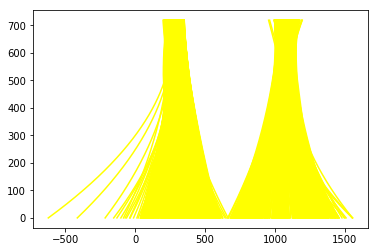

In [28]:
line = Line()
project_output = 'test_videos_output/ouput_project_video.mp4'
left_fit = None
right_fit = None

## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip1 = VideoFileClip("project_video.mp4")
project_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time project_clip.write_videofile(project_output, audio=False)

In [29]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(project_output))


## Challenge Video Video

[]
fresh
(3538,)
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 290.82919192868565
Curvature: 290.82919192868565 
[MoviePy] >>>> Building video test_videos_output/ouput_challenge_video.mp4
[MoviePy] Writing video test_videos_output/ouput_challenge_video.mp4


  0%|          | 1/485 [00:00<04:43,  1.71it/s]

[  6.16336473e-04  -1.37189498e+00   9.93211101e+02]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 369.6208927019936
Curvature: 369.6208927019936 


  0%|          | 2/485 [00:01<04:22,  1.84it/s]

[  6.16336473e-04  -1.37189498e+00   9.93211101e+02]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 403.18516316027626
Curvature: 403.18516316027626 


  1%|          | 3/485 [00:01<04:04,  1.97it/s]

[  7.40885677e-04  -1.54365506e+00   1.05152054e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 408.00777039006545
Curvature: 408.00777039006545 


  1%|          | 4/485 [00:01<03:51,  2.08it/s]

[  7.13279869e-04  -1.52072141e+00   1.04951336e+03]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 418.7792022291331
Curvature: 418.7792022291331 


  1%|          | 5/485 [00:02<03:42,  2.16it/s]

[  7.62541672e-04  -1.59476443e+00   1.07549445e+03]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 420.29298827114917
Curvature: 420.29298827114917 


  1%|          | 6/485 [00:02<03:36,  2.21it/s]

[  7.22984737e-04  -1.57423178e+00   1.08045272e+03]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 439.1606186945504
Curvature: 439.1606186945504 


  1%|▏         | 7/485 [00:03<03:32,  2.25it/s]

[  8.58320570e-04  -1.76665701e+00   1.14924555e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 515.703658219563
Curvature: 515.703658219563 


  2%|▏         | 8/485 [00:03<03:29,  2.28it/s]

[  1.25658659e-03  -2.28859068e+00   1.32260980e+03]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 469.43351485243704
Curvature: 469.43351485243704 


  2%|▏         | 9/485 [00:03<03:26,  2.30it/s]

[  1.03946866e-03  -2.02112337e+00   1.24194603e+03]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 534.4020170961196
Curvature: 534.4020170961196 


  2%|▏         | 10/485 [00:04<03:25,  2.31it/s]

[  1.32277522e-03  -2.40340171e+00   1.37318453e+03]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 365.5792947926881
Curvature: 365.5792947926881 


  2%|▏         | 11/485 [00:04<03:22,  2.34it/s]

[  7.87143040e-04  -1.73146805e+00   1.16492993e+03]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 358.336347486945
Curvature: 358.336347486945 


  2%|▏         | 12/485 [00:05<03:22,  2.34it/s]

[  6.71999168e-04  -1.58783359e+00   1.11995295e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 354.0332136461727
Curvature: 354.0332136461727 


  3%|▎         | 13/485 [00:05<03:21,  2.35it/s]

[  5.68386038e-04  -1.44373924e+00   1.07003084e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 348.1007179589581
Curvature: 348.1007179589581 


  3%|▎         | 14/485 [00:06<03:31,  2.23it/s]

[  6.67755473e-04  -1.57238388e+00   1.11162885e+03]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 344.13898358964497
Curvature: 344.13898358964497 


  3%|▎         | 15/485 [00:06<03:31,  2.22it/s]

[  5.41034625e-04  -1.41812245e+00   1.06598617e+03]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 361.81283032647787
Curvature: 361.81283032647787 


  3%|▎         | 16/485 [00:07<03:28,  2.25it/s]

[  4.78626641e-04  -1.34328106e+00   1.04344853e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 288.76378693884567
Curvature: 288.76378693884567 


  4%|▎         | 17/485 [00:07<03:25,  2.27it/s]

[  3.92221803e-04  -1.24910363e+00   1.01898386e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 295.0815370893991
Curvature: 295.0815370893991 


  4%|▎         | 18/485 [00:07<03:22,  2.30it/s]

[  4.22513712e-04  -1.28439422e+00   1.02955257e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 276.32500813404954
Curvature: 276.32500813404954 


  4%|▍         | 19/485 [00:08<03:21,  2.32it/s]

[  4.48950792e-04  -1.33642775e+00   1.05456507e+03]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 273.2782300181444
Curvature: 273.2782300181444 


  4%|▍         | 20/485 [00:08<03:20,  2.32it/s]

[  3.57248950e-04  -1.22009181e+00   1.01683537e+03]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 244.3480047511407
Curvature: 244.3480047511407 


  4%|▍         | 21/485 [00:09<03:32,  2.18it/s]

[  1.25751189e-04  -9.57078816e-01   9.45722227e+02]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 230.01966461945648
Curvature: 230.01966461945648 


  5%|▍         | 22/485 [00:09<03:26,  2.24it/s]

[ -1.22571555e-04  -6.48001671e-01   8.50956043e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 277.8348132291254
Curvature: 277.8348132291254 


  5%|▍         | 23/485 [00:10<03:23,  2.27it/s]

[  2.98317310e-04  -1.16629512e+00   1.01073266e+03]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 301.8180795009804
Curvature: 301.8180795009804 


  5%|▍         | 24/485 [00:10<03:23,  2.27it/s]

[  4.68360675e-04  -1.37730844e+00   1.07332923e+03]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 287.15521505519814
Curvature: 287.15521505519814 


  5%|▌         | 25/485 [00:11<03:32,  2.16it/s]

[  3.51626160e-04  -1.24955350e+00   1.04297374e+03]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 286.3810332594893
Curvature: 286.3810332594893 


  5%|▌         | 26/485 [00:11<03:27,  2.21it/s]

[  2.71139669e-04  -1.17412443e+00   1.03028591e+03]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 293.58967901350064
Curvature: 293.58967901350064 


  6%|▌         | 27/485 [00:12<03:46,  2.02it/s]

[  3.65900969e-04  -1.30498419e+00   1.07945646e+03]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 320.09855038615774
Curvature: 320.09855038615774 


  6%|▌         | 28/485 [00:12<03:43,  2.04it/s]

[  6.18892173e-04  -1.62382104e+00   1.17831841e+03]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 304.82530386551133
Curvature: 304.82530386551133 


  6%|▌         | 29/485 [00:13<03:34,  2.13it/s]

[  5.92133211e-04  -1.62202697e+00   1.19018988e+03]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 340.00825678326925
Curvature: 340.00825678326925 


  6%|▌         | 30/485 [00:13<03:27,  2.19it/s]

[  8.86509238e-04  -2.02486410e+00   1.32786088e+03]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 285.607145172744
Curvature: 285.607145172744 


  6%|▋         | 31/485 [00:13<03:22,  2.24it/s]

[  6.92779853e-04  -1.78261958e+00   1.25176551e+03]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 294.8557627562686
Curvature: 294.8557627562686 


  7%|▋         | 32/485 [00:14<03:28,  2.18it/s]

[  8.16165301e-04  -1.94962735e+00   1.30806108e+03]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 218.7798788610633
Curvature: 218.7798788610633 


  7%|▋         | 33/485 [00:14<03:33,  2.12it/s]

[  2.74058751e-04  -1.27919364e+00   1.10511303e+03]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 295.24537737287665
Curvature: 295.24537737287665 


  7%|▋         | 34/485 [00:15<03:32,  2.12it/s]

[  8.49334398e-04  -1.98697942e+00   1.32143448e+03]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 381.0971212895447
Curvature: 381.0971212895447 


  7%|▋         | 35/485 [00:15<03:43,  2.01it/s]

[  1.36161703e-03  -2.62210142e+00   1.51672012e+03]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 519.0682312977077
Curvature: 519.0682312977077 


  7%|▋         | 36/485 [00:16<03:45,  1.99it/s]

[  2.11352058e-03  -3.53611895e+00   1.79056130e+03]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 602.2884794760195
Curvature: 602.2884794760195 


  8%|▊         | 37/485 [00:16<03:42,  2.01it/s]

[  2.30672967e-03  -3.80590705e+00   1.88459212e+03]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 719.8628860192562
Curvature: 719.8628860192562 


  8%|▊         | 38/485 [00:17<03:32,  2.10it/s]

[  2.35493240e-03  -3.94081225e+00   1.95240648e+03]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 763.6653372989538
Curvature: 763.6653372989538 


  8%|▊         | 39/485 [00:17<03:25,  2.17it/s]

[  2.50935393e-03  -4.15415829e+00   2.02705002e+03]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 815.6176453672617
Curvature: 815.6176453672617 


  8%|▊         | 40/485 [00:18<03:22,  2.20it/s]

[  2.53762676e-03  -4.22101069e+00   2.06043819e+03]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 835.4144261986004
Curvature: 835.4144261986004 


  8%|▊         | 41/485 [00:18<03:20,  2.22it/s]

[  2.54682020e-03  -4.24706527e+00   2.07459457e+03]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 864.675851663628
Curvature: 864.675851663628 


  9%|▊         | 42/485 [00:19<03:20,  2.21it/s]

[  2.71013512e-03  -4.39885417e+00   2.10209098e+03]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 914.671845381182
Curvature: 914.671845381182 


  9%|▉         | 43/485 [00:19<03:17,  2.24it/s]

[  2.90963118e-03  -4.64930896e+00   2.17861123e+03]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 939.3960277744571
Curvature: 939.3960277744571 


  9%|▉         | 44/485 [00:19<03:14,  2.27it/s]

[  2.90200737e-03  -4.73010935e+00   2.23903433e+03]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 1063.913172201085
Curvature: 1063.913172201085 


  9%|▉         | 45/485 [00:20<03:12,  2.28it/s]

[  3.36467232e-03  -5.27057793e+00   2.39513467e+03]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 1077.1972800808992
Curvature: 1077.1972800808992 


  9%|▉         | 46/485 [00:20<03:09,  2.31it/s]

[  3.40560475e-03  -5.41700984e+00   2.47875014e+03]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 1071.7772285621293
Curvature: 1071.7772285621293 


 10%|▉         | 47/485 [00:21<03:09,  2.31it/s]

[  3.37729085e-03  -5.40904854e+00   2.48552751e+03]
fast
(720,)
(720,)
(720,)
Center: 0.52m 
 Curvature: 1091.3897732604064
Curvature: 1091.3897732604064 


 10%|▉         | 48/485 [00:21<03:08,  2.32it/s]

[  3.30431815e-03  -5.39521473e+00   2.50721145e+03]
fast
(720,)
(720,)
(720,)
Center: 0.57m 
 Curvature: 1180.8954179644213
Curvature: 1180.8954179644213 


 10%|█         | 49/485 [00:22<03:08,  2.31it/s]

[  3.41678800e-03  -5.56033040e+00   2.57180434e+03]
fast
(720,)
(720,)
(720,)
Center: 0.56m 
 Curvature: 1279.566287686047
Curvature: 1279.566287686047 


 10%|█         | 50/485 [00:22<03:06,  2.33it/s]

[  3.39541046e-03  -5.65740763e+00   2.64650880e+03]
fast
(720,)
(720,)
(720,)
Center: 0.56m 
 Curvature: 1378.8878622392017
Curvature: 1378.8878622392017 


 11%|█         | 51/485 [00:22<03:05,  2.34it/s]

[  3.33680486e-03  -5.69781398e+00   2.70134316e+03]
fast
(720,)
(720,)
(720,)
Center: 0.54m 
 Curvature: 1411.9199165949703
Curvature: 1411.9199165949703 


 11%|█         | 52/485 [00:23<03:07,  2.31it/s]

[  2.98521022e-03  -5.43283450e+00   2.67932178e+03]
fast
(720,)
(720,)
(720,)
Center: 0.49m 
 Curvature: 1437.9506419667039
Curvature: 1437.9506419667039 


 11%|█         | 53/485 [00:23<03:04,  2.34it/s]

[  2.46161029e-03  -5.02146745e+00   2.62684827e+03]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 1541.7561524466353
Curvature: 1541.7561524466353 


 11%|█         | 54/485 [00:24<03:04,  2.33it/s]

[  2.23240878e-03  -4.93581512e+00   2.66224508e+03]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 1543.9840884768114
Curvature: 1543.9840884768114 


 11%|█▏        | 55/485 [00:24<03:04,  2.34it/s]

[  1.98824025e-03  -4.73463386e+00   2.63210016e+03]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 1732.8575165010216
Curvature: 1732.8575165010216 


 12%|█▏        | 56/485 [00:25<03:05,  2.31it/s]

[  2.59576249e-03  -5.52052195e+00   2.88465161e+03]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 1970.911376943423
Curvature: 1970.911376943423 


 12%|█▏        | 57/485 [00:25<03:04,  2.32it/s]

[  3.16467089e-03  -6.32800924e+00   3.16891380e+03]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 2301.303236079899
Curvature: 2301.303236079899 


 12%|█▏        | 58/485 [00:25<03:03,  2.33it/s]

[  4.07004438e-03  -7.55159959e+00   3.57730914e+03]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 2971.4967863069687
Curvature: 2971.4967863069687 


 12%|█▏        | 59/485 [00:26<03:02,  2.34it/s]

[  5.64804198e-03  -9.57129035e+00   4.21540744e+03]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 4069.387121696019
Curvature: 4069.387121696019 


 12%|█▏        | 60/485 [00:26<03:01,  2.34it/s]

[  7.67895948e-03  -1.21711638e+01   5.04276043e+03]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 4421.913662822103
Curvature: 4421.913662822103 


 13%|█▎        | 61/485 [00:27<03:00,  2.35it/s]

[  7.95974554e-03  -1.26964166e+01   5.26894985e+03]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 4140.989708246261
Curvature: 4140.989708246261 


 13%|█▎        | 62/485 [00:27<02:59,  2.36it/s]

[  7.20824833e-03  -1.19064975e+01   5.07822957e+03]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 4344.101753853408
Curvature: 4344.101753853408 


 13%|█▎        | 63/485 [00:28<02:58,  2.36it/s]

[  7.27889888e-03  -1.21065025e+01   5.18383973e+03]
fast
(720,)
(720,)
(720,)
Center: 0.55m 
 Curvature: 5000.18433885254
Curvature: 5000.18433885254 


 13%|█▎        | 64/485 [00:28<02:58,  2.36it/s]

[  8.26881529e-03  -1.33599114e+01   5.58125318e+03]
fast
(720,)
(720,)
(720,)
Center: 0.55m 
 Curvature: 5768.6962952662825
Curvature: 5768.6962952662825 


 13%|█▎        | 65/485 [00:28<02:58,  2.36it/s]

[  9.39548506e-03  -1.47852399e+01   6.02101930e+03]
fast
(720,)
(720,)
(720,)
Center: 0.55m 
 Curvature: 7062.028322765081
Curvature: 7062.028322765081 


 14%|█▎        | 66/485 [00:29<03:03,  2.28it/s]

[  1.10256663e-02  -1.68918971e+01   6.69213750e+03]
fast
(720,)
(720,)
(720,)
Center: 0.59m 
 Curvature: 9071.690824621279
Curvature: 9071.690824621279 


 14%|█▍        | 67/485 [00:29<03:01,  2.31it/s]

[  1.35865275e-02  -2.00239555e+01   7.63544089e+03]
fast
(720,)
(720,)
(720,)
Center: 0.59m 
 Curvature: 8773.333090450664
Curvature: 8773.333090450664 


 14%|█▍        | 68/485 [00:30<02:59,  2.32it/s]

[  1.32686974e-02  -1.95660553e+01   7.47502106e+03]
fast
(720,)
(720,)
(720,)
Center: 0.60m 
 Curvature: 7577.008527463293
Curvature: 7577.008527463293 


 14%|█▍        | 69/485 [00:30<02:58,  2.33it/s]

[  1.19662599e-02  -1.78415170e+01   6.91291575e+03]
fast
(720,)
(720,)
(720,)
Center: 0.66m 
 Curvature: 6275.7723250688
Curvature: 6275.7723250688 


 14%|█▍        | 70/485 [00:31<02:57,  2.34it/s]

[  1.06554587e-02  -1.59728744e+01   6.26055418e+03]
fast
(720,)
(720,)
(720,)
Center: 0.68m 
 Curvature: 5880.53267118706
Curvature: 5880.53267118706 


 15%|█▍        | 71/485 [00:31<02:56,  2.34it/s]

[  1.04726647e-02  -1.56452574e+01   6.12273399e+03]
fast
(720,)
(720,)
(720,)
Center: 0.67m 
 Curvature: 5053.378664178485
Curvature: 5053.378664178485 


 15%|█▍        | 72/485 [00:31<02:56,  2.35it/s]

[  9.37669270e-03  -1.42456993e+01   5.66645926e+03]
fast
(720,)
(720,)
(720,)
Center: 0.68m 
 Curvature: 4253.584814544854
Curvature: 4253.584814544854 


 15%|█▌        | 73/485 [00:32<02:55,  2.35it/s]

[  8.01575970e-03  -1.25697361e+01   5.14884032e+03]
fast
(720,)
(720,)
(720,)
Center: 0.73m 
 Curvature: 5344.496769639318
Curvature: 5344.496769639318 


 15%|█▌        | 74/485 [00:32<02:58,  2.30it/s]

[  9.85405693e-03  -1.48025910e+01   5.81635640e+03]
fast
(720,)
(720,)
(720,)
Center: 0.79m 
 Curvature: 6261.248299982118
Curvature: 6261.248299982118 


 15%|█▌        | 75/485 [00:33<02:57,  2.31it/s]

[  1.10893190e-02  -1.63508166e+01   6.30062746e+03]
fast
(720,)
(720,)
(720,)
Center: 0.85m 
 Curvature: 8705.675841979533
Curvature: 8705.675841979533 


 16%|█▌        | 76/485 [00:33<02:58,  2.30it/s]

[  1.41544068e-02  -2.01807141e+01   7.48613263e+03]
fast
(720,)
(720,)
(720,)
Center: 0.90m 
 Curvature: 11682.195537563126
Curvature: 11682.195537563126 


 16%|█▌        | 77/485 [00:34<02:56,  2.32it/s]

[  1.72398591e-02  -2.41141206e+01   8.73403069e+03]
fast
(720,)
(720,)
(720,)
Center: 0.94m 
 Curvature: 15565.743520920674
Curvature: 15565.743520920674 


 16%|█▌        | 78/485 [00:34<02:54,  2.33it/s]

[  2.06475288e-02  -2.85200355e+01   1.01536532e+04]
fast
(720,)
(720,)
(720,)
Center: 0.96m 
 Curvature: 20416.93336629504
Curvature: 20416.93336629504 


 16%|█▋        | 79/485 [00:34<02:53,  2.34it/s]

[  2.42479001e-02  -3.32082518e+01   1.16747638e+04]
fast
(720,)
(720,)
(720,)
Center: 0.95m 
 Curvature: 19346.58508251476
Curvature: 19346.58508251476 


 16%|█▋        | 80/485 [00:35<02:52,  2.34it/s]

[  2.34802732e-02  -3.22115191e+01   1.13487423e+04]
fast
(720,)
(720,)
(720,)
Center: 0.92m 
 Curvature: 20761.260599596397
Curvature: 20761.260599596397 


 17%|█▋        | 81/485 [00:35<02:52,  2.35it/s]

[  2.46877710e-02  -3.36755119e+01   1.17734558e+04]
fast
(720,)
(720,)
(720,)
Center: 0.89m 
 Curvature: 26300.108271410278
Curvature: 26300.108271410278 


 17%|█▋        | 82/485 [00:36<02:52,  2.34it/s]

[  2.86187971e-02  -3.86484796e+01   1.33135802e+04]
fast
(720,)
(720,)
(720,)
Center: 0.87m 
 Curvature: 32466.952894669517
Curvature: 32466.952894669517 


 17%|█▋        | 83/485 [00:36<02:51,  2.34it/s]

[  3.26826176e-02  -4.37140073e+01   1.48579734e+04]
fast
(720,)
(720,)
(720,)
Center: 0.92m 
 Curvature: 35785.99933262781
Curvature: 35785.99933262781 


 17%|█▋        | 84/485 [00:37<02:51,  2.34it/s]

[  3.48707994e-02  -4.63590339e+01   1.56336067e+04]
fast
(720,)
(720,)
(720,)
Center: 0.99m 
 Curvature: 37452.392451284715
Curvature: 37452.392451284715 


 18%|█▊        | 85/485 [00:37<02:52,  2.32it/s]

[  3.60218998e-02  -4.76881938e+01   1.60012362e+04]
fast
(720,)
(720,)
(720,)
Center: 0.98m 
 Curvature: 35390.08107667188
Curvature: 35390.08107667188 


 18%|█▊        | 86/485 [00:37<02:51,  2.33it/s]

[  3.49215863e-02  -4.62795745e+01   1.55403631e+04]
fast
(720,)
(720,)
(720,)
Center: 0.94m 
 Curvature: 29655.367995509314
Curvature: 29655.367995509314 


 18%|█▊        | 87/485 [00:38<02:51,  2.32it/s]

[  3.16140642e-02  -4.20536140e+01   1.41959046e+04]
fast
(720,)
(720,)
(720,)
Center: 0.89m 
 Curvature: 26007.59991901022
Curvature: 26007.59991901022 


 18%|█▊        | 88/485 [00:38<02:50,  2.33it/s]

[  2.96153590e-02  -3.93554082e+01   1.32906580e+04]
fast
(720,)
(720,)
(720,)
Center: 0.83m 
 Curvature: 26222.890772660812
Curvature: 26222.890772660812 


 18%|█▊        | 89/485 [00:39<02:49,  2.34it/s]

[  2.98003975e-02  -3.95768158e+01   1.33479594e+04]
fast
(720,)
(720,)
(720,)
Center: 0.77m 
 Curvature: 24351.865698062364
Curvature: 24351.865698062364 


 19%|█▊        | 90/485 [00:39<02:50,  2.32it/s]

[  2.84208107e-02  -3.79117530e+01   1.28485046e+04]
fast
(720,)
(720,)
(720,)
Center: 0.82m 
 Curvature: 26630.546058298518
Curvature: 26630.546058298518 


 19%|█▉        | 91/485 [00:40<02:49,  2.33it/s]

[  3.00726644e-02  -3.99099429e+01   1.34468254e+04]
fast
(720,)
(720,)
(720,)
Center: 0.84m 
 Curvature: 28024.85099875035
Curvature: 28024.85099875035 


 19%|█▉        | 92/485 [00:40<02:48,  2.33it/s]

[  3.10469172e-02  -4.10721981e+01   1.37938948e+04]
fast
(720,)
(720,)
(720,)
Center: 0.76m 
 Curvature: 21597.99502410544
Curvature: 21597.99502410544 


 19%|█▉        | 93/485 [00:40<02:50,  2.30it/s]

[  2.66798543e-02  -3.55612398e+01   1.20673743e+04]
fast
(720,)
(720,)
(720,)
Center: 0.65m 
 Curvature: 17865.75311551056
Curvature: 17865.75311551056 


 19%|█▉        | 94/485 [00:41<02:49,  2.31it/s]

[  2.39742961e-02  -3.20690468e+01   1.09508330e+04]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 16155.874270571336
Curvature: 16155.874270571336 


 20%|█▉        | 95/485 [00:41<02:52,  2.26it/s]

[  2.28171374e-02  -3.04990623e+01   1.04221114e+04]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 13082.01475974803
Curvature: 13082.01475974803 


 20%|█▉        | 96/485 [00:42<03:02,  2.13it/s]

[  2.02764559e-02  -2.71865742e+01   9.34716855e+03]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 11867.744384756106
Curvature: 11867.744384756106 


 20%|██        | 97/485 [00:43<03:18,  1.96it/s]

[  1.94450277e-02  -2.59458169e+01   8.89750979e+03]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 10175.61913593199
Curvature: 10175.61913593199 


 20%|██        | 98/485 [00:43<03:09,  2.04it/s]

[  1.81322618e-02  -2.40749243e+01   8.24157578e+03]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 10022.317336859784
Curvature: 10022.317336859784 


 20%|██        | 99/485 [00:44<03:17,  1.95it/s]

[  1.81351025e-02  -2.39788750e+01   8.18401668e+03]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 11435.791745056431
Curvature: 11435.791745056431 


 21%|██        | 100/485 [00:44<03:43,  1.72it/s]

[  1.98534082e-02  -2.59877774e+01   8.76625906e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 12148.226986708665
Curvature: 12148.226986708665 


 21%|██        | 101/485 [00:45<03:41,  1.74it/s]

[  2.05355336e-02  -2.68549816e+01   9.04499562e+03]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 12935.794892696103
Curvature: 12935.794892696103 


 21%|██        | 102/485 [00:45<03:33,  1.80it/s]

[  2.13256556e-02  -2.78223970e+01   9.34254953e+03]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 14193.681658638156
Curvature: 14193.681658638156 


 21%|██        | 103/485 [00:46<03:30,  1.81it/s]

[  2.26367354e-02  -2.93795706e+01   9.79913834e+03]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 12880.797377154457
Curvature: 12880.797377154457 


 21%|██▏       | 104/485 [00:46<03:27,  1.84it/s]

[  2.15811874e-02  -2.79657172e+01   9.32536078e+03]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 12841.165660261762
Curvature: 12841.165660261762 


 22%|██▏       | 105/485 [00:47<03:22,  1.88it/s]

[  2.18056231e-02  -2.80994404e+01   9.31294477e+03]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 12654.50247175639
Curvature: 12654.50247175639 


 22%|██▏       | 106/485 [00:47<03:16,  1.93it/s]

[  2.18398053e-02  -2.80290824e+01   9.24481062e+03]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 12765.033165314715
Curvature: 12765.033165314715 


 22%|██▏       | 107/485 [00:48<03:11,  1.97it/s]

[  2.21034789e-02  -2.82876181e+01   9.28617107e+03]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 11700.322190327268
Curvature: 11700.322190327268 


 22%|██▏       | 108/485 [00:48<03:12,  1.96it/s]

[  2.10365189e-02  -2.69904387e+01   8.88232089e+03]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 9734.747142174529
Curvature: 9734.747142174529 


 22%|██▏       | 109/485 [00:49<03:08,  1.99it/s]

[  1.88474810e-02  -2.43470822e+01   8.08410269e+03]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 8768.978552388087
Curvature: 8768.978552388087 


 23%|██▎       | 110/485 [00:49<03:04,  2.03it/s]

[  1.79234616e-02  -2.30833223e+01   7.66294678e+03]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 8163.7971297855465
Curvature: 8163.7971297855465 


 23%|██▎       | 111/485 [00:50<03:04,  2.02it/s]

[  1.74752375e-02  -2.23521284e+01   7.38524154e+03]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 8288.453625394824
Curvature: 8288.453625394824 


 23%|██▎       | 112/485 [00:50<03:03,  2.04it/s]

[  1.78118758e-02  -2.26549605e+01   7.44270280e+03]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 8487.453649169576
Curvature: 8487.453649169576 


 23%|██▎       | 113/485 [00:51<03:05,  2.01it/s]

[  1.81436608e-02  -2.29727405e+01   7.51071724e+03]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 9575.807303061023
Curvature: 9575.807303061023 


 24%|██▎       | 114/485 [00:51<03:03,  2.02it/s]

[  1.95330137e-02  -2.46119976e+01   7.98777853e+03]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 9961.52315438808
Curvature: 9961.52315438808 


 24%|██▎       | 115/485 [00:52<03:02,  2.03it/s]

[  1.99500058e-02  -2.51559141e+01   8.16469711e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 9894.653894846087
Curvature: 9894.653894846087 


 24%|██▍       | 116/485 [00:52<03:00,  2.04it/s]

[  1.97490241e-02  -2.49974884e+01   8.14865215e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 9883.381818493868
Curvature: 9883.381818493868 


 24%|██▍       | 117/485 [00:53<02:59,  2.06it/s]

[  1.96935620e-02  -2.49537834e+01   8.14439433e+03]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 8839.491075751153
Curvature: 8839.491075751153 


 24%|██▍       | 118/485 [00:53<02:58,  2.05it/s]

[  1.85286074e-02  -2.35175869e+01   7.70892375e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 8664.975060147593
Curvature: 8664.975060147593 


 25%|██▍       | 119/485 [00:54<02:56,  2.08it/s]

[  1.82725861e-02  -2.32216022e+01   7.63193222e+03]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 3452.47194157872
Curvature: 3452.47194157872 


 25%|██▍       | 120/485 [00:54<02:58,  2.05it/s]

[  1.10614807e-02  -1.40197786e+01   4.71313988e+03]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 1195.558442700359
Curvature: 1195.558442700359 


 25%|██▍       | 121/485 [00:55<02:57,  2.05it/s]

[  5.02018047e-03  -6.73183472e+00   2.55479008e+03]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 489.1423958752142
Curvature: 489.1423958752142 


 25%|██▌       | 122/485 [00:55<02:59,  2.02it/s]

[  1.19200778e-03  -2.14806137e+00   1.20649585e+03]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 313.9493189793786
Curvature: 313.9493189793786 


 25%|██▌       | 123/485 [00:56<03:02,  1.98it/s]

[ -5.72699642e-04  -1.30900245e-03   5.64759044e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 253.25404755764558
Curvature: 253.25404755764558 


 26%|██▌       | 124/485 [00:56<03:07,  1.93it/s]

[ -1.79844106e-03   1.56966859e+00   7.04130917e+01]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 271.3952002961226
Curvature: 271.3952002961226 


 26%|██▌       | 125/485 [00:57<03:05,  1.94it/s]

[ -2.63184960e-03   2.68758227e+00  -2.96510882e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 274.0706772100838
Curvature: 274.0706772100838 


 26%|██▌       | 126/485 [00:57<03:06,  1.93it/s]

[ -2.93056612e-03   3.10037319e+00  -4.32886659e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 430.12753973453977
Curvature: 430.12753973453977 


 26%|██▌       | 127/485 [00:58<03:23,  1.76it/s]

[ -4.62152166e-03   5.25353972e+00  -1.11015186e+03]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 660.2129378260609
Curvature: 660.2129378260609 
[ -6.02244999e-03   7.12489892e+00  -1.72704383e+03]
fast


 26%|██▋       | 128/485 [00:59<04:43,  1.26it/s]

(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 2902.786647770195
Curvature: 2902.786647770195 


 27%|██▋       | 129/485 [01:00<04:30,  1.32it/s]

[ -1.17442490e-02   1.48494413e+01  -4.32421568e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 10448.935487714312
Curvature: 10448.935487714312 


 27%|██▋       | 130/485 [01:00<03:55,  1.51it/s]

[ -2.06115147e-02   2.69283554e+01  -8.43091205e+03]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 87580.11502861118
Curvature: 87580.11502861118 


 27%|██▋       | 131/485 [01:01<03:28,  1.70it/s]

[ -5.50806846e-02   7.41391430e+01  -2.45749421e+04]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 290709.64600951766
Curvature: 290709.64600951766 


 27%|██▋       | 132/485 [01:01<03:09,  1.86it/s]

[ -9.47524145e-02   1.30863761e+02  -4.48016672e+04]
fast
(720,)
(720,)
(720,)
Center: -0.81m 
 Curvature: 2743972.6353972075
Curvature: 2743972.6353972075 


 27%|██▋       | 133/485 [01:02<02:57,  1.99it/s]

[ -2.94997891e-01   4.03567773e+02  -1.37684359e+05]
fast
(720,)
(720,)
(720,)
Center: -0.41m 
 Curvature: 15895.903970575358
Curvature: 15895.903970575358 


 28%|██▊       | 134/485 [01:02<02:49,  2.08it/s]

[ -3.18774358e-02   3.74628750e+01  -1.02840324e+04]
fast
(720,)
(720,)
(720,)
Center: -0.37m 
 Curvature: 10822.885912154501
Curvature: 10822.885912154501 


 28%|██▊       | 135/485 [01:03<02:41,  2.16it/s]

[ -2.69564192e-02   3.14090902e+01  -8.43498396e+03]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 3151.509984721045
Curvature: 3151.509984721045 


 28%|██▊       | 136/485 [01:03<02:38,  2.21it/s]

[ -1.58513363e-02   1.81178634e+01  -4.46479734e+03]
fast
(720,)
(720,)
(720,)
Center: 0.31m 
 Curvature: 595.8922318978857
Curvature: 595.8922318978857 


 28%|██▊       | 137/485 [01:03<02:36,  2.23it/s]

[ -7.65644677e-03   8.35292618e+00  -1.56368744e+03]
fast
(720,)
(720,)
(720,)
Center: 0.64m 
 Curvature: 506.36832688723155
Curvature: 506.36832688723155 


 28%|██▊       | 138/485 [01:04<02:38,  2.18it/s]

[ -6.54314763e-03   7.34143370e+00  -1.34223720e+03]
fast
(720,)
(720,)
(720,)
Center: 0.77m 
 Curvature: 427.22709180960317
Curvature: 427.22709180960317 


 29%|██▊       | 139/485 [01:04<02:35,  2.22it/s]

[ -5.54814363e-03   6.35224235e+00  -1.10789398e+03]
fast
(720,)
(720,)
(720,)
Center: 0.88m 
 Curvature: 320.7715979785438
Curvature: 320.7715979785438 


 29%|██▉       | 140/485 [01:05<02:32,  2.26it/s]

[ -3.79516181e-03   4.57297062e+00  -6.95283911e+02]
fast
(720,)
(720,)
(720,)
Center: 0.92m 
 Curvature: 282.95931044003146
Curvature: 282.95931044003146 


 29%|██▉       | 141/485 [01:05<02:29,  2.30it/s]

[ -2.88378922e-03   3.62158101e+00  -4.60898394e+02]
fast
(720,)
(720,)
(720,)
Center: 1.00m 
 Curvature: 254.05056270581096
Curvature: 254.05056270581096 


 29%|██▉       | 142/485 [01:06<02:28,  2.31it/s]

[ -1.04262595e-03   1.75117333e+00  -3.00884195e+01]
fast
(720,)
(720,)
(720,)
Center: 1.11m 
 Curvature: 290.8683044984764
Curvature: 290.8683044984764 


 29%|██▉       | 143/485 [01:06<02:28,  2.30it/s]

[  1.15910109e-03  -4.94517592e-01   4.97360724e+02]
fast
(720,)
(720,)
(720,)
Center: 1.16m 
 Curvature: 399.30779667128195
Curvature: 399.30779667128195 


 30%|██▉       | 144/485 [01:06<02:27,  2.32it/s]

[  3.23250893e-03  -2.62945528e+00   9.96246578e+02]
fast
(720,)
(720,)
(720,)
Center: 1.06m 
 Curvature: 375.88021324534736
Curvature: 375.88021324534736 


 30%|██▉       | 145/485 [01:07<02:26,  2.32it/s]

[  2.81799405e-03  -2.28546420e+00   9.24700234e+02]
fast
(720,)
(720,)
(720,)
Center: 0.98m 
 Curvature: 364.6639751423771
Curvature: 364.6639751423771 


 30%|███       | 146/485 [01:07<02:24,  2.34it/s]

[  2.47141235e-03  -2.01884851e+00   8.77049084e+02]
fast
(720,)
(720,)
(720,)
Center: 0.93m 
 Curvature: 348.1236143261663
Curvature: 348.1236143261663 


 30%|███       | 147/485 [01:08<02:24,  2.33it/s]

[  2.44922312e-03  -1.94914714e+00   8.32201398e+02]
fast
(720,)
(720,)
(720,)
Center: 0.79m 
 Curvature: 335.71087123879533
Curvature: 335.71087123879533 


 31%|███       | 148/485 [01:08<02:34,  2.18it/s]

[  2.14957741e-03  -1.74217675e+00   7.92053268e+02]
fast
(720,)
(720,)
(720,)
Center: 0.67m 
 Curvature: 335.78058925882226
Curvature: 335.78058925882226 


 31%|███       | 149/485 [01:09<02:30,  2.23it/s]

[  1.99533597e-03  -1.69203168e+00   7.90954237e+02]
fast
(720,)
(720,)
(720,)
Center: 0.51m 
 Curvature: 337.04401065776597
Curvature: 337.04401065776597 


 31%|███       | 150/485 [01:09<02:26,  2.28it/s]

[  1.73749289e-03  -1.60482208e+00   7.91556856e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 329.0919486561962
Curvature: 329.0919486561962 


 31%|███       | 151/485 [01:10<02:25,  2.29it/s]

[  9.65524062e-04  -1.23398208e+00   7.59229423e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 338.27219505565847
Curvature: 338.27219505565847 


 31%|███▏      | 152/485 [01:10<02:25,  2.30it/s]

[  9.40976221e-04  -1.30346906e+00   7.93407278e+02]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 340.9330506261153
Curvature: 340.9330506261153 


 32%|███▏      | 153/485 [01:10<02:23,  2.31it/s]

[  9.91036885e-04  -1.40154755e+00   8.21450323e+02]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 343.0775403509701
Curvature: 343.0775403509701 


 32%|███▏      | 154/485 [01:11<02:22,  2.32it/s]

[  9.80432157e-04  -1.42840678e+00   8.37666889e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 335.74149876038103
Curvature: 335.74149876038103 


 32%|███▏      | 155/485 [01:11<02:21,  2.34it/s]

[  8.72149618e-04  -1.33323384e+00   8.13638086e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 332.42483289585346
Curvature: 332.42483289585346 


 32%|███▏      | 156/485 [01:12<02:19,  2.36it/s]

[  8.40281675e-04  -1.29802206e+00   7.99412262e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 336.4708931333125
Curvature: 336.4708931333125 


 32%|███▏      | 157/485 [01:12<02:18,  2.37it/s]

[  8.64257863e-04  -1.31212942e+00   8.01634746e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 361.9056748983612
Curvature: 361.9056748983612 


 33%|███▎      | 158/485 [01:13<02:18,  2.36it/s]

[  1.36348907e-03  -1.87716362e+00   9.35910436e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 362.61318178108615
Curvature: 362.61318178108615 


 33%|███▎      | 159/485 [01:13<02:17,  2.37it/s]

[  1.10802462e-03  -1.65909406e+00   8.98177973e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 382.19576720913494
Curvature: 382.19576720913494 


 33%|███▎      | 160/485 [01:13<02:16,  2.37it/s]

[  1.38645712e-03  -2.00669333e+00   9.94875699e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 371.32531167032585
Curvature: 371.32531167032585 


 33%|███▎      | 161/485 [01:14<02:16,  2.38it/s]

[  1.16908180e-03  -1.78082346e+00   9.40122868e+02]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 403.8790117496618
Curvature: 403.8790117496618 


 33%|███▎      | 162/485 [01:14<02:16,  2.37it/s]

[  1.13809663e-03  -1.73660376e+00   9.25467939e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 481.4810972424299
Curvature: 481.4810972424299 


 34%|███▎      | 163/485 [01:15<02:15,  2.37it/s]

[  1.00449067e-03  -1.59140157e+00   8.90405979e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 477.7187601567131
Curvature: 477.7187601567131 


 34%|███▍      | 164/485 [01:15<02:15,  2.37it/s]

[  9.82739740e-04  -1.56304423e+00   8.82935642e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 435.5559978782044
Curvature: 435.5559978782044 


 34%|███▍      | 165/485 [01:15<02:14,  2.38it/s]

[  9.12409728e-04  -1.46907959e+00   8.51196818e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 392.66786470929554
Curvature: 392.66786470929554 


 34%|███▍      | 166/485 [01:16<02:14,  2.36it/s]

[  9.81987279e-04  -1.54422269e+00   8.72310089e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 377.28649224262097
Curvature: 377.28649224262097 


 34%|███▍      | 167/485 [01:16<02:14,  2.37it/s]

[  1.10403811e-03  -1.68180510e+00   9.09666824e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 362.2998148316832
Curvature: 362.2998148316832 


 35%|███▍      | 168/485 [01:17<02:13,  2.38it/s]

[  1.07039286e-03  -1.63745640e+00   8.95578321e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 360.1439013288694
Curvature: 360.1439013288694 


 35%|███▍      | 169/485 [01:17<02:12,  2.38it/s]

[  1.00698450e-03  -1.57202199e+00   8.81936450e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 356.9193156857433
Curvature: 356.9193156857433 


 35%|███▌      | 170/485 [01:18<02:12,  2.38it/s]

[  1.03818804e-03  -1.60736758e+00   8.93813489e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 364.14819220052993
Curvature: 364.14819220052993 


 35%|███▌      | 171/485 [01:18<02:11,  2.38it/s]

[  1.07680396e-03  -1.67007777e+00   9.23241901e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 361.6314641938201
Curvature: 361.6314641938201 


 35%|███▌      | 172/485 [01:18<02:11,  2.38it/s]

[  1.11258420e-03  -1.69879117e+00   9.28585180e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 362.4755895142293
Curvature: 362.4755895142293 


 36%|███▌      | 173/485 [01:19<02:11,  2.37it/s]

[  1.14570052e-03  -1.70837950e+00   9.19933957e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 363.86835509522916
Curvature: 363.86835509522916 


 36%|███▌      | 174/485 [01:19<02:11,  2.37it/s]

[  1.19908548e-03  -1.76507716e+00   9.35743036e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 359.29449571359544
Curvature: 359.29449571359544 


 36%|███▌      | 175/485 [01:20<02:10,  2.37it/s]

[  1.23754232e-03  -1.78397491e+00   9.31017227e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 360.88203747709633
Curvature: 360.88203747709633 


 36%|███▋      | 176/485 [01:20<02:09,  2.38it/s]

[  1.26469450e-03  -1.82152825e+00   9.39270035e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 375.2620086657886
Curvature: 375.2620086657886 


 36%|███▋      | 177/485 [01:21<02:09,  2.38it/s]

[  1.28681287e-03  -1.83729047e+00   9.37713272e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 371.28280467636216
Curvature: 371.28280467636216 


 37%|███▋      | 178/485 [01:21<02:08,  2.38it/s]

[  1.35072886e-03  -1.88172308e+00   9.36874537e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 371.93617881453895
Curvature: 371.93617881453895 


 37%|███▋      | 179/485 [01:21<02:08,  2.38it/s]

[  1.35379993e-03  -1.90351031e+00   9.53233131e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 373.81045992275455
Curvature: 373.81045992275455 


 37%|███▋      | 180/485 [01:22<02:08,  2.37it/s]

[  1.38509950e-03  -1.93233360e+00   9.56835391e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 374.5975374257272
Curvature: 374.5975374257272 


 37%|███▋      | 181/485 [01:22<02:08,  2.37it/s]

[  1.38048320e-03  -1.93050105e+00   9.55343430e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 361.459930280222
Curvature: 361.459930280222 


 38%|███▊      | 182/485 [01:23<02:07,  2.38it/s]

[  1.39701037e-03  -1.93400064e+00   9.45968443e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 367.73615106518446
Curvature: 367.73615106518446 


 38%|███▊      | 183/485 [01:23<02:06,  2.38it/s]

[  1.45528703e-03  -2.01551810e+00   9.78416688e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 375.2828933854172
Curvature: 375.2828933854172 


 38%|███▊      | 184/485 [01:23<02:06,  2.39it/s]

[  1.56750731e-03  -2.14480017e+00   1.01408693e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 370.3612967869555
Curvature: 370.3612967869555 


 38%|███▊      | 185/485 [01:24<02:05,  2.38it/s]

[  1.56573361e-03  -2.12044337e+00   9.97236268e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 365.5764472266185
Curvature: 365.5764472266185 


 38%|███▊      | 186/485 [01:24<02:05,  2.38it/s]

[  1.50202434e-03  -2.06222656e+00   9.88357098e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 376.0065833472387
Curvature: 376.0065833472387 


 39%|███▊      | 187/485 [01:25<02:05,  2.38it/s]

[  1.56484783e-03  -2.13881486e+00   1.01111934e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 380.4550080207605
Curvature: 380.4550080207605 


 39%|███▉      | 188/485 [01:25<02:05,  2.36it/s]

[  1.61598088e-03  -2.19887721e+00   1.03047158e+03]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 430.5361955014619
Curvature: 430.5361955014619 


 39%|███▉      | 189/485 [01:26<02:05,  2.37it/s]

[  1.58602316e-03  -2.19376346e+00   1.03882558e+03]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 496.8843650798814
Curvature: 496.8843650798814 


 39%|███▉      | 190/485 [01:26<02:04,  2.37it/s]

[  1.55316840e-03  -2.17801552e+00   1.04499799e+03]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 468.07558601996976
Curvature: 468.07558601996976 


 39%|███▉      | 191/485 [01:26<02:04,  2.36it/s]

[  1.63023270e-03  -2.27953625e+00   1.07877665e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 406.37854906118355
Curvature: 406.37854906118355 


 40%|███▉      | 192/485 [01:27<02:03,  2.37it/s]

[  1.61156780e-03  -2.25277939e+00   1.06623574e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 384.5766244230946
Curvature: 384.5766244230946 


 40%|███▉      | 193/485 [01:27<02:03,  2.36it/s]

[  1.43025989e-03  -2.04339441e+00   1.00680722e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 386.0809788988102
Curvature: 386.0809788988102 


 40%|████      | 194/485 [01:28<02:03,  2.36it/s]

[  1.43714344e-03  -2.06730181e+00   1.02010978e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 390.1707512800177
Curvature: 390.1707512800177 


 40%|████      | 195/485 [01:28<02:16,  2.13it/s]

[  1.40214706e-03  -2.05204579e+00   1.02729305e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 387.17418999990434
Curvature: 387.17418999990434 


 40%|████      | 196/485 [01:29<02:25,  1.99it/s]

[  1.32603589e-03  -1.98625163e+00   1.01954615e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 392.0584901356983
Curvature: 392.0584901356983 


 41%|████      | 197/485 [01:29<02:20,  2.04it/s]

[  1.29994691e-03  -1.96731841e+00   1.02034572e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 382.9131374517436
Curvature: 382.9131374517436 


 41%|████      | 198/485 [01:30<02:13,  2.14it/s]

[  1.24288676e-03  -1.90751087e+00   1.00859548e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 383.57085177773445
Curvature: 383.57085177773445 


 41%|████      | 199/485 [01:30<02:10,  2.19it/s]

[  1.26244388e-03  -1.91208663e+00   1.00205190e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 383.3735705725013
Curvature: 383.3735705725013 


 41%|████      | 200/485 [01:31<02:06,  2.25it/s]

[  1.23212069e-03  -1.86531273e+00   9.84790626e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 383.5028621821732
Curvature: 383.5028621821732 


 41%|████▏     | 201/485 [01:31<02:17,  2.07it/s]

[  1.21361240e-03  -1.84218274e+00   9.79472409e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 393.520581487875
Curvature: 393.520581487875 


 42%|████▏     | 202/485 [01:32<02:27,  1.92it/s]

[  1.27662137e-03  -1.90186435e+00   9.90917115e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 399.5077416739647
Curvature: 399.5077416739647 


 42%|████▏     | 203/485 [01:32<02:33,  1.83it/s]

[  1.28019783e-03  -1.92123956e+00   1.00006112e+03]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 398.7204647965932
Curvature: 398.7204647965932 


 42%|████▏     | 204/485 [01:33<02:33,  1.83it/s]

[  1.32994789e-03  -1.97573259e+00   1.01816959e+03]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 406.9129472550578
Curvature: 406.9129472550578 


 42%|████▏     | 205/485 [01:34<02:37,  1.78it/s]

[  1.40684730e-03  -2.05727056e+00   1.04164981e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 414.3044449794353
Curvature: 414.3044449794353 


 42%|████▏     | 206/485 [01:34<02:37,  1.78it/s]

[  1.51017173e-03  -2.18042193e+00   1.07904674e+03]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 429.3780099105136
Curvature: 429.3780099105136 


 43%|████▎     | 207/485 [01:35<02:35,  1.79it/s]

[  1.61414283e-03  -2.30156262e+00   1.11190617e+03]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 424.6364015773627
Curvature: 424.6364015773627 


 43%|████▎     | 208/485 [01:35<02:23,  1.93it/s]

[  1.52049796e-03  -2.20314648e+00   1.08634600e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 406.1932156527189
Curvature: 406.1932156527189 


 43%|████▎     | 209/485 [01:36<02:35,  1.77it/s]

[  1.41609358e-03  -2.06409060e+00   1.03880695e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 393.98242588144757
Curvature: 393.98242588144757 


 43%|████▎     | 210/485 [01:36<02:40,  1.71it/s]

[  1.34294262e-03  -1.96595648e+00   1.00043690e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 400.0155937628631
Curvature: 400.0155937628631 


 44%|████▎     | 211/485 [01:37<02:47,  1.63it/s]

[  1.45228868e-03  -2.08179460e+00   1.02694373e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 396.94443230957575
Curvature: 396.94443230957575 


 44%|████▎     | 212/485 [01:38<02:44,  1.66it/s]

[  1.41292605e-03  -2.05272296e+00   1.02652131e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 414.4271226161774
Curvature: 414.4271226161774 


 44%|████▍     | 213/485 [01:38<02:50,  1.60it/s]

[  1.49561525e-03  -2.18250535e+00   1.07689058e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 416.11813122864896
Curvature: 416.11813122864896 


 44%|████▍     | 214/485 [01:39<02:38,  1.71it/s]

[  1.50528295e-03  -2.19391487e+00   1.08212546e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 415.31627630463845
Curvature: 415.31627630463845 


 44%|████▍     | 215/485 [01:39<02:25,  1.86it/s]

[  1.49960574e-03  -2.16719249e+00   1.06682408e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 421.1218253744316
Curvature: 421.1218253744316 


 45%|████▍     | 216/485 [01:40<02:15,  1.99it/s]

[  1.50451448e-03  -2.17107615e+00   1.06599400e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 410.125459157041
Curvature: 410.125459157041 


 45%|████▍     | 217/485 [01:40<02:08,  2.08it/s]

[  1.45803557e-03  -2.11500216e+00   1.04559763e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 412.17145625311736
Curvature: 412.17145625311736 


 45%|████▍     | 218/485 [01:40<02:03,  2.16it/s]

[  1.47270227e-03  -2.14542940e+00   1.05829476e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 416.5327848019481
Curvature: 416.5327848019481 


 45%|████▌     | 219/485 [01:41<02:00,  2.21it/s]

[  1.46054476e-03  -2.13170508e+00   1.05547275e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 420.6668256528473
Curvature: 420.6668256528473 


 45%|████▌     | 220/485 [01:41<02:06,  2.09it/s]

[  1.46268510e-03  -2.15491154e+00   1.07570415e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 408.45887387441223
Curvature: 408.45887387441223 


 46%|████▌     | 221/485 [01:42<02:18,  1.91it/s]

[  1.45395369e-03  -2.12653673e+00   1.05769225e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 413.5417575044472
Curvature: 413.5417575044472 


 46%|████▌     | 222/485 [01:43<02:14,  1.96it/s]

[  1.44360826e-03  -2.11938874e+00   1.05465178e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 401.48536533241713
Curvature: 401.48536533241713 


 46%|████▌     | 223/485 [01:43<02:08,  2.04it/s]

[  1.42895026e-03  -2.08371281e+00   1.03421344e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 403.1567703494422
Curvature: 403.1567703494422 


 46%|████▌     | 224/485 [01:43<02:02,  2.13it/s]

[  1.47287066e-03  -2.12754308e+00   1.04307292e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 398.3992212717373
Curvature: 398.3992212717373 


 46%|████▋     | 225/485 [01:44<02:02,  2.12it/s]

[  1.47440094e-03  -2.12551169e+00   1.03982888e+03]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 408.76216169019835
Curvature: 408.76216169019835 


 47%|████▋     | 226/485 [01:44<01:59,  2.16it/s]

[  1.48825601e-03  -2.16868404e+00   1.06589331e+03]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 416.87210453345364
Curvature: 416.87210453345364 


 47%|████▋     | 227/485 [01:45<01:57,  2.20it/s]

[  1.52325893e-03  -2.21826177e+00   1.08546248e+03]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 421.47013330612253
Curvature: 421.47013330612253 


 47%|████▋     | 228/485 [01:45<01:56,  2.20it/s]

[  1.54818726e-03  -2.25619858e+00   1.10293318e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 426.01286790230836
Curvature: 426.01286790230836 


 47%|████▋     | 229/485 [01:46<01:54,  2.23it/s]

[  1.63827827e-03  -2.35157363e+00   1.12893369e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 432.4946523705445
Curvature: 432.4946523705445 


 47%|████▋     | 230/485 [01:46<01:56,  2.18it/s]

[  1.62237888e-03  -2.35443646e+00   1.13713858e+03]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 412.9914658127851
Curvature: 412.9914658127851 


 48%|████▊     | 231/485 [01:47<01:55,  2.21it/s]

[  1.56242329e-03  -2.29305180e+00   1.12150559e+03]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 408.5715682162605
Curvature: 408.5715682162605 


 48%|████▊     | 232/485 [01:47<01:55,  2.19it/s]

[  1.49078083e-03  -2.20023950e+00   1.08862453e+03]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 400.211481731037
Curvature: 400.211481731037 


 48%|████▊     | 233/485 [01:48<02:09,  1.94it/s]

[  1.53542654e-03  -2.21657007e+00   1.07615426e+03]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 398.2786612903036
Curvature: 398.2786612903036 


 48%|████▊     | 234/485 [01:48<02:10,  1.93it/s]

[  1.48233391e-03  -2.19057920e+00   1.08439141e+03]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 389.14642194876535
Curvature: 389.14642194876535 


 48%|████▊     | 235/485 [01:49<02:22,  1.76it/s]

[  1.44756306e-03  -2.13682278e+00   1.05689843e+03]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 391.780328588805
Curvature: 391.780328588805 


 49%|████▊     | 236/485 [01:49<02:19,  1.79it/s]

[  1.38046034e-03  -2.07719450e+00   1.04392403e+03]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 379.55322336042525
Curvature: 379.55322336042525 


 49%|████▉     | 237/485 [01:50<02:10,  1.90it/s]

[  1.26177189e-03  -1.93538314e+00   1.00185929e+03]
fast
(720,)
(720,)
(720,)
Center: -0.17m 
 Curvature: 398.2189270967706
Curvature: 398.2189270967706 


 49%|████▉     | 238/485 [01:50<02:08,  1.93it/s]

[  1.36951597e-03  -2.10725834e+00   1.07195840e+03]
fast
(720,)
(720,)
(720,)
Center: -0.17m 
 Curvature: 391.59427088062944
Curvature: 391.59427088062944 


 49%|████▉     | 239/485 [01:51<02:03,  2.00it/s]

[  1.26947767e-03  -2.00841833e+00   1.05384316e+03]
fast
(720,)
(720,)
(720,)
Center: -0.17m 
 Curvature: 394.1874187848691
Curvature: 394.1874187848691 


 49%|████▉     | 240/485 [01:51<02:10,  1.88it/s]

[  1.24971538e-03  -2.00945682e+00   1.06809839e+03]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 384.1864139914926
Curvature: 384.1864139914926 


 50%|████▉     | 241/485 [01:52<02:21,  1.72it/s]

[  1.29982755e-03  -2.04060232e+00   1.07102984e+03]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 402.7092669550748
Curvature: 402.7092669550748 


 50%|████▉     | 242/485 [01:53<02:30,  1.62it/s]

[  1.34764506e-03  -2.08890483e+00   1.08178996e+03]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 392.4780566729082
Curvature: 392.4780566729082 


 50%|█████     | 243/485 [01:53<02:24,  1.67it/s]

[  1.29438729e-03  -1.99154625e+00   1.04057456e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 388.817990267876
Curvature: 388.817990267876 


 50%|█████     | 244/485 [01:54<02:12,  1.82it/s]

[  1.17606574e-03  -1.87217424e+00   1.01287577e+03]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 385.90046373614354
Curvature: 385.90046373614354 


 51%|█████     | 245/485 [01:54<02:03,  1.94it/s]

[  1.18014737e-03  -1.86245734e+00   1.00112263e+03]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 385.6991445898127
Curvature: 385.6991445898127 


 51%|█████     | 246/485 [01:55<01:57,  2.04it/s]

[  1.15740969e-03  -1.82944322e+00   9.89183944e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 373.0176834996453
Curvature: 373.0176834996453 


 51%|█████     | 247/485 [01:55<01:52,  2.12it/s]

[  1.03869850e-03  -1.68560136e+00   9.47344810e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 371.1184328352645
Curvature: 371.1184328352645 


 51%|█████     | 248/485 [01:56<01:56,  2.04it/s]

[  1.05151432e-03  -1.70585467e+00   9.57023777e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 383.7515319732722
Curvature: 383.7515319732722 


 51%|█████▏    | 249/485 [01:56<01:55,  2.04it/s]

[  1.06136583e-03  -1.71307690e+00   9.59460056e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 385.0476083716071
Curvature: 385.0476083716071 


 52%|█████▏    | 250/485 [01:57<02:00,  1.95it/s]

[  1.05842560e-03  -1.71254448e+00   9.64226051e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 379.68623557179274
Curvature: 379.68623557179274 


 52%|█████▏    | 251/485 [01:57<02:00,  1.94it/s]

[  1.11504694e-03  -1.75354293e+00   9.66966990e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 394.120633311222
Curvature: 394.120633311222 


 52%|█████▏    | 252/485 [01:58<02:08,  1.81it/s]

[  1.22323016e-03  -1.89394902e+00   1.01592170e+03]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 387.13750340095083
Curvature: 387.13750340095083 


 52%|█████▏    | 253/485 [01:59<02:12,  1.75it/s]

[  1.25011038e-03  -1.90617088e+00   1.01414697e+03]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 388.57175408696355
Curvature: 388.57175408696355 


 52%|█████▏    | 254/485 [01:59<02:19,  1.65it/s]

[  1.29022304e-03  -1.94822784e+00   1.02638107e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 395.40479925865327
Curvature: 395.40479925865327 


 53%|█████▎    | 255/485 [02:00<02:21,  1.63it/s]

[  1.33842297e-03  -1.97481187e+00   1.02351102e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 392.65069291334277
Curvature: 392.65069291334277 


 53%|█████▎    | 256/485 [02:00<02:16,  1.68it/s]

[  1.37877001e-03  -2.00005437e+00   1.02133115e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 388.9917238566752
Curvature: 388.9917238566752 


 53%|█████▎    | 257/485 [02:01<02:12,  1.72it/s]

[  1.38523143e-03  -1.98891043e+00   1.00806819e+03]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 386.1765461984014
Curvature: 386.1765461984014 


 53%|█████▎    | 258/485 [02:02<02:18,  1.64it/s]

[  1.35589447e-03  -1.96200330e+00   9.99284376e+02]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 396.17349725864494
Curvature: 396.17349725864494 


 53%|█████▎    | 259/485 [02:02<02:20,  1.61it/s]

[  1.41395437e-03  -2.03226422e+00   1.01952097e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 399.7984281749892
Curvature: 399.7984281749892 


 54%|█████▎    | 260/485 [02:03<02:25,  1.55it/s]

[  1.47780371e-03  -2.10441771e+00   1.03623875e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 413.3017664376537
Curvature: 413.3017664376537 


 54%|█████▍    | 261/485 [02:04<02:30,  1.49it/s]

[  1.53900023e-03  -2.17196420e+00   1.05276626e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 423.04116183405074
Curvature: 423.04116183405074 


 54%|█████▍    | 262/485 [02:04<02:27,  1.52it/s]

[  1.64773213e-03  -2.31456040e+00   1.10172748e+03]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 443.907651279215
Curvature: 443.907651279215 


 54%|█████▍    | 263/485 [02:05<02:20,  1.58it/s]

[  1.67191511e-03  -2.34925537e+00   1.11402320e+03]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 454.2626090738364
Curvature: 454.2626090738364 


 54%|█████▍    | 264/485 [02:06<02:18,  1.60it/s]

[  1.74946627e-03  -2.45679064e+00   1.15359791e+03]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 456.53389591148954
Curvature: 456.53389591148954 


 55%|█████▍    | 265/485 [02:06<02:16,  1.61it/s]

[  1.74572809e-03  -2.46246101e+00   1.15889569e+03]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 468.0022852194413
Curvature: 468.0022852194413 


 55%|█████▍    | 266/485 [02:07<02:18,  1.58it/s]

[  1.82281753e-03  -2.55455834e+00   1.18594737e+03]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 466.1080243373965
Curvature: 466.1080243373965 


 55%|█████▌    | 267/485 [02:08<02:24,  1.51it/s]

[  1.84488245e-03  -2.56158182e+00   1.17984902e+03]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 461.8849498584651
Curvature: 461.8849498584651 


 55%|█████▌    | 268/485 [02:08<02:24,  1.51it/s]

[  1.82848332e-03  -2.55390580e+00   1.18141632e+03]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 464.6660720852993
Curvature: 464.6660720852993 


 55%|█████▌    | 269/485 [02:09<02:26,  1.48it/s]

[  1.87717325e-03  -2.60776116e+00   1.19324595e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 446.1508514478147
Curvature: 446.1508514478147 


 56%|█████▌    | 270/485 [02:09<02:20,  1.53it/s]

[  1.77189705e-03  -2.47260751e+00   1.14600746e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 442.0952386804517
Curvature: 442.0952386804517 


 56%|█████▌    | 271/485 [02:10<02:11,  1.63it/s]

[  1.77996308e-03  -2.46831548e+00   1.13934410e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 417.5067701590636
Curvature: 417.5067701590636 


 56%|█████▌    | 272/485 [02:10<01:58,  1.80it/s]

[  1.48335746e-03  -2.18351811e+00   1.07970062e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 429.7762813495573
Curvature: 429.7762813495573 


 56%|█████▋    | 273/485 [02:11<01:50,  1.92it/s]

[  1.60105391e-03  -2.33842861e+00   1.12966216e+03]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 428.6049242663067
Curvature: 428.6049242663067 


 56%|█████▋    | 274/485 [02:11<01:44,  2.03it/s]

[  1.58642065e-03  -2.33888999e+00   1.13771243e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 418.86761409226926
Curvature: 418.86761409226926 
[  1.43096904e-03  -2.18535899e+00   1.10707170e+03]
fast
(720,)
(720,)
(720,)


 57%|█████▋    | 275/485 [02:12<01:53,  1.84it/s]

Center: -0.12m 
 Curvature: 427.2698900647831
Curvature: 427.2698900647831 


 57%|█████▋    | 276/485 [02:13<02:02,  1.71it/s]

[  1.48831362e-03  -2.26578427e+00   1.13588550e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 443.82473843655225
Curvature: 443.82473843655225 


 57%|█████▋    | 277/485 [02:13<01:57,  1.77it/s]

[  1.55296999e-03  -2.34583613e+00   1.16277026e+03]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 426.2877457739087
Curvature: 426.2877457739087 


 57%|█████▋    | 278/485 [02:14<01:55,  1.80it/s]

[  1.45481116e-03  -2.24377163e+00   1.14021634e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 449.9899490367478
Curvature: 449.9899490367478 


 58%|█████▊    | 279/485 [02:14<01:48,  1.90it/s]

[  1.59441981e-03  -2.41132089e+00   1.19396847e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 440.1019055994914
Curvature: 440.1019055994914 


 58%|█████▊    | 280/485 [02:15<01:42,  2.00it/s]

[  1.54913825e-03  -2.37144058e+00   1.18860131e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 443.4521370530985
Curvature: 443.4521370530985 


 58%|█████▊    | 281/485 [02:15<01:37,  2.09it/s]

[  1.59504159e-03  -2.42356131e+00   1.20376627e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 457.82138920155745
Curvature: 457.82138920155745 


 58%|█████▊    | 282/485 [02:15<01:34,  2.14it/s]

[  1.74455196e-03  -2.57820497e+00   1.24311414e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 429.47883108371025
Curvature: 429.47883108371025 


 58%|█████▊    | 283/485 [02:16<01:34,  2.13it/s]

[  1.57713351e-03  -2.35633200e+00   1.17096707e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 407.3807998311628
Curvature: 407.3807998311628 


 59%|█████▊    | 284/485 [02:16<01:36,  2.08it/s]

[  1.36676715e-03  -2.12055566e+00   1.10551026e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 393.1206029130062
Curvature: 393.1206029130062 


 59%|█████▉    | 285/485 [02:17<01:32,  2.16it/s]

[  1.24272664e-03  -1.97161203e+00   1.05597491e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 380.73672750319145
Curvature: 380.73672750319145 


 59%|█████▉    | 286/485 [02:17<01:29,  2.23it/s]

[  1.16523316e-03  -1.86202668e+00   1.01438965e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 374.88760144954006
Curvature: 374.88760144954006 


 59%|█████▉    | 287/485 [02:18<01:32,  2.15it/s]

[  1.14086715e-03  -1.81822826e+00   9.93081592e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 364.4302596579434
Curvature: 364.4302596579434 


 59%|█████▉    | 288/485 [02:18<01:39,  1.98it/s]

[  1.07590127e-03  -1.73151251e+00   9.60842613e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 368.7728772141322
Curvature: 368.7728772141322 


 60%|█████▉    | 289/485 [02:19<01:34,  2.07it/s]

[  1.16242664e-03  -1.82488289e+00   9.84260410e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 367.65977754247285
Curvature: 367.65977754247285 


 60%|█████▉    | 290/485 [02:19<01:30,  2.15it/s]

[  1.18444445e-03  -1.84490051e+00   9.89467695e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 376.9928381036139
Curvature: 376.9928381036139 


 60%|██████    | 291/485 [02:20<01:27,  2.21it/s]

[  1.19076107e-03  -1.86854360e+00   1.00510669e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 373.51717698772217
Curvature: 373.51717698772217 


 60%|██████    | 292/485 [02:20<01:32,  2.08it/s]

[  1.20475948e-03  -1.87336778e+00   1.00261281e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 391.18953509395794
Curvature: 391.18953509395794 


 60%|██████    | 293/485 [02:21<01:32,  2.08it/s]

[  1.37870490e-03  -2.08615155e+00   1.07048299e+03]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 378.0682445162192
Curvature: 378.0682445162192 


 61%|██████    | 294/485 [02:21<01:29,  2.14it/s]

[  1.19870815e-03  -1.89773007e+00   1.02867836e+03]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 368.3202215948503
Curvature: 368.3202215948503 


 61%|██████    | 295/485 [02:22<01:26,  2.20it/s]

[  1.14125921e-03  -1.81765520e+00   9.98744931e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 366.50961230517424
Curvature: 366.50961230517424 


 61%|██████    | 296/485 [02:22<01:24,  2.23it/s]

[  1.13660400e-03  -1.79818140e+00   9.88052739e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 375.6776393625455
Curvature: 375.6776393625455 


 61%|██████    | 297/485 [02:22<01:22,  2.27it/s]

[  1.34508200e-03  -2.00305979e+00   1.02936331e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 364.9518232991394
Curvature: 364.9518232991394 


 61%|██████▏   | 298/485 [02:23<01:25,  2.19it/s]

[  1.21313506e-03  -1.84333585e+00   9.81901754e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 365.24456739026243
Curvature: 365.24456739026243 


 62%|██████▏   | 299/485 [02:23<01:22,  2.25it/s]

[  1.25878415e-03  -1.89719773e+00   9.91830586e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 350.216146025303
Curvature: 350.216146025303 


 62%|██████▏   | 300/485 [02:24<01:21,  2.28it/s]

[  1.15054898e-03  -1.75945508e+00   9.47623608e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 349.7529374672512
Curvature: 349.7529374672512 


 62%|██████▏   | 301/485 [02:24<01:19,  2.30it/s]

[  1.14663236e-03  -1.76189790e+00   9.49323927e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 340.13556081985666
Curvature: 340.13556081985666 


 62%|██████▏   | 302/485 [02:25<01:18,  2.32it/s]

[  1.02370021e-03  -1.62001391e+00   9.08127175e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 340.4271106410398
Curvature: 340.4271106410398 


 62%|██████▏   | 303/485 [02:25<01:17,  2.34it/s]

[  1.02442409e-03  -1.63927263e+00   9.21896640e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 342.8048047556455
Curvature: 342.8048047556455 


 63%|██████▎   | 304/485 [02:25<01:17,  2.34it/s]

[  1.05178038e-03  -1.65807696e+00   9.20282461e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 338.56429600496807
Curvature: 338.56429600496807 


 63%|██████▎   | 305/485 [02:26<01:16,  2.35it/s]

[  9.20110384e-04  -1.54582964e+00   9.05270523e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 338.1991286858986
Curvature: 338.1991286858986 


 63%|██████▎   | 306/485 [02:26<01:16,  2.34it/s]

[  8.78487586e-04  -1.50677265e+00   9.00605538e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 337.85598418981226
Curvature: 337.85598418981226 


 63%|██████▎   | 307/485 [02:27<01:16,  2.34it/s]

[  8.78960166e-04  -1.52021732e+00   9.12464672e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 337.9305487650224
Curvature: 337.9305487650224 


 64%|██████▎   | 308/485 [02:27<01:15,  2.36it/s]

[  8.86907762e-04  -1.53445613e+00   9.21721856e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 334.9621978812771
Curvature: 334.9621978812771 


 64%|██████▎   | 309/485 [02:28<01:15,  2.35it/s]

[  8.91207986e-04  -1.52987152e+00   9.20057407e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 333.20771937981846
Curvature: 333.20771937981846 


 64%|██████▍   | 310/485 [02:28<01:14,  2.36it/s]

[  9.12131848e-04  -1.54571490e+00   9.21196795e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 329.0043223755511
Curvature: 329.0043223755511 


 64%|██████▍   | 311/485 [02:28<01:13,  2.37it/s]

[  8.95808664e-04  -1.50821466e+00   9.04798095e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 330.01385427944115
Curvature: 330.01385427944115 


 64%|██████▍   | 312/485 [02:29<01:13,  2.35it/s]

[  9.16411676e-04  -1.52823756e+00   9.08958980e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 313.9055752958988
Curvature: 313.9055752958988 


 65%|██████▍   | 313/485 [02:29<01:12,  2.36it/s]

[  8.46047293e-04  -1.44022804e+00   8.77243473e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 305.0169906546388
Curvature: 305.0169906546388 


 65%|██████▍   | 314/485 [02:30<01:12,  2.36it/s]

[  8.57604338e-04  -1.44144390e+00   8.70659857e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 308.7632756998712
Curvature: 308.7632756998712 


 65%|██████▍   | 315/485 [02:30<01:11,  2.36it/s]

[  8.67836561e-04  -1.44306100e+00   8.65765474e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 301.5854012968925
Curvature: 301.5854012968925 


 65%|██████▌   | 316/485 [02:31<01:11,  2.36it/s]

[  8.70343100e-04  -1.45172532e+00   8.69494060e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 296.30574443112585
Curvature: 296.30574443112585 


 65%|██████▌   | 317/485 [02:31<01:11,  2.36it/s]

[  8.77415322e-04  -1.48016398e+00   8.85060323e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 296.50448350115374
Curvature: 296.50448350115374 


 66%|██████▌   | 318/485 [02:31<01:10,  2.36it/s]

[  7.44799962e-04  -1.34666365e+00   8.58464117e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 292.9318431355138
Curvature: 292.9318431355138 


 66%|██████▌   | 319/485 [02:32<01:09,  2.37it/s]

[  6.99239717e-04  -1.30668929e+00   8.53498503e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 288.8029155593772
Curvature: 288.8029155593772 


 66%|██████▌   | 320/485 [02:32<01:09,  2.38it/s]

[  7.32842818e-04  -1.33412826e+00   8.54179722e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 278.55852858416836
Curvature: 278.55852858416836 


 66%|██████▌   | 321/485 [02:33<01:08,  2.39it/s]

[  7.58448817e-04  -1.34070316e+00   8.46401949e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 267.9355946863669
Curvature: 267.9355946863669 


 66%|██████▋   | 322/485 [02:33<01:08,  2.39it/s]

[  6.09855032e-04  -1.18080681e+00   8.04742379e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 277.08341616246787
Curvature: 277.08341616246787 


 67%|██████▋   | 323/485 [02:33<01:07,  2.39it/s]

[  6.00499202e-04  -1.18355476e+00   8.11656216e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 270.83429459193826
Curvature: 270.83429459193826 


 67%|██████▋   | 324/485 [02:34<01:08,  2.36it/s]

[  5.57209583e-04  -1.13643956e+00   7.99309616e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 264.70767106435073
Curvature: 264.70767106435073 


 67%|██████▋   | 325/485 [02:34<01:08,  2.34it/s]

[  5.02221653e-04  -1.08653149e+00   7.91794221e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 268.1745053572299
Curvature: 268.1745053572299 


 67%|██████▋   | 326/485 [02:35<01:07,  2.35it/s]

[  5.31993576e-04  -1.12648814e+00   8.07508104e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 264.76394137450154
Curvature: 264.76394137450154 


 67%|██████▋   | 327/485 [02:35<01:06,  2.36it/s]

[  4.65375180e-04  -1.06252519e+00   7.98159239e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 247.93567375780884
Curvature: 247.93567375780884 


 68%|██████▊   | 328/485 [02:36<01:06,  2.36it/s]

[  4.55227015e-04  -1.03199940e+00   7.82077867e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 242.1083471229711
Curvature: 242.1083471229711 


 68%|██████▊   | 329/485 [02:36<01:06,  2.36it/s]

[  4.66518780e-04  -1.03682686e+00   7.82292759e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 234.08941836524815
Curvature: 234.08941836524815 


 68%|██████▊   | 330/485 [02:36<01:05,  2.37it/s]

[  4.90294487e-04  -1.05695864e+00   7.85991698e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 226.14131300240453
Curvature: 226.14131300240453 


 68%|██████▊   | 331/485 [02:37<01:05,  2.37it/s]

[  4.93654202e-04  -1.05908521e+00   7.88409648e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 241.0632451634192
Curvature: 241.0632451634192 


 68%|██████▊   | 332/485 [02:37<01:04,  2.36it/s]

[  4.30266098e-04  -1.00056512e+00   7.84116348e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 241.0646603445386
Curvature: 241.0646603445386 


 69%|██████▊   | 333/485 [02:38<01:04,  2.36it/s]

[  4.92512527e-04  -1.04968818e+00   7.91066961e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 236.3409713075338
Curvature: 236.3409713075338 


 69%|██████▉   | 334/485 [02:38<01:03,  2.37it/s]

[  4.90889353e-04  -1.04476184e+00   7.88215566e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 235.03000310781522
Curvature: 235.03000310781522 


 69%|██████▉   | 335/485 [02:39<01:03,  2.37it/s]

[  4.79857683e-04  -1.00090237e+00   7.63632919e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 232.62355245216702
Curvature: 232.62355245216702 


 69%|██████▉   | 336/485 [02:39<01:02,  2.38it/s]

[  4.51905832e-04  -9.76937930e-01   7.61023806e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 226.3979892285205
Curvature: 226.3979892285205 


 69%|██████▉   | 337/485 [02:39<01:02,  2.38it/s]

[  4.34953697e-04  -9.40652978e-01   7.44831864e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 226.17622055565755
Curvature: 226.17622055565755 


 70%|██████▉   | 338/485 [02:40<01:01,  2.37it/s]

[  4.68313184e-04  -9.64440702e-01   7.45864314e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 231.58539829116185
Curvature: 231.58539829116185 


 70%|██████▉   | 339/485 [02:40<01:01,  2.38it/s]

[  5.34199903e-04  -1.03033137e+00   7.62902381e+02]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 236.88201909051804
Curvature: 236.88201909051804 


 70%|███████   | 340/485 [02:41<01:00,  2.38it/s]

[  5.91590875e-04  -1.06487417e+00   7.58144252e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 228.97213765396154
Curvature: 228.97213765396154 


 70%|███████   | 341/485 [02:41<01:00,  2.39it/s]

[  6.25688284e-04  -1.10548149e+00   7.66582012e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 217.09255243564297
Curvature: 217.09255243564297 


 71%|███████   | 342/485 [02:41<01:00,  2.38it/s]

[  6.13260020e-04  -1.05777751e+00   7.39008677e+02]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 229.0554386747445
Curvature: 229.0554386747445 


 71%|███████   | 343/485 [02:42<00:59,  2.38it/s]

[  6.71528607e-04  -1.12290746e+00   7.56000672e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 213.19180204229792
Curvature: 213.19180204229792 


 71%|███████   | 344/485 [02:42<00:59,  2.39it/s]

[  6.98914766e-04  -1.15563499e+00   7.67716044e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 220.11568871455734
Curvature: 220.11568871455734 


 71%|███████   | 345/485 [02:43<00:58,  2.39it/s]

[  7.15904548e-04  -1.14925184e+00   7.50930893e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 216.17143665683363
Curvature: 216.17143665683363 


 71%|███████▏  | 346/485 [02:43<00:58,  2.36it/s]

[  7.61389769e-04  -1.14039180e+00   7.17803091e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 226.47358156957483
Curvature: 226.47358156957483 


 72%|███████▏  | 347/485 [02:44<00:58,  2.37it/s]

[  8.42837802e-04  -1.25558153e+00   7.57606508e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 184.37832625407145
Curvature: 184.37832625407145 


 72%|███████▏  | 348/485 [02:44<00:57,  2.37it/s]

[  7.39637280e-04  -1.16372429e+00   7.42137156e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 204.17588366544896
Curvature: 204.17588366544896 


 72%|███████▏  | 349/485 [02:44<00:57,  2.37it/s]

[  8.19766137e-04  -1.28020565e+00   7.84391482e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 198.7556350060626
Curvature: 198.7556350060626 


 72%|███████▏  | 350/485 [02:45<00:58,  2.31it/s]

[  8.27713701e-04  -1.24895071e+00   7.57836090e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 205.97270539269937
Curvature: 205.97270539269937 


 72%|███████▏  | 351/485 [02:45<00:59,  2.26it/s]

[  9.09671620e-04  -1.36117292e+00   7.97064752e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 211.0668394716282
Curvature: 211.0668394716282 


 73%|███████▎  | 352/485 [02:46<00:58,  2.26it/s]

[  9.18872536e-04  -1.36376866e+00   7.93088955e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 203.3651508690697
Curvature: 203.3651508690697 


 73%|███████▎  | 353/485 [02:46<00:57,  2.29it/s]

[  9.45379086e-04  -1.39937596e+00   8.05360734e+02]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 207.65398123284032
Curvature: 207.65398123284032 


 73%|███████▎  | 354/485 [02:47<00:56,  2.31it/s]

[  8.09761738e-04  -1.24320733e+00   7.61588651e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 194.7717199412216
Curvature: 194.7717199412216 


 73%|███████▎  | 355/485 [02:47<00:55,  2.34it/s]

[  8.50272892e-04  -1.30529961e+00   7.79808585e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 204.43487907821276
Curvature: 204.43487907821276 


 73%|███████▎  | 356/485 [02:47<00:55,  2.34it/s]

[  9.40294890e-04  -1.39336655e+00   7.98075199e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 204.512987635223
Curvature: 204.512987635223 


 74%|███████▎  | 357/485 [02:48<00:54,  2.33it/s]

[  7.91832155e-04  -1.25304324e+00   7.71247368e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 211.5687696733894
Curvature: 211.5687696733894 


 74%|███████▍  | 358/485 [02:48<00:53,  2.35it/s]

[  8.16347213e-04  -1.26311498e+00   7.66362420e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 208.642446003721
Curvature: 208.642446003721 


 74%|███████▍  | 359/485 [02:49<00:53,  2.36it/s]

[  7.88693445e-04  -1.24678679e+00   7.67525800e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 201.66788385838336
Curvature: 201.66788385838336 


 74%|███████▍  | 360/485 [02:49<00:52,  2.36it/s]

[  7.05472510e-04  -1.15261176e+00   7.40617663e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 205.1659754567176
Curvature: 205.1659754567176 


 74%|███████▍  | 361/485 [02:50<00:52,  2.37it/s]

[  7.03563746e-04  -1.17615903e+00   7.58995437e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 188.36503449091265
Curvature: 188.36503449091265 


 75%|███████▍  | 362/485 [02:50<00:51,  2.38it/s]

[  4.49247497e-04  -8.85863020e-01   6.76607635e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 191.9124200472927
Curvature: 191.9124200472927 


 75%|███████▍  | 363/485 [02:50<00:51,  2.35it/s]

[  3.95678317e-04  -8.45657046e-01   6.74394212e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 190.8037196539294
Curvature: 190.8037196539294 


 75%|███████▌  | 364/485 [02:51<00:51,  2.37it/s]

[  3.93831167e-04  -8.16449798e-01   6.55485475e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 186.71085422455397
Curvature: 186.71085422455397 


 75%|███████▌  | 365/485 [02:51<00:50,  2.36it/s]

[  4.52432541e-04  -8.83493329e-01   6.73419739e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 192.97293746563736
Curvature: 192.97293746563736 


 75%|███████▌  | 366/485 [02:52<00:50,  2.35it/s]

[  5.16874100e-04  -9.49758362e-01   6.91751079e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 194.83665448878625
Curvature: 194.83665448878625 


 76%|███████▌  | 367/485 [02:52<00:49,  2.36it/s]

[  4.69710312e-04  -9.13519589e-01   6.93820025e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 189.92143266103096
Curvature: 189.92143266103096 


 76%|███████▌  | 368/485 [02:53<00:49,  2.35it/s]

[  4.39725204e-04  -8.71622645e-01   6.83030281e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 201.10684995040089
Curvature: 201.10684995040089 


 76%|███████▌  | 369/485 [02:53<00:49,  2.36it/s]

[  4.95356539e-04  -9.31620870e-01   6.97264097e+02]
fast
(720,)
(720,)
(720,)
Center: -0.11m 
 Curvature: 205.50463654817898
Curvature: 205.50463654817898 


 76%|███████▋  | 370/485 [02:53<00:48,  2.37it/s]

[  5.57180508e-04  -9.85247502e-01   7.02732097e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 210.80772486426798
Curvature: 210.80772486426798 


 76%|███████▋  | 371/485 [02:54<00:48,  2.37it/s]

[  5.93245508e-04  -9.70018751e-01   6.73530915e+02]
fast
(720,)
(720,)
(720,)
Center: -0.10m 
 Curvature: 211.03402817529326
Curvature: 211.03402817529326 


 77%|███████▋  | 372/485 [02:54<00:47,  2.35it/s]

[  5.41141541e-04  -8.92995068e-01   6.41811882e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 203.0746746984253
Curvature: 203.0746746984253 


 77%|███████▋  | 373/485 [02:55<00:47,  2.35it/s]

[  5.72619967e-04  -9.14119259e-01   6.39054043e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 210.31230939579493
Curvature: 210.31230939579493 


 77%|███████▋  | 374/485 [02:55<00:47,  2.34it/s]

[  7.10445232e-04  -1.05192255e+00   6.66011525e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 216.46426728055263
Curvature: 216.46426728055263 


 77%|███████▋  | 375/485 [02:56<00:46,  2.35it/s]

[  6.72447060e-04  -1.00596234e+00   6.51461901e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 202.98730198775505
Curvature: 202.98730198775505 


 78%|███████▊  | 376/485 [02:56<00:46,  2.36it/s]

[  6.39302180e-04  -9.51044174e-01   6.28295889e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 208.35444183083015
Curvature: 208.35444183083015 


 78%|███████▊  | 377/485 [02:56<00:45,  2.37it/s]

[  7.58133034e-04  -1.08365118e+00   6.62190046e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 209.43100686967503
Curvature: 209.43100686967503 


 78%|███████▊  | 378/485 [02:57<00:45,  2.37it/s]

[  8.03283753e-04  -1.12857140e+00   6.69153598e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 206.6857195003774
Curvature: 206.6857195003774 


 78%|███████▊  | 379/485 [02:57<00:44,  2.37it/s]

[  7.11784515e-04  -1.03003448e+00   6.44930779e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 203.84275751303852
Curvature: 203.84275751303852 


 78%|███████▊  | 380/485 [02:58<00:44,  2.37it/s]

[  7.12887487e-04  -1.01742073e+00   6.32639531e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 205.79354422347353
Curvature: 205.79354422347353 


 79%|███████▊  | 381/485 [02:58<00:43,  2.37it/s]

[  7.66551666e-04  -1.07776286e+00   6.49502713e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 204.3255152753282
Curvature: 204.3255152753282 


 79%|███████▉  | 382/485 [02:58<00:43,  2.38it/s]

[  6.87449189e-04  -9.77864185e-01   6.16371102e+02]
fast
(720,)
(720,)
(720,)
Center: -0.18m 
 Curvature: 207.0141300901089
Curvature: 207.0141300901089 


 79%|███████▉  | 383/485 [02:59<00:42,  2.38it/s]

[  7.93266423e-04  -1.09063791e+00   6.35487275e+02]
fast
(720,)
(720,)
(720,)
Center: -0.19m 
 Curvature: 206.0053877991483
Curvature: 206.0053877991483 


 79%|███████▉  | 384/485 [02:59<00:42,  2.37it/s]

[  7.59366258e-04  -1.06057797e+00   6.28139326e+02]
fast
(720,)
(720,)
(720,)
Center: -0.19m 
 Curvature: 208.46165935658638
Curvature: 208.46165935658638 


 79%|███████▉  | 385/485 [03:00<00:42,  2.36it/s]

[  8.46501700e-04  -1.13821600e+00   6.37416706e+02]
fast
(720,)
(720,)
(720,)
Center: -0.20m 
 Curvature: 209.00177287573686
Curvature: 209.00177287573686 


 80%|███████▉  | 386/485 [03:00<00:41,  2.36it/s]

[  8.73332805e-04  -1.19174579e+00   6.61141706e+02]
fast
(720,)
(720,)
(720,)
Center: -0.21m 
 Curvature: 208.6121697653802
Curvature: 208.6121697653802 


 80%|███████▉  | 387/485 [03:01<00:41,  2.37it/s]

[  7.91569174e-04  -1.11006170e+00   6.43164563e+02]
fast
(720,)
(720,)
(720,)
Center: -0.20m 
 Curvature: 213.95621079532953
Curvature: 213.95621079532953 


 80%|████████  | 388/485 [03:01<00:40,  2.37it/s]

[  8.05728195e-04  -1.12616807e+00   6.48654852e+02]
fast
(720,)
(720,)
(720,)
Center: -0.22m 
 Curvature: 209.50148799630477
Curvature: 209.50148799630477 


 80%|████████  | 389/485 [03:01<00:40,  2.36it/s]

[  7.83003837e-04  -1.09167933e+00   6.30623452e+02]
fast
(720,)
(720,)
(720,)
Center: -0.23m 
 Curvature: 207.60837809482186
Curvature: 207.60837809482186 


 80%|████████  | 390/485 [03:02<00:40,  2.37it/s]

[  7.25884443e-04  -1.01108423e+00   5.97924251e+02]
fast
(720,)
(720,)
(720,)
Center: -0.24m 
 Curvature: 217.9758615837217
Curvature: 217.9758615837217 


 81%|████████  | 391/485 [03:02<00:39,  2.37it/s]

[  9.84193853e-04  -1.29026392e+00   6.63773748e+02]
fast
(720,)
(720,)
(720,)
Center: -0.25m 
 Curvature: 225.7569549696625
Curvature: 225.7569549696625 


 81%|████████  | 392/485 [03:03<00:39,  2.38it/s]

[  1.03394144e-03  -1.35013101e+00   6.77071541e+02]
fast
(720,)
(720,)
(720,)
Center: -0.26m 
 Curvature: 220.7963296433934
Curvature: 220.7963296433934 


 81%|████████  | 393/485 [03:03<00:38,  2.38it/s]

[  9.52971080e-04  -1.26225365e+00   6.54296450e+02]
fast
(720,)
(720,)
(720,)
Center: -0.26m 
 Curvature: 213.4133270133254
Curvature: 213.4133270133254 


 81%|████████  | 394/485 [03:04<00:38,  2.39it/s]

[  8.70732640e-04  -1.16059464e+00   6.27173693e+02]
fast
(720,)
(720,)
(720,)
Center: -0.26m 
 Curvature: 213.01489156454653
Curvature: 213.01489156454653 


 81%|████████▏ | 395/485 [03:04<00:37,  2.39it/s]

[  9.20596811e-04  -1.19462988e+00   6.24222545e+02]
fast
(720,)
(720,)
(720,)
Center: -0.26m 
 Curvature: 209.07916620339887
Curvature: 209.07916620339887 


 82%|████████▏ | 396/485 [03:04<00:37,  2.37it/s]

[  8.68673231e-04  -1.14179312e+00   6.14864914e+02]
fast
(720,)
(720,)
(720,)
Center: -0.29m 
 Curvature: 198.22866492657008
Curvature: 198.22866492657008 


 82%|████████▏ | 397/485 [03:05<00:37,  2.36it/s]

[  8.52530090e-04  -1.09334110e+00   5.93167120e+02]
fast
(720,)
(720,)
(720,)
Center: -0.28m 
 Curvature: 202.40509376839134
Curvature: 202.40509376839134 


 82%|████████▏ | 398/485 [03:05<00:36,  2.36it/s]

[  9.35226259e-04  -1.18370917e+00   6.18109007e+02]
fast
(720,)
(720,)
(720,)
Center: -0.26m 
 Curvature: 210.49171480791486
Curvature: 210.49171480791486 


 82%|████████▏ | 399/485 [03:06<00:37,  2.32it/s]

[  1.01434377e-03  -1.27527714e+00   6.46057426e+02]
fast
(720,)
(720,)
(720,)
Center: -0.26m 
 Curvature: 229.73908612636785
Curvature: 229.73908612636785 


 82%|████████▏ | 400/485 [03:06<00:36,  2.32it/s]

[  1.30956503e-03  -1.65675127e+00   7.65922481e+02]
fast
(720,)
(720,)
(720,)
Center: -0.26m 
 Curvature: 214.57899203617336
Curvature: 214.57899203617336 


 83%|████████▎ | 401/485 [03:07<00:36,  2.33it/s]

[  1.03982211e-03  -1.34227513e+00   6.78944866e+02]
fast
(720,)
(720,)
(720,)
Center: -0.25m 
 Curvature: 198.35911913939307
Curvature: 198.35911913939307 


 83%|████████▎ | 402/485 [03:07<00:35,  2.34it/s]

[  8.59851532e-04  -1.10184709e+00   6.05677353e+02]
fast
(720,)
(720,)
(720,)
Center: -0.21m 
 Curvature: 201.176866567435
Curvature: 201.176866567435 


 83%|████████▎ | 403/485 [03:07<00:34,  2.35it/s]

[  8.84399461e-04  -1.06180099e+00   5.73821655e+02]
fast
(720,)
(720,)
(720,)
Center: -0.19m 
 Curvature: 204.47479105337808
Curvature: 204.47479105337808 


 83%|████████▎ | 404/485 [03:08<00:34,  2.34it/s]

[  1.03610976e-03  -1.20012164e+00   6.01382546e+02]
fast
(720,)
(720,)
(720,)
Center: -0.18m 
 Curvature: 203.06442281640196
Curvature: 203.06442281640196 


 84%|████████▎ | 405/485 [03:08<00:34,  2.33it/s]

[  1.00771524e-03  -1.15535732e+00   5.87018670e+02]
fast
(720,)
(720,)
(720,)
Center: -0.17m 
 Curvature: 208.6658450423117
Curvature: 208.6658450423117 


 84%|████████▎ | 406/485 [03:09<00:33,  2.34it/s]

[  1.14429898e-03  -1.33038301e+00   6.45810304e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 209.49838751071647
Curvature: 209.49838751071647 


 84%|████████▍ | 407/485 [03:09<00:33,  2.33it/s]

[  1.14766256e-03  -1.35168576e+00   6.61599095e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 224.81219389079556
Curvature: 224.81219389079556 


 84%|████████▍ | 408/485 [03:10<00:32,  2.34it/s]

[  1.27957295e-03  -1.50799667e+00   7.09662524e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 218.43238709327863
Curvature: 218.43238709327863 


 84%|████████▍ | 409/485 [03:10<00:32,  2.35it/s]

[  1.23113811e-03  -1.48764792e+00   7.23403218e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 197.81611869209837
Curvature: 197.81611869209837 


 85%|████████▍ | 410/485 [03:10<00:31,  2.36it/s]

[  1.21713033e-03  -1.39022240e+00   6.69260464e+02]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 213.06745843138668
Curvature: 213.06745843138668 


 85%|████████▍ | 411/485 [03:11<00:31,  2.37it/s]

[  1.41277812e-03  -1.54560827e+00   6.90359689e+02]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 209.2950764757917
Curvature: 209.2950764757917 


 85%|████████▍ | 412/485 [03:11<00:30,  2.37it/s]

[  1.51310273e-03  -1.56636224e+00   6.63570253e+02]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 210.9631700013932
Curvature: 210.9631700013932 


 85%|████████▌ | 413/485 [03:12<00:30,  2.36it/s]

[  1.67065635e-03  -1.71624300e+00   6.94195962e+02]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 210.9013377097083
Curvature: 210.9013377097083 


 85%|████████▌ | 414/485 [03:12<00:29,  2.37it/s]

[  1.73158817e-03  -1.77174823e+00   7.04261985e+02]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 208.2351684090044
Curvature: 208.2351684090044 


 86%|████████▌ | 415/485 [03:12<00:29,  2.37it/s]

[  1.70747631e-03  -1.76679340e+00   7.10846332e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 220.80304900235097
Curvature: 220.80304900235097 


 86%|████████▌ | 416/485 [03:13<00:29,  2.38it/s]

[  1.87153466e-03  -1.95976022e+00   7.68988283e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 210.32286605660664
Curvature: 210.32286605660664 


 86%|████████▌ | 417/485 [03:13<00:28,  2.36it/s]

[  1.89806681e-03  -1.96314500e+00   7.62907782e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 210.05838595017178
Curvature: 210.05838595017178 


 86%|████████▌ | 418/485 [03:14<00:28,  2.36it/s]

[  1.92108400e-03  -1.95783822e+00   7.52680822e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 216.03423910383754
Curvature: 216.03423910383754 


 86%|████████▋ | 419/485 [03:14<00:27,  2.36it/s]

[  1.99788156e-03  -2.02280611e+00   7.63564282e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 200.62439002573808
Curvature: 200.62439002573808 


 87%|████████▋ | 420/485 [03:15<00:27,  2.36it/s]

[  1.88871234e-03  -1.91456200e+00   7.40136860e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 212.76188480584148
Curvature: 212.76188480584148 


 87%|████████▋ | 421/485 [03:15<00:27,  2.35it/s]

[  1.96716134e-03  -1.97458633e+00   7.46092144e+02]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 211.04001830144028
Curvature: 211.04001830144028 


 87%|████████▋ | 422/485 [03:15<00:26,  2.33it/s]

[  1.86664395e-03  -1.85007635e+00   7.06272614e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 209.3796342141443
Curvature: 209.3796342141443 


 87%|████████▋ | 423/485 [03:16<00:26,  2.35it/s]

[  1.90475039e-03  -1.81405674e+00   6.66823595e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 218.43033741588607
Curvature: 218.43033741588607 


 87%|████████▋ | 424/485 [03:16<00:26,  2.29it/s]

[  2.00809718e-03  -1.87060660e+00   6.60181863e+02]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 231.75915165656116
Curvature: 231.75915165656116 


 88%|████████▊ | 425/485 [03:17<00:26,  2.27it/s]

[  2.05521902e-03  -1.90980566e+00   6.63291755e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 250.9110348257482
Curvature: 250.9110348257482 


 88%|████████▊ | 426/485 [03:17<00:25,  2.30it/s]

[  2.03435016e-03  -1.90874866e+00   6.69005096e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 282.8414039441046
Curvature: 282.8414039441046 


 88%|████████▊ | 427/485 [03:18<00:24,  2.32it/s]

[  2.22123652e-03  -2.11172164e+00   7.22364788e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 318.023359399568
Curvature: 318.023359399568 


 88%|████████▊ | 428/485 [03:18<00:24,  2.34it/s]

[  2.38493611e-03  -2.29712598e+00   7.75657259e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 331.055089473869
Curvature: 331.055089473869 


 88%|████████▊ | 429/485 [03:19<00:25,  2.24it/s]

[  2.55625838e-03  -2.48827179e+00   8.29457240e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 363.80599324585955
Curvature: 363.80599324585955 


 89%|████████▊ | 430/485 [03:19<00:24,  2.25it/s]

[  3.11403635e-03  -3.04691388e+00   9.58526727e+02]
fast
(720,)
(720,)
(720,)
Center: 0.33m 
 Curvature: 356.1571003413668
Curvature: 356.1571003413668 


 89%|████████▉ | 431/485 [03:19<00:23,  2.26it/s]

[  2.93533820e-03  -2.76991054e+00   8.53654595e+02]
fast
(720,)
(720,)
(720,)
Center: 0.28m 
 Curvature: 299.89959722843633
Curvature: 299.89959722843633 


 89%|████████▉ | 432/485 [03:20<00:23,  2.27it/s]

[  2.72212376e-03  -2.50001973e+00   7.67424334e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 262.4478108037483
Curvature: 262.4478108037483 


 89%|████████▉ | 433/485 [03:20<00:23,  2.24it/s]

[  2.53489436e-03  -2.27501030e+00   6.99001053e+02]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 222.6807799630771
Curvature: 222.6807799630771 


 89%|████████▉ | 434/485 [03:21<00:22,  2.26it/s]

[  2.58802593e-03  -2.27498387e+00   6.76632495e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 241.9689594224707
Curvature: 241.9689594224707 


 90%|████████▉ | 435/485 [03:21<00:22,  2.26it/s]

[  2.81036053e-03  -2.46244388e+00   7.01926428e+02]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 232.08093195406556
Curvature: 232.08093195406556 


 90%|████████▉ | 436/485 [03:22<00:21,  2.28it/s]

[  2.78601984e-03  -2.39396194e+00   6.62398276e+02]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 237.5196421967719
Curvature: 237.5196421967719 


 90%|█████████ | 437/485 [03:22<00:21,  2.25it/s]

[  3.00908577e-03  -2.66673769e+00   7.38945572e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 324.0913219117409
Curvature: 324.0913219117409 


 90%|█████████ | 438/485 [03:23<00:21,  2.18it/s]

[  3.66646385e-03  -3.39966966e+00   9.32159641e+02]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 461.554877505533
Curvature: 461.554877505533 


 91%|█████████ | 439/485 [03:23<00:20,  2.23it/s]

[  4.15604917e-03  -3.95081144e+00   1.07757347e+03]
fast
(720,)
(720,)
(720,)
Center: 0.56m 
 Curvature: 617.1942193069328
Curvature: 617.1942193069328 


 91%|█████████ | 440/485 [03:23<00:20,  2.21it/s]

[  5.54829531e-03  -5.46516564e+00   1.46299950e+03]
fast
(720,)
(720,)
(720,)
Center: 0.55m 
 Curvature: 663.5857296108318
Curvature: 663.5857296108318 


 91%|█████████ | 441/485 [03:24<00:21,  2.04it/s]

[  5.52247741e-03  -5.45762190e+00   1.46268954e+03]
fast
(720,)
(720,)
(720,)
Center: 0.60m 
 Curvature: 787.5883007014795
Curvature: 787.5883007014795 


 91%|█████████ | 442/485 [03:25<00:23,  1.86it/s]

[  6.24805833e-03  -6.21224970e+00   1.64301391e+03]
fast
(720,)
(720,)
(720,)
Center: 0.65m 
 Curvature: 1035.5572970289704
Curvature: 1035.5572970289704 


 91%|█████████▏| 443/485 [03:25<00:23,  1.80it/s]

[  7.02446021e-03  -7.05096658e+00   1.85538318e+03]
fast
(720,)
(720,)
(720,)
Center: 0.66m 
 Curvature: 1230.3468501135321
Curvature: 1230.3468501135321 


 92%|█████████▏| 444/485 [03:26<00:23,  1.76it/s]

[  7.26480003e-03  -7.30842424e+00   1.91575972e+03]
fast
(720,)
(720,)
(720,)
Center: 0.68m 
 Curvature: 1648.726546081005
Curvature: 1648.726546081005 


 92%|█████████▏| 445/485 [03:26<00:23,  1.73it/s]

[  7.16916086e-03  -7.23628171e+00   1.90408967e+03]
fast
(720,)
(720,)
(720,)
Center: 0.65m 
 Curvature: 2059.1392426138036
Curvature: 2059.1392426138036 


 92%|█████████▏| 446/485 [03:27<00:21,  1.82it/s]

[  7.55693570e-03  -7.70172199e+00   2.03934506e+03]
fast
(720,)
(720,)
(720,)
Center: 0.59m 
 Curvature: 2125.9303967678734
Curvature: 2125.9303967678734 


 92%|█████████▏| 447/485 [03:27<00:20,  1.88it/s]

[  7.53815198e-03  -7.71517094e+00   2.05608342e+03]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 1593.5352773469658
Curvature: 1593.5352773469658 


 92%|█████████▏| 448/485 [03:28<00:20,  1.81it/s]

[  7.28612577e-03  -7.42772590e+00   1.97695100e+03]
fast
(720,)
(720,)
(720,)
Center: 0.39m 
 Curvature: 924.0889113516446
Curvature: 924.0889113516446 


 93%|█████████▎| 449/485 [03:29<00:21,  1.70it/s]

[  7.27762971e-03  -7.38761922e+00   1.95867733e+03]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 724.4613200259009
Curvature: 724.4613200259009 


 93%|█████████▎| 450/485 [03:29<00:21,  1.61it/s]

[  7.51898737e-03  -7.63623561e+00   2.01910445e+03]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 726.2908192289844
Curvature: 726.2908192289844 


 93%|█████████▎| 451/485 [03:30<00:22,  1.49it/s]

[  7.51073612e-03  -7.62504296e+00   2.01411934e+03]
fast
(720,)
(720,)
(720,)
Center: 0.58m 
 Curvature: 764.5778596763129
Curvature: 764.5778596763129 


 93%|█████████▎| 452/485 [03:31<00:21,  1.51it/s]

[  7.38363153e-03  -7.44235602e+00   1.95053143e+03]
fast
(720,)
(720,)
(720,)
Center: 0.62m 
 Curvature: 684.6019062133523
Curvature: 684.6019062133523 


 93%|█████████▎| 453/485 [03:31<00:20,  1.58it/s]

[  6.88259269e-03  -6.83299778e+00   1.77099584e+03]
fast
(720,)
(720,)
(720,)
Center: 0.67m 
 Curvature: 640.0340152391881
Curvature: 640.0340152391881 


 94%|█████████▎| 454/485 [03:32<00:18,  1.70it/s]

[  6.32456341e-03  -6.17188966e+00   1.58249570e+03]
fast
(720,)
(720,)
(720,)
Center: 0.78m 
 Curvature: 742.128020918344
Curvature: 742.128020918344 


 94%|█████████▍| 455/485 [03:32<00:16,  1.84it/s]

[  6.11742235e-03  -5.88084061e+00   1.48375168e+03]
fast
(720,)
(720,)
(720,)
Center: 0.83m 
 Curvature: 825.6748820608526
Curvature: 825.6748820608526 


 94%|█████████▍| 456/485 [03:33<00:15,  1.90it/s]

[  6.07046891e-03  -5.76463321e+00   1.42939426e+03]
fast
(720,)
(720,)
(720,)
Center: 0.89m 
 Curvature: 1027.1612561463103
Curvature: 1027.1612561463103 


 94%|█████████▍| 457/485 [03:33<00:14,  1.91it/s]

[  6.50875669e-03  -6.22609126e+00   1.54380949e+03]
fast
(720,)
(720,)
(720,)
Center: 0.98m 
 Curvature: 1541.5737092491108
Curvature: 1541.5737092491108 


 94%|█████████▍| 458/485 [03:34<00:13,  2.00it/s]

[  7.13641470e-03  -6.93743451e+00   1.73622731e+03]
fast
(720,)
(720,)
(720,)
Center: 1.07m 
 Curvature: 2348.043629503697
Curvature: 2348.043629503697 


 95%|█████████▍| 459/485 [03:34<00:12,  2.09it/s]

[  7.85461658e-03  -7.77630518e+00   1.97290488e+03]
fast
(720,)
(720,)
(720,)
Center: 1.11m 
 Curvature: 3211.215830185562
Curvature: 3211.215830185562 


 95%|█████████▍| 460/485 [03:35<00:11,  2.16it/s]

[  8.30404843e-03  -8.32567387e+00   2.13633720e+03]
fast
(720,)
(720,)
(720,)
Center: 1.11m 
 Curvature: 3766.9950739406427
Curvature: 3766.9950739406427 


 95%|█████████▌| 461/485 [03:35<00:10,  2.22it/s]

[  8.79539002e-03  -8.90478282e+00   2.30089627e+03]
fast
(720,)
(720,)
(720,)
Center: 1.10m 
 Curvature: 3792.6428134861294
Curvature: 3792.6428134861294 


 95%|█████████▌| 462/485 [03:35<00:10,  2.27it/s]

[  9.10904911e-03  -9.23162728e+00   2.37634243e+03]
fast
(720,)
(720,)
(720,)
Center: 1.05m 
 Curvature: 2339.9341184437217
Curvature: 2339.9341184437217 


 95%|█████████▌| 463/485 [03:36<00:10,  2.11it/s]

[  9.34292251e-03  -9.48631346e+00   2.43923398e+03]
fast
(720,)
(720,)
(720,)
Center: 1.08m 
 Curvature: 1832.2827754646196
Curvature: 1832.2827754646196 


 96%|█████████▌| 464/485 [03:37<00:10,  1.96it/s]

[  9.64245445e-03  -9.80815646e+00   2.51645714e+03]
fast
(720,)
(720,)
(720,)
Center: 1.07m 
 Curvature: 1856.1919551224653
Curvature: 1856.1919551224653 


 96%|█████████▌| 465/485 [03:37<00:10,  1.87it/s]

[  9.49192919e-03  -9.62400785e+00   2.45633166e+03]
fast
(720,)
(720,)
(720,)
Center: 1.05m 
 Curvature: 1207.9840825313277
Curvature: 1207.9840825313277 


 96%|█████████▌| 466/485 [03:38<00:11,  1.69it/s]

[  8.51301814e-03  -8.44909917e+00   2.11531441e+03]
fast
(720,)
(720,)
(720,)
Center: 1.04m 
 Curvature: 774.7736723749456
Curvature: 774.7736723749456 


 96%|█████████▋| 467/485 [03:38<00:10,  1.76it/s]

[  7.27948265e-03  -6.98872967e+00   1.69757403e+03]
fast
(720,)
(720,)
(720,)
Center: 1.03m 
 Curvature: 735.4813220387068
Curvature: 735.4813220387068 


 96%|█████████▋| 468/485 [03:39<00:09,  1.86it/s]

[  6.78662208e-03  -6.43994208e+00   1.55555611e+03]
fast
(720,)
(720,)
(720,)
Center: 1.07m 
 Curvature: 968.876270658818
Curvature: 968.876270658818 


 97%|█████████▋| 469/485 [03:39<00:08,  1.98it/s]

[  7.39960268e-03  -7.08044669e+00   1.71250197e+03]
fast
(720,)
(720,)
(720,)
Center: 1.08m 
 Curvature: 1180.4765743281916
Curvature: 1180.4765743281916 


 97%|█████████▋| 470/485 [03:40<00:08,  1.85it/s]

[  7.07828922e-03  -6.78894019e+00   1.66229345e+03]
fast
(720,)
(720,)
(720,)
Center: 1.13m 
 Curvature: 1638.9427803333901
Curvature: 1638.9427803333901 


 97%|█████████▋| 471/485 [03:41<00:07,  1.82it/s]

[  7.13867597e-03  -6.87637076e+00   1.69319817e+03]
fast
(720,)
(720,)
(720,)
Center: 1.22m 
 Curvature: 2405.6860066736162
Curvature: 2405.6860066736162 


 97%|█████████▋| 472/485 [03:41<00:06,  1.88it/s]

[  7.02533930e-03  -6.73803150e+00   1.65277250e+03]
fast
(720,)
(720,)
(720,)
Center: 1.27m 
 Curvature: 3482.2870964926547
Curvature: 3482.2870964926547 


 98%|█████████▊| 473/485 [03:41<00:05,  2.01it/s]

[  7.50406837e-03  -7.26426990e+00   1.79161241e+03]
fast
(720,)
(720,)
(720,)
Center: 1.30m 
 Curvature: 4281.395015481124
Curvature: 4281.395015481124 


 98%|█████████▊| 474/485 [03:42<00:05,  2.11it/s]

[  7.06087771e-03  -6.73581543e+00   1.64045724e+03]
fast
(720,)
(720,)
(720,)
Center: 1.23m 
 Curvature: 4447.963019416953
Curvature: 4447.963019416953 


 98%|█████████▊| 475/485 [03:42<00:04,  2.16it/s]

[  6.39261860e-03  -5.95347049e+00   1.41947519e+03]
fast
(720,)
(720,)
(720,)
Center: 1.15m 
 Curvature: 4134.730166181518
Curvature: 4134.730166181518 


 98%|█████████▊| 476/485 [03:43<00:04,  2.23it/s]

[  6.42642079e-03  -6.01535777e+00   1.44634958e+03]
fast
(720,)
(720,)
(720,)
Center: 0.99m 
 Curvature: 1491.4245569048123
Curvature: 1491.4245569048123 


 98%|█████████▊| 477/485 [03:43<00:03,  2.27it/s]

[  6.32556370e-03  -5.92669762e+00   1.43384714e+03]
fast
(720,)
(720,)
(720,)
Center: 0.91m 
 Curvature: 410.5101023159842
Curvature: 410.5101023159842 


 99%|█████████▊| 478/485 [03:44<00:03,  2.30it/s]

[  7.08468279e-03  -6.80555428e+00   1.68086329e+03]
fast
(720,)
(720,)
(720,)
Center: 0.82m 
 Curvature: 1058.5173696550146
Curvature: 1058.5173696550146 


 99%|█████████▉| 479/485 [03:44<00:02,  2.32it/s]

[  6.34792924e-03  -5.99837245e+00   1.47185151e+03]
fast
(720,)
(720,)
(720,)
Center: 0.84m 
 Curvature: 1269.050880176413
Curvature: 1269.050880176413 


 99%|█████████▉| 480/485 [03:44<00:02,  2.33it/s]

[  6.15094208e-03  -5.77834061e+00   1.41542181e+03]
fast
(720,)
(720,)
(720,)
Center: 0.82m 
 Curvature: 1442.636630610802
Curvature: 1442.636630610802 


 99%|█████████▉| 481/485 [03:45<00:01,  2.35it/s]

[  5.53901573e-03  -5.12697710e+00   1.25434173e+03]
fast
(720,)
(720,)
(720,)
Center: 0.80m 
 Curvature: 1416.5174294795202
Curvature: 1416.5174294795202 


 99%|█████████▉| 482/485 [03:45<00:01,  2.36it/s]

[  5.06869516e-03  -4.60508164e+00   1.11266322e+03]
fast
(720,)
(720,)
(720,)
Center: 0.82m 
 Curvature: 1554.173834581273
Curvature: 1554.173834581273 


100%|█████████▉| 483/485 [03:46<00:00,  2.37it/s]

[  5.27014967e-03  -4.86244161e+00   1.19003724e+03]
fast
(720,)
(720,)
(720,)
Center: 0.84m 
 Curvature: 1473.3577752617612
Curvature: 1473.3577752617612 


100%|█████████▉| 484/485 [03:46<00:00,  2.37it/s]

[  5.37535768e-03  -4.97116687e+00   1.21360638e+03]
fast
(720,)
(720,)
(720,)
Center: 0.89m 
 Curvature: 1439.3916204606383
Curvature: 1439.3916204606383 


100%|██████████| 485/485 [03:47<00:00,  2.33it/s]

[  5.55801017e-03  -5.16931555e+00   1.26257955e+03]
fast
(720,)
(720,)
(720,)
Center: 0.91m 
 Curvature: 1398.9981231980707
Curvature: 1398.9981231980707 


[MoviePy] Done.
[MoviePy] >>>> Video ready: test_videos_output/ouput_challenge_video.mp4 

CPU times: user 5min 3s, sys: 2.31 s, total: 5min 6s
Wall time: 3min 47s


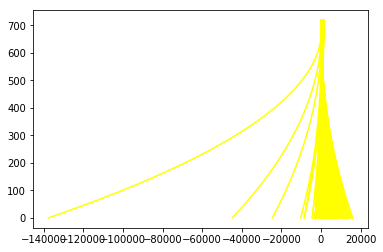

In [30]:
line = Line()
challenge_output = 'test_videos_output/ouput_challenge_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip2 = VideoFileClip("challenge_video.mp4")
challenge_clip = clip2.fl_image(process_image) #NOTE: this function expects color images!!
%time challenge_clip.write_videofile(challenge_output, audio=False)

In [31]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(challenge_output))


## Harder Challenge Video Video

[  5.56541037e-03  -5.17845935e+00   1.26496062e+03]
fast
(720,)
(720,)
(720,)
Center: 0.47m 
 Curvature: 1260.5841086412381
Curvature: 1260.5841086412381 
[MoviePy] >>>> Building video test_videos_output/ouput_harder_challenge_video.mp4
[MoviePy] Writing video test_videos_output/ouput_harder_challenge_video.mp4


  0%|          | 1/1200 [00:00<10:04,  1.98it/s]

[  1.59134440e-04   1.85848889e-01   5.02329480e+01]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 1292.3954197048777
Curvature: 1292.3954197048777 


  0%|          | 2/1200 [00:00<09:41,  2.06it/s]

[ -8.49807600e-04   1.19481156e+00  -1.81744607e+02]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 1172.6663599062829
Curvature: 1172.6663599062829 


  0%|          | 3/1200 [00:01<09:17,  2.15it/s]

[ -8.07971579e-04   1.17110196e+00  -1.89522874e+02]
fast
(720,)
(720,)
(720,)
Center: 0.37m 
 Curvature: 1117.3584724715645
Curvature: 1117.3584724715645 


  0%|          | 4/1200 [00:01<08:59,  2.22it/s]

[ -7.25401516e-04   1.09849421e+00  -1.79980204e+02]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 1154.712315531683
Curvature: 1154.712315531683 


  0%|          | 5/1200 [00:02<08:46,  2.27it/s]

[ -7.23252009e-04   1.11299330e+00  -1.92020908e+02]
fast
(720,)
(720,)
(720,)
Center: 0.32m 
 Curvature: 1293.363825304841
Curvature: 1293.363825304841 


  0%|          | 6/1200 [00:02<08:38,  2.30it/s]

[ -6.91757972e-04   1.09323708e+00  -1.93606269e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 1476.190579200348
Curvature: 1476.190579200348 


  1%|          | 7/1200 [00:03<08:40,  2.29it/s]

[ -6.75044172e-04   1.09020013e+00  -1.99190703e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 1663.1250695299823
Curvature: 1663.1250695299823 


  1%|          | 8/1200 [00:03<08:32,  2.33it/s]

[ -6.77451652e-04   1.10145314e+00  -2.04122676e+02]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 1680.079673344194
Curvature: 1680.079673344194 


  1%|          | 9/1200 [00:03<08:27,  2.35it/s]

[ -7.01718182e-04   1.12550678e+00  -2.06288914e+02]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 2084.1855745708276
Curvature: 2084.1855745708276 


  1%|          | 10/1200 [00:04<08:23,  2.37it/s]

[ -7.83701134e-04   1.21507346e+00  -2.27784489e+02]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 2792.1315966557795
Curvature: 2792.1315966557795 


  1%|          | 11/1200 [00:04<08:19,  2.38it/s]

[ -9.05439071e-04   1.35841835e+00  -2.69241243e+02]
fast
(720,)
(720,)
(720,)
Center: -0.33m 
 Curvature: 3824.9310466256725
Curvature: 3824.9310466256725 


  1%|          | 12/1200 [00:05<08:18,  2.39it/s]

[ -8.64895168e-04   1.32994318e+00  -2.72129710e+02]
fast
(720,)
(720,)
(720,)
Center: -0.42m 
 Curvature: 4142.985573321863
Curvature: 4142.985573321863 


  1%|          | 13/1200 [00:05<08:16,  2.39it/s]

[ -8.43668956e-04   1.32220030e+00  -2.78349030e+02]
fast
(720,)
(720,)
(720,)
Center: -0.34m 
 Curvature: 648.4767081167004
Curvature: 648.4767081167004 


  1%|          | 14/1200 [00:05<08:15,  2.39it/s]

[ -8.11671439e-04   1.31105122e+00  -2.87830875e+02]
fast
(720,)
(720,)
(720,)
Center: -0.23m 
 Curvature: 14.671996482468796
Curvature: 14.671996482468796 


  1%|▏         | 15/1200 [00:06<08:15,  2.39it/s]

[ -8.43338818e-04   1.35010279e+00  -3.01045436e+02]
fast
(720,)
(720,)
(720,)
Center: -0.23m 
 Curvature: 21.708263955743476
Curvature: 21.708263955743476 


  1%|▏         | 16/1200 [00:06<08:15,  2.39it/s]

[ -8.69104820e-04   1.38530072e+00  -3.13299984e+02]
fast
(720,)
(720,)
(720,)
Center: -0.22m 
 Curvature: 27.551340626546803
Curvature: 27.551340626546803 


  1%|▏         | 17/1200 [00:07<08:51,  2.23it/s]

[ -1.00249143e-03   1.54436491e+00  -3.61015259e+02]
fast
(720,)
(720,)
(720,)
Center: -0.17m 
 Curvature: 32.36934939631061
Curvature: 32.36934939631061 


  2%|▏         | 18/1200 [00:07<09:42,  2.03it/s]

[ -1.01755600e-03   1.55421528e+00  -3.60648966e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 47.09099102664012
Curvature: 47.09099102664012 


  2%|▏         | 19/1200 [00:08<09:43,  2.02it/s]

[ -1.01594833e-03   1.56571135e+00  -3.69188892e+02]
fast
(720,)
(720,)
(720,)
Center: -0.12m 
 Curvature: 66.08069234604227
Curvature: 66.08069234604227 


  2%|▏         | 20/1200 [00:08<09:39,  2.04it/s]

[ -1.14499351e-03   1.70987449e+00  -4.07980645e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 66.26968726737802
Curvature: 66.26968726737802 


  2%|▏         | 21/1200 [00:09<10:25,  1.88it/s]

[ -1.19591140e-03   1.77420606e+00  -4.28660064e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 70.85449954521829
Curvature: 70.85449954521829 


  2%|▏         | 22/1200 [00:10<10:07,  1.94it/s]

[ -1.24542898e-03   1.84947508e+00  -4.59993158e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 72.86570453451762
Curvature: 72.86570453451762 


  2%|▏         | 23/1200 [00:10<10:10,  1.93it/s]

[ -1.22415742e-03   1.84566108e+00  -4.70722497e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 76.12583907576717
Curvature: 76.12583907576717 


  2%|▏         | 24/1200 [00:11<10:50,  1.81it/s]

[ -1.21397018e-03   1.85492335e+00  -4.85943816e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 79.74713154217912
Curvature: 79.74713154217912 


  2%|▏         | 25/1200 [00:11<11:21,  1.72it/s]

[ -1.20558306e-03   1.85603217e+00  -4.94265868e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 89.61356342332071
Curvature: 89.61356342332071 


  2%|▏         | 26/1200 [00:12<11:37,  1.68it/s]

[ -1.31202705e-03   1.99660454e+00  -5.44402162e+02]
fast
(720,)
(720,)
(720,)
Center: -0.18m 
 Curvature: 90.9987344758548
Curvature: 90.9987344758548 


  2%|▏         | 27/1200 [00:13<11:52,  1.65it/s]

[ -1.29928761e-03   1.98966270e+00  -5.48351453e+02]
fast
(720,)
(720,)
(720,)
Center: -0.18m 
 Curvature: 97.93152720851334
Curvature: 97.93152720851334 


  2%|▏         | 28/1200 [00:13<12:06,  1.61it/s]

[ -1.29913808e-03   2.00321244e+00  -5.60179545e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 105.33059242640289
Curvature: 105.33059242640289 
[ -1.29383621e-03   2.00590490e+00  -5.66465622e+02]
fast
(720,)
(720,)
(720,)


  2%|▏         | 29/1200 [00:14<12:41,  1.54it/s]

Center: -0.15m 
 Curvature: 110.99925595035822
Curvature: 110.99925595035822 


  2%|▎         | 30/1200 [00:14<11:46,  1.66it/s]

[ -1.28479508e-03   2.00084319e+00  -5.68827537e+02]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 112.34901709702295
Curvature: 112.34901709702295 


  3%|▎         | 31/1200 [00:15<11:41,  1.67it/s]

[ -1.29274402e-03   2.01596564e+00  -5.77022437e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 119.62801097940175
Curvature: 119.62801097940175 


  3%|▎         | 32/1200 [00:16<11:25,  1.70it/s]

[ -1.29953496e-03   2.02171242e+00  -5.79957897e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 123.33790203748902
Curvature: 123.33790203748902 


  3%|▎         | 33/1200 [00:16<10:40,  1.82it/s]

[ -1.27768967e-03   2.00145951e+00  -5.77825175e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 128.63400255053276
Curvature: 128.63400255053276 


  3%|▎         | 34/1200 [00:17<10:10,  1.91it/s]

[ -1.26091254e-03   1.98924569e+00  -5.77451145e+02]
fast
(720,)
(720,)
(720,)
Center: -0.13m 
 Curvature: 139.77036647583304
Curvature: 139.77036647583304 


  3%|▎         | 35/1200 [00:17<10:46,  1.80it/s]

[ -1.35068491e-03   2.09141534e+00  -6.04544219e+02]
fast
(720,)
(720,)
(720,)
Center: -0.14m 
 Curvature: 160.95597584108583
Curvature: 160.95597584108583 


  3%|▎         | 36/1200 [00:18<10:39,  1.82it/s]

[ -1.61364889e-03   2.38645669e+00  -6.80770208e+02]
fast
(720,)
(720,)
(720,)
Center: -0.17m 
 Curvature: 167.6564586070645
Curvature: 167.6564586070645 


  3%|▎         | 37/1200 [00:18<09:54,  1.96it/s]

[ -1.73212014e-03   2.52633187e+00  -7.16502823e+02]
fast
(720,)
(720,)
(720,)
Center: -0.17m 
 Curvature: 206.9238996053209
Curvature: 206.9238996053209 


  3%|▎         | 38/1200 [00:19<09:32,  2.03it/s]

[ -2.14197985e-03   2.99447223e+00  -8.42968193e+02]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 272.3093461522608
Curvature: 272.3093461522608 


  3%|▎         | 39/1200 [00:19<10:23,  1.86it/s]

[ -2.64677866e-03   3.58575442e+00  -1.00805623e+03]
fast
(720,)
(720,)
(720,)
Center: -0.19m 
 Curvature: 316.5623453623449
Curvature: 316.5623453623449 


  3%|▎         | 40/1200 [00:20<10:32,  1.83it/s]

[ -3.08247332e-03   4.11514978e+00  -1.16269910e+03]
fast
(720,)
(720,)
(720,)
Center: -0.19m 
 Curvature: 363.19975908912056
Curvature: 363.19975908912056 


  3%|▎         | 41/1200 [00:20<10:07,  1.91it/s]

[ -3.41413351e-03   4.51859834e+00  -1.27962145e+03]
fast
(720,)
(720,)
(720,)
Center: -0.21m 
 Curvature: 420.1513778436295
Curvature: 420.1513778436295 


  4%|▎         | 42/1200 [00:21<10:48,  1.79it/s]

[ -3.72292942e-03   4.90752956e+00  -1.39668500e+03]
fast
(720,)
(720,)
(720,)
Center: -0.24m 
 Curvature: 487.9140126193032
Curvature: 487.9140126193032 


  4%|▎         | 43/1200 [00:21<10:35,  1.82it/s]

[ -4.10053952e-03   5.37938640e+00  -1.54033430e+03]
fast
(720,)
(720,)
(720,)
Center: -0.25m 
 Curvature: 500.19081131608084
Curvature: 500.19081131608084 


  4%|▎         | 44/1200 [00:22<09:56,  1.94it/s]

[ -4.09270969e-03   5.38913356e+00  -1.54935399e+03]
fast
(720,)
(720,)
(720,)
Center: -0.24m 
 Curvature: 520.7693279658338
Curvature: 520.7693279658338 


  4%|▍         | 45/1200 [00:22<10:09,  1.90it/s]

[ -4.13164899e-03   5.46273356e+00  -1.57864795e+03]
fast
(720,)
(720,)
(720,)
Center: -0.26m 
 Curvature: 550.2940181555755
Curvature: 550.2940181555755 


  4%|▍         | 46/1200 [00:23<10:05,  1.91it/s]

[ -4.22347224e-03   5.59552313e+00  -1.62454953e+03]
fast
(720,)
(720,)
(720,)
Center: -0.27m 
 Curvature: 625.821010896015
Curvature: 625.821010896015 


  4%|▍         | 47/1200 [00:23<09:29,  2.02it/s]

[ -4.54852558e-03   6.02051327e+00  -1.76129184e+03]
fast
(720,)
(720,)
(720,)
Center: -0.28m 
 Curvature: 641.9231538528476
Curvature: 641.9231538528476 


  4%|▍         | 48/1200 [00:24<09:06,  2.11it/s]

[ -4.55542456e-03   6.05003427e+00  -1.77761526e+03]
fast
(720,)
(720,)
(720,)
Center: -0.30m 
 Curvature: 701.4277957922393
Curvature: 701.4277957922393 


  4%|▍         | 49/1200 [00:24<08:56,  2.15it/s]

[ -4.80614653e-03   6.35715734e+00  -1.87136677e+03]
fast
(720,)
(720,)
(720,)
Center: -0.31m 
 Curvature: 721.1001011537523
Curvature: 721.1001011537523 


  4%|▍         | 50/1200 [00:25<08:39,  2.21it/s]

[ -4.80223995e-03   6.37811039e+00  -1.88557263e+03]
fast
(720,)
(720,)
(720,)
Center: -0.31m 
 Curvature: 740.1809682887347
Curvature: 740.1809682887347 


  4%|▍         | 51/1200 [00:25<08:27,  2.26it/s]

[ -4.78762038e-03   6.38697748e+00  -1.89608961e+03]
fast
(720,)
(720,)
(720,)
Center: -0.31m 
 Curvature: 742.1551122781262
Curvature: 742.1551122781262 


  4%|▍         | 52/1200 [00:25<08:19,  2.30it/s]

[ -4.69856646e-03   6.29893289e+00  -1.87685628e+03]
fast
(720,)
(720,)
(720,)
Center: -0.32m 
 Curvature: 766.9186005302048
Curvature: 766.9186005302048 


  4%|▍         | 53/1200 [00:26<08:13,  2.32it/s]

[ -4.69978091e-03   6.33417188e+00  -1.89704004e+03]
fast
(720,)
(720,)
(720,)
Center: -0.32m 
 Curvature: 799.8302098076738
Curvature: 799.8302098076738 


  4%|▍         | 54/1200 [00:26<08:10,  2.34it/s]

[ -4.71924804e-03   6.38607872e+00  -1.92134522e+03]
fast
(720,)
(720,)
(720,)
Center: -0.31m 
 Curvature: 840.0852360515232
Curvature: 840.0852360515232 


  5%|▍         | 55/1200 [00:27<08:05,  2.36it/s]

[ -4.74569410e-03   6.45109129e+00  -1.95099612e+03]
fast
(720,)
(720,)
(720,)
Center: -0.28m 
 Curvature: 893.7945295852669
Curvature: 893.7945295852669 


  5%|▍         | 56/1200 [00:27<08:03,  2.37it/s]

[ -4.79319924e-03   6.54221630e+00  -1.98885911e+03]
fast
(720,)
(720,)
(720,)
Center: -0.24m 
 Curvature: 976.4821189020288
Curvature: 976.4821189020288 


  5%|▍         | 57/1200 [00:28<08:02,  2.37it/s]

[ -4.92750424e-03   6.74157583e+00  -2.05925935e+03]
fast
(720,)
(720,)
(720,)
Center: -0.16m 
 Curvature: 1137.5649235286298
Curvature: 1137.5649235286298 


  5%|▍         | 58/1200 [00:28<08:02,  2.37it/s]

[ -5.21935825e-03   7.12347216e+00  -2.18224736e+03]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 1310.4730296078262
Curvature: 1310.4730296078262 


  5%|▍         | 59/1200 [00:28<08:02,  2.36it/s]

[ -5.19463263e-03   7.13890758e+00  -2.20091371e+03]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 1424.7709704576837
Curvature: 1424.7709704576837 


  5%|▌         | 60/1200 [00:29<08:04,  2.35it/s]

[ -5.08846488e-03   7.03160190e+00  -2.17663926e+03]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 1552.0420737738818
Curvature: 1552.0420737738818 


  5%|▌         | 61/1200 [00:29<08:04,  2.35it/s]

[ -5.10650046e-03   7.08705885e+00  -2.20371984e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 1628.860888546721
Curvature: 1628.860888546721 


  5%|▌         | 62/1200 [00:30<08:49,  2.15it/s]

[ -5.15090064e-03   7.16663383e+00  -2.23563454e+03]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 1531.2674005560311
Curvature: 1531.2674005560311 


  5%|▌         | 63/1200 [00:30<08:46,  2.16it/s]

[ -5.27210005e-03   7.34959612e+00  -2.30144202e+03]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 1531.2379552716973
Curvature: 1531.2379552716973 


  5%|▌         | 64/1200 [00:31<08:41,  2.18it/s]

[ -5.32685383e-03   7.45372516e+00  -2.34414067e+03]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 1694.1428995709648
Curvature: 1694.1428995709648 


  5%|▌         | 65/1200 [00:31<08:51,  2.13it/s]

[ -5.51462521e-03   7.72611357e+00  -2.43931779e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 960.7126503645308
Curvature: 960.7126503645308 


  6%|▌         | 66/1200 [00:32<08:48,  2.15it/s]

[ -5.73854275e-03   8.04753036e+00  -2.55077162e+03]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 986.5697736480595
Curvature: 986.5697736480595 


  6%|▌         | 67/1200 [00:32<08:34,  2.20it/s]

[ -5.79060537e-03   8.15738311e+00  -2.59928803e+03]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 1044.7721851557467
Curvature: 1044.7721851557467 


  6%|▌         | 68/1200 [00:33<08:33,  2.20it/s]

[ -5.93252336e-03   8.37386160e+00  -2.67819907e+03]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 1065.3508311301198
Curvature: 1065.3508311301198 


  6%|▌         | 69/1200 [00:33<08:37,  2.19it/s]

[ -5.94343329e-03   8.42718745e+00  -2.70774104e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 1123.5327741906858
Curvature: 1123.5327741906858 


  6%|▌         | 70/1200 [00:33<08:25,  2.23it/s]

[ -6.07119502e-03   8.62527825e+00  -2.78191052e+03]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 1216.4808240800849
Curvature: 1216.4808240800849 


  6%|▌         | 71/1200 [00:34<08:16,  2.27it/s]

[ -6.33754844e-03   8.97481929e+00  -2.89684433e+03]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 1241.347646671055
Curvature: 1241.347646671055 


  6%|▌         | 72/1200 [00:34<08:09,  2.30it/s]

[ -6.38609157e-03   9.05275391e+00  -2.92848776e+03]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 1137.6557432589439
Curvature: 1137.6557432589439 


  6%|▌         | 73/1200 [00:35<08:03,  2.33it/s]

[ -5.98474932e-03   8.59913989e+00  -2.80371083e+03]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 976.3409437353163
Curvature: 976.3409437353163 


  6%|▌         | 74/1200 [00:35<08:00,  2.34it/s]

[ -5.32611113e-03   7.85379461e+00  -2.59744170e+03]
fast
(720,)
(720,)
(720,)
Center: 0.15m 
 Curvature: 884.3847694688914
Curvature: 884.3847694688914 


  6%|▋         | 75/1200 [00:36<08:25,  2.22it/s]

[ -4.90277066e-03   7.38509930e+00  -2.47179361e+03]
fast
(720,)
(720,)
(720,)
Center: 0.17m 
 Curvature: 885.0634705323258
Curvature: 885.0634705323258 


  6%|▋         | 76/1200 [00:36<08:52,  2.11it/s]

[ -4.85495760e-03   7.35210927e+00  -2.47202706e+03]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 878.5414512187454
Curvature: 878.5414512187454 


  6%|▋         | 77/1200 [00:37<09:00,  2.08it/s]

[ -4.78234674e-03   7.28129411e+00  -2.45932971e+03]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 885.7753098617536
Curvature: 885.7753098617536 


  6%|▋         | 78/1200 [00:37<09:11,  2.04it/s]

[ -4.76183448e-03   7.27828084e+00  -2.46781888e+03]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 785.9763504009727
Curvature: 785.9763504009727 


  7%|▋         | 79/1200 [00:38<08:46,  2.13it/s]

[ -4.27299654e-03   6.73395629e+00  -2.32119812e+03]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 818.6511896765793
Curvature: 818.6511896765793 


  7%|▋         | 80/1200 [00:38<08:30,  2.19it/s]

[ -4.36845986e-03   6.86078613e+00  -2.36572278e+03]
fast
(720,)
(720,)
(720,)
Center: 0.20m 
 Curvature: 873.0118847776852
Curvature: 873.0118847776852 


  7%|▋         | 81/1200 [00:39<09:02,  2.06it/s]

[ -4.51902328e-03   7.06917026e+00  -2.43832792e+03]
fast
(720,)
(720,)
(720,)
Center: 0.21m 
 Curvature: 824.2685025853822
Curvature: 824.2685025853822 


  7%|▋         | 82/1200 [00:39<09:52,  1.89it/s]

[ -4.27215799e-03   6.78333224e+00  -2.35902960e+03]
fast
(720,)
(720,)
(720,)
Center: 0.23m 
 Curvature: 766.6243350841448
Curvature: 766.6243350841448 


  7%|▋         | 83/1200 [00:40<10:28,  1.78it/s]

[ -3.99127668e-03   6.45102707e+00  -2.26329962e+03]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 709.9531257504649
Curvature: 709.9531257504649 


  7%|▋         | 84/1200 [00:40<09:42,  1.92it/s]

[ -3.69019210e-03   6.09073390e+00  -2.15801372e+03]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 656.0341392961675
Curvature: 656.0341392961675 


  7%|▋         | 85/1200 [00:41<09:06,  2.04it/s]

[ -3.35419623e-03   5.68421069e+00  -2.03745926e+03]
fast
(720,)
(720,)
(720,)
Center: 0.27m 
 Curvature: 614.8453585731162
Curvature: 614.8453585731162 


  7%|▋         | 86/1200 [00:41<08:42,  2.13it/s]

[ -3.09427375e-03   5.37087888e+00  -1.94615977e+03]
fast
(720,)
(720,)
(720,)
Center: 0.26m 
 Curvature: 628.6540374019423
Curvature: 628.6540374019423 


  7%|▋         | 87/1200 [00:42<08:24,  2.20it/s]

[ -3.08815917e-03   5.37865895e+00  -1.95385435e+03]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 466.01974658229375
Curvature: 466.01974658229375 


  7%|▋         | 88/1200 [00:42<09:26,  1.96it/s]

[ -2.15617529e-03   4.22391776e+00  -1.60260703e+03]
fast
(720,)
(720,)
(720,)
Center: 0.22m 
 Curvature: 540.6338913370939
Curvature: 540.6338913370939 


  7%|▋         | 89/1200 [00:43<10:06,  1.83it/s]

[ -2.48913408e-03   4.64571242e+00  -1.73451423e+03]
fast
(720,)
(720,)
(720,)
Center: 0.19m 
 Curvature: 514.1678260888493
Curvature: 514.1678260888493 


  8%|▊         | 90/1200 [00:43<10:07,  1.83it/s]

[ -2.35965928e-03   4.43038855e+00  -1.64685885e+03]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 527.5286698348191
Curvature: 527.5286698348191 


  8%|▊         | 91/1200 [00:44<10:12,  1.81it/s]

[ -2.33198871e-03   4.39076421e+00  -1.63339480e+03]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 385.2113603882442
Curvature: 385.2113603882442 


  8%|▊         | 92/1200 [00:44<10:19,  1.79it/s]

[ -1.41686054e-03   3.18362746e+00  -1.23744360e+03]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 407.0779546968556
Curvature: 407.0779546968556 


  8%|▊         | 93/1200 [00:45<09:57,  1.85it/s]

[ -1.37485027e-03   3.12138060e+00  -1.21609455e+03]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 480.15195069879815
Curvature: 480.15195069879815 


  8%|▊         | 94/1200 [00:45<09:27,  1.95it/s]

[ -1.58280871e-03   3.38807529e+00  -1.30371688e+03]
fast
(720,)
(720,)
(720,)
Center: 0.12m 
 Curvature: 341.9468059955327
Curvature: 341.9468059955327 


  8%|▊         | 95/1200 [00:46<08:54,  2.07it/s]

[  1.64613069e-04   1.10335911e+00  -5.62683297e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 345.6529481932629
Curvature: 345.6529481932629 


  8%|▊         | 96/1200 [00:46<08:35,  2.14it/s]

[  1.22169844e-03  -1.61127867e-01  -1.95639356e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 411.2307346170288
Curvature: 411.2307346170288 


  8%|▊         | 97/1200 [00:47<08:38,  2.13it/s]

[  1.10829141e-03   7.74309758e-02  -3.07169983e+02]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 458.0718187328065
Curvature: 458.0718187328065 


  8%|▊         | 98/1200 [00:47<08:48,  2.08it/s]

[  1.32665184e-03  -2.05588569e-01  -2.18204352e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 532.3121587940439
Curvature: 532.3121587940439 


  8%|▊         | 99/1200 [00:48<08:44,  2.10it/s]

[  1.51136890e-04   1.27093716e+00  -6.80361298e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 839.7987327163371
Curvature: 839.7987327163371 


  8%|▊         | 100/1200 [00:48<08:26,  2.17it/s]

[ -1.77548847e-03   3.70629867e+00  -1.44651298e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 891.1060989104827
Curvature: 891.1060989104827 


  8%|▊         | 101/1200 [00:49<08:10,  2.24it/s]

[ -1.69059769e-03   3.58427174e+00  -1.40454342e+03]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 982.2177380955363
Curvature: 982.2177380955363 


  8%|▊         | 102/1200 [00:49<08:00,  2.29it/s]

[ -1.33705444e-03   3.13282438e+00  -1.26157453e+03]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 1209.3014629000374
Curvature: 1209.3014629000374 


  9%|▊         | 103/1200 [00:49<07:52,  2.32it/s]

[ -1.60035729e-03   3.46420104e+00  -1.36599535e+03]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 1395.3577919812947
Curvature: 1395.3577919812947 


  9%|▊         | 104/1200 [00:50<07:50,  2.33it/s]

[ -1.96533118e-03   3.90639173e+00  -1.49955498e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 1582.499688167213
Curvature: 1582.499688167213 


  9%|▉         | 105/1200 [00:50<08:00,  2.28it/s]

[ -2.02033332e-03   3.97357644e+00  -1.51992815e+03]
fast
(720,)
(720,)
(720,)
Center: -0.06m 
 Curvature: 1948.0785476882766
Curvature: 1948.0785476882766 


  9%|▉         | 106/1200 [00:51<08:08,  2.24it/s]

[ -2.11564560e-03   4.07975900e+00  -1.54937801e+03]
fast
(720,)
(720,)
(720,)
Center: -0.07m 
 Curvature: 2374.576096080686
Curvature: 2374.576096080686 


  9%|▉         | 107/1200 [00:51<07:59,  2.28it/s]

[ -2.29416788e-03   4.29322206e+00  -1.61262477e+03]
fast
(720,)
(720,)
(720,)
Center: -0.09m 
 Curvature: 3002.6234834570005
Curvature: 3002.6234834570005 


  9%|▉         | 108/1200 [00:52<08:08,  2.23it/s]

[ -2.33689780e-03   4.34684042e+00  -1.62921628e+03]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 5185.775100218741
Curvature: 5185.775100218741 


  9%|▉         | 109/1200 [00:52<08:34,  2.12it/s]

[ -2.00034406e-03   3.90430625e+00  -1.48399284e+03]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 9080.449601745377
Curvature: 9080.449601745377 


  9%|▉         | 110/1200 [00:53<08:38,  2.10it/s]

[ -1.05842853e-03   2.67556535e+00  -1.08442681e+03]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 17541.46590737915
Curvature: 17541.46590737915 


  9%|▉         | 111/1200 [00:53<08:34,  2.12it/s]

[ -3.78041229e-04   1.77643093e+00  -7.87176077e+02]
fast
(720,)
(720,)
(720,)
Center: 0.10m 
 Curvature: 28167.561729759767
Curvature: 28167.561729759767 


  9%|▉         | 112/1200 [00:54<08:37,  2.10it/s]

[ -1.34043670e-04   1.43754075e+00  -6.70053097e+02]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 35744.28114468462
Curvature: 35744.28114468462 


  9%|▉         | 113/1200 [00:54<08:20,  2.17it/s]

[ -1.26417006e-04   1.39315446e+00  -6.42884539e+02]
fast
(720,)
(720,)
(720,)
Center: 0.11m 
 Curvature: 51685.40123254317
Curvature: 51685.40123254317 


 10%|▉         | 114/1200 [00:54<08:08,  2.22it/s]

[ -7.03866741e-05   1.31293685e+00  -6.13058873e+02]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 3692.493831721876
Curvature: 3692.493831721876 


 10%|▉         | 115/1200 [00:55<08:04,  2.24it/s]

[  6.99950830e-04   3.04927460e-01  -2.82821583e+02]
fast
(720,)
(720,)
(720,)
Center: -0.02m 
 Curvature: 14.34982291833752
Curvature: 14.34982291833752 


 10%|▉         | 116/1200 [00:55<07:59,  2.26it/s]

[  9.52718752e-04  -5.66084722e-02  -1.52990567e+02]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 4.40731906652964
Curvature: 4.40731906652964 


 10%|▉         | 117/1200 [00:56<07:53,  2.29it/s]

[  1.08415695e-03  -2.65054013e-01  -7.01013012e+01]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 2.362908910409418
Curvature: 2.362908910409418 


 10%|▉         | 118/1200 [00:56<07:51,  2.29it/s]

[  1.53966049e-03  -8.40497288e-01   1.11347937e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 3.3328075673234583
Curvature: 3.3328075673234583 


 10%|▉         | 119/1200 [00:57<07:47,  2.31it/s]

[  1.59076122e-03  -9.33529504e-01   1.51233000e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 1.2375869578088048
Curvature: 1.2375869578088048 


 10%|█         | 120/1200 [00:57<09:04,  1.98it/s]

[  9.57771179e-04  -2.55867401e-01  -1.58853382e+01]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 13.578584962220383
Curvature: 13.578584962220383 


 10%|█         | 121/1200 [00:58<08:47,  2.05it/s]

[  1.62389327e-03  -1.10520267e+00   2.55043379e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 28.391467778967396
Curvature: 28.391467778967396 


 10%|█         | 122/1200 [00:58<09:11,  1.96it/s]

[  1.92853618e-03  -1.54115370e+00   4.13290163e+02]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 34.862979121518514
Curvature: 34.862979121518514 


 10%|█         | 123/1200 [00:59<09:30,  1.89it/s]

[  1.85838045e-03  -1.55096223e+00   4.55768588e+02]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 52.89218674769498
Curvature: 52.89218674769498 


 10%|█         | 124/1200 [00:59<09:12,  1.95it/s]

[  2.01656637e-03  -1.83706672e+00   5.79884323e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 82.47771370646208
Curvature: 82.47771370646208 


 10%|█         | 125/1200 [01:00<08:52,  2.02it/s]

[  2.13890404e-03  -2.06964306e+00   6.84111963e+02]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 119.49900568684978
Curvature: 119.49900568684978 


 10%|█         | 126/1200 [01:00<08:45,  2.04it/s]

[  2.12725718e-03  -2.13027953e+00   7.35784040e+02]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 201.7632383799227
Curvature: 201.7632383799227 


 11%|█         | 127/1200 [01:01<08:24,  2.13it/s]

[  2.43556270e-03  -2.55989664e+00   8.89389002e+02]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 298.99722504721956
Curvature: 298.99722504721956 


 11%|█         | 128/1200 [01:01<08:06,  2.20it/s]

[  2.60605199e-03  -2.83672128e+00   1.00235737e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 407.61644075414824
Curvature: 407.61644075414824 


 11%|█         | 129/1200 [01:02<07:54,  2.26it/s]

[  2.99185243e-03  -3.33123864e+00   1.16524161e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 506.0929182903079
Curvature: 506.0929182903079 


 11%|█         | 130/1200 [01:02<07:58,  2.24it/s]

[  3.12831736e-03  -3.55331314e+00   1.25613747e+03]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 555.9742713701993
Curvature: 555.9742713701993 


 11%|█         | 131/1200 [01:02<08:04,  2.21it/s]

[  3.08375083e-03  -3.55509586e+00   1.28118351e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 721.6688677811045
Curvature: 721.6688677811045 


 11%|█         | 132/1200 [01:03<07:54,  2.25it/s]

[  3.53893925e-03  -4.18542350e+00   1.50380390e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 726.5662379223941
Curvature: 726.5662379223941 


 11%|█         | 133/1200 [01:03<07:59,  2.23it/s]

[  3.00896212e-03  -3.63608371e+00   1.37296515e+03]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 838.8962458956818
Curvature: 838.8962458956818 


 11%|█         | 134/1200 [01:04<08:25,  2.11it/s]

[  3.15346515e-03  -3.88087113e+00   1.47453511e+03]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 1232.630244908543
Curvature: 1232.630244908543 


 11%|█▏        | 135/1200 [01:04<08:26,  2.10it/s]

[  3.71652083e-03  -4.69192059e+00   1.76605029e+03]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 1343.351069302986
Curvature: 1343.351069302986 


 11%|█▏        | 136/1200 [01:05<08:28,  2.09it/s]

[  3.64569393e-03  -4.65201267e+00   1.77365402e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 1809.828924948954
Curvature: 1809.828924948954 


 11%|█▏        | 137/1200 [01:05<09:05,  1.95it/s]

[  4.29597666e-03  -5.49849412e+00   2.05157482e+03]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 3761.7605561724813
Curvature: 3761.7605561724813 


 12%|█▏        | 138/1200 [01:06<09:29,  1.87it/s]

[  4.64996916e-03  -6.00803423e+00   2.23381787e+03]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 3985.647946294798
Curvature: 3985.647946294798 


 12%|█▏        | 139/1200 [01:07<09:48,  1.80it/s]

[  5.05669077e-03  -6.59045418e+00   2.44151253e+03]
fast
(720,)
(720,)
(720,)
Center: 0.07m 
 Curvature: 4309.130094137432
Curvature: 4309.130094137432 


 12%|█▏        | 140/1200 [01:07<09:56,  1.78it/s]

[  5.35124616e-03  -7.04128596e+00   2.61228058e+03]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 4401.834477841336
Curvature: 4401.834477841336 


 12%|█▏        | 141/1200 [01:08<10:03,  1.76it/s]

[  5.18028503e-03  -6.90884631e+00   2.59987046e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 4364.090373801947
Curvature: 4364.090373801947 


 12%|█▏        | 142/1200 [01:08<10:05,  1.75it/s]

[  4.90317860e-03  -6.62482411e+00   2.53456350e+03]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 4468.473682218585
Curvature: 4468.473682218585 


 12%|█▏        | 143/1200 [01:09<10:06,  1.74it/s]

[  5.18732932e-03  -7.05924000e+00   2.69839165e+03]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 4474.634832902901
Curvature: 4474.634832902901 


 12%|█▏        | 144/1200 [01:10<10:14,  1.72it/s]

[  4.67892988e-03  -6.47908529e+00   2.53886220e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 4405.712731460866
Curvature: 4405.712731460866 


 12%|█▏        | 145/1200 [01:10<10:34,  1.66it/s]

[  4.56484969e-03  -6.39791446e+00   2.53575295e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 4529.535127567249
Curvature: 4529.535127567249 


 12%|█▏        | 146/1200 [01:11<11:10,  1.57it/s]

[  4.46713119e-03  -6.33350418e+00   2.53622630e+03]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 4694.3981665302135
Curvature: 4694.3981665302135 


 12%|█▏        | 147/1200 [01:11<10:47,  1.63it/s]

[  4.53389284e-03  -6.47254117e+00   2.59751806e+03]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 4538.021579265146
Curvature: 4538.021579265146 


 12%|█▏        | 148/1200 [01:12<10:47,  1.62it/s]

[  4.61714790e-03  -6.62878315e+00   2.66337563e+03]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 4334.3811944334575
Curvature: 4334.3811944334575 


 12%|█▏        | 149/1200 [01:13<10:44,  1.63it/s]

[  4.62887022e-03  -6.69206204e+00   2.69921144e+03]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 4805.643185654145
Curvature: 4805.643185654145 


 12%|█▎        | 150/1200 [01:13<10:27,  1.67it/s]

[  4.83605759e-03  -7.00423034e+00   2.81400293e+03]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 6478.677202433135
Curvature: 6478.677202433135 


 13%|█▎        | 151/1200 [01:14<10:15,  1.70it/s]

[  4.26808275e-03  -6.35968039e+00   2.63708072e+03]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 7192.005986695415
Curvature: 7192.005986695415 


 13%|█▎        | 152/1200 [01:14<10:08,  1.72it/s]

[  4.08574149e-03  -6.20721868e+00   2.61592521e+03]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 9751.299996075075
Curvature: 9751.299996075075 


 13%|█▎        | 153/1200 [01:15<10:03,  1.74it/s]

[  4.18348828e-03  -6.37493146e+00   2.68411712e+03]
fast
(720,)
(720,)
(720,)
Center: -0.01m 
 Curvature: 5138.504836835983
Curvature: 5138.504836835983 


 13%|█▎        | 154/1200 [01:16<10:02,  1.74it/s]

[  3.78345046e-03  -5.95133223e+00   2.58001615e+03]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 2283.220437245917
Curvature: 2283.220437245917 


 13%|█▎        | 155/1200 [01:16<10:05,  1.73it/s]

[  3.26030911e-03  -5.33472594e+00   2.40263592e+03]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 798.0949472237938
Curvature: 798.0949472237938 


 13%|█▎        | 156/1200 [01:17<09:58,  1.75it/s]

[  2.92486722e-03  -4.97305457e+00   2.31157347e+03]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 1123.8820841268596
Curvature: 1123.8820841268596 


 13%|█▎        | 157/1200 [01:17<10:09,  1.71it/s]

[  3.63785520e-03  -5.91732385e+00   2.62409580e+03]
fast
(720,)
(720,)
(720,)
Center: -0.03m 
 Curvature: 1769.427624442281
Curvature: 1769.427624442281 


 13%|█▎        | 158/1200 [01:18<10:14,  1.70it/s]

[  3.59069317e-03  -5.89312176e+00   2.63194286e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 9249.750619420427
Curvature: 9249.750619420427 


 13%|█▎        | 159/1200 [01:18<10:03,  1.72it/s]

[  4.06532619e-03  -6.56593775e+00   2.87133220e+03]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 5807.098755302068
Curvature: 5807.098755302068 


 13%|█▎        | 160/1200 [01:19<10:14,  1.69it/s]

[  4.33460188e-03  -6.98294657e+00   3.03279350e+03]
fast
(720,)
(720,)
(720,)
Center: 0.00m 
 Curvature: 3267.675366905516
Curvature: 3267.675366905516 


 13%|█▎        | 161/1200 [01:20<09:58,  1.74it/s]

[  3.88370183e-03  -6.49672962e+00   2.91268696e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 8728.23318100065
Curvature: 8728.23318100065 


 14%|█▎        | 162/1200 [01:20<09:59,  1.73it/s]

[  4.55231516e-03  -7.38844369e+00   3.21091207e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 10469.090695108125
Curvature: 10469.090695108125 


 14%|█▎        | 163/1200 [01:21<10:04,  1.72it/s]

[  4.13430502e-03  -6.93822932e+00   3.09898384e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 11509.581134978851
Curvature: 11509.581134978851 


 14%|█▎        | 164/1200 [01:21<10:21,  1.67it/s]

[  3.95290225e-03  -6.74207442e+00   3.04941315e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 12366.337378281882
Curvature: 12366.337378281882 


 14%|█▍        | 165/1200 [01:22<10:37,  1.62it/s]

[  4.49098242e-03  -7.45273151e+00   3.28326071e+03]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 12390.802525150508
Curvature: 12390.802525150508 


 14%|█▍        | 166/1200 [01:23<10:36,  1.62it/s]

[  3.92169460e-03  -6.70332772e+00   3.03596719e+03]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 14824.36494007176
Curvature: 14824.36494007176 


 14%|█▍        | 167/1200 [01:23<10:29,  1.64it/s]

[  3.17896469e-03  -5.75553722e+00   2.73420193e+03]
fast
(720,)
(720,)
(720,)
Center: 0.01m 
 Curvature: 16685.384127981735
Curvature: 16685.384127981735 


 14%|█▍        | 168/1200 [01:24<10:20,  1.66it/s]

[  3.25695903e-03  -5.83620784e+00   2.75283940e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 10737.921110198946
Curvature: 10737.921110198946 


 14%|█▍        | 169/1200 [01:24<10:22,  1.66it/s]

[  3.57012688e-03  -6.24650183e+00   2.88475505e+03]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 12012.852778709366
Curvature: 12012.852778709366 


 14%|█▍        | 170/1200 [01:25<10:13,  1.68it/s]

[  3.36384599e-03  -5.95813594e+00   2.78396532e+03]
fast
(720,)
(720,)
(720,)
Center: 0.02m 
 Curvature: 11111.75543226329
Curvature: 11111.75543226329 


 14%|█▍        | 171/1200 [01:26<10:00,  1.71it/s]

[  2.75538480e-03  -5.16950983e+00   2.52937452e+03]
fast
(720,)
(720,)
(720,)
Center: 0.03m 
 Curvature: 12023.900754812845
Curvature: 12023.900754812845 


 14%|█▍        | 172/1200 [01:26<10:04,  1.70it/s]

[  2.80633973e-03  -5.24745210e+00   2.56090801e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 13456.941991407055
Curvature: 13456.941991407055 


 14%|█▍        | 173/1200 [01:27<10:18,  1.66it/s]

[  2.72467442e-03  -5.11903431e+00   2.51564098e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 12123.377048090235
Curvature: 12123.377048090235 


 14%|█▍        | 174/1200 [01:27<10:20,  1.65it/s]

[  3.19539725e-03  -5.79868590e+00   2.76311748e+03]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 22219.102778531997
Curvature: 22219.102778531997 


 15%|█▍        | 175/1200 [01:28<10:13,  1.67it/s]

[  3.15660455e-03  -5.73052294e+00   2.73851727e+03]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 17960.935761724664
Curvature: 17960.935761724664 


 15%|█▍        | 176/1200 [01:29<09:58,  1.71it/s]

[  4.17877002e-03  -7.10391811e+00   3.20272138e+03]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 15689.95927572813
Curvature: 15689.95927572813 


 15%|█▍        | 177/1200 [01:29<10:03,  1.69it/s]

[  3.34838066e-03  -5.97585159e+00   2.82270816e+03]
fast
(720,)
(720,)
(720,)
Center: 0.04m 
 Curvature: 13638.441671904659
Curvature: 13638.441671904659 


 15%|█▍        | 178/1200 [01:30<10:07,  1.68it/s]

[  2.95902635e-03  -5.45683949e+00   2.65143265e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 12796.115455155565
Curvature: 12796.115455155565 


 15%|█▍        | 179/1200 [01:30<10:07,  1.68it/s]

[  2.34452360e-03  -4.62175118e+00   2.37119482e+03]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 11106.115029252385
Curvature: 11106.115029252385 


 15%|█▌        | 180/1200 [01:31<10:08,  1.68it/s]

[  4.14523759e-03  -7.08195287e+00   3.21185798e+03]
fast
(720,)
(720,)
(720,)
Center: 0.06m 
 Curvature: 12358.076807341837
Curvature: 12358.076807341837 


 15%|█▌        | 181/1200 [01:32<10:08,  1.68it/s]

[  1.34539324e-03  -3.27279640e+00   1.91839664e+03]
fast
(720,)
(720,)
(720,)
Center: 0.08m 
 Curvature: 14516.497684219326
Curvature: 14516.497684219326 


 15%|█▌        | 182/1200 [01:32<09:55,  1.71it/s]

[  2.61677753e-03  -4.93904320e+00   2.46335955e+03]
fast
(720,)
(720,)
(720,)
Center: 0.13m 
 Curvature: 1926.1831954891582
Curvature: 1926.1831954891582 


 15%|█▌        | 183/1200 [01:33<09:47,  1.73it/s]

[  2.41279903e-03  -4.59559628e+00   2.32435738e+03]
fast
(720,)
(720,)
(720,)
Center: 0.18m 
 Curvature: 162839.95580994053
Curvature: 162839.95580994053 


 15%|█▌        | 184/1200 [01:33<09:41,  1.75it/s]

[  1.03269539e-03  -2.83410423e+00   1.76366918e+03]
fast
(720,)
(720,)
(720,)
Center: 0.34m 
 Curvature: 1561710.3479017487
Curvature: 1561710.3479017487 


 15%|█▌        | 185/1200 [01:34<09:31,  1.78it/s]

[ -1.61937049e-03   5.99821112e-01   6.62923504e+02]
fast
(720,)
(720,)
(720,)
Center: 0.40m 
 Curvature: 1078754.600843324
Curvature: 1078754.600843324 


 16%|█▌        | 186/1200 [01:34<09:34,  1.76it/s]

[ -1.74625165e-03   7.58688419e-01   6.16634840e+02]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 184021.5304687478
Curvature: 184021.5304687478 


 16%|█▌        | 187/1200 [01:35<09:37,  1.75it/s]

[  5.80855234e-04  -2.22340423e+00   1.56600679e+03]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 68267.43053230367
Curvature: 68267.43053230367 


 16%|█▌        | 188/1200 [01:36<09:59,  1.69it/s]

[  2.26170191e-03  -4.31613892e+00   2.21254635e+03]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 31172.261293547483
Curvature: 31172.261293547483 


 16%|█▌        | 189/1200 [01:36<10:23,  1.62it/s]

[  2.91277585e-03  -5.19115641e+00   2.50387603e+03]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 1282.4707887778186
Curvature: 1282.4707887778186 


 16%|█▌        | 190/1200 [01:37<10:19,  1.63it/s]

[  3.02994065e-03  -5.32973528e+00   2.54612062e+03]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 1422.2912849654674
Curvature: 1422.2912849654674 


 16%|█▌        | 191/1200 [01:37<10:14,  1.64it/s]

[  3.03242498e-03  -5.33206433e+00   2.54766381e+03]
fast
(720,)
(720,)
(720,)
Center: 0.43m 
 Curvature: 1834.284219358734
Curvature: 1834.284219358734 


 16%|█▌        | 192/1200 [01:38<10:01,  1.68it/s]

[  2.81726664e-03  -5.09234366e+00   2.47939165e+03]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 1766.0254193536225
Curvature: 1766.0254193536225 


 16%|█▌        | 193/1200 [01:39<09:52,  1.70it/s]

[  2.47014583e-03  -4.70686813e+00   2.37490747e+03]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 1349.361191119941
Curvature: 1349.361191119941 


 16%|█▌        | 194/1200 [01:39<09:49,  1.71it/s]

[  2.30278890e-03  -4.51848744e+00   2.32313578e+03]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 931.168003362465
Curvature: 931.168003362465 


 16%|█▋        | 195/1200 [01:40<09:49,  1.70it/s]

[  2.22493547e-03  -4.42203193e+00   2.29398662e+03]
fast
(720,)
(720,)
(720,)
Center: 0.56m 
 Curvature: 645.8055372035974
Curvature: 645.8055372035974 


 16%|█▋        | 196/1200 [01:40<10:06,  1.66it/s]

[  1.75889646e-03  -3.83220611e+00   2.10725640e+03]
fast
(720,)
(720,)
(720,)
Center: 0.54m 
 Curvature: 518.0573159284531
Curvature: 518.0573159284531 


 16%|█▋        | 197/1200 [01:41<10:19,  1.62it/s]

[  1.27114738e-03  -3.17847966e+00   1.88790728e+03]
fast
(720,)
(720,)
(720,)
Center: 0.53m 
 Curvature: 360.8816501766598
Curvature: 360.8816501766598 


 16%|█▋        | 198/1200 [01:42<10:17,  1.62it/s]

[  3.44440908e-04  -2.02175692e+00   1.52428998e+03]
fast
(720,)
(720,)
(720,)
Center: 0.51m 
 Curvature: 243.6222079124213
Curvature: 243.6222079124213 


 17%|█▋        | 199/1200 [01:42<10:12,  1.64it/s]

[ -2.83280370e-04  -1.13423305e+00   1.21889217e+03]
fast
(720,)
(720,)
(720,)
Center: 0.38m 
 Curvature: 286.1596812723517
Curvature: 286.1596812723517 


 17%|█▋        | 200/1200 [01:43<10:09,  1.64it/s]

[ -8.55055231e-04  -4.03833004e-01   9.84421550e+02]
fast
(720,)
(720,)
(720,)
Center: 0.29m 
 Curvature: 91.6855481380089
Curvature: 91.6855481380089 


 17%|█▋        | 201/1200 [01:43<10:10,  1.64it/s]

[ -1.56821356e-03   4.23887874e-01   7.40433879e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 1984.8557607185176
Curvature: 1984.8557607185176 


 17%|█▋        | 202/1200 [01:44<10:28,  1.59it/s]

[ -2.03106611e-03   1.04214170e+00   5.33737386e+02]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 1655.4601147173155
Curvature: 1655.4601147173155 


 17%|█▋        | 203/1200 [01:45<10:24,  1.60it/s]

[ -2.24724751e-03   1.42048042e+00   3.78914657e+02]
fast
(720,)
(720,)
(720,)
Center: 0.35m 
 Curvature: 1293.5865250903728
Curvature: 1293.5865250903728 


 17%|█▋        | 204/1200 [01:45<10:29,  1.58it/s]

[ -2.07437041e-03   1.38738515e+00   3.26054768e+02]
fast
(720,)
(720,)
(720,)
Center: 0.45m 
 Curvature: 1323.818295957965
Curvature: 1323.818295957965 


 17%|█▋        | 205/1200 [01:46<10:15,  1.62it/s]

[ -1.92566444e-03   1.36883419e+00   2.73828560e+02]
fast
(720,)
(720,)
(720,)
Center: 0.50m 
 Curvature: 1071.2920240534909
Curvature: 1071.2920240534909 


 17%|█▋        | 206/1200 [01:47<10:15,  1.61it/s]

[ -1.66172206e-03   1.21091582e+00   2.59482218e+02]
fast
(720,)
(720,)
(720,)
Center: 0.53m 
 Curvature: 1070.239858814827
Curvature: 1070.239858814827 


 17%|█▋        | 207/1200 [01:47<10:15,  1.61it/s]

[ -1.09368000e-03   6.73049513e-01   3.61641054e+02]
fast
(720,)
(720,)
(720,)
Center: 0.59m 
 Curvature: 1161.8690686599573
Curvature: 1161.8690686599573 


 17%|█▋        | 208/1200 [01:48<10:10,  1.63it/s]

[ -1.19015631e-03   8.91252340e-01   2.52555498e+02]
fast
(720,)
(720,)
(720,)
Center: 0.54m 
 Curvature: 1239.209359936102
Curvature: 1239.209359936102 


 17%|█▋        | 209/1200 [01:48<10:01,  1.65it/s]

[ -4.23961767e-03   4.48147033e+00  -7.90937957e+02]
fast
(720,)
(720,)
(720,)
Center: 0.55m 
 Curvature: 1403.3408067287826
Curvature: 1403.3408067287826 


 18%|█▊        | 210/1200 [01:49<09:57,  1.66it/s]

[ -4.73917633e-03   5.21220448e+00  -1.05955915e+03]
fast
(720,)
(720,)
(720,)
Center: 0.60m 
 Curvature: 1637.429304911948
Curvature: 1637.429304911948 


 18%|█▊        | 211/1200 [01:50<09:49,  1.68it/s]

[ -4.33418829e-03   4.90864450e+00  -1.04077109e+03]
fast
(720,)
(720,)
(720,)
Center: 0.61m 
 Curvature: 2114.9705425834495
Curvature: 2114.9705425834495 


 18%|█▊        | 212/1200 [01:50<09:51,  1.67it/s]

[ -5.90753891e-03   6.90170199e+00  -1.67040237e+03]
fast
(720,)
(720,)
(720,)
Center: 0.61m 
 Curvature: 2796.5403046339434
Curvature: 2796.5403046339434 


 18%|█▊        | 213/1200 [01:51<09:50,  1.67it/s]

[ -7.25520533e-03   8.66767011e+00  -2.24983209e+03]
fast
(720,)
(720,)
(720,)
Center: 0.59m 
 Curvature: 3280.781646491419
Curvature: 3280.781646491419 


 18%|█▊        | 214/1200 [01:51<09:41,  1.70it/s]

[ -8.59331559e-03   1.04138455e+01  -2.82238652e+03]
fast
(720,)
(720,)
(720,)
Center: 0.58m 
 Curvature: 3834.850688816824
Curvature: 3834.850688816824 


 18%|█▊        | 215/1200 [01:52<09:38,  1.70it/s]

[ -9.65077273e-03   1.18014300e+01  -3.28307120e+03]
fast
(720,)
(720,)
(720,)
Center: 0.57m 
 Curvature: 3635.484293934099
Curvature: 3635.484293934099 


 18%|█▊        | 216/1200 [01:53<09:46,  1.68it/s]

[ -9.56758095e-03   1.18394413e+01  -3.35000036e+03]
fast
(720,)
(720,)
(720,)
Center: 0.57m 
 Curvature: 3567.1579502964437
Curvature: 3567.1579502964437 


 18%|█▊        | 217/1200 [01:53<09:46,  1.68it/s]

[ -9.54066099e-03   1.19189833e+01  -3.41979390e+03]
fast
(720,)
(720,)
(720,)
Center: 0.56m 
 Curvature: 3584.0182321490165
Curvature: 3584.0182321490165 


 18%|█▊        | 218/1200 [01:54<09:40,  1.69it/s]

[ -9.40910314e-03   1.18619627e+01  -3.44626079e+03]
fast
(720,)
(720,)
(720,)
Center: 0.53m 
 Curvature: 3527.514342852224
Curvature: 3527.514342852224 


 18%|█▊        | 219/1200 [01:54<09:39,  1.69it/s]

[ -9.01376158e-03   1.14688485e+01  -3.36729250e+03]
fast
(720,)
(720,)
(720,)
Center: 0.51m 
 Curvature: 3414.2642106739
Curvature: 3414.2642106739 


 18%|█▊        | 220/1200 [01:55<10:06,  1.62it/s]

[ -8.47517219e-03   1.08873354e+01  -3.22595523e+03]
fast
(720,)
(720,)
(720,)
Center: 0.46m 
 Curvature: 3318.8023588059823
Curvature: 3318.8023588059823 


 18%|█▊        | 221/1200 [01:56<10:15,  1.59it/s]

[ -8.01537577e-03   1.04106836e+01  -3.11709809e+03]
fast
(720,)
(720,)
(720,)
Center: 0.44m 
 Curvature: 3215.702848468859
Curvature: 3215.702848468859 


 18%|█▊        | 222/1200 [01:56<10:21,  1.57it/s]

[ -7.48404353e-03   9.87758318e+00  -2.99667943e+03]
fast
(720,)
(720,)
(720,)
Center: 0.42m 
 Curvature: 3005.8092520486334
Curvature: 3005.8092520486334 


 19%|█▊        | 223/1200 [01:57<10:08,  1.60it/s]

[ -6.78882445e-03   9.12312476e+00  -2.80249542e+03]
fast
(720,)
(720,)
(720,)
Center: 0.36m 
 Curvature: 2904.826421375824
Curvature: 2904.826421375824 


 19%|█▊        | 224/1200 [01:58<10:09,  1.60it/s]

[ -6.35014536e-03   8.61627499e+00  -2.66512645e+03]
fast
(720,)
(720,)
(720,)
Center: 0.30m 
 Curvature: 2905.284589477843
Curvature: 2905.284589477843 


 19%|█▉        | 225/1200 [01:58<10:23,  1.56it/s]

[ -6.26763277e-03   8.54469949e+00  -2.65716117e+03]
fast
(720,)
(720,)
(720,)
Center: 0.24m 
 Curvature: 2986.4726636942464
Curvature: 2986.4726636942464 


 19%|█▉        | 226/1200 [01:59<10:16,  1.58it/s]

[ -6.45349820e-03   8.78624577e+00  -2.73878595e+03]
fast
(720,)
(720,)
(720,)
Center: 0.16m 
 Curvature: 3059.702356460335
Curvature: 3059.702356460335 


 19%|█▉        | 227/1200 [01:59<10:11,  1.59it/s]

[ -6.62727738e-03   9.04183924e+00  -2.83090958e+03]
fast
(720,)
(720,)
(720,)
Center: 0.09m 
 Curvature: 3268.0989783914774
Curvature: 3268.0989783914774 


 19%|█▉        | 228/1200 [02:00<10:03,  1.61it/s]

[ -7.23098484e-03   9.79606124e+00  -3.06643682e+03]
fast
(720,)
(720,)
(720,)
Center: 0.05m 
 Curvature: 3278.983604980065
Curvature: 3278.983604980065 


 19%|█▉        | 229/1200 [02:01<10:03,  1.61it/s]

[ -7.23165749e-03   9.84403627e+00  -3.09578299e+03]
fast
(720,)
(720,)
(720,)
Center: -0.00m 
 Curvature: 3286.129822214773
Curvature: 3286.129822214773 


 19%|█▉        | 230/1200 [02:01<10:12,  1.58it/s]

[ -7.24495827e-03   9.91649264e+00  -3.13576122e+03]
fast
(720,)
(720,)
(720,)
Center: -0.05m 
 Curvature: 3248.9850845785704
Curvature: 3248.9850845785704 


 19%|█▉        | 231/1200 [02:02<10:16,  1.57it/s]

[ -7.09791392e-03   9.78957606e+00  -3.11481742e+03]
fast
(720,)
(720,)
(720,)
Center: -0.08m 
 Curvature: 3182.2611104305206
Curvature: 3182.2611104305206 


 19%|█▉        | 232/1200 [02:03<10:22,  1.56it/s]

[ -6.83990304e-03   9.50084489e+00  -3.03793497e+03]
fast
(720,)
(720,)
(720,)
Center: -0.15m 
 Curvature: 3054.4169036409976
Curvature: 3054.4169036409976 


 19%|█▉        | 233/1200 [02:03<10:22,  1.55it/s]

[ -6.49375704e-03   9.09022904e+00  -2.92070719e+03]
fast
(720,)
(720,)
(720,)
Center: -0.33m 
 Curvature: 2762.9583792334665
Curvature: 2762.9583792334665 


 20%|█▉        | 234/1200 [02:04<10:10,  1.58it/s]

[ -5.81415248e-03   8.28322976e+00  -2.68683664e+03]
fast
(720,)
(720,)
(720,)
Center: -0.53m 
 Curvature: 2511.9832145359956
Curvature: 2511.9832145359956 


 20%|█▉        | 235/1200 [02:05<09:56,  1.62it/s]

[ -5.19893064e-03   7.54837777e+00  -2.47425014e+03]
fast
(720,)
(720,)
(720,)
Center: -0.92m 
 Curvature: 2313.0635627398588
Curvature: 2313.0635627398588 


 20%|█▉        | 236/1200 [02:05<09:59,  1.61it/s]

[ -5.11631298e-03   7.44338585e+00  -2.44590380e+03]
fast
(720,)
(720,)
(720,)
Center: -1.17m 
 Curvature: 2042.6281821117914
Curvature: 2042.6281821117914 


 20%|█▉        | 237/1200 [02:06<09:58,  1.61it/s]

[ -4.74298259e-03   7.01994831e+00  -2.33231249e+03]
fast
(720,)
(720,)
(720,)
Center: -1.39m 
 Curvature: 1678.629139284706
Curvature: 1678.629139284706 


 20%|█▉        | 238/1200 [02:06<09:54,  1.62it/s]

[ -4.76520341e-03   7.08564162e+00  -2.36806541e+03]
fast
(720,)
(720,)
(720,)
Center: -1.52m 
 Curvature: 1593.1966165132521
Curvature: 1593.1966165132521 


 20%|█▉        | 239/1200 [02:07<09:42,  1.65it/s]

[ -4.64085111e-03   6.97172939e+00  -2.34881361e+03]
fast
(720,)
(720,)
(720,)
Center: -1.61m 
 Curvature: 1612.64652869166
Curvature: 1612.64652869166 


 20%|██        | 240/1200 [02:08<09:45,  1.64it/s]

[ -4.72578545e-03   7.10882858e+00  -2.40480635e+03]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 1567.3228347387362
Curvature: 1567.3228347387362 


 20%|██        | 241/1200 [02:08<09:48,  1.63it/s]

[ -4.49479182e-03   6.86318515e+00  -2.34563986e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 1570.5218831441266
Curvature: 1570.5218831441266 


 20%|██        | 242/1200 [02:09<09:56,  1.61it/s]

[ -4.40541673e-03   6.78348166e+00  -2.33448539e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 1488.261692057325
Curvature: 1488.261692057325 


 20%|██        | 243/1200 [02:09<09:52,  1.61it/s]

[ -4.16488968e-03   6.51809725e+00  -2.26714049e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 1496.157846406145
Curvature: 1496.157846406145 


 20%|██        | 244/1200 [02:10<09:40,  1.65it/s]

[ -4.11487810e-03   6.49061195e+00  -2.27308001e+03]
fast
(720,)
(720,)
(720,)
Center: -1.84m 
 Curvature: 1341.303463387526
Curvature: 1341.303463387526 


 20%|██        | 245/1200 [02:11<09:27,  1.68it/s]

[ -3.74521627e-03   6.06025044e+00  -2.15210414e+03]
fast
(720,)
(720,)
(720,)
Center: -1.83m 
 Curvature: 1247.575910376082
Curvature: 1247.575910376082 


 20%|██        | 246/1200 [02:11<09:18,  1.71it/s]

[ -3.50269404e-03   5.78110992e+00  -2.07545338e+03]
fast
(720,)
(720,)
(720,)
Center: -1.82m 
 Curvature: 1173.378511885481
Curvature: 1173.378511885481 


 21%|██        | 247/1200 [02:12<09:15,  1.71it/s]

[ -3.30482476e-03   5.55351129e+00  -2.01270951e+03]
fast
(720,)
(720,)
(720,)
Center: -1.82m 
 Curvature: 1109.7556459347254
Curvature: 1109.7556459347254 


 21%|██        | 248/1200 [02:12<09:17,  1.71it/s]

[ -3.12628250e-03   5.35050897e+00  -1.95730579e+03]
fast
(720,)
(720,)
(720,)
Center: -1.80m 
 Curvature: 957.6794408035506
Curvature: 957.6794408035506 


 21%|██        | 249/1200 [02:13<09:30,  1.67it/s]

[ -2.73355327e-03   4.87880111e+00  -1.81811522e+03]
fast
(720,)
(720,)
(720,)
Center: -1.80m 
 Curvature: 915.8684021089647
Curvature: 915.8684021089647 


 21%|██        | 250/1200 [02:14<09:51,  1.61it/s]

[ -2.61637037e-03   4.74044422e+00  -1.77793687e+03]
fast
(720,)
(720,)
(720,)
Center: -1.79m 
 Curvature: 880.6599127707632
Curvature: 880.6599127707632 


 21%|██        | 251/1200 [02:14<10:04,  1.57it/s]

[ -2.51141596e-03   4.61818179e+00  -1.74338117e+03]
fast
(720,)
(720,)
(720,)
Center: -1.79m 
 Curvature: 829.7657645051709
Curvature: 829.7657645051709 


 21%|██        | 252/1200 [02:15<10:09,  1.55it/s]

[ -2.37010980e-03   4.44644684e+00  -1.69219961e+03]
fast
(720,)
(720,)
(720,)
Center: -1.79m 
 Curvature: 791.6940737598001
Curvature: 791.6940737598001 


 21%|██        | 253/1200 [02:16<10:22,  1.52it/s]

[ -2.26555282e-03   4.31754321e+00  -1.65288274e+03]
fast
(720,)
(720,)
(720,)
Center: -1.78m 
 Curvature: 752.330018021146
Curvature: 752.330018021146 


 21%|██        | 254/1200 [02:16<10:19,  1.53it/s]

[ -2.15791362e-03   4.18242595e+00  -1.61122597e+03]
fast
(720,)
(720,)
(720,)
Center: -1.78m 
 Curvature: 710.6471625697538
Curvature: 710.6471625697538 


 21%|██▏       | 255/1200 [02:17<10:03,  1.57it/s]

[ -2.04124108e-03   4.03652652e+00  -1.56591064e+03]
fast
(720,)
(720,)
(720,)
Center: -1.77m 
 Curvature: 626.0970635188143
Curvature: 626.0970635188143 


 21%|██▏       | 256/1200 [02:17<09:43,  1.62it/s]

[ -1.77876769e-03   3.71878239e+00  -1.46969962e+03]
fast
(720,)
(720,)
(720,)
Center: -1.73m 
 Curvature: 430.0294096686971
Curvature: 430.0294096686971 


 21%|██▏       | 257/1200 [02:18<09:53,  1.59it/s]

[ -1.08987320e-03   2.88361629e+00  -1.21771637e+03]
fast
(720,)
(720,)
(720,)
Center: -1.72m 
 Curvature: 336.5815830674946
Curvature: 336.5815830674946 
[ -7.38740848e-04   2.43899687e+00  -1.07713536e+03]
fast


 22%|██▏       | 258/1200 [02:19<10:10,  1.54it/s]

(720,)
(720,)
(720,)
Center: -1.76m 
 Curvature: 483.12148442792034
Curvature: 483.12148442792034 


 22%|██▏       | 259/1200 [02:19<09:11,  1.71it/s]

[ -1.35104672e-03   3.16520121e+00  -1.29086757e+03]
fast
(720,)
(720,)
(720,)
Center: -1.79m 
 Curvature: 660.615972945959
Curvature: 660.615972945959 


 22%|██▏       | 260/1200 [02:20<08:56,  1.75it/s]

[ -1.94366697e-03   3.88698147e+00  -1.50977314e+03]
fast
(720,)
(720,)
(720,)
Center: -1.80m 
 Curvature: 774.6106346538203
Curvature: 774.6106346538203 


 22%|██▏       | 261/1200 [02:20<08:16,  1.89it/s]

[ -2.28127588e-03   4.30012257e+00  -1.63499556e+03]
fast
(720,)
(720,)
(720,)
Center: -1.80m 
 Curvature: 839.1716577141192
Curvature: 839.1716577141192 


 22%|██▏       | 262/1200 [02:21<08:01,  1.95it/s]

[ -2.45923058e-03   4.51962417e+00  -1.70183585e+03]
fast
(720,)
(720,)
(720,)
Center: -1.81m 
 Curvature: 772.6916322182592
Curvature: 772.6916322182592 


 22%|██▏       | 263/1200 [02:21<08:36,  1.81it/s]

[ -2.33790982e-03   4.33529622e+00  -1.63302956e+03]
fast
(720,)
(720,)
(720,)
Center: -1.81m 
 Curvature: 863.5883998148839
Curvature: 863.5883998148839 


 22%|██▏       | 264/1200 [02:22<08:24,  1.86it/s]

[ -2.57173872e-03   4.63388335e+00  -1.72649100e+03]
fast
(720,)
(720,)
(720,)
Center: -1.80m 
 Curvature: 867.6196005517728
Curvature: 867.6196005517728 


 22%|██▏       | 265/1200 [02:22<08:08,  1.91it/s]

[ -2.60931660e-03   4.66760930e+00  -1.73055035e+03]
fast
(720,)
(720,)
(720,)
Center: -1.80m 
 Curvature: 970.8997044916324
Curvature: 970.8997044916324 


 22%|██▏       | 266/1200 [02:23<07:51,  1.98it/s]

[ -2.86977309e-03   4.99506712e+00  -1.83074540e+03]
fast
(720,)
(720,)
(720,)
Center: -1.78m 
 Curvature: 418.7211470322456
Curvature: 418.7211470322456 


 22%|██▏       | 267/1200 [02:23<08:22,  1.86it/s]

[ -1.49055987e-03   3.13424776e+00  -1.20202975e+03]
fast
(720,)
(720,)
(720,)
Center: -1.78m 
 Curvature: 393.596696544889
Curvature: 393.596696544889 


 22%|██▏       | 268/1200 [02:24<09:03,  1.72it/s]

[ -1.44944634e-03   3.05396038e+00  -1.16542934e+03]
fast
(720,)
(720,)
(720,)
Center: -1.77m 
 Curvature: 329.3974483335414
Curvature: 329.3974483335414 


 22%|██▏       | 269/1200 [02:25<08:51,  1.75it/s]

[ -1.26903023e-03   2.78783038e+00  -1.06613790e+03]
fast
(720,)
(720,)
(720,)
Center: -1.78m 
 Curvature: 350.50030553827685
Curvature: 350.50030553827685 


 22%|██▎       | 270/1200 [02:25<08:11,  1.89it/s]

[ -1.40992616e-03   2.93525091e+00  -1.09985097e+03]
fast
(720,)
(720,)
(720,)
Center: -1.77m 
 Curvature: 402.4335689784759
Curvature: 402.4335689784759 


 23%|██▎       | 271/1200 [02:25<07:38,  2.02it/s]

[ -1.64280087e-03   3.21325019e+00  -1.17862790e+03]
fast
(720,)
(720,)
(720,)
Center: -1.78m 
 Curvature: 391.18998884639325
Curvature: 391.18998884639325 


 23%|██▎       | 272/1200 [02:26<07:17,  2.12it/s]

[ -1.72397213e-03   3.24664160e+00  -1.16216272e+03]
fast
(720,)
(720,)
(720,)
Center: -1.76m 
 Curvature: 191.352984001243
Curvature: 191.352984001243 


 23%|██▎       | 273/1200 [02:26<07:02,  2.20it/s]

[ -9.09081708e-04   2.17995481e+00  -8.12643946e+02]
fast
(720,)
(720,)
(720,)
Center: -1.76m 
 Curvature: 124.82085105329494
Curvature: 124.82085105329494 


 23%|██▎       | 274/1200 [02:27<06:50,  2.26it/s]

[ -5.72518108e-04   1.72081721e+00  -6.56248225e+02]
fast
(720,)
(720,)
(720,)
Center: -1.75m 
 Curvature: 91.23538763697229
Curvature: 91.23538763697229 


 23%|██▎       | 275/1200 [02:27<06:44,  2.29it/s]

[ -3.42620228e-04   1.42596203e+00  -5.60962771e+02]
fast
(720,)
(720,)
(720,)
Center: -1.74m 
 Curvature: 77.65083319945418
Curvature: 77.65083319945418 


 23%|██▎       | 276/1200 [02:28<06:39,  2.32it/s]

[ -3.12906267e-04   1.34549272e+00  -5.17547464e+02]
fast
(720,)
(720,)
(720,)
Center: -1.77m 
 Curvature: 184.5889817902066
Curvature: 184.5889817902066 


 23%|██▎       | 277/1200 [02:28<06:39,  2.31it/s]

[ -1.25173951e-03   2.40273541e+00  -7.98540975e+02]
fast
(720,)
(720,)
(720,)
Center: -1.79m 
 Curvature: 198.24392185491772
Curvature: 198.24392185491772 


 23%|██▎       | 278/1200 [02:28<06:43,  2.29it/s]

[ -1.40651409e-03   2.54973403e+00  -8.27644095e+02]
fast
(720,)
(720,)
(720,)
Center: -1.71m 
 Curvature: 89.17096919905448
Curvature: 89.17096919905448 


 23%|██▎       | 279/1200 [02:29<06:41,  2.29it/s]

[ -6.71601147e-04   1.66391050e+00  -5.54957990e+02]
fast
(720,)
(720,)
(720,)
Center: -1.70m 
 Curvature: 68.07022632308517
Curvature: 68.07022632308517 


 23%|██▎       | 280/1200 [02:29<06:45,  2.27it/s]

[ -5.68974934e-04   1.49699543e+00  -4.84910457e+02]
fast
(720,)
(720,)
(720,)
Center: -1.67m 
 Curvature: 15.710333184455651
Curvature: 15.710333184455651 


 23%|██▎       | 281/1200 [02:30<06:45,  2.27it/s]

[  3.69340722e-05   7.18696413e-01  -2.32779619e+02]
fast
(720,)
(720,)
(720,)
Center: -1.67m 
 Curvature: 18.55079342379576
Curvature: 18.55079342379576 


 24%|██▎       | 282/1200 [02:30<06:45,  2.26it/s]

[ -7.41953438e-05   8.27598137e-01  -2.53057331e+02]
fast
(720,)
(720,)
(720,)
Center: -1.67m 
 Curvature: 34.32966430383481
Curvature: 34.32966430383481 


 24%|██▎       | 283/1200 [02:31<06:46,  2.25it/s]

[ -3.80898826e-04   1.17377231e+00  -3.44452651e+02]
fast
(720,)
(720,)
(720,)
Center: -1.68m 
 Curvature: 31.87621572474366
Curvature: 31.87621572474366 


 24%|██▎       | 284/1200 [02:31<06:45,  2.26it/s]

[ -3.82961428e-04   1.15421510e+00  -3.31939087e+02]
fast
(720,)
(720,)
(720,)
Center: -1.68m 
 Curvature: 48.581675685755386
Curvature: 48.581675685755386 


 24%|██▍       | 285/1200 [02:32<06:46,  2.25it/s]

[ -6.02254541e-04   1.42091428e+00  -4.09852274e+02]
fast
(720,)
(720,)
(720,)
Center: -1.68m 
 Curvature: 51.363763685830875
Curvature: 51.363763685830875 


 24%|██▍       | 286/1200 [02:32<06:46,  2.25it/s]

[ -6.29079725e-04   1.45687068e+00  -4.21425287e+02]
fast
(720,)
(720,)
(720,)
Center: -1.65m 
 Curvature: 11.449946877089035
Curvature: 11.449946877089035 


 24%|██▍       | 287/1200 [02:32<06:45,  2.25it/s]

[ -8.81455142e-05   7.66257491e-01  -1.98881171e+02]
fast
(720,)
(720,)
(720,)
Center: -1.65m 
 Curvature: 2.443643526968934
Curvature: 2.443643526968934 


 24%|██▍       | 288/1200 [02:33<06:43,  2.26it/s]

[  7.62788365e-05   5.00374935e-01  -9.16367742e+01]
fast
(720,)
(720,)
(720,)
Center: -1.65m 
 Curvature: 0.8867352837794851
Curvature: 0.8867352837794851 


 24%|██▍       | 289/1200 [02:33<06:41,  2.27it/s]

[  2.90347541e-04   1.44065621e-01   5.38968131e+01]
fast
(720,)
(720,)
(720,)
Center: -1.64m 
 Curvature: 14.07220132448698
Curvature: 14.07220132448698 


 24%|██▍       | 290/1200 [02:34<06:40,  2.27it/s]

[ -4.94130813e-04   1.09047483e+00  -2.20897991e+02]
fast
(720,)
(720,)
(720,)
Center: -1.63m 
 Curvature: 6.3719721468101715
Curvature: 6.3719721468101715 


 24%|██▍       | 291/1200 [02:34<06:40,  2.27it/s]

[ -3.51841931e-04   8.92489084e-01  -1.48684056e+02]
fast
(720,)
(720,)
(720,)
Center: -1.64m 
 Curvature: 28.193318898487586
Curvature: 28.193318898487586 


 24%|██▍       | 292/1200 [02:35<06:40,  2.27it/s]

[ -8.29656236e-04   1.45881048e+00  -3.12713498e+02]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 20.089930359857767
Curvature: 20.089930359857767 


 24%|██▍       | 293/1200 [02:35<06:39,  2.27it/s]

[ -6.97143722e-04   1.29006875e+00  -2.64004320e+02]
fast
(720,)
(720,)
(720,)
Center: -1.68m 
 Curvature: 14.717732111075946
Curvature: 14.717732111075946 


 24%|██▍       | 294/1200 [02:36<06:40,  2.26it/s]

[ -5.73767353e-04   1.14376815e+00  -2.25961346e+02]
fast
(720,)
(720,)
(720,)
Center: -1.69m 
 Curvature: 9.445317244456719
Curvature: 9.445317244456719 


 25%|██▍       | 295/1200 [02:36<06:41,  2.25it/s]

[ -4.30518352e-04   9.74728302e-01  -1.80999408e+02]
fast
(720,)
(720,)
(720,)
Center: -1.71m 
 Curvature: 15.642918293897264
Curvature: 15.642918293897264 


 25%|██▍       | 296/1200 [02:36<06:43,  2.24it/s]

[ -5.57560925e-04   1.13504220e+00  -2.32903762e+02]
fast
(720,)
(720,)
(720,)
Center: -1.70m 
 Curvature: 12.06186455615853
Curvature: 12.06186455615853 


 25%|██▍       | 297/1200 [02:37<06:36,  2.27it/s]

[ -4.66431892e-04   1.03276372e+00  -2.04508815e+02]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 0.8294610805258036
Curvature: 0.8294610805258036 


 25%|██▍       | 298/1200 [02:37<06:33,  2.29it/s]

[ -5.29219092e-05   5.34597027e-01  -5.30826472e+01]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 1.0309682978821801
Curvature: 1.0309682978821801 


 25%|██▍       | 299/1200 [02:38<06:28,  2.32it/s]

[  1.93537114e-04   2.03440140e-01   5.81932874e+01]
fast
(720,)
(720,)
(720,)
Center: -1.65m 
 Curvature: 4.853628018985526
Curvature: 4.853628018985526 


 25%|██▌       | 300/1200 [02:38<06:27,  2.32it/s]

[  3.12584570e-04   2.38112586e-02   1.28462224e+02]
fast
(720,)
(720,)
(720,)
Center: -1.65m 
 Curvature: 3.1864848083371067
Curvature: 3.1864848083371067 


 25%|██▌       | 301/1200 [02:39<06:23,  2.34it/s]

[  1.84392897e-04   1.49056126e-01   1.03714957e+02]
fast
(720,)
(720,)
(720,)
Center: -1.64m 
 Curvature: 0.20494030904623137
Curvature: 0.20494030904623137 


 25%|██▌       | 302/1200 [02:39<06:19,  2.37it/s]

[ -3.92863435e-05   4.24529646e-01   2.36402729e+01]
fast
(720,)
(720,)
(720,)
Center: -1.67m 
 Curvature: 1.8716301375016051
Curvature: 1.8716301375016051 


 25%|██▌       | 303/1200 [02:39<06:16,  2.38it/s]

[ -3.72523348e-04   8.00568058e-01  -8.05842535e+01]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 3.0758971452585078
Curvature: 3.0758971452585078 


 25%|██▌       | 304/1200 [02:40<06:14,  2.39it/s]

[ -4.30791841e-04   8.75826698e-01  -1.03416607e+02]
fast
(720,)
(720,)
(720,)
Center: -1.65m 
 Curvature: 0.2031670935680152
Curvature: 0.2031670935680152 


 25%|██▌       | 305/1200 [02:40<06:12,  2.40it/s]

[ -1.84758449e-04   5.25395056e-01   2.33508566e+01]
fast
(720,)
(720,)
(720,)
Center: -1.65m 
 Curvature: 2.622002906663861
Curvature: 2.622002906663861 


 26%|██▌       | 306/1200 [02:41<06:12,  2.40it/s]

[ -5.47409889e-04   9.50601289e-01  -9.56110984e+01]
fast
(720,)
(720,)
(720,)
Center: -1.64m 
 Curvature: 2.464207567685456
Curvature: 2.464207567685456 


 26%|██▌       | 307/1200 [02:41<06:12,  2.40it/s]

[ -5.81442275e-04   9.75173593e-01  -9.27346832e+01]
fast
(720,)
(720,)
(720,)
Center: -1.61m 
 Curvature: 21.50732231003918
Curvature: 21.50732231003918 


 26%|██▌       | 308/1200 [02:41<06:12,  2.40it/s]

[  2.43568655e-04  -1.15736271e-01   2.71346194e+02]
fast
(720,)
(720,)
(720,)
Center: -1.57m 
 Curvature: 75.03491251986297
Curvature: 75.03491251986297 


 26%|██▌       | 309/1200 [02:42<06:10,  2.40it/s]

[  8.40505669e-04  -8.62992177e-01   5.08061981e+02]
fast
(720,)
(720,)
(720,)
Center: -1.54m 
 Curvature: 141.18156245223204
Curvature: 141.18156245223204 


 26%|██▌       | 310/1200 [02:42<06:09,  2.41it/s]

[  1.31971871e-03  -1.46291671e+00   6.97391525e+02]
fast
(720,)
(720,)
(720,)
Center: -1.55m 
 Curvature: 160.99195881280966
Curvature: 160.99195881280966 


 26%|██▌       | 311/1200 [02:43<06:08,  2.41it/s]

[  1.40431462e-03  -1.59006909e+00   7.44766306e+02]
fast
(720,)
(720,)
(720,)
Center: -1.59m 
 Curvature: 179.50781500181
Curvature: 179.50781500181 


 26%|██▌       | 312/1200 [02:43<06:09,  2.41it/s]

[  1.23463257e-03  -1.53773595e+00   7.86225645e+02]
fast
(720,)
(720,)
(720,)
Center: -1.60m 
 Curvature: 192.69240090357832
Curvature: 192.69240090357832 


 26%|██▌       | 313/1200 [02:44<06:09,  2.40it/s]

[  1.19956091e-03  -1.55516294e+00   8.14535579e+02]
fast
(720,)
(720,)
(720,)
Center: -1.61m 
 Curvature: 198.54781354216794
Curvature: 198.54781354216794 


 26%|██▌       | 314/1200 [02:44<06:08,  2.41it/s]

[  1.09809567e-03  -1.50429697e+00   8.26709524e+02]
fast
(720,)
(720,)
(720,)
Center: -1.63m 
 Curvature: 198.0670773603934
Curvature: 198.0670773603934 


 26%|██▋       | 315/1200 [02:44<06:07,  2.41it/s]

[  8.87325470e-04  -1.35485659e+00   8.25486987e+02]
fast
(720,)
(720,)
(720,)
Center: -1.63m 
 Curvature: 200.7663253852172
Curvature: 200.7663253852172 


 26%|██▋       | 316/1200 [02:45<06:06,  2.41it/s]

[  9.91062033e-04  -1.43887743e+00   8.31205673e+02]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 211.0862906811911
Curvature: 211.0862906811911 


 26%|██▋       | 317/1200 [02:45<06:05,  2.42it/s]

[  8.80361808e-04  -1.39590588e+00   8.52185450e+02]
fast
(720,)
(720,)
(720,)
Center: -1.67m 
 Curvature: 203.0173273896805
Curvature: 203.0173273896805 


 26%|██▋       | 318/1200 [02:46<06:04,  2.42it/s]

[  8.88184741e-04  -1.38170608e+00   8.35755580e+02]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 233.23077592469164
Curvature: 233.23077592469164 


 27%|██▋       | 319/1200 [02:46<06:04,  2.42it/s]

[  9.20840933e-04  -1.48514127e+00   8.95804082e+02]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 269.13079940639966
Curvature: 269.13079940639966 


 27%|██▋       | 320/1200 [02:46<06:10,  2.38it/s]

[  9.52921647e-04  -1.60127792e+00   9.62298277e+02]
fast
(720,)
(720,)
(720,)
Center: -1.68m 
 Curvature: 275.268671811079
Curvature: 275.268671811079 


 27%|██▋       | 321/1200 [02:47<06:08,  2.38it/s]

[  7.67316406e-04  -1.48938728e+00   9.73016264e+02]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 302.11889962350375
Curvature: 302.11889962350375 


 27%|██▋       | 322/1200 [02:47<06:07,  2.39it/s]

[  1.03051374e-03  -1.73772892e+00   1.01963786e+03]
fast
(720,)
(720,)
(720,)
Center: -1.62m 
 Curvature: 339.4968095417742
Curvature: 339.4968095417742 


 27%|██▋       | 323/1200 [02:48<06:05,  2.40it/s]

[  1.16839359e-03  -1.91111882e+00   1.08098294e+03]
fast
(720,)
(720,)
(720,)
Center: -1.62m 
 Curvature: 367.9034932166546
Curvature: 367.9034932166546 


 27%|██▋       | 324/1200 [02:48<06:04,  2.40it/s]

[  1.15345034e-03  -1.96196085e+00   1.12526188e+03]
fast
(720,)
(720,)
(720,)
Center: -1.60m 
 Curvature: 407.04410564264504
Curvature: 407.04410564264504 


 27%|██▋       | 325/1200 [02:49<06:03,  2.41it/s]

[  1.24046675e-03  -2.09986036e+00   1.18366561e+03]
fast
(720,)
(720,)
(720,)
Center: -1.56m 
 Curvature: 468.74165746862974
Curvature: 468.74165746862974 


 27%|██▋       | 326/1200 [02:49<06:02,  2.41it/s]

[  1.47684920e-03  -2.37835735e+00   1.27040212e+03]
fast
(720,)
(720,)
(720,)
Center: -1.56m 
 Curvature: 485.2554748050265
Curvature: 485.2554748050265 


 27%|██▋       | 327/1200 [02:49<06:02,  2.41it/s]

[  1.50510405e-03  -2.42976133e+00   1.29260287e+03]
fast
(720,)
(720,)
(720,)
Center: -1.57m 
 Curvature: 493.48177038851486
Curvature: 493.48177038851486 


 27%|██▋       | 328/1200 [02:50<06:01,  2.41it/s]

[  1.41531604e-03  -2.38255645e+00   1.30341262e+03]
fast
(720,)
(720,)
(720,)
Center: -1.55m 
 Curvature: 514.234836776607
Curvature: 514.234836776607 


 27%|██▋       | 329/1200 [02:50<06:01,  2.41it/s]

[  1.50255635e-03  -2.47924317e+00   1.33060968e+03]
fast
(720,)
(720,)
(720,)
Center: -1.53m 
 Curvature: 571.1309939239824
Curvature: 571.1309939239824 


 28%|██▊       | 330/1200 [02:51<06:01,  2.40it/s]

[  1.74557846e-03  -2.74737569e+00   1.40249552e+03]
fast
(720,)
(720,)
(720,)
Center: -1.51m 
 Curvature: 627.3723914209861
Curvature: 627.3723914209861 


 28%|██▊       | 331/1200 [02:51<06:00,  2.41it/s]

[  1.88550552e-03  -2.93668626e+00   1.47001811e+03]
fast
(720,)
(720,)
(720,)
Center: -1.52m 
 Curvature: 638.7082809625811
Curvature: 638.7082809625811 


 28%|██▊       | 332/1200 [02:51<06:01,  2.40it/s]

[  1.78171683e-03  -2.88324418e+00   1.48312058e+03]
fast
(720,)
(720,)
(720,)
Center: -1.51m 
 Curvature: 678.8941779362532
Curvature: 678.8941779362532 


 28%|██▊       | 333/1200 [02:52<05:59,  2.41it/s]

[  1.87979394e-03  -3.01601784e+00   1.52913326e+03]
fast
(720,)
(720,)
(720,)
Center: -1.52m 
 Curvature: 679.3521906232417
Curvature: 679.3521906232417 


 28%|██▊       | 334/1200 [02:52<05:58,  2.42it/s]

[  1.85152592e-03  -2.99910251e+00   1.52962217e+03]
fast
(720,)
(720,)
(720,)
Center: -1.52m 
 Curvature: 638.2830346346492
Curvature: 638.2830346346492 


 28%|██▊       | 335/1200 [02:53<05:57,  2.42it/s]

[  1.73375912e-03  -2.84702480e+00   1.48257398e+03]
fast
(720,)
(720,)
(720,)
Center: -1.54m 
 Curvature: 656.4487286199877
Curvature: 656.4487286199877 


 28%|██▊       | 336/1200 [02:53<05:57,  2.42it/s]

[  1.85621868e-03  -2.96995043e+00   1.50364798e+03]
fast
(720,)
(720,)
(720,)
Center: -1.55m 
 Curvature: 637.0787186840363
Curvature: 637.0787186840363 


 28%|██▊       | 337/1200 [02:54<05:56,  2.42it/s]

[  1.83600835e-03  -2.92776308e+00   1.48129945e+03]
fast
(720,)
(720,)
(720,)
Center: -1.58m 
 Curvature: 598.5479330064511
Curvature: 598.5479330064511 


 28%|██▊       | 338/1200 [02:54<05:56,  2.42it/s]

[  1.67319162e-03  -2.75515982e+00   1.43568005e+03]
fast
(720,)
(720,)
(720,)
Center: -1.57m 
 Curvature: 644.9462933237436
Curvature: 644.9462933237436 


 28%|██▊       | 339/1200 [02:54<05:57,  2.41it/s]

[  1.86949566e-03  -2.97010782e+00   1.49045487e+03]
fast
(720,)
(720,)
(720,)
Center: -1.59m 
 Curvature: 661.334108531085
Curvature: 661.334108531085 


 28%|██▊       | 340/1200 [02:55<05:57,  2.41it/s]

[  1.88961397e-03  -3.01624616e+00   1.50928585e+03]
fast
(720,)
(720,)
(720,)
Center: -1.61m 
 Curvature: 652.9227482062013
Curvature: 652.9227482062013 


 28%|██▊       | 341/1200 [02:55<05:56,  2.41it/s]

[  1.85280902e-03  -2.98190794e+00   1.49963397e+03]
fast
(720,)
(720,)
(720,)
Center: -1.63m 
 Curvature: 655.2979096015133
Curvature: 655.2979096015133 


 28%|██▊       | 342/1200 [02:56<05:56,  2.41it/s]

[  1.87065238e-03  -3.00420404e+00   1.50238453e+03]
fast
(720,)
(720,)
(720,)
Center: -1.64m 
 Curvature: 667.673305492182
Curvature: 667.673305492182 


 29%|██▊       | 343/1200 [02:56<05:55,  2.41it/s]

[  1.96863103e-03  -3.09908590e+00   1.51660497e+03]
fast
(720,)
(720,)
(720,)
Center: -1.67m 
 Curvature: 632.2105020656937
Curvature: 632.2105020656937 


 29%|██▊       | 344/1200 [02:56<05:55,  2.40it/s]

[  1.85867666e-03  -2.96908364e+00   1.47570734e+03]
fast
(720,)
(720,)
(720,)
Center: -1.67m 
 Curvature: 670.7233071855861
Curvature: 670.7233071855861 


 29%|██▉       | 345/1200 [02:57<05:55,  2.41it/s]

[  2.01976855e-03  -3.14749829e+00   1.52012707e+03]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 825.8480584968393
Curvature: 825.8480584968393 


 29%|██▉       | 346/1200 [02:57<05:54,  2.41it/s]

[  2.53255365e-03  -3.74687865e+00   1.68716731e+03]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 950.1620234999041
Curvature: 950.1620234999041 


 29%|██▉       | 347/1200 [02:58<05:55,  2.40it/s]

[  2.84629786e-03  -4.14302568e+00   1.80989143e+03]
fast
(720,)
(720,)
(720,)
Center: -1.71m 
 Curvature: 792.9738227667542
Curvature: 792.9738227667542 


 29%|██▉       | 348/1200 [02:58<05:57,  2.39it/s]

[  2.33173683e-03  -3.56824301e+00   1.65309022e+03]
fast
(720,)
(720,)
(720,)
Center: -1.75m 
 Curvature: 855.6998046469579
Curvature: 855.6998046469579 


 29%|██▉       | 349/1200 [02:59<05:57,  2.38it/s]

[  2.45776582e-03  -3.75977131e+00   1.71730951e+03]
fast
(720,)
(720,)
(720,)
Center: -1.78m 
 Curvature: 773.3787663656911
Curvature: 773.3787663656911 


 29%|██▉       | 350/1200 [02:59<05:56,  2.38it/s]

[  2.15136984e-03  -3.43064922e+00   1.63239755e+03]
fast
(720,)
(720,)
(720,)
Center: -1.76m 
 Curvature: 947.1972713232863
Curvature: 947.1972713232863 


 29%|██▉       | 351/1200 [02:59<05:55,  2.39it/s]

[  2.61849553e-03  -4.00369223e+00   1.80686673e+03]
fast
(720,)
(720,)
(720,)
Center: -1.82m 
 Curvature: 845.2015752500039
Curvature: 845.2015752500039 


 29%|██▉       | 352/1200 [03:00<05:54,  2.39it/s]

[  2.25436997e-03  -3.61972078e+00   1.70656723e+03]
fast
(720,)
(720,)
(720,)
Center: -1.84m 
 Curvature: 722.8841992456702
Curvature: 722.8841992456702 


 29%|██▉       | 353/1200 [03:00<05:52,  2.40it/s]

[  1.95839770e-03  -3.23313384e+00   1.57808042e+03]
fast
(720,)
(720,)
(720,)
Center: -1.87m 
 Curvature: 630.2734340324652
Curvature: 630.2734340324652 


 30%|██▉       | 354/1200 [03:01<05:51,  2.41it/s]

[  1.63488785e-03  -2.86196686e+00   1.47329138e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 947.5713742098854
Curvature: 947.5713742098854 


 30%|██▉       | 355/1200 [03:01<05:50,  2.41it/s]

[  2.44704517e-03  -3.90402450e+00   1.80707325e+03]
fast
(720,)
(720,)
(720,)
Center: -1.88m 
 Curvature: 763.7821940803533
Curvature: 763.7821940803533 


 30%|██▉       | 356/1200 [03:01<05:49,  2.42it/s]

[  1.94322459e-03  -3.29420216e+00   1.62206544e+03]
fast
(720,)
(720,)
(720,)
Center: -1.89m 
 Curvature: 768.1814037001554
Curvature: 768.1814037001554 


 30%|██▉       | 357/1200 [03:02<05:49,  2.41it/s]

[  1.85245506e-03  -3.23760950e+00   1.62663142e+03]
fast
(720,)
(720,)
(720,)
Center: -1.91m 
 Curvature: 440.24951578140013
Curvature: 440.24951578140013 


 30%|██▉       | 358/1200 [03:02<05:49,  2.41it/s]

[  7.35082740e-04  -1.88935447e+00   1.23056213e+03]
fast
(720,)
(720,)
(720,)
Center: -1.87m 
 Curvature: 419.0332186849508
Curvature: 419.0332186849508 


 30%|██▉       | 359/1200 [03:03<05:48,  2.41it/s]

[  6.37028535e-04  -1.76834633e+00   1.20043035e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 470.5799866512068
Curvature: 470.5799866512068 


 30%|███       | 360/1200 [03:03<05:48,  2.41it/s]

[  7.80076058e-04  -1.96405486e+00   1.27226413e+03]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 418.635572154345
Curvature: 418.635572154345 


 30%|███       | 361/1200 [03:03<05:47,  2.41it/s]

[  4.01009418e-04  -1.59336856e+00   1.19959991e+03]
fast
(720,)
(720,)
(720,)
Center: -1.82m 
 Curvature: 442.30183924033963
Curvature: 442.30183924033963 


 30%|███       | 362/1200 [03:04<05:46,  2.42it/s]

[  5.14300352e-04  -1.71102442e+00   1.23315370e+03]
fast
(720,)
(720,)
(720,)
Center: -1.82m 
 Curvature: 443.05840489073387
Curvature: 443.05840489073387 


 30%|███       | 363/1200 [03:04<05:47,  2.41it/s]

[  5.36067163e-04  -1.72801048e+00   1.23423123e+03]
fast
(720,)
(720,)
(720,)
Center: -1.82m 
 Curvature: 421.38047823885364
Curvature: 421.38047823885364 


 30%|███       | 364/1200 [03:05<05:46,  2.42it/s]

[  5.64927871e-04  -1.70678744e+00   1.20368850e+03]
fast
(720,)
(720,)
(720,)
Center: -1.81m 
 Curvature: 408.1144546012591
Curvature: 408.1144546012591 


 30%|███       | 365/1200 [03:05<05:46,  2.41it/s]

[  5.87446351e-04  -1.69380656e+00   1.18460921e+03]
fast
(720,)
(720,)
(720,)
Center: -1.80m 
 Curvature: 403.02938945092046
Curvature: 403.02938945092046 


 30%|███       | 366/1200 [03:06<05:45,  2.41it/s]

[  6.53743715e-04  -1.72636431e+00   1.17727002e+03]
fast
(720,)
(720,)
(720,)
Center: -1.88m 
 Curvature: 330.41859884083885
Curvature: 330.41859884083885 


 31%|███       | 367/1200 [03:06<05:45,  2.41it/s]

[  1.85636716e-04  -1.25739233e+00   1.06549093e+03]
fast
(720,)
(720,)
(720,)
Center: -1.99m 
 Curvature: 254.47955191595727
Curvature: 254.47955191595727 


 31%|███       | 368/1200 [03:06<05:45,  2.41it/s]

[ -3.85776924e-04  -6.97353630e-01   9.34448386e+02]
fast
(720,)
(720,)
(720,)
Center: -2.10m 
 Curvature: 205.77106220444605
Curvature: 205.77106220444605 


 31%|███       | 369/1200 [03:07<05:45,  2.40it/s]

[ -8.05319343e-04  -2.95442390e-01   8.39765346e+02]
fast
(720,)
(720,)
(720,)
Center: -2.09m 
 Curvature: 161.78290824119483
Curvature: 161.78290824119483 


 31%|███       | 370/1200 [03:07<05:44,  2.41it/s]

[ -1.12156876e-03   6.94820216e-02   7.44103654e+02]
fast
(720,)
(720,)
(720,)
Center: -2.33m 
 Curvature: 96.46835475683804
Curvature: 96.46835475683804 


 31%|███       | 371/1200 [03:08<05:44,  2.41it/s]

[ -1.95374724e-03   8.36379453e-01   5.73381341e+02]
fast
(720,)
(720,)
(720,)
Center: -2.21m 
 Curvature: 65.57584032402728
Curvature: 65.57584032402728 


 31%|███       | 372/1200 [03:08<05:45,  2.40it/s]

[ -2.08786110e-03   1.10665650e+00   4.72078946e+02]
fast
(720,)
(720,)
(720,)
Center: -2.11m 
 Curvature: 43.815367596441256
Curvature: 43.815367596441256 


 31%|███       | 373/1200 [03:08<05:44,  2.40it/s]

[ -2.15032116e-03   1.30178341e+00   3.85241175e+02]
fast
(720,)
(720,)
(720,)
Center: -1.83m 
 Curvature: 53.86334361340893
Curvature: 53.86334361340893 


 31%|███       | 374/1200 [03:09<05:44,  2.40it/s]

[ -1.47089803e-03   8.32335689e-01   4.28081179e+02]
fast
(720,)
(720,)
(720,)
Center: -1.75m 
 Curvature: 61.883100216337546
Curvature: 61.883100216337546 


 31%|███▏      | 375/1200 [03:09<05:44,  2.39it/s]

[ -1.05507721e-03   5.14052795e-01   4.59428718e+02]
fast
(720,)
(720,)
(720,)
Center: -1.72m 
 Curvature: 67.68274406014811
Curvature: 67.68274406014811 


 31%|███▏      | 376/1200 [03:10<05:44,  2.39it/s]

[ -8.38089046e-04   3.37154072e-01   4.80786209e+02]
fast
(720,)
(720,)
(720,)
Center: -1.71m 
 Curvature: 81.25814178226653
Curvature: 81.25814178226653 


 31%|███▏      | 377/1200 [03:10<05:46,  2.37it/s]

[ -5.79046729e-04   8.80731006e-02   5.27242874e+02]
fast
(720,)
(720,)
(720,)
Center: -1.68m 
 Curvature: 96.53064770253289
Curvature: 96.53064770253289 


 32%|███▏      | 378/1200 [03:11<05:46,  2.37it/s]

[ -2.36012702e-04  -2.15655029e-01   5.75142972e+02]
fast
(720,)
(720,)
(720,)
Center: -1.73m 
 Curvature: 96.63717070754855
Curvature: 96.63717070754855 


 32%|███▏      | 379/1200 [03:11<05:45,  2.38it/s]

[ -1.85911426e-04  -2.65028943e-01   5.75534126e+02]
fast
(720,)
(720,)
(720,)
Center: -1.79m 
 Curvature: 94.48165320790535
Curvature: 94.48165320790535 


 32%|███▏      | 380/1200 [03:11<05:44,  2.38it/s]

[ -2.10014649e-04  -2.55432264e-01   5.69067215e+02]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 96.56091263471853
Curvature: 96.56091263471853 


 32%|███▏      | 381/1200 [03:12<05:48,  2.35it/s]

[ -1.79474891e-04  -3.05312761e-01   5.75367491e+02]
fast
(720,)
(720,)
(720,)
Center: -1.83m 
 Curvature: 101.73410352101187
Curvature: 101.73410352101187 


 32%|███▏      | 382/1200 [03:12<05:47,  2.35it/s]

[  1.09191505e-04  -5.28318732e-01   5.90905626e+02]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 105.2490617276949
Curvature: 105.2490617276949 


 32%|███▏      | 383/1200 [03:13<05:48,  2.35it/s]

[  2.84953359e-04  -6.75022704e-01   6.01236184e+02]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 110.64136809976928
Curvature: 110.64136809976928 


 32%|███▏      | 384/1200 [03:13<05:47,  2.35it/s]

[  5.04105736e-04  -8.56112467e-01   6.16695628e+02]
fast
(720,)
(720,)
(720,)
Center: -1.91m 
 Curvature: 111.5456293910699
Curvature: 111.5456293910699 


 32%|███▏      | 385/1200 [03:14<05:46,  2.35it/s]

[  5.45560694e-04  -9.01547112e-01   6.19274121e+02]
fast
(720,)
(720,)
(720,)
Center: -2.00m 
 Curvature: 109.85351898047402
Curvature: 109.85351898047402 


 32%|███▏      | 386/1200 [03:14<05:45,  2.36it/s]

[  4.16491807e-04  -8.27934219e-01   6.14457882e+02]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 105.54372010568723
Curvature: 105.54372010568723 


 32%|███▏      | 387/1200 [03:14<05:44,  2.36it/s]

[  2.62526649e-04  -7.12455982e-01   6.02132206e+02]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 101.49532592595702
Curvature: 101.49532592595702 


 32%|███▏      | 388/1200 [03:15<05:43,  2.36it/s]

[  1.68973316e-04  -6.32850519e-01   5.90369133e+02]
fast
(720,)
(720,)
(720,)
Center: -1.97m 
 Curvature: 104.81756897362636
Curvature: 104.81756897362636 


 32%|███▏      | 389/1200 [03:15<05:43,  2.36it/s]

[  3.69595815e-04  -7.66837941e-01   6.00141702e+02]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 119.4440861108294
Curvature: 119.4440861108294 


 32%|███▎      | 390/1200 [03:16<05:42,  2.37it/s]

[  7.29200933e-04  -1.04782819e+00   6.41002223e+02]
fast
(720,)
(720,)
(720,)
Center: -1.91m 
 Curvature: 109.0189089476553
Curvature: 109.0189089476553 


 33%|███▎      | 391/1200 [03:16<05:46,  2.33it/s]

[  4.47439841e-04  -8.22903868e-01   6.12115735e+02]
fast
(720,)
(720,)
(720,)
Center: -1.99m 
 Curvature: 97.87827862749538
Curvature: 97.87827862749538 


 33%|███▎      | 392/1200 [03:17<05:44,  2.35it/s]

[ -2.85383414e-05  -4.56760253e-01   5.79504061e+02]
fast
(720,)
(720,)
(720,)
Center: -2.13m 
 Curvature: 95.39918397420782
Curvature: 95.39918397420782 


 33%|███▎      | 393/1200 [03:17<05:44,  2.34it/s]

[ -4.58928279e-04  -1.78428572e-01   5.71707632e+02]
fast
(720,)
(720,)
(720,)
Center: -2.22m 
 Curvature: 86.56803003503367
Curvature: 86.56803003503367 


 33%|███▎      | 394/1200 [03:17<05:42,  2.35it/s]

[ -9.64683834e-04   1.97876198e-01   5.44043353e+02]
fast
(720,)
(720,)
(720,)
Center: -2.22m 
 Curvature: 77.08816951992613
Curvature: 77.08816951992613 


 33%|███▎      | 395/1200 [03:18<05:42,  2.35it/s]

[ -1.32560007e-03   4.99755436e-01   5.12910871e+02]
fast
(720,)
(720,)
(720,)
Center: -2.15m 
 Curvature: 71.38733167223326
Curvature: 71.38733167223326 


 33%|███▎      | 396/1200 [03:18<05:41,  2.35it/s]

[ -1.51721417e-03   6.85606151e-01   4.93266299e+02]
fast
(720,)
(720,)
(720,)
Center: -2.13m 
 Curvature: 68.26925056387032
Curvature: 68.26925056387032 


 33%|███▎      | 397/1200 [03:19<05:40,  2.36it/s]

[ -1.73290208e-03   8.60439224e-01   4.82083799e+02]
fast
(720,)
(720,)
(720,)
Center: -2.12m 
 Curvature: 64.93211761003477
Curvature: 64.93211761003477 


 33%|███▎      | 398/1200 [03:19<05:38,  2.37it/s]

[ -1.96893650e-03   1.04853854e+00   4.69833991e+02]
fast
(720,)
(720,)
(720,)
Center: -2.09m 
 Curvature: 66.91486048839154
Curvature: 66.91486048839154 


 33%|███▎      | 399/1200 [03:19<05:38,  2.37it/s]

[ -1.99417313e-03   1.06669506e+00   4.76953397e+02]
fast
(720,)
(720,)
(720,)
Center: -2.10m 
 Curvature: 78.81810095501602
Curvature: 78.81810095501602 


 33%|███▎      | 400/1200 [03:20<05:37,  2.37it/s]

[ -1.90990168e-03   9.46967842e-01   5.17974207e+02]
fast
(720,)
(720,)
(720,)
Center: -2.11m 
 Curvature: 95.38980785344542
Curvature: 95.38980785344542 


 33%|███▎      | 401/1200 [03:20<05:36,  2.38it/s]

[ -1.60099826e-03   6.48827627e-01   5.70439980e+02]
fast
(720,)
(720,)
(720,)
Center: -2.12m 
 Curvature: 96.06007291038702
Curvature: 96.06007291038702 


 34%|███▎      | 402/1200 [03:21<05:35,  2.38it/s]

[ -1.33761211e-03   4.54858197e-01   5.72735390e+02]
fast
(720,)
(720,)
(720,)
Center: -2.22m 
 Curvature: 101.6373284571366
Curvature: 101.6373284571366 


 34%|███▎      | 403/1200 [03:21<05:35,  2.38it/s]

[ -1.20375676e-03   3.05872751e-01   5.89375471e+02]
fast
(720,)
(720,)
(720,)
Center: -2.11m 
 Curvature: 191.85250572346385
Curvature: 191.85250572346385 


 34%|███▎      | 404/1200 [03:22<05:33,  2.39it/s]

[  6.88309502e-04  -1.32911125e+00   8.12425233e+02]
fast
(720,)
(720,)
(720,)
Center: -1.95m 
 Curvature: 299.9675868875466
Curvature: 299.9675868875466 


 34%|███▍      | 405/1200 [03:22<05:34,  2.38it/s]

[  2.25632745e-03  -2.69513161e+00   1.01744275e+03]
fast
(720,)
(720,)
(720,)
Center: -1.79m 
 Curvature: 425.64068404041285
Curvature: 425.64068404041285 


 34%|███▍      | 406/1200 [03:22<05:37,  2.36it/s]

[  3.51828688e-03  -3.82799398e+00   1.21291930e+03]
fast
(720,)
(720,)
(720,)
Center: -1.81m 
 Curvature: 435.33619683161567
Curvature: 435.33619683161567 


 34%|███▍      | 407/1200 [03:23<05:37,  2.35it/s]

[  3.56405302e-03  -3.88469184e+00   1.22667681e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 415.09211338445886
Curvature: 415.09211338445886 


 34%|███▍      | 408/1200 [03:23<05:34,  2.37it/s]

[  3.47182883e-03  -3.78936496e+00   1.19780776e+03]
fast
(720,)
(720,)
(720,)
Center: -1.92m 
 Curvature: 21.116059657506057
Curvature: 21.116059657506057 


 34%|███▍      | 409/1200 [03:24<05:38,  2.33it/s]

[  3.94857173e-05   6.98804372e-01  -2.69739449e+02]
fast
(720,)
(720,)
(720,)
Center: -2.00m 
 Curvature: 249.82743305965712
Curvature: 249.82743305965712 


 34%|███▍      | 410/1200 [03:24<05:37,  2.34it/s]

[ -1.60307361e-03   2.77306321e+00  -9.28984060e+02]
fast
(720,)
(720,)
(720,)
Center: -2.02m 
 Curvature: 264.4543504580978
Curvature: 264.4543504580978 


 34%|███▍      | 411/1200 [03:25<05:35,  2.35it/s]

[ -1.63779197e-03   2.82858835e+00  -9.55758969e+02]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 282.4308720620593
Curvature: 282.4308720620593 


 34%|███▍      | 412/1200 [03:25<05:34,  2.36it/s]

[ -1.67807762e-03   2.89787125e+00  -9.87675072e+02]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 290.94192465702264
Curvature: 290.94192465702264 


 34%|███▍      | 413/1200 [03:25<05:32,  2.37it/s]

[ -1.66511037e-03   2.90620737e+00  -1.00239564e+03]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 298.62456603987397
Curvature: 298.62456603987397 


 34%|███▍      | 414/1200 [03:26<05:30,  2.38it/s]

[ -1.66282597e-03   2.92080032e+00  -1.01551028e+03]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 316.18051066701855
Curvature: 316.18051066701855 


 35%|███▍      | 415/1200 [03:26<05:30,  2.38it/s]

[ -1.66343574e-03   2.96525110e+00  -1.04487749e+03]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 298.06209316253506
Curvature: 298.06209316253506 


 35%|███▍      | 416/1200 [03:27<05:29,  2.38it/s]

[ -1.52176852e-03   2.82088423e+00  -1.01440801e+03]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 347.1825401085973
Curvature: 347.1825401085973 


 35%|███▍      | 417/1200 [03:27<05:29,  2.38it/s]

[ -1.68730133e-03   3.05073577e+00  -1.09482608e+03]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 388.07279195390726
Curvature: 388.07279195390726 


 35%|███▍      | 418/1200 [03:28<05:27,  2.39it/s]

[ -1.78907090e-03   3.21147808e+00  -1.15748938e+03]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 347.4213008358459
Curvature: 347.4213008358459 


 35%|███▍      | 419/1200 [03:28<05:26,  2.39it/s]

[ -1.55654154e-03   2.95873350e+00  -1.09506331e+03]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 424.6031671748079
Curvature: 424.6031671748079 


 35%|███▌      | 420/1200 [03:28<05:25,  2.39it/s]

[ -1.82678952e-03   3.31060589e+00  -1.21067458e+03]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 392.84070092104963
Curvature: 392.84070092104963 


 35%|███▌      | 421/1200 [03:29<05:25,  2.39it/s]

[ -1.65042086e-03   3.12107089e+00  -1.16441410e+03]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 440.2868153748571
Curvature: 440.2868153748571 


 35%|███▌      | 422/1200 [03:29<05:23,  2.40it/s]

[ -1.78838141e-03   3.31569926e+00  -1.23274987e+03]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 545.6584963249837
Curvature: 545.6584963249837 


 35%|███▌      | 423/1200 [03:30<05:22,  2.41it/s]

[ -2.10019377e-03   3.73469318e+00  -1.37243286e+03]
fast
(720,)
(720,)
(720,)
Center: -2.01m 
 Curvature: 521.9603280296018
Curvature: 521.9603280296018 


 35%|███▌      | 424/1200 [03:30<05:22,  2.40it/s]

[ -1.92852121e-03   3.57813433e+00  -1.34218616e+03]
fast
(720,)
(720,)
(720,)
Center: -1.96m 
 Curvature: 478.4457380799406
Curvature: 478.4457380799406 


 35%|███▌      | 425/1200 [03:30<05:22,  2.40it/s]

[ -1.65678710e-03   3.31771155e+00  -1.28485636e+03]
fast
(720,)
(720,)
(720,)
Center: -1.75m 
 Curvature: 81.89031022203302
Curvature: 81.89031022203302 


 36%|███▌      | 426/1200 [03:31<05:22,  2.40it/s]

[  6.71307219e-04   6.56980865e-01  -5.30408668e+02]
fast
(720,)
(720,)
(720,)
Center: -1.80m 
 Curvature: 161.96294074672207
Curvature: 161.96294074672207 


 36%|███▌      | 427/1200 [03:31<05:21,  2.40it/s]

[  6.57730896e-05   1.37679395e+00  -7.46684715e+02]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 322.9074758282641
Curvature: 322.9074758282641 


 36%|███▌      | 428/1200 [03:32<05:21,  2.40it/s]

[ -7.65751332e-04   2.38749281e+00  -1.05502412e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 440.07827888009825
Curvature: 440.07827888009825 


 36%|███▌      | 429/1200 [03:32<05:20,  2.40it/s]

[ -1.22729801e-03   2.95465621e+00  -1.23191900e+03]
fast
(720,)
(720,)
(720,)
Center: -1.83m 
 Curvature: 191.62399478524023
Curvature: 191.62399478524023 


 36%|███▌      | 430/1200 [03:33<05:20,  2.40it/s]

[ -3.50377169e-05   1.53298298e+00  -8.12248900e+02]
fast
(720,)
(720,)
(720,)
Center: -1.89m 
 Curvature: 444.4251215550025
Curvature: 444.4251215550025 


 36%|███▌      | 431/1200 [03:33<05:20,  2.40it/s]

[ -1.14467013e-03   2.90646470e+00  -1.23789470e+03]
fast
(720,)
(720,)
(720,)
Center: -1.92m 
 Curvature: 714.4383479636019
Curvature: 714.4383479636019 


 36%|███▌      | 432/1200 [03:33<05:19,  2.40it/s]

[ -1.97580572e-03   3.95545840e+00  -1.56994475e+03]
fast
(720,)
(720,)
(720,)
Center: -1.97m 
 Curvature: 1166.2923307832916
Curvature: 1166.2923307832916 


 36%|███▌      | 433/1200 [03:34<05:19,  2.40it/s]

[ -3.06640043e-03   5.33389846e+00  -2.00631916e+03]
fast
(720,)
(720,)
(720,)
Center: -1.98m 
 Curvature: 1383.7822204389788
Curvature: 1383.7822204389788 


 36%|███▌      | 434/1200 [03:34<05:17,  2.41it/s]

[ -3.46532483e-03   5.86600261e+00  -2.18548450e+03]
fast
(720,)
(720,)
(720,)
Center: -1.98m 
 Curvature: 1509.0930075715228
Curvature: 1509.0930075715228 


 36%|███▋      | 435/1200 [03:35<05:17,  2.41it/s]

[ -3.64354988e-03   6.12780452e+00  -2.28230045e+03]
fast
(720,)
(720,)
(720,)
Center: -1.98m 
 Curvature: 1612.4206968699882
Curvature: 1612.4206968699882 


 36%|███▋      | 436/1200 [03:35<05:16,  2.41it/s]

[ -3.76246245e-03   6.32037702e+00  -2.35912250e+03]
fast
(720,)
(720,)
(720,)
Center: -1.98m 
 Curvature: 1751.3716949356906
Curvature: 1751.3716949356906 


 36%|███▋      | 437/1200 [03:35<05:16,  2.41it/s]

[ -3.93596705e-03   6.58463834e+00  -2.45866951e+03]
fast
(720,)
(720,)
(720,)
Center: -1.97m 
 Curvature: 1862.8298890188194
Curvature: 1862.8298890188194 


 36%|███▋      | 438/1200 [03:36<05:16,  2.41it/s]

[ -4.05671254e-03   6.78015730e+00  -2.53568358e+03]
fast
(720,)
(720,)
(720,)
Center: -1.97m 
 Curvature: 2063.778383908313
Curvature: 2063.778383908313 


 37%|███▋      | 439/1200 [03:36<05:16,  2.40it/s]

[ -4.31385383e-03   7.15156535e+00  -2.66897192e+03]
fast
(720,)
(720,)
(720,)
Center: -1.96m 
 Curvature: 2255.5718956844876
Curvature: 2255.5718956844876 


 37%|███▋      | 440/1200 [03:37<05:16,  2.40it/s]

[ -4.53485846e-03   7.48264698e+00  -2.79024616e+03]
fast
(720,)
(720,)
(720,)
Center: -1.94m 
 Curvature: 2269.3251975226494
Curvature: 2269.3251975226494 


 37%|███▋      | 441/1200 [03:37<05:15,  2.41it/s]

[ -4.48972151e-03   7.46576268e+00  -2.79868076e+03]
fast
(720,)
(720,)
(720,)
Center: -1.94m 
 Curvature: 2423.5411265018583
Curvature: 2423.5411265018583 


 37%|███▋      | 442/1200 [03:37<05:16,  2.39it/s]

[ -4.66151951e-03   7.72106388e+00  -2.89222236e+03]
fast
(720,)
(720,)
(720,)
Center: -1.92m 
 Curvature: 2433.5124596581404
Curvature: 2433.5124596581404 


 37%|███▋      | 443/1200 [03:38<05:17,  2.38it/s]

[ -4.61670485e-03   7.70061448e+00  -2.89811184e+03]
fast
(720,)
(720,)
(720,)
Center: -1.92m 
 Curvature: 2459.4655590005414
Curvature: 2459.4655590005414 


 37%|███▋      | 444/1200 [03:38<05:18,  2.37it/s]

[ -4.59723050e-03   7.71062861e+00  -2.91347876e+03]
fast
(720,)
(720,)
(720,)
Center: -1.91m 
 Curvature: 2744.369004253972
Curvature: 2744.369004253972 


 37%|███▋      | 445/1200 [03:39<05:16,  2.39it/s]

[ -4.93175236e-03   8.18037506e+00  -3.07765890e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 2876.3029971705055
Curvature: 2876.3029971705055 


 37%|███▋      | 446/1200 [03:39<05:14,  2.40it/s]

[ -5.04335199e-03   8.36547527e+00  -3.15075590e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 3182.862192870573
Curvature: 3182.862192870573 


 37%|███▋      | 447/1200 [03:40<05:14,  2.39it/s]

[ -5.39953086e-03   8.84863714e+00  -3.31448543e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 3254.330540644374
Curvature: 3254.330540644374 


 37%|███▋      | 448/1200 [03:40<05:13,  2.40it/s]

[ -5.44835984e-03   8.93622420e+00  -3.35147436e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 3466.8059285469662
Curvature: 3466.8059285469662 


 37%|███▋      | 449/1200 [03:40<05:12,  2.40it/s]

[ -5.65832426e-03   9.23790485e+00  -3.45917629e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 3688.689539258577
Curvature: 3688.689539258577 


 38%|███▊      | 450/1200 [03:41<05:11,  2.41it/s]

[ -5.89874673e-03   9.56080421e+00  -3.56820582e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 3762.319444361558
Curvature: 3762.319444361558 


 38%|███▊      | 451/1200 [03:41<05:12,  2.40it/s]

[ -5.93316996e-03   9.63687337e+00  -3.60361437e+03]
fast
(720,)
(720,)
(720,)
Center: -1.89m 
 Curvature: 3797.4366079970105
Curvature: 3797.4366079970105 


 38%|███▊      | 452/1200 [03:42<05:13,  2.39it/s]

[ -5.93914253e-03   9.66559981e+00  -3.62036921e+03]
fast
(720,)
(720,)
(720,)
Center: -1.89m 
 Curvature: 3939.7449917467216
Curvature: 3939.7449917467216 


 38%|███▊      | 453/1200 [03:42<05:11,  2.40it/s]

[ -6.06228460e-03   9.84843633e+00  -3.68758732e+03]
fast
(720,)
(720,)
(720,)
Center: -1.88m 
 Curvature: 4259.148409916604
Curvature: 4259.148409916604 


 38%|███▊      | 454/1200 [03:43<05:10,  2.41it/s]

[ -6.35366373e-03   1.02636613e+01  -3.83419150e+03]
fast
(720,)
(720,)
(720,)
Center: -1.88m 
 Curvature: 4393.907871503713
Curvature: 4393.907871503713 


 38%|███▊      | 455/1200 [03:43<05:09,  2.41it/s]

[ -6.45003234e-03   1.04185081e+01  -3.89436712e+03]
fast
(720,)
(720,)
(720,)
Center: -1.87m 
 Curvature: 4289.2928629850385
Curvature: 4289.2928629850385 


 38%|███▊      | 456/1200 [03:43<05:08,  2.41it/s]

[ -6.30146338e-03   1.02489434e+01  -3.84765982e+03]
fast
(720,)
(720,)
(720,)
Center: -1.87m 
 Curvature: 4237.214051030873
Curvature: 4237.214051030873 


 38%|███▊      | 457/1200 [03:44<05:08,  2.41it/s]

[ -6.22930019e-03   1.01652591e+01  -3.82419815e+03]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 4010.0754263953054
Curvature: 4010.0754263953054 


 38%|███▊      | 458/1200 [03:44<05:07,  2.41it/s]

[ -5.96082186e-03   9.83030693e+00  -3.72019847e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 3897.389638853593
Curvature: 3897.389638853593 


 38%|███▊      | 459/1200 [03:45<05:07,  2.41it/s]

[ -5.81552137e-03   9.65419425e+00  -3.66750023e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 3812.227702796247
Curvature: 3812.227702796247 


 38%|███▊      | 460/1200 [03:45<05:07,  2.41it/s]

[ -5.71143796e-03   9.52323531e+00  -3.62717204e+03]
fast
(720,)
(720,)
(720,)
Center: -1.84m 
 Curvature: 3401.1606128935136
Curvature: 3401.1606128935136 


 38%|███▊      | 461/1200 [03:45<05:07,  2.40it/s]

[ -5.23567876e-03   8.90348444e+00  -3.42590028e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 3256.648399962637
Curvature: 3256.648399962637 


 38%|███▊      | 462/1200 [03:46<05:07,  2.40it/s]

[ -5.07084203e-03   8.68182943e+00  -3.35228239e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 3035.983622112192
Curvature: 3035.983622112192 


 39%|███▊      | 463/1200 [03:46<05:08,  2.39it/s]

[ -4.81004424e-03   8.33234460e+00  -3.23664188e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 2627.139107819048
Curvature: 2627.139107819048 


 39%|███▊      | 464/1200 [03:47<05:07,  2.39it/s]

[ -4.29228189e-03   7.64509728e+00  -3.01067083e+03]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 2547.7941253456374
Curvature: 2547.7941253456374 


 39%|███▉      | 465/1200 [03:47<05:06,  2.40it/s]

[ -4.18871917e-03   7.50468786e+00  -2.96482150e+03]
fast
(720,)
(720,)
(720,)
Center: -1.87m 
 Curvature: 2385.128166278009
Curvature: 2385.128166278009 


 39%|███▉      | 466/1200 [03:48<05:05,  2.40it/s]

[ -3.97746291e-03   7.21679830e+00  -2.86854733e+03]
fast
(720,)
(720,)
(720,)
Center: -1.88m 
 Curvature: 2243.9550344600634
Curvature: 2243.9550344600634 


 39%|███▉      | 467/1200 [03:48<05:04,  2.41it/s]

[ -3.78343439e-03   6.95538454e+00  -2.78229163e+03]
fast
(720,)
(720,)
(720,)
Center: -1.89m 
 Curvature: 2162.296721248861
Curvature: 2162.296721248861 


 39%|███▉      | 468/1200 [03:48<05:06,  2.39it/s]

[ -3.68475249e-03   6.80961145e+00  -2.73117051e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 1836.3170076861634
Curvature: 1836.3170076861634 


 39%|███▉      | 469/1200 [03:49<05:05,  2.39it/s]

[ -3.19492433e-03   6.15735517e+00  -2.51671472e+03]
fast
(720,)
(720,)
(720,)
Center: -1.91m 
 Curvature: 1577.1135908514534
Curvature: 1577.1135908514534 


 39%|███▉      | 470/1200 [03:49<05:05,  2.39it/s]

[ -2.77295514e-03   5.59464407e+00  -2.33216867e+03]
fast
(720,)
(720,)
(720,)
Center: -1.92m 
 Curvature: 1390.5546298532693
Curvature: 1390.5546298532693 


 39%|███▉      | 471/1200 [03:50<05:07,  2.37it/s]

[ -2.44522321e-03   5.15701840e+00  -2.18974403e+03]
fast
(720,)
(720,)
(720,)
Center: -1.93m 
 Curvature: 1138.4402759691186
Curvature: 1138.4402759691186 


 39%|███▉      | 472/1200 [03:50<05:05,  2.38it/s]

[ -1.96514715e-03   4.51801649e+00  -1.98109272e+03]
fast
(720,)
(720,)
(720,)
Center: -1.96m 
 Curvature: 1023.1417520452242
Curvature: 1023.1417520452242 


 39%|███▉      | 473/1200 [03:50<05:06,  2.37it/s]

[ -1.75959323e-03   4.21956522e+00  -1.87799713e+03]
fast
(720,)
(720,)
(720,)
Center: -1.98m 
 Curvature: 673.7781687220612
Curvature: 673.7781687220612 


 40%|███▉      | 474/1200 [03:51<05:06,  2.37it/s]

[ -9.52824516e-04   3.14158679e+00  -1.52356708e+03]
fast
(720,)
(720,)
(720,)
Center: -2.00m 
 Curvature: 484.57759210394863
Curvature: 484.57759210394863 


 40%|███▉      | 475/1200 [03:51<05:06,  2.37it/s]

[ -4.43001178e-04   2.44678477e+00  -1.29172928e+03]
fast
(720,)
(720,)
(720,)
Center: -2.02m 
 Curvature: 377.2498480201211
Curvature: 377.2498480201211 


 40%|███▉      | 476/1200 [03:52<05:05,  2.37it/s]

[ -9.60098513e-05   1.98009019e+00  -1.13945838e+03]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 295.3415972426444
Curvature: 295.3415972426444 


 40%|███▉      | 477/1200 [03:52<05:04,  2.37it/s]

[  1.85063030e-04   1.58954646e+00  -1.00794434e+03]
fast
(720,)
(720,)
(720,)
Center: -2.06m 
 Curvature: 286.9312480043253
Curvature: 286.9312480043253 


 40%|███▉      | 478/1200 [03:53<05:03,  2.38it/s]

[  1.84385821e-04   1.56428634e+00  -9.93484007e+02]
fast
(720,)
(720,)
(720,)
Center: -2.08m 
 Curvature: 291.3295485157318
Curvature: 291.3295485157318 


 40%|███▉      | 479/1200 [03:53<05:01,  2.39it/s]

[  1.27882378e-04   1.61002782e+00  -1.00112088e+03]
fast
(720,)
(720,)
(720,)
Center: -2.10m 
 Curvature: 315.2852431567745
Curvature: 315.2852431567745 


 40%|████      | 480/1200 [03:53<04:59,  2.40it/s]

[ -2.89465658e-06   1.75446200e+00  -1.04159159e+03]
fast
(720,)
(720,)
(720,)
Center: -2.12m 
 Curvature: 243.3259141860856
Curvature: 243.3259141860856 


 40%|████      | 481/1200 [03:54<04:57,  2.41it/s]

[  2.54261870e-04   1.38748186e+00  -9.14795945e+02]
fast
(720,)
(720,)
(720,)
Center: -2.13m 
 Curvature: 213.4826294392232
Curvature: 213.4826294392232 


 40%|████      | 482/1200 [03:54<04:57,  2.41it/s]

[  3.76322714e-04   1.21485272e+00  -8.56728351e+02]
fast
(720,)
(720,)
(720,)
Center: -2.15m 
 Curvature: 108.32950291464394
Curvature: 108.32950291464394 


 40%|████      | 483/1200 [03:55<04:57,  2.41it/s]

[  9.12105064e-04   4.81033510e-01  -6.09670046e+02]
fast
(720,)
(720,)
(720,)
Center: -2.17m 
 Curvature: 144.99773880652518
Curvature: 144.99773880652518 


 40%|████      | 484/1200 [03:55<04:56,  2.41it/s]

[  6.58488887e-04   7.92123220e-01  -7.05724170e+02]
fast
(720,)
(720,)
(720,)
Center: -2.18m 
 Curvature: 149.49382643315246
Curvature: 149.49382643315246 


 40%|████      | 485/1200 [03:55<04:56,  2.42it/s]

[  6.11301860e-04   8.37434380e-01  -7.16634075e+02]
fast
(720,)
(720,)
(720,)
Center: -2.20m 
 Curvature: 148.5388132934508
Curvature: 148.5388132934508 


 40%|████      | 486/1200 [03:56<04:58,  2.39it/s]

[  5.92028844e-04   8.43303126e-01  -7.14353677e+02]
fast
(720,)
(720,)
(720,)
Center: -2.21m 
 Curvature: 101.7472885477776
Curvature: 101.7472885477776 


 41%|████      | 487/1200 [03:56<05:01,  2.37it/s]

[  8.42854486e-04   4.86385984e-01  -5.90882426e+02]
fast
(720,)
(720,)
(720,)
Center: -2.23m 
 Curvature: 101.89836534058429
Curvature: 101.89836534058429 


 41%|████      | 488/1200 [03:57<05:06,  2.33it/s]

[  8.31634356e-04   4.91834932e-01  -5.91328687e+02]
fast
(720,)
(720,)
(720,)
Center: -2.23m 
 Curvature: 68.1507587627327
Curvature: 68.1507587627327 


 41%|████      | 489/1200 [03:57<05:06,  2.32it/s]

[  1.08300945e-03   1.59281792e-01  -4.83193335e+02]
fast
(720,)
(720,)
(720,)
Center: -2.24m 
 Curvature: 58.30357490235619
Curvature: 58.30357490235619 


 41%|████      | 490/1200 [03:58<05:03,  2.34it/s]

[  1.14679753e-03   6.02029439e-02  -4.46775711e+02]
fast
(720,)
(720,)
(720,)
Center: -2.24m 
 Curvature: 13.420126680814034
Curvature: 13.420126680814034 


 41%|████      | 491/1200 [03:58<05:04,  2.33it/s]

[  1.68764529e-03  -6.52070477e-01  -2.13134811e+02]
fast
(720,)
(720,)
(720,)
Center: -2.25m 
 Curvature: 10.346440481134415
Curvature: 10.346440481134415 


 41%|████      | 492/1200 [03:58<05:02,  2.34it/s]

[  1.70139997e-03  -7.03273066e-01  -1.86880387e+02]
fast
(720,)
(720,)
(720,)
Center: -2.26m 
 Curvature: 37.08276501162845
Curvature: 37.08276501162845 


 41%|████      | 493/1200 [03:59<05:04,  2.32it/s]

[  1.27538742e-03  -1.65128116e-01  -3.55936048e+02]
fast
(720,)
(720,)
(720,)
Center: -2.26m 
 Curvature: 41.22517084703735
Curvature: 41.22517084703735 


 41%|████      | 494/1200 [03:59<05:35,  2.10it/s]

[  1.18812370e-03  -7.57815013e-02  -3.75453377e+02]
fast
(720,)
(720,)
(720,)
Center: -2.26m 
 Curvature: 23.639120378710313
Curvature: 23.639120378710313 


 41%|████▏     | 495/1200 [04:00<05:35,  2.10it/s]

[  1.37326945e-03  -3.35867895e-01  -2.83811243e+02]
fast
(720,)
(720,)
(720,)
Center: -2.26m 
 Curvature: 13.851008966358108
Curvature: 13.851008966358108 


 41%|████▏     | 496/1200 [04:00<05:28,  2.14it/s]

[  1.51733190e-03  -5.32481286e-01  -2.16732366e+02]
fast
(720,)
(720,)
(720,)
Center: -2.28m 
 Curvature: 46.747308647923376
Curvature: 46.747308647923376 


 41%|████▏     | 497/1200 [04:01<05:40,  2.06it/s]

[  1.02082144e-03   7.36984357e-02  -4.00058688e+02]
fast
(720,)
(720,)
(720,)
Center: -2.27m 
 Curvature: 8.198496829720584
Curvature: 8.198496829720584 


 42%|████▏     | 498/1200 [04:01<05:51,  2.00it/s]

[  1.52878312e-03  -6.14656530e-01  -1.66305214e+02]
fast
(720,)
(720,)
(720,)
Center: -2.28m 
 Curvature: 7.562227018712783
Curvature: 7.562227018712783 


 42%|████▏     | 499/1200 [04:02<06:29,  1.80it/s]

[  1.50094169e-03  -6.05252021e-01  -1.59673181e+02]
fast
(720,)
(720,)
(720,)
Center: -2.28m 
 Curvature: 6.538935592312512
Curvature: 6.538935592312512 


 42%|████▏     | 500/1200 [04:03<06:59,  1.67it/s]

[  1.47361396e-03  -6.02892932e-01  -1.48368537e+02]
fast
(720,)
(720,)
(720,)
Center: -2.28m 
 Curvature: 2.7310882042023183
Curvature: 2.7310882042023183 


 42%|████▏     | 501/1200 [04:03<07:08,  1.63it/s]

[  1.53685996e-03  -7.22614461e-01  -9.50584787e+01]
fast
(720,)
(720,)
(720,)
Center: -2.28m 
 Curvature: 0.1538480115911593
Curvature: 0.1538480115911593 


 42%|████▏     | 502/1200 [04:04<07:09,  1.62it/s]

[  1.68825534e-03  -9.37496128e-01  -1.88143098e+01]
fast
(720,)
(720,)
(720,)
Center: -2.29m 
 Curvature: 0.7353424487585318
Curvature: 0.7353424487585318 


 42%|████▏     | 503/1200 [04:05<07:15,  1.60it/s]

[  1.56627450e-03  -8.12180209e-01  -4.78524320e+01]
fast
(720,)
(720,)
(720,)
Center: -2.30m 
 Curvature: 1.5254350115338289
Curvature: 1.5254350115338289 


 42%|████▏     | 504/1200 [04:05<06:37,  1.75it/s]

[  1.45757963e-03  -7.05296212e-01  -7.04586633e+01]
fast
(720,)
(720,)
(720,)
Center: -2.32m 
 Curvature: 1.0900291976572472
Curvature: 1.0900291976572472 


 42%|████▏     | 505/1200 [04:06<06:06,  1.89it/s]

[  1.43158793e-03  -7.05954858e-01  -5.91354370e+01]
fast
(720,)
(720,)
(720,)
Center: -2.34m 
 Curvature: 34.20542647021703
Curvature: 34.20542647021703 


 42%|████▏     | 506/1200 [04:06<05:47,  2.00it/s]

[  7.08046400e-04   2.01253042e-01  -3.42375295e+02]
fast
(720,)
(720,)
(720,)
Center: -2.35m 
 Curvature: 45.65888019448084
Curvature: 45.65888019448084 


 42%|████▏     | 507/1200 [04:07<06:02,  1.91it/s]

[  5.53928568e-04   3.82290949e-01  -3.95834250e+02]
fast
(720,)
(720,)
(720,)
Center: -2.36m 
 Curvature: 35.89791714931244
Curvature: 35.89791714931244 


 42%|████▏     | 508/1200 [04:07<05:44,  2.01it/s]

[  6.41314792e-04   2.55311013e-01  -3.50824558e+02]
fast
(720,)
(720,)
(720,)
Center: -2.37m 
 Curvature: 63.80191714998209
Curvature: 63.80191714998209 


 42%|████▏     | 509/1200 [04:08<05:27,  2.11it/s]

[  3.03994662e-04   6.58941372e-01  -4.68271042e+02]
fast
(720,)
(720,)
(720,)
Center: -2.37m 
 Curvature: 85.99293443600068
Curvature: 85.99293443600068 


 42%|████▎     | 510/1200 [04:08<05:16,  2.18it/s]

[  8.11212312e-05   9.23811134e-01  -5.43912434e+02]
fast
(720,)
(720,)
(720,)
Center: -2.36m 
 Curvature: 94.2986968290619
Curvature: 94.2986968290619 


 43%|████▎     | 511/1200 [04:08<05:07,  2.24it/s]

[ -1.63784778e-05   1.03116378e+00  -5.69678889e+02]
fast
(720,)
(720,)
(720,)
Center: -2.36m 
 Curvature: 73.85850872360182
Curvature: 73.85850872360182 


 43%|████▎     | 512/1200 [04:09<05:00,  2.29it/s]

[  1.03303978e-04   8.53955067e-01  -5.04059900e+02]
fast
(720,)
(720,)
(720,)
Center: -2.36m 
 Curvature: 82.25185605941992
Curvature: 82.25185605941992 


 43%|████▎     | 513/1200 [04:09<04:55,  2.33it/s]

[  2.15039122e-05   9.50741204e-01  -5.32015916e+02]
fast
(720,)
(720,)
(720,)
Center: -2.37m 
 Curvature: 64.52418974050096
Curvature: 64.52418974050096 


 43%|████▎     | 514/1200 [04:10<04:51,  2.35it/s]

[  1.44502830e-04   7.75179195e-01  -4.71083847e+02]
fast
(720,)
(720,)
(720,)
Center: -2.38m 
 Curvature: 71.8026098033773
Curvature: 71.8026098033773 


 43%|████▎     | 515/1200 [04:10<04:49,  2.37it/s]

[  5.75154935e-05   8.71599328e-01  -4.97036296e+02]
fast
(720,)
(720,)
(720,)
Center: -2.38m 
 Curvature: 82.39519609979637
Curvature: 82.39519609979637 


 43%|████▎     | 516/1200 [04:10<04:47,  2.38it/s]

[ -5.04746364e-05   9.97978840e-01  -5.32548912e+02]
fast
(720,)
(720,)
(720,)
Center: -2.39m 
 Curvature: 73.62785580550897
Curvature: 73.62785580550897 


 43%|████▎     | 517/1200 [04:11<04:47,  2.38it/s]

[ -1.98982672e-05   9.33545826e-01  -5.03393001e+02]
fast
(720,)
(720,)
(720,)
Center: -2.39m 
 Curvature: 51.53170436809192
Curvature: 51.53170436809192 


 43%|████▎     | 518/1200 [04:11<04:46,  2.38it/s]

[  1.53527944e-04   6.95023620e-01  -4.20970159e+02]
fast
(720,)
(720,)
(720,)
Center: -2.38m 
 Curvature: 55.50911416302257
Curvature: 55.50911416302257 


 43%|████▎     | 519/1200 [04:12<04:45,  2.39it/s]

[  7.98033903e-05   7.71217462e-01  -4.36998343e+02]
fast
(720,)
(720,)
(720,)
Center: -2.37m 
 Curvature: 45.34676629963793
Curvature: 45.34676629963793 


 43%|████▎     | 520/1200 [04:12<04:43,  2.40it/s]

[  1.58563284e-04   6.59769759e-01  -3.94895497e+02]
fast
(720,)
(720,)
(720,)
Center: -2.36m 
 Curvature: 43.92598978122375
Curvature: 43.92598978122375 


 43%|████▎     | 521/1200 [04:13<04:42,  2.40it/s]

[  1.32185730e-04   6.72430666e-01  -3.88690200e+02]
fast
(720,)
(720,)
(720,)
Center: -2.35m 
 Curvature: 34.86900193419434
Curvature: 34.86900193419434 


 44%|████▎     | 522/1200 [04:13<04:42,  2.40it/s]

[  1.91186254e-04   5.74214321e-01  -3.46238934e+02]
fast
(720,)
(720,)
(720,)
Center: -2.33m 
 Curvature: 44.98953713485128
Curvature: 44.98953713485128 


 44%|████▎     | 523/1200 [04:13<04:42,  2.39it/s]

[  1.52997692e-05   7.71724711e-01  -3.93507418e+02]
fast
(720,)
(720,)
(720,)
Center: -2.31m 
 Curvature: 51.12830769845683
Curvature: 51.12830769845683 


 44%|████▎     | 524/1200 [04:14<04:42,  2.40it/s]

[ -1.12583344e-04   9.04665252e-01  -4.19636132e+02]
fast
(720,)
(720,)
(720,)
Center: -2.30m 
 Curvature: 60.96415543359494
Curvature: 60.96415543359494 


 44%|████▍     | 525/1200 [04:14<04:41,  2.40it/s]

[ -2.92556982e-04   1.09264588e+00  -4.58404970e+02]
fast
(720,)
(720,)
(720,)
Center: -2.28m 
 Curvature: 60.74763375921831
Curvature: 60.74763375921831 


 44%|████▍     | 526/1200 [04:15<04:41,  2.39it/s]

[ -3.71699606e-04   1.15388202e+00  -4.57684337e+02]
fast
(720,)
(720,)
(720,)
Center: -2.26m 
 Curvature: 72.48220575768413
Curvature: 72.48220575768413 


 44%|████▍     | 527/1200 [04:15<04:41,  2.39it/s]

[ -5.72803488e-04   1.36294381e+00  -5.00113128e+02]
fast
(720,)
(720,)
(720,)
Center: -2.23m 
 Curvature: 65.85407864099679
Curvature: 65.85407864099679 


 44%|████▍     | 528/1200 [04:15<04:40,  2.39it/s]

[ -5.99009437e-04   1.35625645e+00  -4.76773840e+02]
fast
(720,)
(720,)
(720,)
Center: -2.21m 
 Curvature: 55.959722598698214
Curvature: 55.959722598698214 


 44%|████▍     | 529/1200 [04:16<05:08,  2.18it/s]

[ -5.94885699e-04   1.30777846e+00  -4.39567813e+02]
fast
(720,)
(720,)
(720,)
Center: -2.21m 
 Curvature: 110.32600894122241
Curvature: 110.32600894122241 


 44%|████▍     | 530/1200 [04:16<04:59,  2.24it/s]

[ -1.16327936e-03   1.96398471e+00  -6.17476784e+02]
fast
(720,)
(720,)
(720,)
Center: -2.18m 
 Curvature: 86.29365170570834
Curvature: 86.29365170570834 


 44%|████▍     | 531/1200 [04:17<04:52,  2.28it/s]

[ -1.03328021e-03   1.77815276e+00  -5.46138971e+02]
fast
(720,)
(720,)
(720,)
Center: -2.17m 
 Curvature: 75.69056640380214
Curvature: 75.69056640380214 


 44%|████▍     | 532/1200 [04:17<04:49,  2.30it/s]

[ -1.00274109e-03   1.71141496e+00  -5.11543120e+02]
fast
(720,)
(720,)
(720,)
Center: -2.16m 
 Curvature: 75.11702616474868
Curvature: 75.11702616474868 


 44%|████▍     | 533/1200 [04:18<04:47,  2.32it/s]

[ -1.04570652e-03   1.74153683e+00  -5.09655318e+02]
fast
(720,)
(720,)
(720,)
Center: -2.16m 
 Curvature: 65.15106838006731
Curvature: 65.15106838006731 


 44%|████▍     | 534/1200 [04:18<04:45,  2.33it/s]

[ -9.71289441e-04   1.64056430e+00  -4.74657129e+02]
fast
(720,)
(720,)
(720,)
Center: -2.16m 
 Curvature: 56.32220105102123
Curvature: 56.32220105102123 


 45%|████▍     | 535/1200 [04:19<05:28,  2.02it/s]

[ -9.00163010e-04   1.54262603e+00  -4.41334929e+02]
fast
(720,)
(720,)
(720,)
Center: -2.16m 
 Curvature: 55.047423817068136
Curvature: 55.047423817068136 


 45%|████▍     | 536/1200 [04:19<05:20,  2.07it/s]

[ -9.08499508e-04   1.54205447e+00  -4.36334463e+02]
fast
(720,)
(720,)
(720,)
Center: -2.16m 
 Curvature: 53.522956559806495
Curvature: 53.522956559806495 


 45%|████▍     | 537/1200 [04:20<05:29,  2.01it/s]

[ -9.07632646e-04   1.53410914e+00  -4.30267019e+02]
fast
(720,)
(720,)
(720,)
Center: -2.14m 
 Curvature: 48.24627051910119
Curvature: 48.24627051910119 


 45%|████▍     | 538/1200 [04:20<05:13,  2.11it/s]

[ -8.79292132e-04   1.48646690e+00  -4.08539236e+02]
fast
(720,)
(720,)
(720,)
Center: -2.13m 
 Curvature: 40.39613414536163
Curvature: 40.39613414536163 


 45%|████▍     | 539/1200 [04:21<05:37,  1.96it/s]

[ -8.37890171e-04   1.41264342e+00  -3.73883177e+02]
fast
(720,)
(720,)
(720,)
Center: -2.12m 
 Curvature: 28.632915837712307
Curvature: 28.632915837712307 


 45%|████▌     | 540/1200 [04:21<05:23,  2.04it/s]

[ -7.26102475e-04   1.25367425e+00  -3.14820724e+02]
fast
(720,)
(720,)
(720,)
Center: -2.11m 
 Curvature: 19.399602462001216
Curvature: 19.399602462001216 


 45%|████▌     | 541/1200 [04:22<05:08,  2.13it/s]

[ -6.11829440e-04   1.09542372e+00  -2.59163850e+02]
fast
(720,)
(720,)
(720,)
Center: -2.11m 
 Curvature: 25.25106055664968
Curvature: 25.25106055664968 


 45%|████▌     | 542/1200 [04:22<05:44,  1.91it/s]

[ -7.41560746e-04   1.24006307e+00  -2.95717320e+02]
fast
(720,)
(720,)
(720,)
Center: -2.11m 
 Curvature: 25.497711406655547
Curvature: 25.497711406655547 


 45%|████▌     | 543/1200 [04:23<05:34,  1.96it/s]

[ -7.71850308e-04   1.26343046e+00  -2.97185753e+02]
fast
(720,)
(720,)
(720,)
Center: -2.10m 
 Curvature: 17.01655481349632
Curvature: 17.01655481349632 


 45%|████▌     | 544/1200 [04:23<05:16,  2.07it/s]

[ -6.48055907e-04   1.10090559e+00  -2.42809627e+02]
fast
(720,)
(720,)
(720,)
Center: -2.10m 
 Curvature: 14.430024524834494
Curvature: 14.430024524834494 


 45%|████▌     | 545/1200 [04:24<05:03,  2.16it/s]

[ -6.30171519e-04   1.06260019e+00  -2.23632357e+02]
fast
(720,)
(720,)
(720,)
Center: -2.09m 
 Curvature: 17.033721193039966
Curvature: 17.033721193039966 


 46%|████▌     | 546/1200 [04:24<04:54,  2.22it/s]

[ -7.27513222e-04   1.16204560e+00  -2.43022896e+02]
fast
(720,)
(720,)
(720,)
Center: -2.08m 
 Curvature: 13.046292854396333
Curvature: 13.046292854396333 


 46%|████▌     | 547/1200 [04:24<04:56,  2.20it/s]

[ -7.05271908e-04   1.10707552e+00  -2.12760307e+02]
fast
(720,)
(720,)
(720,)
Center: -2.07m 
 Curvature: 12.393631403708294
Curvature: 12.393631403708294 


 46%|████▌     | 548/1200 [04:25<05:26,  2.00it/s]

[ -7.32399329e-04   1.12142184e+00  -2.07420650e+02]
fast
(720,)
(720,)
(720,)
Center: -2.06m 
 Curvature: 7.8434814923216924
Curvature: 7.8434814923216924 


 46%|████▌     | 549/1200 [04:25<05:11,  2.09it/s]

[ -6.45768522e-04   1.00421546e+00  -1.65057067e+02]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 9.883676010452948
Curvature: 9.883676010452948 


 46%|████▌     | 550/1200 [04:26<05:01,  2.16it/s]

[ -7.27989668e-04   1.09272439e+00  -1.85308108e+02]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 9.163167406380762
Curvature: 9.163167406380762 


 46%|████▌     | 551/1200 [04:26<04:53,  2.21it/s]

[ -7.27465141e-04   1.08349818e+00  -1.78450895e+02]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 6.505283382879901
Curvature: 6.505283382879901 


 46%|████▌     | 552/1200 [04:27<04:47,  2.25it/s]

[ -6.64758811e-04   1.00046252e+00  -1.50386170e+02]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 17.978237612774475
Curvature: 17.978237612774475 


 46%|████▌     | 553/1200 [04:27<04:42,  2.29it/s]

[ -9.24630025e-04   1.32509726e+00  -2.49877955e+02]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 44.782981272042264
Curvature: 44.782981272042264 


 46%|████▌     | 554/1200 [04:28<04:38,  2.32it/s]

[ -1.31448981e-03   1.80541800e+00  -3.94151448e+02]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 48.921156501433586
Curvature: 48.921156501433586 


 46%|████▋     | 555/1200 [04:28<04:35,  2.34it/s]

[ -1.36465071e-03   1.86863393e+00  -4.11944504e+02]
fast
(720,)
(720,)
(720,)
Center: -2.03m 
 Curvature: 54.235055868100076
Curvature: 54.235055868100076 


 46%|████▋     | 556/1200 [04:28<04:35,  2.34it/s]

[ -1.46312167e-03   1.97371471e+00  -4.33763612e+02]
fast
(720,)
(720,)
(720,)
Center: -2.01m 
 Curvature: 50.304400844495994
Curvature: 50.304400844495994 


 46%|████▋     | 557/1200 [04:29<04:33,  2.36it/s]

[ -1.44716246e-03   1.94409506e+00  -4.17804991e+02]
fast
(720,)
(720,)
(720,)
Center: -2.00m 
 Curvature: 79.53047499541651
Curvature: 79.53047499541651 


 46%|████▋     | 558/1200 [04:29<04:31,  2.37it/s]

[ -1.74200530e-03   2.30881573e+00  -5.25192722e+02]
fast
(720,)
(720,)
(720,)
Center: -1.99m 
 Curvature: 90.10250936521591
Curvature: 90.10250936521591 


 47%|████▋     | 559/1200 [04:30<04:43,  2.26it/s]

[ -1.82207070e-03   2.41666933e+00  -5.58962702e+02]
fast
(720,)
(720,)
(720,)
Center: -1.97m 
 Curvature: 110.17686346720157
Curvature: 110.17686346720157 


 47%|████▋     | 560/1200 [04:30<05:15,  2.03it/s]

[ -1.95466448e-03   2.59796073e+00  -6.18009258e+02]
fast
(720,)
(720,)
(720,)
Center: -1.97m 
 Curvature: 194.8982674137653
Curvature: 194.8982674137653 


 47%|████▋     | 561/1200 [04:31<05:27,  1.95it/s]

[ -2.41167741e-03   3.21051649e+00  -8.21649759e+02]
fast
(720,)
(720,)
(720,)
Center: -1.94m 
 Curvature: 226.44264330881416
Curvature: 226.44264330881416 


 47%|████▋     | 562/1200 [04:32<05:43,  1.86it/s]

[ -2.51006065e-03   3.37804169e+00  -8.85535779e+02]
fast
(720,)
(720,)
(720,)
Center: -1.94m 
 Curvature: 409.7977644392687
Curvature: 409.7977644392687 


 47%|████▋     | 563/1200 [04:32<05:56,  1.79it/s]

[ -3.20479643e-03   4.30403116e+00  -1.19095126e+03]
fast
(720,)
(720,)
(720,)
Center: -1.92m 
 Curvature: 430.1375528144332
Curvature: 430.1375528144332 


 47%|████▋     | 564/1200 [04:33<06:14,  1.70it/s]

[ -3.31981842e-03   4.43121888e+00  -1.22018359e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 633.460642918642
Curvature: 633.460642918642 


 47%|████▋     | 565/1200 [04:33<06:15,  1.69it/s]

[ -3.89616466e-03   5.21451703e+00  -1.48052184e+03]
fast
(720,)
(720,)
(720,)
Center: -1.87m 
 Curvature: 263.16019166578656
Curvature: 263.16019166578656 


 47%|████▋     | 566/1200 [04:34<06:18,  1.67it/s]

[ -2.73627433e-03   3.65809752e+00  -9.54668161e+02]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 257.298756569852
Curvature: 257.298756569852 


 47%|████▋     | 567/1200 [04:35<06:34,  1.61it/s]

[ -2.57558850e-03   3.53241108e+00  -9.43848593e+02]
fast
(720,)
(720,)
(720,)
Center: -1.83m 
 Curvature: 75.13127667979484
Curvature: 75.13127667979484 


 47%|████▋     | 568/1200 [04:35<06:34,  1.60it/s]

[ -1.57206817e-03   2.21391186e+00  -5.10409933e+02]
fast
(720,)
(720,)
(720,)
Center: -1.81m 
 Curvature: 49.741277544612586
Curvature: 49.741277544612586 


 47%|████▋     | 569/1200 [04:36<06:24,  1.64it/s]

[ -1.21683551e-03   1.83344139e+00  -4.15309472e+02]
fast
(720,)
(720,)
(720,)
Center: -1.81m 
 Curvature: 22.440599317516583
Curvature: 22.440599317516583 


 48%|████▊     | 570/1200 [04:37<06:26,  1.63it/s]

[ -8.95118647e-04   1.41127117e+00  -2.79116226e+02]
fast
(720,)
(720,)
(720,)
Center: -1.83m 
 Curvature: 107.33479224681592
Curvature: 107.33479224681592 


 48%|████▊     | 571/1200 [04:37<06:24,  1.64it/s]

[  9.50272916e-04  -1.15310729e+00   6.07871768e+02]
fast
(720,)
(720,)
(720,)
Center: -1.87m 
 Curvature: 150.89917200259794
Curvature: 150.89917200259794 


 48%|████▊     | 572/1200 [04:38<06:21,  1.64it/s]

[  1.00471009e-03  -1.36258109e+00   7.20774182e+02]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 280.3857778667912
Curvature: 280.3857778667912 


 48%|████▊     | 573/1200 [04:38<06:21,  1.64it/s]

[  1.59082431e-03  -2.14610400e+00   9.82981898e+02]
fast
(720,)
(720,)
(720,)
Center: -1.93m 
 Curvature: 7.886552776211539
Curvature: 7.886552776211539 


 48%|████▊     | 574/1200 [04:39<06:21,  1.64it/s]

[ -1.34932796e-03   1.54500237e+00  -1.66315381e+02]
fast
(720,)
(720,)
(720,)
Center: -1.92m 
 Curvature: 2.52471273766227
Curvature: 2.52471273766227 


 48%|████▊     | 575/1200 [04:40<06:23,  1.63it/s]

[ -7.30663837e-04   7.46152280e-01   9.12732878e+01]
fast
(720,)
(720,)
(720,)
Center: -1.93m 
 Curvature: 144.22171496479118
Curvature: 144.22171496479118 


 48%|████▊     | 576/1200 [04:40<05:56,  1.75it/s]

[ -2.65091768e-03   3.23334929e+00  -7.07487842e+02]
fast
(720,)
(720,)
(720,)
Center: -1.95m 
 Curvature: 930.067290109538
Curvature: 930.067290109538 


 48%|████▊     | 577/1200 [04:40<05:26,  1.91it/s]

[ -5.29771601e-03   6.64285495e+00  -1.79445649e+03]
fast
(720,)
(720,)
(720,)
Center: -1.89m 
 Curvature: 771.5920049641235
Curvature: 771.5920049641235 


 48%|████▊     | 578/1200 [04:41<05:05,  2.03it/s]

[ -4.89686884e-03   6.14922109e+00  -1.63458446e+03]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 2776.9177351538633
Curvature: 2776.9177351538633 


 48%|████▊     | 579/1200 [04:41<04:53,  2.12it/s]

[ -8.38585340e-03   1.06907915e+01  -3.09953845e+03]
fast
(720,)
(720,)
(720,)
Center: -1.91m 
 Curvature: 3650.02669227154
Curvature: 3650.02669227154 


 48%|████▊     | 580/1200 [04:42<04:42,  2.20it/s]

[ -9.65854438e-03   1.22325850e+01  -3.55352753e+03]
fast
(720,)
(720,)
(720,)
Center: -1.92m 
 Curvature: 2530.430005274907
Curvature: 2530.430005274907 


 48%|████▊     | 581/1200 [04:42<04:34,  2.26it/s]

[ -8.54689063e-03   1.06050573e+01  -2.95937625e+03]
fast
(720,)
(720,)
(720,)
Center: -1.89m 
 Curvature: 873.2490078018005
Curvature: 873.2490078018005 


 48%|████▊     | 582/1200 [04:43<04:29,  2.30it/s]

[ -5.85990760e-03   6.98499371e+00  -1.73959847e+03]
fast
(720,)
(720,)
(720,)
Center: -1.89m 
 Curvature: 169.78614526076925
Curvature: 169.78614526076925 


 49%|████▊     | 583/1200 [04:43<04:24,  2.33it/s]

[ -3.82489266e-03   4.17290367e+00  -7.68640562e+02]
fast
(720,)
(720,)
(720,)
Center: -1.76m 
 Curvature: 1079.3813475337813
Curvature: 1079.3813475337813 


 49%|████▊     | 584/1200 [04:43<04:21,  2.35it/s]

[  2.55072759e-03  -4.12405902e+00   1.92860702e+03]
fast
(720,)
(720,)
(720,)
Center: -1.75m 
 Curvature: 3562.282590355656
Curvature: 3562.282590355656 


 49%|████▉     | 585/1200 [04:44<04:21,  2.35it/s]

[  6.05157838e-03  -8.83004863e+00   3.50568573e+03]
fast
(720,)
(720,)
(720,)
Center: -1.69m 
 Curvature: 6601.089057921846
Curvature: 6601.089057921846 


 49%|████▉     | 586/1200 [04:44<04:19,  2.37it/s]

[  8.95285313e-03  -1.26621700e+01   4.77314797e+03]
fast
(720,)
(720,)
(720,)
Center: -1.68m 
 Curvature: 9020.21373033308
Curvature: 9020.21373033308 


 49%|████▉     | 587/1200 [04:45<04:19,  2.36it/s]

[  1.07260997e-02  -1.50543722e+01   5.58001325e+03]
fast
(720,)
(720,)
(720,)
Center: -1.57m 
 Curvature: 15633.665399377483
Curvature: 15633.665399377483 


 49%|████▉     | 588/1200 [04:45<04:38,  2.19it/s]

[  1.49453526e-02  -2.05150172e+01   7.34715305e+03]
fast
(720,)
(720,)
(720,)
Center: -1.46m 
 Curvature: 25975.150925652575
Curvature: 25975.150925652575 


 49%|████▉     | 589/1200 [04:46<04:35,  2.22it/s]

[  1.99841796e-02  -2.70590529e+01   9.47131142e+03]
fast
(720,)
(720,)
(720,)
Center: -1.44m 
 Curvature: 28445.57309542362
Curvature: 28445.57309542362 


 49%|████▉     | 590/1200 [04:46<04:27,  2.28it/s]

[  2.09101427e-02  -2.83308220e+01   9.91149983e+03]
fast
(720,)
(720,)
(720,)
Center: -1.43m 
 Curvature: 69665.33226883512
Curvature: 69665.33226883512 


 49%|████▉     | 591/1200 [04:46<04:32,  2.24it/s]

[  3.38221258e-02  -4.53977058e+01   1.55126142e+04]
fast
(720,)
(720,)
(720,)
Center: -1.50m 
 Curvature: 77754.32405279706
Curvature: 77754.32405279706 


 49%|████▉     | 592/1200 [04:47<04:24,  2.29it/s]

[  3.53604454e-02  -4.77409247e+01   1.63881602e+04]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 1589665.6871310931
Curvature: 1589665.6871310931 


 49%|████▉     | 593/1200 [04:47<04:19,  2.34it/s]

[ -1.53837120e-01   2.14015725e+02  -7.40977007e+04]
fast
(720,)
(720,)
(720,)
Center: -1.64m 
 Curvature: 1119.7424768177218
Curvature: 1119.7424768177218 


 50%|████▉     | 594/1200 [04:48<04:42,  2.15it/s]

[ -4.17023069e-03   6.16276402e+00  -1.96727242e+03]
fast
(720,)
(720,)
(720,)
Center: -1.58m 
 Curvature: 47.844047520477815
Curvature: 47.844047520477815 


 50%|████▉     | 595/1200 [04:48<04:50,  2.08it/s]

[  9.53097481e-04  -8.02671357e-01   4.05816312e+02]
fast
(720,)
(720,)
(720,)
Center: -1.62m 
 Curvature: 203.30108709335786
Curvature: 203.30108709335786 


 50%|████▉     | 596/1200 [04:49<04:38,  2.17it/s]

[  1.32258849e-03  -1.68090499e+00   8.36785852e+02]
fast
(720,)
(720,)
(720,)
Center: -1.31m 
 Curvature: 3807.6793379194028
Curvature: 3807.6793379194028 


 50%|████▉     | 597/1200 [04:49<04:30,  2.23it/s]

[  8.39762438e-03  -1.05570525e+01   3.62656066e+03]
fast
(720,)
(720,)
(720,)
Center: -1.30m 
 Curvature: 3393.0452862369025
Curvature: 3393.0452862369025 


 50%|████▉     | 598/1200 [04:50<04:25,  2.26it/s]

[  7.67822821e-03  -9.75553633e+00   3.42309922e+03]
fast
(720,)
(720,)
(720,)
Center: -1.36m 
 Curvature: 2841.1980932012084
Curvature: 2841.1980932012084 


 50%|████▉     | 599/1200 [04:50<04:21,  2.30it/s]

[  6.59693166e-03  -8.58891894e+00   3.13187843e+03]
fast
(720,)
(720,)
(720,)
Center: -1.29m 
 Curvature: 2848.1680786501042
Curvature: 2848.1680786501042 


 50%|█████     | 600/1200 [04:50<04:19,  2.31it/s]

[  6.81158290e-03  -8.72947168e+00   3.13591211e+03]
fast
(720,)
(720,)
(720,)
Center: -1.24m 
 Curvature: 2968.7828746711584
Curvature: 2968.7828746711584 


 50%|█████     | 601/1200 [04:51<04:18,  2.31it/s]

[  6.97978290e-03  -8.92912333e+00   3.20164948e+03]
fast
(720,)
(720,)
(720,)
Center: -1.61m 
 Curvature: 3063.0056715708392
Curvature: 3063.0056715708392 


 50%|█████     | 602/1200 [04:51<04:17,  2.32it/s]

[  6.77199653e-03  -8.95269490e+00   3.25188509e+03]
fast
(720,)
(720,)
(720,)
Center: -1.58m 
 Curvature: 3404.2429431233745
Curvature: 3404.2429431233745 


 50%|█████     | 603/1200 [04:52<04:15,  2.34it/s]

[  7.66953534e-03  -9.83448067e+00   3.42883723e+03]
fast
(720,)
(720,)
(720,)
Center: -1.64m 
 Curvature: 2989.0363317655365
Curvature: 2989.0363317655365 


 50%|█████     | 604/1200 [04:52<04:13,  2.35it/s]

[  6.65318788e-03  -8.82148593e+00   3.21234583e+03]
fast
(720,)
(720,)
(720,)
Center: -1.67m 
 Curvature: 2766.9640680929574
Curvature: 2766.9640680929574 


 50%|█████     | 605/1200 [04:53<04:10,  2.37it/s]

[  6.11767832e-03  -8.27511765e+00   3.09039247e+03]
fast
(720,)
(720,)
(720,)
Center: -1.77m 
 Curvature: 2305.6153785033
Curvature: 2305.6153785033 


 50%|█████     | 606/1200 [04:53<04:09,  2.38it/s]

[  4.93538700e-03  -7.08116278e+00   2.82030418e+03]
fast
(720,)
(720,)
(720,)
Center: -1.69m 
 Curvature: 2794.1536951320127
Curvature: 2794.1536951320127 


 51%|█████     | 607/1200 [04:53<04:08,  2.38it/s]

[  6.20108535e-03  -8.36198636e+00   3.10560871e+03]
fast
(720,)
(720,)
(720,)
Center: -1.59m 
 Curvature: 3328.588105106157
Curvature: 3328.588105106157 


 51%|█████     | 608/1200 [04:54<04:08,  2.38it/s]

[  7.40110294e-03  -9.59303234e+00   3.39032532e+03]
fast
(720,)
(720,)
(720,)
Center: -1.57m 
 Curvature: 3588.1007628329444
Curvature: 3588.1007628329444 


 51%|█████     | 609/1200 [04:54<04:07,  2.39it/s]

[  7.85738928e-03  -1.00938174e+01   3.52020949e+03]
fast
(720,)
(720,)
(720,)
Center: -1.54m 
 Curvature: 3588.7021903463074
Curvature: 3588.7021903463074 


 51%|█████     | 610/1200 [04:55<04:07,  2.38it/s]

[  8.00520898e-03  -1.01935467e+01   3.52065239e+03]
fast
(720,)
(720,)
(720,)
Center: -1.57m 
 Curvature: 3497.7835353227383
Curvature: 3497.7835353227383 


 51%|█████     | 611/1200 [04:55<04:13,  2.32it/s]

[  7.72104951e-03  -9.93433188e+00   3.47557524e+03]
fast
(720,)
(720,)
(720,)
Center: -1.60m 
 Curvature: 3369.203183524261
Curvature: 3369.203183524261 


 51%|█████     | 612/1200 [04:56<04:17,  2.28it/s]

[  7.29089168e-03  -9.54537274e+00   3.41078844e+03]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 2968.8843760030854
Curvature: 2968.8843760030854 


 51%|█████     | 613/1200 [04:56<04:21,  2.24it/s]

[  6.45909360e-03  -8.67247825e+00   3.20132033e+03]
fast
(720,)
(720,)
(720,)
Center: -1.68m 
 Curvature: 2827.0286242728794
Curvature: 2827.0286242728794 


 51%|█████     | 614/1200 [04:56<04:17,  2.28it/s]

[  6.31934389e-03  -8.46885010e+00   3.12391167e+03]
fast
(720,)
(720,)
(720,)
Center: -1.69m 
 Curvature: 2787.4702831887525
Curvature: 2787.4702831887525 


 51%|█████▏    | 615/1200 [04:57<04:12,  2.32it/s]

[  6.35184773e-03  -8.46475354e+00   3.10206095e+03]
fast
(720,)
(720,)
(720,)
Center: -1.69m 
 Curvature: 2727.5193527517854
Curvature: 2727.5193527517854 


 51%|█████▏    | 616/1200 [04:57<04:09,  2.34it/s]

[  6.36200145e-03  -8.42552347e+00   3.06859901e+03]
fast
(720,)
(720,)
(720,)
Center: -1.71m 
 Curvature: 2587.9124474946816
Curvature: 2587.9124474946816 


 51%|█████▏    | 617/1200 [04:58<04:07,  2.36it/s]

[  6.12423017e-03  -8.15103413e+00   2.98895032e+03]
fast
(720,)
(720,)
(720,)
Center: -1.77m 
 Curvature: 2419.6786953009955
Curvature: 2419.6786953009955 


 52%|█████▏    | 618/1200 [04:58<04:05,  2.37it/s]

[  5.63638092e-03  -7.67828743e+00   2.88986040e+03]
fast
(720,)
(720,)
(720,)
Center: -1.83m 
 Curvature: 2218.937179127277
Curvature: 2218.937179127277 


 52%|█████▏    | 619/1200 [04:59<04:04,  2.38it/s]

[  4.97670392e-03  -7.05123194e+00   2.76693808e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 2117.208930071138
Curvature: 2117.208930071138 


 52%|█████▏    | 620/1200 [04:59<04:02,  2.39it/s]

[  4.60044422e-03  -6.69714825e+00   2.70248217e+03]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 2082.288236688373
Curvature: 2082.288236688373 


 52%|█████▏    | 621/1200 [04:59<04:02,  2.39it/s]

[  4.39484781e-03  -6.52085126e+00   2.67992138e+03]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 2032.8447673277396
Curvature: 2032.8447673277396 


 52%|█████▏    | 622/1200 [05:00<04:01,  2.39it/s]

[  4.11390713e-03  -6.27557422e+00   2.64766223e+03]
fast
(720,)
(720,)
(720,)
Center: -1.86m 
 Curvature: 2073.0818863618942
Curvature: 2073.0818863618942 


 52%|█████▏    | 623/1200 [05:00<04:01,  2.39it/s]

[  4.13629806e-03  -6.32875147e+00   2.67372459e+03]
fast
(720,)
(720,)
(720,)
Center: -1.85m 
 Curvature: 2086.7087808424662
Curvature: 2086.7087808424662 


 52%|█████▏    | 624/1200 [05:01<04:00,  2.40it/s]

[  4.08470309e-03  -6.30104059e+00   2.68242533e+03]
fast
(720,)
(720,)
(720,)
Center: -1.76m 
 Curvature: 2402.749695001475
Curvature: 2402.749695001475 


 52%|█████▏    | 625/1200 [05:01<04:01,  2.38it/s]

[  4.92231335e-03  -7.14995280e+00   2.87898310e+03]
fast
(720,)
(720,)
(720,)
Center: -1.89m 
 Curvature: 1843.5815443844028
Curvature: 1843.5815443844028 


 52%|█████▏    | 626/1200 [05:02<04:00,  2.38it/s]

[  3.00274062e-03  -5.31050275e+00   2.52040122e+03]
fast
(720,)
(720,)
(720,)
Center: -2.07m 
 Curvature: 1238.962213796655
Curvature: 1238.962213796655 


 52%|█████▏    | 627/1200 [05:02<04:00,  2.39it/s]

[  6.14506512e-04  -3.01327044e+00   2.06416284e+03]
fast
(720,)
(720,)
(720,)
Center: -2.20m 
 Curvature: 597.3701079451987
Curvature: 597.3701079451987 


 52%|█████▏    | 628/1200 [05:02<03:59,  2.39it/s]

[ -2.61607393e-03   1.50665897e-01   1.42992037e+03]
fast
(720,)
(720,)
(720,)
Center: -2.31m 
 Curvature: 403.46826742308957
Curvature: 403.46826742308957 


 52%|█████▏    | 629/1200 [05:03<03:58,  2.39it/s]

[ -3.97794304e-03   1.45670386e+00   1.17314197e+03]
fast
(720,)
(720,)
(720,)
Center: -2.36m 
 Curvature: 270.10211327006056
Curvature: 270.10211327006056 


 52%|█████▎    | 630/1200 [05:03<04:09,  2.28it/s]

[ -5.10855164e-03   2.55252928e+00   9.57805691e+02]
fast
(720,)
(720,)
(720,)
Center: -2.39m 
 Curvature: 119.05753588160125
Curvature: 119.05753588160125 


 53%|█████▎    | 631/1200 [05:04<04:05,  2.32it/s]

[ -6.44533608e-03   3.95717075e+00   6.32460434e+02]
fast
(720,)
(720,)
(720,)
Center: -2.26m 
 Curvature: 120.60055875138565
Curvature: 120.60055875138565 


 53%|█████▎    | 632/1200 [05:04<04:01,  2.35it/s]

[ -6.50434246e-03   4.03001633e+00   6.36475637e+02]
fast
(720,)
(720,)
(720,)
Center: -2.15m 
 Curvature: 108.49411793546494
Curvature: 108.49411793546494 


 53%|█████▎    | 633/1200 [05:04<03:59,  2.37it/s]

[ -6.68641043e-03   4.23828832e+00   6.03050689e+02]
fast
(720,)
(720,)
(720,)
Center: -2.22m 
 Curvature: 2.6168544209366376
Curvature: 2.6168544209366376 


 53%|█████▎    | 634/1200 [05:05<03:56,  2.39it/s]

[ -9.18087626e-03   6.99273647e+00  -1.04426624e+02]
fast
(720,)
(720,)
(720,)
Center: -2.18m 
 Curvature: 18.505342721235216
Curvature: 18.505342721235216 


 53%|█████▎    | 635/1200 [05:05<03:55,  2.40it/s]

[ -9.71199875e-03   7.60657002e+00  -2.62825865e+02]
fast
(720,)
(720,)
(720,)
Center: -2.12m 
 Curvature: 26.9473768676903
Curvature: 26.9473768676903 


 53%|█████▎    | 636/1200 [05:06<03:54,  2.41it/s]

[ -9.83872139e-03   7.78837027e+00  -3.15181254e+02]
fast
(720,)
(720,)
(720,)
Center: -2.15m 
 Curvature: 49.92068135837547
Curvature: 49.92068135837547 


 53%|█████▎    | 637/1200 [05:06<03:53,  2.41it/s]

[ -1.03285802e-02   8.28493802e+00  -4.25661312e+02]
fast
(720,)
(720,)
(720,)
Center: -2.13m 
 Curvature: 36.8084221462655
Curvature: 36.8084221462655 


 53%|█████▎    | 638/1200 [05:07<03:53,  2.41it/s]

[ -1.02274497e-02   8.13526627e+00  -3.66984012e+02]
fast
(720,)
(720,)
(720,)
Center: -2.08m 
 Curvature: 25.16338838369165
Curvature: 25.16338838369165 


 53%|█████▎    | 639/1200 [05:07<03:54,  2.40it/s]

[ -1.00347339e-02   7.92393127e+00  -3.05146578e+02]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 21.256780547129935
Curvature: 21.256780547129935 


 53%|█████▎    | 640/1200 [05:07<03:53,  2.40it/s]

[ -9.93798596e-03   7.83314094e+00  -2.81244824e+02]
fast
(720,)
(720,)
(720,)
Center: -2.10m 
 Curvature: 25.561648616844597
Curvature: 25.561648616844597 


 53%|█████▎    | 641/1200 [05:08<03:53,  2.40it/s]

[ -1.01402648e-02   7.99771962e+00  -3.07571405e+02]
fast
(720,)
(720,)
(720,)
Center: -2.04m 
 Curvature: 13.902498978373517
Curvature: 13.902498978373517 


 54%|█████▎    | 642/1200 [05:08<03:53,  2.39it/s]

[ -9.76633908e-03   7.63903931e+00  -2.29291121e+02]
fast
(720,)
(720,)
(720,)
Center: -2.05m 
 Curvature: 31.710333385478705
Curvature: 31.710333385478705 


 54%|█████▎    | 643/1200 [05:09<03:53,  2.38it/s]

[ -1.01514007e-02   8.06738306e+00  -3.41366201e+02]
fast
(720,)
(720,)
(720,)
Center: -2.02m 
 Curvature: 27.69685363088752
Curvature: 27.69685363088752 


 54%|█████▎    | 644/1200 [05:09<03:52,  2.39it/s]

[ -1.00956701e-02   8.00524266e+00  -3.19700747e+02]
fast
(720,)
(720,)
(720,)
Center: -2.00m 
 Curvature: 30.83431475229768
Curvature: 30.83431475229768 


 54%|█████▍    | 645/1200 [05:09<03:51,  2.40it/s]

[ -1.01871883e-02   8.10233532e+00  -3.36831459e+02]
fast
(720,)
(720,)
(720,)
Center: -1.92m 
 Curvature: 30.611247658840323
Curvature: 30.611247658840323 


 54%|█████▍    | 646/1200 [05:10<03:50,  2.40it/s]

[ -1.01794062e-02   8.11526405e+00  -3.35672353e+02]
fast
(720,)
(720,)
(720,)
Center: -2.00m 
 Curvature: 81.04483498595818
Curvature: 81.04483498595818 


 54%|█████▍    | 647/1200 [05:10<03:49,  2.41it/s]

[ -1.10761003e-02   9.02344330e+00  -5.40144923e+02]
fast
(720,)
(720,)
(720,)
Center: -1.90m 
 Curvature: 114.84546086637606
Curvature: 114.84546086637606 


 54%|█████▍    | 648/1200 [05:11<03:49,  2.41it/s]

[ -1.13436681e-02   9.38349495e+00  -6.41006801e+02]
fast
(720,)
(720,)
(720,)
Center: -1.66m 
 Curvature: 112.73146232286796
Curvature: 112.73146232286796 


 54%|█████▍    | 649/1200 [05:11<03:48,  2.41it/s]

[ -1.10466301e-02   9.22880741e+00  -6.34977352e+02]
fast
(720,)
(720,)
(720,)
Center: -1.48m 
 Curvature: 114.80362748713986
Curvature: 114.80362748713986 


 54%|█████▍    | 650/1200 [05:12<03:48,  2.40it/s]

[ -1.09178952e-02   9.19504709e+00  -6.40612525e+02]
fast
(720,)
(720,)
(720,)
Center: -1.18m 
 Curvature: 113.50837625217122
Curvature: 113.50837625217122 


 54%|█████▍    | 651/1200 [05:12<03:48,  2.41it/s]

[ -1.06528178e-02   9.08622219e+00  -6.36903212e+02]
fast
(720,)
(720,)
(720,)
Center: -0.57m 
 Curvature: 101.65881556629998
Curvature: 101.65881556629998 


 54%|█████▍    | 652/1200 [05:12<03:47,  2.41it/s]

[ -9.87163705e-03   8.64917320e+00  -6.02808654e+02]
fast
(720,)
(720,)
(720,)
Center: 0.14m 
 Curvature: 82.56884570334566
Curvature: 82.56884570334566 


 54%|█████▍    | 653/1200 [05:13<03:47,  2.40it/s]

[ -8.76497234e-03   7.97456728e+00  -5.43518343e+02]
fast
(720,)
(720,)
(720,)
Center: 0.59m 
 Curvature: 74.71887719506206
Curvature: 74.71887719506206 


 55%|█████▍    | 654/1200 [05:13<03:46,  2.41it/s]

[ -8.09355794e-03   7.58347612e+00  -5.17023234e+02]
fast
(720,)
(720,)
(720,)
Center: 0.87m 
 Curvature: 98.73533817425867
Curvature: 98.73533817425867 


 55%|█████▍    | 655/1200 [05:14<03:45,  2.42it/s]

[ -7.99496654e-03   7.69690390e+00  -5.92845482e+02]
fast
(720,)
(720,)
(720,)
Center: 1.14m 
 Curvature: 82.82214267424537
Curvature: 82.82214267424537 


 55%|█████▍    | 656/1200 [05:14<03:45,  2.42it/s]

[ -7.52896124e-03   7.36973303e+00  -5.43434331e+02]
fast
(720,)
(720,)
(720,)
Center: 1.49m 
 Curvature: 7.946282323165645
Curvature: 7.946282323165645 


 55%|█████▍    | 657/1200 [05:14<03:44,  2.42it/s]

[ -4.90681309e-03   4.61288383e+00   1.57652846e+02]
fast
(720,)
(720,)
(720,)
Center: 1.70m 
 Curvature: 61.52887908807574
Curvature: 61.52887908807574 


 55%|█████▍    | 658/1200 [05:15<03:45,  2.41it/s]

[ -3.76106177e-03   3.43689827e+00   4.53718588e+02]
fast
(720,)
(720,)
(720,)
Center: 1.86m 
 Curvature: 100.3438020045426
Curvature: 100.3438020045426 


 55%|█████▍    | 659/1200 [05:15<03:44,  2.41it/s]

[ -3.10716538e-03   2.83508895e+00   5.81812452e+02]
fast
(720,)
(720,)
(720,)
Center: 1.93m 
 Curvature: 97.74648943279853
Curvature: 97.74648943279853 


 55%|█████▌    | 660/1200 [05:16<03:43,  2.41it/s]

[ -3.02892263e-03   2.81037159e+00   5.74212397e+02]
fast
(720,)
(720,)
(720,)
Center: 2.01m 
 Curvature: 176.19145999569426
Curvature: 176.19145999569426 


 55%|█████▌    | 661/1200 [05:16<03:44,  2.41it/s]

[ -2.39761806e-03   2.10211134e+00   7.73493596e+02]
fast
(720,)
(720,)
(720,)
Center: 2.18m 
 Curvature: 267.18807984239066
Curvature: 267.18807984239066 


 55%|█████▌    | 662/1200 [05:17<03:43,  2.41it/s]

[ -1.67669103e-03   1.37874409e+00   9.54361077e+02]
fast
(720,)
(720,)
(720,)
Center: 2.32m 
 Curvature: 353.92543599348016
Curvature: 353.92543599348016 


 55%|█████▌    | 663/1200 [05:17<03:42,  2.41it/s]

[ -1.11294222e-03   8.12187949e-01   1.09957605e+03]
fast
(720,)
(720,)
(720,)
Center: 2.42m 
 Curvature: 380.7410140495521
Curvature: 380.7410140495521 


 55%|█████▌    | 664/1200 [05:17<03:42,  2.41it/s]

[ -8.54588550e-04   5.97226481e-01   1.14084190e+03]
fast
(720,)
(720,)
(720,)
Center: 2.51m 
 Curvature: 433.76266636326625
Curvature: 433.76266636326625 


 55%|█████▌    | 665/1200 [05:18<03:42,  2.41it/s]

[ -4.76632940e-04   2.44897198e-01   1.21828436e+03]
fast
(720,)
(720,)
(720,)
Center: 2.55m 
 Curvature: 445.82671925178255
Curvature: 445.82671925178255 


 56%|█████▌    | 666/1200 [05:18<03:41,  2.41it/s]

[ -3.59140787e-04   1.47757502e-01   1.23526180e+03]
fast
(720,)
(720,)
(720,)
Center: 2.57m 
 Curvature: 450.5948075255633
Curvature: 450.5948075255633 


 56%|█████▌    | 667/1200 [05:19<03:40,  2.41it/s]

[ -3.26872578e-04   1.22096276e-01   1.24188984e+03]
fast
(720,)
(720,)
(720,)
Center: 2.60m 
 Curvature: 451.1409706839199
Curvature: 451.1409706839199 


 56%|█████▌    | 668/1200 [05:19<03:40,  2.41it/s]

[ -3.14301321e-04   1.20011829e-01   1.24264553e+03]
fast
(720,)
(720,)
(720,)
Center: 2.61m 
 Curvature: 437.64138065013645
Curvature: 437.64138065013645 


 56%|█████▌    | 669/1200 [05:19<03:41,  2.40it/s]

[ -3.68492346e-04   1.87089370e-01   1.22380779e+03]
fast
(720,)
(720,)
(720,)
Center: 2.61m 
 Curvature: 430.3879415139151
Curvature: 430.3879415139151 


 56%|█████▌    | 670/1200 [05:20<03:40,  2.41it/s]

[ -3.68464921e-04   2.02929223e-01   1.21359693e+03]
fast
(720,)
(720,)
(720,)
Center: 2.59m 
 Curvature: 408.20815803169046
Curvature: 408.20815803169046 


 56%|█████▌    | 671/1200 [05:20<03:40,  2.40it/s]

[ -4.58745704e-04   3.05987456e-01   1.18174759e+03]
fast
(720,)
(720,)
(720,)
Center: 2.54m 
 Curvature: 364.4684055965193
Curvature: 364.4684055965193 


 56%|█████▌    | 672/1200 [05:21<03:40,  2.40it/s]

[ -7.61896202e-04   6.00114218e-01   1.11617044e+03]
fast
(720,)
(720,)
(720,)
Center: 2.52m 
 Curvature: 329.83100521348723
Curvature: 329.83100521348723 


 56%|█████▌    | 673/1200 [05:21<04:05,  2.15it/s]

[ -9.55823407e-04   8.09737444e-01   1.06144594e+03]
fast
(720,)
(720,)
(720,)
Center: 2.52m 
 Curvature: 334.8634252380796
Curvature: 334.8634252380796 


 56%|█████▌    | 674/1200 [05:22<04:08,  2.12it/s]

[ -8.37282038e-04   7.14779882e-01   1.06966513e+03]
fast
(720,)
(720,)
(720,)
Center: 2.58m 
 Curvature: 364.60724491564366
Curvature: 364.60724491564366 


 56%|█████▋    | 675/1200 [05:22<04:20,  2.02it/s]

[ -5.94896056e-04   4.89888776e-01   1.11654834e+03]
fast
(720,)
(720,)
(720,)
Center: 2.61m 
 Curvature: 327.98285937465386
Curvature: 327.98285937465386 


 56%|█████▋    | 676/1200 [05:23<04:07,  2.12it/s]

[ -6.91576687e-04   6.49469134e-01   1.05870436e+03]
fast
(720,)
(720,)
(720,)
Center: 2.63m 
 Curvature: 481.4056122459685
Curvature: 481.4056122459685 


 56%|█████▋    | 677/1200 [05:23<03:57,  2.20it/s]

[ -5.42928359e-05  -1.16061236e-01   1.28401267e+03]
fast
(720,)
(720,)
(720,)
Center: 2.61m 
 Curvature: 578.867985385737
Curvature: 578.867985385737 


 56%|█████▋    | 678/1200 [05:24<03:51,  2.25it/s]

[  2.56348693e-04  -5.16788929e-01   1.40859419e+03]
fast
(720,)
(720,)
(720,)
Center: 2.50m 
 Curvature: 519.1906333853752
Curvature: 519.1906333853752 


 57%|█████▋    | 679/1200 [05:24<03:47,  2.29it/s]

[ -8.17330659e-05  -2.00850760e-01   1.33357496e+03]
fast
(720,)
(720,)
(720,)
Center: 2.25m 
 Curvature: 412.93490356362406
Curvature: 412.93490356362406 


 57%|█████▋    | 680/1200 [05:24<03:44,  2.32it/s]

[ -8.18448354e-04   4.57935582e-01   1.18834552e+03]
fast
(720,)
(720,)
(720,)
Center: 1.93m 
 Curvature: 181.75431962873824
Curvature: 181.75431962873824 


 57%|█████▋    | 681/1200 [05:25<03:41,  2.35it/s]

[ -2.38107787e-03   2.05081402e+00   7.85737969e+02]
fast
(720,)
(720,)
(720,)
Center: 1.76m 
 Curvature: 383.8935063779416
Curvature: 383.8935063779416 


 57%|█████▋    | 682/1200 [05:25<03:38,  2.37it/s]

[ -7.72931587e-03   8.55029957e+00  -1.15924453e+03]
fast
(720,)
(720,)
(720,)
Center: 1.56m 
 Curvature: 2596.295502554877
Curvature: 2596.295502554877 


 57%|█████▋    | 683/1200 [05:26<03:36,  2.39it/s]

[ -1.27254221e-02   1.46475603e+01  -3.00348427e+03]
fast
(720,)
(720,)
(720,)
Center: 1.63m 
 Curvature: 4701.411337732682
Curvature: 4701.411337732682 


 57%|█████▋    | 684/1200 [05:26<03:36,  2.38it/s]

[ -1.50664336e-02   1.77884924e+01  -4.03882183e+03]
fast
(720,)
(720,)
(720,)
Center: 1.76m 
 Curvature: 4051.1709137685248
Curvature: 4051.1709137685248 


 57%|█████▋    | 685/1200 [05:26<03:35,  2.39it/s]

[ -1.38532280e-02   1.65523999e+01  -3.74919085e+03]
fast
(720,)
(720,)
(720,)
Center: 1.67m 
 Curvature: 9900.987879562323
Curvature: 9900.987879562323 


 57%|█████▋    | 686/1200 [05:27<03:35,  2.39it/s]

[ -1.89758353e-02   2.31385962e+01  -5.85711838e+03]
fast
(720,)
(720,)
(720,)
Center: 1.71m 
 Curvature: 11566.762131254973
Curvature: 11566.762131254973 


 57%|█████▋    | 687/1200 [05:27<03:34,  2.40it/s]

[ -1.99102234e-02   2.44787232e+01  -6.32989188e+03]
fast
(720,)
(720,)
(720,)
Center: 1.60m 
 Curvature: 31503.848826129946
Curvature: 31503.848826129946 


 57%|█████▋    | 688/1200 [05:28<03:32,  2.41it/s]

[ -2.93588458e-02   3.69588051e+01  -1.04413976e+04]
fast
(720,)
(720,)
(720,)
Center: 1.55m 
 Curvature: 59910.21392910478
Curvature: 59910.21392910478 


 57%|█████▋    | 689/1200 [05:28<03:33,  2.40it/s]

[ -3.80106970e-02   4.86615796e+01  -1.43953872e+04]
fast
(720,)
(720,)
(720,)
Center: 1.39m 
 Curvature: 133600.3118836237
Curvature: 133600.3118836237 


 57%|█████▊    | 690/1200 [05:29<03:33,  2.39it/s]

[ -5.39934141e-02   6.99746189e+01  -2.14929151e+04]
fast
(720,)
(720,)
(720,)
Center: 1.62m 
 Curvature: 124677.12267083906
Curvature: 124677.12267083906 


 58%|█████▊    | 691/1200 [05:29<03:33,  2.39it/s]

[ -5.13703770e-02   6.71397520e+01  -2.07620703e+04]
fast
(720,)
(720,)
(720,)
Center: 1.75m 
 Curvature: 133456.74081426716
Curvature: 133456.74081426716 


 58%|█████▊    | 692/1200 [05:29<03:32,  2.39it/s]

[ -5.28270567e-02   6.92222728e+01  -2.14802948e+04]
fast
(720,)
(720,)
(720,)
Center: 2.11m 
 Curvature: 91728.5809204448
Curvature: 91728.5809204448 


 58%|█████▊    | 693/1200 [05:30<03:31,  2.40it/s]

[ -4.29470154e-02   5.71197071e+01  -1.78078912e+04]
fast
(720,)
(720,)
(720,)
Center: 2.28m 
 Curvature: 73251.3375212682
Curvature: 73251.3375212682 


 58%|█████▊    | 694/1200 [05:30<03:31,  2.40it/s]

[ -3.79059700e-02   5.09094391e+01  -1.59133807e+04]
fast
(720,)
(720,)
(720,)
Center: 2.56m 
 Curvature: 42246.4364809345
Curvature: 42246.4364809345 


 58%|█████▊    | 695/1200 [05:31<03:30,  2.40it/s]

[ -2.78414607e-02   3.84322493e+01  -1.20847404e+04]
fast
(720,)
(720,)
(720,)
Center: 2.82m 
 Curvature: 35298.99620495118
Curvature: 35298.99620495118 


 58%|█████▊    | 696/1200 [05:31<03:29,  2.40it/s]

[ -2.47154320e-02   3.48174754e+01  -1.10460004e+04]
fast
(720,)
(720,)
(720,)
Center: 2.83m 
 Curvature: 32360.761241377528
Curvature: 32360.761241377528 


 58%|█████▊    | 697/1200 [05:31<03:30,  2.39it/s]

[ -2.35056788e-02   3.32968070e+01  -1.05762271e+04]
fast
(720,)
(720,)
(720,)
Center: 2.89m 
 Curvature: 25190.125748720886
Curvature: 25190.125748720886 


 58%|█████▊    | 698/1200 [05:32<03:29,  2.39it/s]

[ -2.01810332e-02   2.91941097e+01  -9.33090566e+03]
fast
(720,)
(720,)
(720,)
Center: 2.88m 
 Curvature: 23091.372046394983
Curvature: 23091.372046394983 


 58%|█████▊    | 699/1200 [05:32<03:29,  2.40it/s]

[ -1.90747428e-02   2.78440422e+01  -8.93358288e+03]
fast
(720,)
(720,)
(720,)
Center: 2.91m 
 Curvature: 24351.297071398512
Curvature: 24351.297071398512 


 58%|█████▊    | 700/1200 [05:33<03:28,  2.40it/s]

[ -1.96638881e-02   2.86102789e+01  -9.17409103e+03]
fast
(720,)
(720,)
(720,)
Center: 2.88m 
 Curvature: 37155.75019578209
Curvature: 37155.75019578209 


 58%|█████▊    | 701/1200 [05:33<03:27,  2.41it/s]

[ -2.50380486e-02   3.54640806e+01  -1.13324067e+04]
fast
(720,)
(720,)
(720,)
Center: 2.89m 
 Curvature: 32643.698172366447
Curvature: 32643.698172366447 


 58%|█████▊    | 702/1200 [05:34<03:27,  2.40it/s]

[ -2.31353108e-02   3.31130014e+01  -1.06218695e+04]
fast
(720,)
(720,)
(720,)
Center: 2.94m 
 Curvature: 24183.595567662498
Curvature: 24183.595567662498 


 59%|█████▊    | 703/1200 [05:34<03:26,  2.41it/s]

[ -1.91644443e-02   2.82143249e+01  -9.14200197e+03]
fast
(720,)
(720,)
(720,)
Center: 2.95m 
 Curvature: 20982.917366303358
Curvature: 20982.917366303358 


 59%|█████▊    | 704/1200 [05:34<03:25,  2.41it/s]

[ -1.75859450e-02   2.62127815e+01  -8.51546907e+03]
fast
(720,)
(720,)
(720,)
Center: 2.91m 
 Curvature: 19227.128313014367
Curvature: 19227.128313014367 


 59%|█████▉    | 705/1200 [05:35<03:25,  2.41it/s]

[ -1.67532728e-02   2.50973022e+01  -8.15141949e+03]
fast
(720,)
(720,)
(720,)
Center: 2.70m 
 Curvature: 20480.789544275845
Curvature: 20480.789544275845 


 59%|█████▉    | 706/1200 [05:35<03:26,  2.39it/s]

[ -1.78321709e-02   2.61754110e+01  -8.41337895e+03]
fast
(720,)
(720,)
(720,)
Center: 2.66m 
 Curvature: 19002.34139547913
Curvature: 19002.34139547913 


 59%|█████▉    | 707/1200 [05:36<03:25,  2.40it/s]

[ -1.69466416e-02   2.50970731e+01  -8.10384925e+03]
fast
(720,)
(720,)
(720,)
Center: 2.57m 
 Curvature: 17841.84811701749
Curvature: 17841.84811701749 


 59%|█████▉    | 708/1200 [05:36<03:25,  2.39it/s]

[ -1.62378302e-02   2.42130890e+01  -7.85233759e+03]
fast
(720,)
(720,)
(720,)
Center: 2.58m 
 Curvature: 12969.779012933941
Curvature: 12969.779012933941 


 59%|█████▉    | 709/1200 [05:36<03:26,  2.37it/s]

[ -1.30427571e-02   2.03093295e+01  -6.69441665e+03]
fast
(720,)
(720,)
(720,)
Center: 2.54m 
 Curvature: 19910.66054467107
Curvature: 19910.66054467107 


 59%|█████▉    | 710/1200 [05:37<03:26,  2.37it/s]

[ -1.64133319e-02   2.49463456e+01  -8.29416005e+03]
fast
(720,)
(720,)
(720,)
Center: 2.53m 
 Curvature: 17359.191984600784
Curvature: 17359.191984600784 


 59%|█████▉    | 711/1200 [05:37<03:25,  2.38it/s]

[ -1.48095864e-02   2.30267908e+01  -7.74411777e+03]
fast
(720,)
(720,)
(720,)
Center: 0.25m 
 Curvature: 267927.8458457727
Curvature: 267927.8458457727 


 59%|█████▉    | 712/1200 [05:38<03:23,  2.40it/s]

[ -7.31271649e-02   9.58381903e+01  -3.04320381e+04]
fast
(720,)
(720,)
(720,)
Center: 0.41m 
 Curvature: 250095.3084024818
Curvature: 250095.3084024818 


 59%|█████▉    | 713/1200 [05:38<03:22,  2.40it/s]

[ -7.06414650e-02   9.26663517e+01  -2.94019738e+04]
fast
(720,)
(720,)
(720,)
Center: 0.67m 
 Curvature: 196853.39499389884
Curvature: 196853.39499389884 


 60%|█████▉    | 714/1200 [05:39<03:22,  2.40it/s]

[ -6.24070303e-02   8.22096950e+01  -2.60852548e+04]
fast
(720,)
(720,)
(720,)
Center: 0.89m 
 Curvature: 136996.88345451184
Curvature: 136996.88345451184 


 60%|█████▉    | 715/1200 [05:39<03:21,  2.40it/s]

[ -5.20540497e-02   6.88169781e+01  -2.17613582e+04]
fast
(720,)
(720,)
(720,)
Center: 1.02m 
 Curvature: 140675.8845097145
Curvature: 140675.8845097145 


 60%|█████▉    | 716/1200 [05:39<03:22,  2.39it/s]

[ -5.17605237e-02   6.90474138e+01  -2.20505910e+04]
fast
(720,)
(720,)
(720,)
Center: 1.07m 
 Curvature: 106959.35800327233
Curvature: 106959.35800327233 


 60%|█████▉    | 717/1200 [05:40<03:21,  2.39it/s]

[ -4.55764980e-02   6.06919309e+01  -1.92280912e+04]
fast
(720,)
(720,)
(720,)
Center: 1.06m 
 Curvature: 89986.75270468679
Curvature: 89986.75270468679 


 60%|█████▉    | 718/1200 [05:40<03:20,  2.40it/s]

[ -4.26151051e-02   5.63458408e+01  -1.76376614e+04]
fast
(720,)
(720,)
(720,)
Center: 1.09m 
 Curvature: 82074.05312603757
Curvature: 82074.05312603757 


 60%|█████▉    | 719/1200 [05:41<03:19,  2.41it/s]

[ -4.08441526e-02   5.39798119e+01  -1.68446168e+04]
fast
(720,)
(720,)
(720,)
Center: 1.07m 
 Curvature: 89685.13437113655
Curvature: 89685.13437113655 


 60%|██████    | 720/1200 [05:41<03:19,  2.40it/s]

[ -4.28477347e-02   5.64769099e+01  -1.76084149e+04]
fast
(720,)
(720,)
(720,)
Center: 0.97m 
 Curvature: 125736.1787772405
Curvature: 125736.1787772405 


 60%|██████    | 721/1200 [05:41<03:18,  2.41it/s]

[ -5.09021712e-02   6.67418285e+01  -2.08490433e+04]
fast
(720,)
(720,)
(720,)
Center: 0.99m 
 Curvature: 124332.15411934188
Curvature: 124332.15411934188 


 60%|██████    | 722/1200 [05:42<03:18,  2.41it/s]

[ -5.06547313e-02   6.64084418e+01  -2.07323721e+04]
fast
(720,)
(720,)
(720,)
Center: 0.99m 
 Curvature: 127110.38090061079
Curvature: 127110.38090061079 


 60%|██████    | 723/1200 [05:42<03:17,  2.41it/s]

[ -5.13398151e-02   6.72188112e+01  -2.09628353e+04]
fast
(720,)
(720,)
(720,)
Center: 0.97m 
 Curvature: 126199.74131991214
Curvature: 126199.74131991214 


 60%|██████    | 724/1200 [05:43<03:17,  2.42it/s]

[ -5.13197806e-02   6.70965440e+01  -2.08877876e+04]
fast
(720,)
(720,)
(720,)
Center: 1.05m 
 Curvature: 116759.50165576689
Curvature: 116759.50165576689 


 60%|██████    | 725/1200 [05:43<03:16,  2.41it/s]

[ -4.92680618e-02   6.45349054e+01  -2.00913546e+04]
fast
(720,)
(720,)
(720,)
Center: 1.07m 
 Curvature: 118420.60035784983
Curvature: 118420.60035784983 


 60%|██████    | 726/1200 [05:44<03:16,  2.41it/s]

[ -4.96000742e-02   6.49796871e+01  -2.02337475e+04]
fast
(720,)
(720,)
(720,)
Center: 1.17m 
 Curvature: 106882.81798214746
Curvature: 106882.81798214746 


 61%|██████    | 727/1200 [05:44<03:16,  2.41it/s]

[ -4.68490556e-02   6.16237320e+01  -1.92226363e+04]
fast
(720,)
(720,)
(720,)
Center: 1.16m 
 Curvature: 108246.11996485095
Curvature: 108246.11996485095 


 61%|██████    | 728/1200 [05:44<03:16,  2.41it/s]

[ -4.72794235e-02   6.21002951e+01  -1.93449680e+04]
fast
(720,)
(720,)
(720,)
Center: 1.14m 
 Curvature: 112758.04346178671
Curvature: 112758.04346178671 


 61%|██████    | 729/1200 [05:45<03:20,  2.35it/s]

[ -4.83820469e-02   6.34411323e+01  -1.97441109e+04]
fast
(720,)
(720,)
(720,)
Center: 1.15m 
 Curvature: 117815.13748718031
Curvature: 117815.13748718031 


 61%|██████    | 730/1200 [05:45<03:19,  2.35it/s]

[ -4.94074336e-02   6.47909381e+01  -2.01819220e+04]
fast
(720,)
(720,)
(720,)
Center: 1.10m 
 Curvature: 131081.224250035
Curvature: 131081.224250035 


 61%|██████    | 731/1200 [05:46<03:18,  2.36it/s]

[ -5.23905360e-02   6.84580047e+01  -2.12880450e+04]
fast
(720,)
(720,)
(720,)
Center: 1.09m 
 Curvature: 138000.0505871466
Curvature: 138000.0505871466 


 61%|██████    | 732/1200 [05:46<03:19,  2.34it/s]

[ -5.39297520e-02   7.03317180e+01  -2.18427765e+04]
fast
(720,)
(720,)
(720,)
Center: 1.15m 
 Curvature: 130060.20145494967
Curvature: 130060.20145494967 


 61%|██████    | 733/1200 [05:47<03:17,  2.36it/s]

[ -5.22432248e-02   6.82503961e+01  -2.12050632e+04]
fast
(720,)
(720,)
(720,)
Center: 1.20m 
 Curvature: 122113.79929808246
Curvature: 122113.79929808246 


 61%|██████    | 734/1200 [05:47<03:16,  2.37it/s]

[ -5.05076629e-02   6.61026939e+01  -2.05470173e+04]
fast
(720,)
(720,)
(720,)
Center: 1.09m 
 Curvature: 125956.01421316424
Curvature: 125956.01421316424 


 61%|██████▏   | 735/1200 [05:47<03:16,  2.37it/s]

[ -5.16720289e-02   6.73543983e+01  -2.08680904e+04]
fast
(720,)
(720,)
(720,)
Center: 1.06m 
 Curvature: 127561.90208055505
Curvature: 127561.90208055505 


 61%|██████▏   | 736/1200 [05:48<03:14,  2.38it/s]

[ -5.21411779e-02   6.78685827e+01  -2.10008278e+04]
fast
(720,)
(720,)
(720,)
Center: 1.02m 
 Curvature: 134776.75450050298
Curvature: 134776.75450050298 


 61%|██████▏   | 737/1200 [05:48<03:14,  2.38it/s]

[ -5.38490256e-02   6.98987474e+01  -2.15867642e+04]
fast
(720,)
(720,)
(720,)
Center: 0.91m 
 Curvature: 155445.30630791257
Curvature: 155445.30630791257 


 62%|██████▏   | 738/1200 [05:49<03:17,  2.34it/s]

[ -5.81934150e-02   7.52089520e+01  -2.31831705e+04]
fast
(720,)
(720,)
(720,)
Center: 0.95m 
 Curvature: 172311.75803599608
Curvature: 172311.75803599608 


 62%|██████▏   | 739/1200 [05:49<03:15,  2.35it/s]

[ -6.13773175e-02   7.92122911e+01  -2.44085640e+04]
fast
(720,)
(720,)
(720,)
Center: 1.04m 
 Curvature: 181380.33558132558
Curvature: 181380.33558132558 


 62%|██████▏   | 740/1200 [05:49<03:14,  2.36it/s]

[ -6.30699904e-02   8.13354091e+01  -2.50427243e+04]
fast
(720,)
(720,)
(720,)
Center: 1.23m 
 Curvature: 178791.96339465887
Curvature: 178791.96339465887 


 62%|██████▏   | 741/1200 [05:50<03:13,  2.37it/s]

[ -6.23681243e-02   8.06364343e+01  -2.48632230e+04]
fast
(720,)
(720,)
(720,)
Center: 1.41m 
 Curvature: 178536.57832642592
Curvature: 178536.57832642592 


 62%|██████▏   | 742/1200 [05:50<03:12,  2.38it/s]

[ -6.20488258e-02   8.04310024e+01  -2.48452385e+04]
fast
(720,)
(720,)
(720,)
Center: 1.51m 
 Curvature: 170015.13835703788
Curvature: 170015.13835703788 


 62%|██████▏   | 743/1200 [05:51<03:11,  2.38it/s]

[ -6.04720921e-02   7.84919697e+01  -2.42450714e+04]
fast
(720,)
(720,)
(720,)
Center: 1.65m 
 Curvature: 153935.8735208937
Curvature: 153935.8735208937 


 62%|██████▏   | 744/1200 [05:51<03:11,  2.38it/s]

[ -5.73137337e-02   7.46294329e+01  -2.30700184e+04]
fast
(720,)
(720,)
(720,)
Center: 1.76m 
 Curvature: 141635.843577328
Curvature: 141635.843577328 


 62%|██████▏   | 745/1200 [05:52<03:11,  2.37it/s]

[ -5.47610925e-02   7.15169368e+01  -2.21290406e+04]
fast
(720,)
(720,)
(720,)
Center: 1.96m 
 Curvature: 87138.79561863387
Curvature: 87138.79561863387 


 62%|██████▏   | 746/1200 [05:52<03:11,  2.37it/s]

[ -4.34997281e-02   5.68446662e+01  -1.73584041e+04]
fast
(720,)
(720,)
(720,)
Center: 2.09m 
 Curvature: 67383.71759276788
Curvature: 67383.71759276788 


 62%|██████▏   | 747/1200 [05:52<03:10,  2.38it/s]

[ -3.83751785e-02   5.02890160e+01  -1.52649126e+04]
fast
(720,)
(720,)
(720,)
Center: 2.20m 
 Curvature: 53836.22587580127
Curvature: 53836.22587580127 


 62%|██████▏   | 748/1200 [05:53<03:11,  2.36it/s]

[ -3.43765967e-02   4.51924937e+01  -1.36447523e+04]
fast
(720,)
(720,)
(720,)
Center: 2.25m 
 Curvature: 45807.15782031541
Curvature: 45807.15782031541 


 62%|██████▏   | 749/1200 [05:53<03:21,  2.24it/s]

[ -3.16933488e-02   4.18076300e+01  -1.25863922e+04]
fast
(720,)
(720,)
(720,)
Center: 2.31m 
 Curvature: 41738.458851310694
Curvature: 41738.458851310694 


 62%|██████▎   | 750/1200 [05:54<03:29,  2.14it/s]

[ -3.00786920e-02   3.98692166e+01  -1.20143617e+04]
fast
(720,)
(720,)
(720,)
Center: 2.43m 
 Curvature: 31090.226658635103
Curvature: 31090.226658635103 


 63%|██████▎   | 751/1200 [05:54<03:42,  2.02it/s]

[ -2.56955985e-02   3.44650037e+01  -1.03692625e+04]
fast
(720,)
(720,)
(720,)
Center: 2.43m 
 Curvature: 28839.54319070686
Curvature: 28839.54319070686 


 63%|██████▎   | 752/1200 [05:55<03:56,  1.89it/s]

[ -2.46579956e-02   3.31891219e+01  -9.98687882e+03]
fast
(720,)
(720,)
(720,)
Center: 2.42m 
 Curvature: 22675.157593610293
Curvature: 22675.157593610293 


 63%|██████▎   | 753/1200 [05:56<04:06,  1.81it/s]

[ -2.18715034e-02   2.96087074e+01  -8.85572000e+03]
fast
(720,)
(720,)
(720,)
Center: 2.39m 
 Curvature: 21057.720091531337
Curvature: 21057.720091531337 


 63%|██████▎   | 754/1200 [05:56<04:20,  1.72it/s]

[ -2.10545845e-02   2.85668856e+01  -8.53408457e+03]
fast
(720,)
(720,)
(720,)
Center: 2.57m 
 Curvature: 16812.144095880896
Curvature: 16812.144095880896 


 63%|██████▎   | 755/1200 [05:57<04:20,  1.71it/s]

[ -1.83939015e-02   2.54422600e+01  -7.62527837e+03]
fast
(720,)
(720,)
(720,)
Center: 2.72m 
 Curvature: 13496.03142265409
Curvature: 13496.03142265409 


 63%|██████▎   | 756/1200 [05:58<04:28,  1.65it/s]

[ -1.60585629e-02   2.27041385e+01  -6.83185194e+03]
fast
(720,)
(720,)
(720,)
Center: 2.79m 
 Curvature: 11935.922678103436
Curvature: 11935.922678103436 


 63%|██████▎   | 757/1200 [05:58<04:29,  1.65it/s]

[ -1.48318171e-02   2.12765477e+01  -6.42474316e+03]
fast
(720,)
(720,)
(720,)
Center: 2.65m 
 Curvature: 10841.900017222208
Curvature: 10841.900017222208 


 63%|██████▎   | 758/1200 [05:59<04:29,  1.64it/s]

[ -1.42864750e-02   2.04255043e+01  -6.12344839e+03]
fast
(720,)
(720,)
(720,)
Center: 2.45m 
 Curvature: 10860.720355511123
Curvature: 10860.720355511123 


 63%|██████▎   | 759/1200 [06:00<04:50,  1.52it/s]

[ -1.46212683e-02   2.06154843e+01  -6.12901839e+03]
fast
(720,)
(720,)
(720,)
Center: 2.58m 
 Curvature: 9180.028666837703
Curvature: 9180.028666837703 


 63%|██████▎   | 760/1200 [06:00<04:45,  1.54it/s]

[ -1.29825333e-02   1.87899482e+01  -5.63462095e+03]
fast
(720,)
(720,)
(720,)
Center: 2.70m 
 Curvature: 7278.818094120649
Curvature: 7278.818094120649 


 63%|██████▎   | 761/1200 [06:01<04:47,  1.53it/s]

[ -1.11818097e-02   1.66696085e+01  -5.01724096e+03]
fast
(720,)
(720,)
(720,)
Center: 2.74m 
 Curvature: 6802.032484902399
Curvature: 6802.032484902399 


 64%|██████▎   | 762/1200 [06:02<04:48,  1.52it/s]

[ -1.06192175e-02   1.60447267e+01  -4.85003077e+03]
fast
(720,)
(720,)
(720,)
Center: 2.80m 
 Curvature: 6069.062673759799
Curvature: 6069.062673759799 


 64%|██████▎   | 763/1200 [06:02<04:55,  1.48it/s]

[ -9.71698681e-03   1.50414013e+01  -4.58109886e+03]
fast
(720,)
(720,)
(720,)
Center: 2.82m 
 Curvature: 5787.362269734759
Curvature: 5787.362269734759 


 64%|██████▎   | 764/1200 [06:03<05:03,  1.44it/s]

[ -9.31306149e-03   1.46072109e+01  -4.47339644e+03]
fast
(720,)
(720,)
(720,)
Center: 2.86m 
 Curvature: 5332.249950222875
Curvature: 5332.249950222875 


 64%|██████▍   | 765/1200 [06:04<04:59,  1.45it/s]

[ -8.65493864e-03   1.38961706e+01  -4.29371608e+03]
fast
(720,)
(720,)
(720,)
Center: 2.75m 
 Curvature: 5323.675350298943
Curvature: 5323.675350298943 


 64%|██████▍   | 766/1200 [06:04<04:53,  1.48it/s]

[ -8.76538128e-03   1.39397913e+01  -4.29034427e+03]
fast
(720,)
(720,)
(720,)
Center: 2.75m 
 Curvature: 4846.9146922254695
Curvature: 4846.9146922254695 


 64%|██████▍   | 767/1200 [06:05<04:48,  1.50it/s]

[ -8.13292947e-03   1.32102711e+01  -4.09359197e+03]
fast
(720,)
(720,)
(720,)
Center: 2.74m 
 Curvature: 4391.480431123497
Curvature: 4391.480431123497 


 64%|██████▍   | 768/1200 [06:06<04:45,  1.52it/s]

[ -7.50591685e-03   1.24829114e+01  -3.89638603e+03]
fast
(720,)
(720,)
(720,)
Center: 2.75m 
 Curvature: 4089.641540692431
Curvature: 4089.641540692431 


 64%|██████▍   | 769/1200 [06:06<04:45,  1.51it/s]

[ -6.97710929e-03   1.19163994e+01  -3.75990255e+03]
fast
(720,)
(720,)
(720,)
Center: 2.81m 
 Curvature: 3492.9914244383854
Curvature: 3492.9914244383854 


 64%|██████▍   | 770/1200 [06:07<04:43,  1.52it/s]

[ -5.95064022e-03   1.08002495e+01  -3.47450335e+03]
fast
(720,)
(720,)
(720,)
Center: 2.92m 
 Curvature: 2606.4978392594403
Curvature: 2606.4978392594403 


 64%|██████▍   | 771/1200 [06:08<04:43,  1.51it/s]

[ -4.35323003e-03   9.02422222e+00  -3.00093083e+03]
fast
(720,)
(720,)
(720,)
Center: 3.01m 
 Curvature: 1982.2544881083927
Curvature: 1982.2544881083927 


 64%|██████▍   | 772/1200 [06:08<04:41,  1.52it/s]

[ -3.01582962e-03   7.55470993e+00  -2.61654419e+03]
fast
(720,)
(720,)
(720,)
Center: 3.09m 
 Curvature: 1667.0004400497792
Curvature: 1667.0004400497792 


 64%|██████▍   | 773/1200 [06:09<04:42,  1.51it/s]

[ -2.20231989e-03   6.69092230e+00  -2.39911720e+03]
fast
(720,)
(720,)
(720,)
Center: 3.20m 
 Curvature: 1228.5169257493421
Curvature: 1228.5169257493421 


 64%|██████▍   | 774/1200 [06:10<04:40,  1.52it/s]

[ -9.89578760e-04   5.37955633e+00  -2.05900741e+03]
fast
(720,)
(720,)
(720,)
Center: 3.31m 
 Curvature: 729.0733729498511
Curvature: 729.0733729498511 


 65%|██████▍   | 775/1200 [06:10<04:39,  1.52it/s]

[  5.72168892e-04   3.62982633e+00  -1.58539941e+03]
fast
(720,)
(720,)
(720,)
Center: 3.29m 
 Curvature: 666.0890606994927
Curvature: 666.0890606994927 


 65%|██████▍   | 776/1200 [06:11<04:36,  1.53it/s]

[  8.24499662e-04   3.34575058e+00  -1.51518383e+03]
fast
(720,)
(720,)
(720,)
Center: 3.40m 
 Curvature: 273.8591548628607
Curvature: 273.8591548628607 


 65%|██████▍   | 777/1200 [06:11<04:30,  1.56it/s]

[  2.62406914e-03   1.32580174e+00  -9.70287207e+02]
fast
(720,)
(720,)
(720,)
Center: 3.58m 
 Curvature: 3.9081729485464765
Curvature: 3.9081729485464765 


 65%|██████▍   | 778/1200 [06:12<04:34,  1.54it/s]

[  5.42247464e-03  -1.82723187e+00  -1.12464005e+02]
fast
(720,)
(720,)
(720,)
Center: 3.63m 
 Curvature: 77.92821534432647
Curvature: 77.92821534432647 


 65%|██████▍   | 779/1200 [06:13<04:26,  1.58it/s]

[  7.39478450e-03  -4.11133371e+00   5.22595689e+02]
fast
(720,)
(720,)
(720,)
Center: 3.79m 
 Curvature: 492.260690319319
Curvature: 492.260690319319 


 65%|██████▌   | 780/1200 [06:13<04:26,  1.58it/s]

[  9.96763315e-03  -7.00696555e+00   1.30871487e+03]
fast
(720,)
(720,)
(720,)
Center: 3.70m 
 Curvature: 556.0292911445802
Curvature: 556.0292911445802 


 65%|██████▌   | 781/1200 [06:14<04:19,  1.61it/s]

[  1.01315768e-02  -7.26569382e+00   1.39063568e+03]
fast
(720,)
(720,)
(720,)
Center: 3.52m 
 Curvature: 609.1977315402949
Curvature: 609.1977315402949 


 65%|██████▌   | 782/1200 [06:15<04:22,  1.59it/s]

[  1.03342510e-02  -7.55058026e+00   1.45552774e+03]
fast
(720,)
(720,)
(720,)
Center: 3.27m 
 Curvature: 656.4451160982238
Curvature: 656.4451160982238 


 65%|██████▌   | 783/1200 [06:15<04:23,  1.58it/s]

[  1.03016925e-02  -7.67593979e+00   1.51067788e+03]
fast
(720,)
(720,)
(720,)
Center: 3.06m 
 Curvature: 700.2267277088647
Curvature: 700.2267277088647 


 65%|██████▌   | 784/1200 [06:16<04:21,  1.59it/s]

[  1.02391056e-02  -7.76054649e+00   1.55999480e+03]
fast
(720,)
(720,)
(720,)
Center: 2.82m 
 Curvature: 736.9486534557503
Curvature: 736.9486534557503 


 65%|██████▌   | 785/1200 [06:16<04:24,  1.57it/s]

[  1.01566136e-02  -7.82282103e+00   1.60017231e+03]
fast
(720,)
(720,)
(720,)
Center: 2.60m 
 Curvature: 764.4636060572977
Curvature: 764.4636060572977 


 66%|██████▌   | 786/1200 [06:17<04:25,  1.56it/s]

[  9.98575602e-03  -7.80625573e+00   1.62953129e+03]
fast
(720,)
(720,)
(720,)
Center: 2.43m 
 Curvature: 830.0786349209302
Curvature: 830.0786349209302 


 66%|██████▌   | 787/1200 [06:18<04:24,  1.56it/s]

[  1.00576449e-02  -7.99831404e+00   1.69782397e+03]
fast
(720,)
(720,)
(720,)
Center: 2.28m 
 Curvature: 957.2167972364003
Curvature: 957.2167972364003 


 66%|██████▌   | 788/1200 [06:18<04:27,  1.54it/s]

[  1.02670012e-02  -8.36725669e+00   1.82288973e+03]
fast
(720,)
(720,)
(720,)
Center: 2.11m 
 Curvature: 1044.9644297825823
Curvature: 1044.9644297825823 


 66%|██████▌   | 789/1200 [06:19<04:27,  1.54it/s]

[  1.03599207e-02  -8.59625736e+00   1.90439420e+03]
fast
(720,)
(720,)
(720,)
Center: 1.87m 
 Curvature: 1153.8563723174386
Curvature: 1153.8563723174386 


 66%|██████▌   | 790/1200 [06:20<04:22,  1.56it/s]

[  1.03575848e-02  -8.79499405e+00   2.00080802e+03]
fast
(720,)
(720,)
(720,)
Center: 1.61m 
 Curvature: 1227.7136897212952
Curvature: 1227.7136897212952 


 66%|██████▌   | 791/1200 [06:20<04:21,  1.56it/s]

[  1.01721909e-02  -8.82413910e+00   2.06348109e+03]
fast
(720,)
(720,)
(720,)
Center: 1.32m 
 Curvature: 1281.6655862417435
Curvature: 1281.6655862417435 


 66%|██████▌   | 792/1200 [06:21<04:20,  1.57it/s]

[  9.90709189e-03  -8.77704508e+00   2.10797773e+03]
fast
(720,)
(720,)
(720,)
Center: 0.68m 
 Curvature: 1239.608337596888
Curvature: 1239.608337596888 


 66%|██████▌   | 793/1200 [06:22<04:19,  1.57it/s]

[  8.94975636e-03  -8.22342482e+00   2.07249206e+03]
fast
(720,)
(720,)
(720,)
Center: -0.04m 
 Curvature: 1147.7714235478732
Curvature: 1147.7714235478732 


 66%|██████▌   | 794/1200 [06:22<04:20,  1.56it/s]

[  7.73444679e-03  -7.44413182e+00   1.99354164e+03]
fast
(720,)
(720,)
(720,)
Center: -0.57m 
 Curvature: 1033.9213400566869
Curvature: 1033.9213400566869 


 66%|██████▋   | 795/1200 [06:23<04:15,  1.58it/s]

[  6.66837524e-03  -6.68911897e+00   1.89152306e+03]
fast
(720,)
(720,)
(720,)
Center: -0.98m 
 Curvature: 912.8266477468486
Curvature: 912.8266477468486 


 66%|██████▋   | 796/1200 [06:24<04:13,  1.59it/s]

[  5.64583476e-03  -5.90918089e+00   1.77673966e+03]
fast
(720,)
(720,)
(720,)
Center: -1.23m 
 Curvature: 872.7628037116016
Curvature: 872.7628037116016 


 66%|██████▋   | 797/1200 [06:24<04:13,  1.59it/s]

[  5.02113607e-03  -5.47629773e+00   1.73685924e+03]
fast
(720,)
(720,)
(720,)
Center: -1.33m 
 Curvature: 891.9449328521193
Curvature: 891.9449328521193 


 66%|██████▋   | 798/1200 [06:25<04:15,  1.57it/s]

[  4.79827005e-03  -5.37136284e+00   1.75559668e+03]
fast
(720,)
(720,)
(720,)
Center: -1.34m 
 Curvature: 939.093914425055
Curvature: 939.093914425055 


 67%|██████▋   | 799/1200 [06:25<04:12,  1.59it/s]

[  4.80711402e-03  -5.44473060e+00   1.80130209e+03]
fast
(720,)
(720,)
(720,)
Center: -1.61m 
 Curvature: 2.6001811264481876
Curvature: 2.6001811264481876 


 67%|██████▋   | 800/1200 [06:26<04:07,  1.62it/s]

[ -7.19386321e-04   1.08572574e+00  -9.54157722e+01]
fast
(720,)
(720,)
(720,)
Center: -1.56m 
 Curvature: 28.887515713735713
Curvature: 28.887515713735713 


 67%|██████▋   | 801/1200 [06:27<04:08,  1.60it/s]

[  4.17265756e-04  -2.87452663e-01   3.14762858e+02]
fast
(720,)
(720,)
(720,)
Center: -1.57m 
 Curvature: 28.575859457131344
Curvature: 28.575859457131344 


 67%|██████▋   | 802/1200 [06:27<04:07,  1.61it/s]

[  3.61669789e-04  -2.46293707e-01   3.12999158e+02]
fast
(720,)
(720,)
(720,)
Center: -1.54m 
 Curvature: 109.16296805439153
Curvature: 109.16296805439153 


 67%|██████▋   | 803/1200 [06:28<04:03,  1.63it/s]

[  1.10786486e-03  -1.19271987e+00   6.13072663e+02]
fast
(720,)
(720,)
(720,)
Center: -1.54m 
 Curvature: 163.09234221627324
Curvature: 163.09234221627324 


 67%|██████▋   | 804/1200 [06:28<04:04,  1.62it/s]

[  1.37647361e-03  -1.57396985e+00   7.49570234e+02]
fast
(720,)
(720,)
(720,)
Center: -1.56m 
 Curvature: 57.85014068839336
Curvature: 57.85014068839336 


 67%|██████▋   | 805/1200 [06:29<04:02,  1.63it/s]

[  5.36225073e-04  -5.55905822e-01   4.45775335e+02]
fast
(720,)
(720,)
(720,)
Center: -1.59m 
 Curvature: 15.030024589643899
Curvature: 15.030024589643899 


 67%|██████▋   | 806/1200 [06:30<04:07,  1.59it/s]

[ -6.49017018e-05   1.74343275e-01   2.26357522e+02]
fast
(720,)
(720,)
(720,)
Center: -1.60m 
 Curvature: 3.2350497983960653
Curvature: 3.2350497983960653 


 67%|██████▋   | 807/1200 [06:30<04:03,  1.62it/s]

[ -3.78505508e-04   5.67279680e-01   1.03882218e+02]
fast
(720,)
(720,)
(720,)
Center: -1.60m 
 Curvature: 0.526485725981712
Curvature: 0.526485725981712 


 67%|██████▋   | 808/1200 [06:31<03:55,  1.67it/s]

[ -7.33235197e-04   1.02522285e+00  -4.27246326e+01]
fast
(720,)
(720,)
(720,)
Center: -1.54m 
 Curvature: 145.3232174983993
Curvature: 145.3232174983993 


 67%|██████▋   | 809/1200 [06:31<03:33,  1.83it/s]

[  1.15822256e-03  -1.35852778e+00   7.07360937e+02]
fast
(720,)
(720,)
(720,)
Center: -1.55m 
 Curvature: 54.33003253087108
Curvature: 54.33003253087108 


 68%|██████▊   | 810/1200 [06:32<03:18,  1.96it/s]

[  4.65256003e-04  -4.81178453e-01   4.31906311e+02]
fast
(720,)
(720,)
(720,)
Center: -1.52m 
 Curvature: 164.32525660770048
Curvature: 164.32525660770048 


 68%|██████▊   | 811/1200 [06:32<03:07,  2.08it/s]

[  1.24192139e-03  -1.47728603e+00   7.52245089e+02]
fast
(720,)
(720,)
(720,)
Center: -1.59m 
 Curvature: 42.920439548936095
Curvature: 42.920439548936095 


 68%|██████▊   | 812/1200 [06:33<02:59,  2.16it/s]

[  1.05513700e-04  -1.67776289e-01   3.83466819e+02]
fast
(720,)
(720,)
(720,)
Center: -1.59m 
 Curvature: 3.6210323182563133
Curvature: 3.6210323182563133 


 68%|██████▊   | 813/1200 [06:33<02:53,  2.23it/s]

[ -1.06395679e-03   1.36324160e+00  -1.12909403e+02]
fast
(720,)
(720,)
(720,)
Center: -1.59m 
 Curvature: 45.037750278739054
Curvature: 45.037750278739054 


 68%|██████▊   | 814/1200 [06:33<02:49,  2.28it/s]

[ -1.58623104e-05  -9.18119416e-02   3.92698195e+02]
fast
(720,)
(720,)
(720,)
Center: -1.57m 
 Curvature: 32.555003546724464
Curvature: 32.555003546724464 


 68%|██████▊   | 815/1200 [06:34<02:47,  2.30it/s]

[ -7.31369879e-05   3.47698129e-02   3.33657931e+02]
fast
(720,)
(720,)
(720,)
Center: -1.60m 
 Curvature: 6.0294667128733375
Curvature: 6.0294667128733375 


 68%|██████▊   | 816/1200 [06:34<02:44,  2.34it/s]

[ -6.56557943e-04   7.14053443e-01   1.42237518e+02]
fast
(720,)
(720,)
(720,)
Center: -1.57m 
 Curvature: 1251.4045323441435
Curvature: 1251.4045323441435 


 68%|██████▊   | 817/1200 [06:35<02:41,  2.37it/s]

[  3.47937354e-03  -4.94207456e+00   2.07736547e+03]
fast
(720,)
(720,)
(720,)
Center: -1.83m 
 Curvature: 10198627.32192914
Curvature: 10198627.32192914 


 68%|██████▊   | 818/1200 [06:35<02:39,  2.39it/s]

[ -3.84444487e-01   5.37774251e+02  -1.87675590e+05]
fast
(720,)
(720,)
(720,)
Center: -1.31m 
 Curvature: 34535071.564584136
Curvature: 34535071.564584136 


 68%|██████▊   | 819/1200 [06:35<02:38,  2.41it/s]

[  6.90451494e-01  -9.76174837e+02   3.45335999e+05]
fast
(720,)
(720,)
(720,)
Center: -1.98m 
 Curvature: 25968.545837796155
Curvature: 25968.545837796155 


 68%|██████▊   | 820/1200 [06:36<02:37,  2.41it/s]

[ -1.81136458e-02   1.69088131e-01   9.42935617e+03]
fast
(720,)
(720,)
(720,)
Center: -1.95m 
 Curvature: 71839131.5560455
Curvature: 71839131.5560455 
[  9.51551846e-01  -1.37652035e+03   4.98025127e+05]
fast


TypeError: expected non-empty vector for x

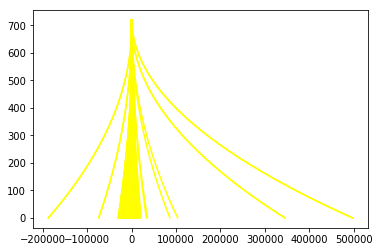

In [32]:
harder_challenge_output = 'test_videos_output/ouput_harder_challenge_video.mp4'
## To speed up the testing process you may want to try your pipeline on a shorter subclip of the video
## To do so add .subclip(start_second,end_second) to the end of the line below
## Where start_second and end_second are integer values representing the start and end of the subclip
## You may also uncomment the following line for a subclip of the first 5 seconds
##clip1 = VideoFileClip("test_videos/solidWhiteRight.mp4").subclip(0,5)
clip2 = VideoFileClip("harder_challenge_video.mp4")
harder_challenge_clip = clip2.fl_image(process_image) #NOTE: this function expects color images!!
%time harder_challenge_clip.write_videofile(harder_challenge_output, audio=False)

In [33]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(harder_challenge_output))


## After


In [34]:
def warp(img):
    img_size = (img.shape[1], img.shape[0])
    # Source src co-ords
    src = np.float32(
        [[850, 320],
         [865, 450],
         [533, 350],
         [535, 210]]
    )
    # Four desired coordinates
    dst = np.float32(
        [[870, 240],
         [870, 370],
         [520, 370],
         [520, 240]]
    )

    # Compute the perspective transform M
    m = cv2.getPerspectiveTransform(src, dst)
    # inverse by swapping
    
    # Warp the images
    warped = cv2.warpPerspective(img, m, img_size, flags=cv2.INTER_LINEAR)
    return warped